<a href="https://colab.research.google.com/github/evaneigomes/Modelos-Preditivos-para-Deteccao-de-Viola-oes-de-Dados-Uma-Abordagem-Comparativa/blob/main/OrgType_Prophet_x_Arima_x_Xgboost_Tcn_Lstm_v7_vfinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# =========================================
# 📦 Dependências e Bibliotecas
# =========================================

# Install core dependencies first to allow dependency resolver to find compatible versions
!pip install lstm tensorflow numpy pandas scipy keras matplotlib scikit-learn openpyxl prophet cmdstanpy statsmodels xgboost --quiet

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import LSTM, Dense
from google.colab import files
from itertools import product

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.1/50.1 kB 3.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 620.7/620.7 MB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 250.9/250.9 kB 24.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 12.1/12.1 MB 127.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 99.1/99.1 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.4/10.4 MB 147.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 115.9/115.9 MB 34.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.5/57.5 kB 5.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 89.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.5/24.5 MB 155.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 233.3/233.3 kB 23.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.5/5.5 MB 89.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 29

/usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:86: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
  warnings.warn(


In [1]:
import pandas as pd
import io

# Executa o comando pip list e captura a saída
pip_list_output = !pip list

# Converte a saída para uma string
pip_list_str = "\n".join(pip_list_output)

# Lê a string em um DataFrame pandas
# O formato de saída geralmente é Pacote Versão
df_pip_list = pd.read_csv(io.StringIO(pip_list_str), delim_whitespace=True, skiprows=[0,1], header=None, names=['Package', 'Version'])

# Lista das bibliotecas que o usuário quer verificar
requested_libraries = ['lstm', 'tensorflow', 'numpy', 'pandas', 'scipy', 'keras', 'matplotlib', 'scikit-learn', 'openpyxl', 'prophet', 'cmdstanpy', 'statsmodels','xgboost']

# Filtra o DataFrame para mostrar apenas as bibliotecas solicitadas
filtered_versions = df_pip_list[df_pip_list['Package'].isin(requested_libraries)]

# Exibe os resultados filtrados
print("Versões das bibliotecas solicitadas:")
display(filtered_versions)

Versões das bibliotecas solicitadas:


/tmp/ipython-input-3389506009.py:12: FutureWarning: The 'delim_whitespace' keyword in pd.read_csv is deprecated and will be removed in a future version. Use ``sep='\s+'`` instead
  df_pip_list = pd.read_csv(io.StringIO(pip_list_str), delim_whitespace=True, skiprows=[0,1], header=None, names=['Package', 'Version'])


,Package,Version
61,cmdstanpy,1.2.5
282,keras,3.10.0
322,matplotlib,3.10.0
362,numpy,2.0.2
389,openpyxl,3.1.5
408,pandas,2.2.2
442,prophet,1.1.7
530,scikit-learn,1.6.1
531,scipy,1.16.2
578,statsmodels,0.14.5


In [ ]:
# Importar apenas o necessário
import pandas as pd

# ✅ Link corrigido para exportação direta do Google Sheets em formato Excel (.xlsx)
link_excel = "https://docs.google.com/spreadsheets/d/1ZATZSDnfisdQF5dkKUorL_i0qyX4S7t7/export?format=xlsx"

# Carregar o arquivo direto do Sheets
df_original = pd.read_excel(link_excel)

# Visualizar as primeiras linhas
print("✅ Planilha carregada com sucesso:")
print(df_original.head())

✅ Planilha carregada com sucesso:
  Date Breach  BSF  BSO  BSR  EDU  GOV  MED  NGO  UNKN  Total Geral
0  1990-01-01  NaN  NaN  NaN  NaN  NaN  NaN  NaN   1.0          1.0
1     1997-01  NaN  NaN  NaN  NaN  NaN  1.0  NaN   NaN          1.0
2  1999-09-22  NaN  NaN  NaN  NaN  NaN  1.0  NaN   NaN          1.0
3  2000-01-01  NaN  NaN  NaN  NaN  1.0  NaN  NaN   NaN          1.0
4     2000-05  1.0  NaN  NaN  NaN  NaN  NaN  NaN   NaN          1.0


In [ ]:
# ==========================================
# 📄 Pré-Processamento de Dados
# ==========================================
# Fazemos a cópia para evitar alterar o df_original carregado do Excel.
df = df_original.copy()

def ajustar_datas(data_str):
    """
    Ajusta diferentes formatos de strings de data para um objeto Timestamp do pandas.

    Args:
        data_str: A string de data a ser ajustada.

    Returns:
        Um objeto Timestamp do pandas ou pd.NaT se a data for inválida ou incompleta.
    """
    try:
        data_str = str(data_str) # Garante que é uma string
        if len(data_str) == 4:
             # Considera ano apenas inválido por não conter mês
             return pd.NaT
        elif len(data_str) == 7 and '-' in data_str: # Formato YYYY-MM
            # Adiciona '-01' para representar o primeiro dia do mês
            return pd.to_datetime(data_str + '-01', format='%Y-%m-%d')
        elif len(data_str) >= 8: # Tenta analisar formatos mais completos
             # pd.to_datetime é flexível, mas pode precisar de `errors='coerce'`
            dt = pd.to_datetime(data_str, errors='coerce')
            # Se for NaT após a tentativa, retorna NaT
            if pd.isna(dt):
                return pd.NaT
            # Se for uma data válida, retorna ela
            return dt
        else:
            # Outros formatos curtos ou inesperados
            return pd.NaT
    except Exception as e:
        # Captura outras exceções de parsing e retorna NaT
        # print(f"Erro ao ajustar data '{data_str}': {e}") # Descomente para depuração
        return pd.NaT

# ==========================================
# ⏳ Ajuste e preparação da coluna de datas
# ==========================================
# Aplica a função à coluna de datas
linhas_antes_ajuste = len(df)
df['Date Breach'] = df['Date Breach'].astype(str).apply(ajustar_datas)

# Remover linhas com data inválida
df = df.dropna(subset=['Date Breach'])
linhas_apos_ajuste = len(df)
print(f"Linhas removidas por data inválida/incompleta: {linhas_antes_ajuste - linhas_apos_ajuste}")
print(f"Linhas restantes após ajuste de data: {linhas_apos_ajuste}")

# Define a coluna 'Date Breach' como índice
df.set_index('Date Breach', inplace=True)

# 5. Garantir tipo DatetimeIndex e ordenar
df.index = pd.to_datetime(df.index)

df.sort_index(inplace=True)

# Converte explicitamente para datetime (reforço)
#df['Date Breach'] = pd.to_datetime(df['Date Breach'])

# definindo os Setores
setores = ['BSF','BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral','UNKN']
print(f"Setores a serem analisados: {setores}")


# Verificar colunas de setores
colunas_faltantes = [col for col in setores if col not in df.columns]
if colunas_faltantes:
    print(f"\n⚠️ Aviso: Colunas de setores não encontradas: {colunas_faltantes}")
    setores = [col for col in setores if col in df.columns]
    print(f"   -> Setores ajustados para análise: {setores}")
    if not setores:
        raise ValueError("Nenhuma coluna de setor válida encontrada.")


# Selecionar apenas colunas de setores
df_sectors_only = df[setores]

# 8. Reamostrar para frequência mensal ('ME' para fim do mês)
print(f"\nReamostrando dados para frequência mensal (fim do mês)...")
# Usar 'ME' para fim de mês explicitamente
df_monthly = df_sectors_only.resample('ME').sum() # Use 'M' ou 'ME'

# 9. Filtrar datas
#df_monthly = df_monthly[df_monthly.index < pd.to_datetime('2024-01-01')]
df_monthly = df_monthly[(df_monthly.index >= pd.to_datetime('2010-01-01')) & (df_monthly.index < pd.to_datetime('2024-01-01'))]
print(f"Dados filtrados até: {df_monthly.index.max()}")

# 10. Preencher NaNs resultantes da reamostragem com 0
df_monthly = df_monthly.fillna(0)

# --- (NOVO) PASSO 11: TRATAMENTO DE OUTLIERS (IQR Capping) ---
print("\n--- Iniciando Tratamento de Outliers (IQR Capping) ---")
df_monthly_treated = df_monthly.copy() # Criar cópia para não alterar o original diretamente
outliers_info = {}

print("Aplicando capping baseado em IQR para cada setor:")
for setor in setores:
    if setor in df_monthly_treated.columns: # Checa se a coluna existe
        Q1 = df_monthly_treated[setor].quantile(0.25)
        Q3 = df_monthly_treated[setor].quantile(0.75)
        IQR = Q3 - Q1

        # Definir limites (não permitir que sejam negativos se os dados não podem ser)
        lower_bound = max(0, Q1 - 1.5 * IQR) # Garante limite inferior >= 0
        upper_bound = Q3 + 1.5 * IQR

        # Identificar outliers
        outliers_low = df_monthly_treated[setor] < lower_bound
        outliers_high = df_monthly_treated[setor] > upper_bound
        num_outliers_low = outliers_low.sum()
        num_outliers_high = outliers_high.sum()

        if num_outliers_low > 0 or num_outliers_high > 0:
            print(f"  Setor '{setor}':")
            print(f"    Q1={Q1:.2f}, Q3={Q3:.2f}, IQR={IQR:.2f}")
            print(f"    Limites: Inferior={lower_bound:.2f}, Superior={upper_bound:.2f}")
            if num_outliers_low > 0:
                 print(f"    {num_outliers_low} outlier(s) abaixo do limite inferior encontrados.")
            if num_outliers_high > 0:
                 print(f"    {num_outliers_high} outlier(s) acima do limite superior encontrados.")

            # Aplicar Capping (substituir outliers pelos limites)
            df_monthly_treated[setor] = df_monthly_treated[setor].clip(lower=lower_bound, upper=upper_bound)
            print(f"    -> Outliers substituídos pelos limites (capping).")
            outliers_info[setor] = {'low': num_outliers_low, 'high': num_outliers_high, 'lower_bound': lower_bound, 'upper_bound': upper_bound}
        else:
            # print(f"  Setor '{setor}': Nenhum outlier detectado com IQR.")
             outliers_info[setor] = {'low': 0, 'high': 0, 'lower_bound': lower_bound, 'upper_bound': upper_bound}

    else:
        print(f"  Setor '{setor}': Coluna não encontrada no DataFrame mensal.")

print("\n--- Tratamento de Outliers Concluído ---")
# --- FIM DO TRATAMENTO DE OUTLIERS ---

# --- Inspeção do Resultado do Pré-processamento (AGORA COM DADOS TRATADOS) ---
print("\n--- DataFrame Mensal Consolidado (PÓS-Tratamento de Outliers) ---")
# IMPORTANTE: Usar df_monthly_treated daqui em diante, se o tratamento foi aplicado
print(f"Formato Final (Linhas=Meses, Colunas=Setores): {df_monthly_treated.shape}") # Usa o DF tratado
print("\nPrimeiras linhas do DataFrame Mensal Tratado:")
display(df_monthly_treated.head()) # Usa o DF tratado
print("\nÚltimas linhas do DataFrame Mensal Tratado:")
display(df_monthly_treated.tail()) # Usa o DF tratado
print("\nInformações Gerais do DataFrame Mensal Tratado:")
df_monthly_treated.info() # Usa o DF tratado
print("\nEstatísticas Descritivas do DataFrame Mensal Tratado:")
display(df_monthly_treated.describe()) # Usa o DF tratado

# IMPORTANTE: Certifique-se de que a Célula 4 (Loop Principal) use df_monthly_treated
# Renomeie ou reatribua se necessário antes da Célula 4. Ex:
# df_monthly = df_monthly_treated # Se quiser sobrescrever a variável original

print("\n✅ Pré-processamento centralizado (incluindo tratamento de outliers) concluído.")


df_filtered = df_monthly_treated;

Linhas removidas por data inválida/incompleta: 14
Linhas restantes após ajuste de data: 4701
Setores a serem analisados: ['BSF', 'BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral', 'UNKN']

Reamostrando dados para frequência mensal (fim do mês)...
Dados filtrados até: 2023-12-31 00:00:00

--- Iniciando Tratamento de Outliers (IQR Capping) ---
Aplicando capping baseado em IQR para cada setor:
  Setor 'EDU':
    Q1=2.00, Q3=19.00, IQR=17.00
    Limites: Inferior=0.00, Superior=44.50
    4 outlier(s) acima do limite superior encontrados.
    -> Outliers substituídos pelos limites (capping).
  Setor 'GOV':
    Q1=1.00, Q3=8.50, IQR=7.50
    Limites: Inferior=0.00, Superior=19.75
    3 outlier(s) acima do limite superior encontrados.
    -> Outliers substituídos pelos limites (capping).
  Setor 'NGO':
    Q1=0.00, Q3=10.50, IQR=10.50
    Limites: Inferior=0.00, Superior=26.25
    1 outlier(s) acima do limite superior encontrados.
    -> Outliers substituídos pelos limites (capping).

-

,BSF,BSO,BSR,EDU,GOV,MED,NGO,Total Geral,UNKN
Date Breach,,,,,,,,,
2010-01-31,3.0,0.0,0.0,1.0,0.0,4.0,0.0,8.0,0.0
2010-02-28,2.0,4.0,2.0,2.0,0.0,6.0,0.0,16.0,0.0
2010-03-31,1.0,2.0,1.0,1.0,0.0,4.0,1.0,10.0,0.0
2010-04-30,2.0,1.0,0.0,2.0,0.0,4.0,0.0,9.0,0.0
2010-05-31,1.0,2.0,1.0,1.0,0.0,2.0,0.0,7.0,0.0



Últimas linhas do DataFrame Mensal Tratado:


,BSF,BSO,BSR,EDU,GOV,MED,NGO,Total Geral,UNKN
Date Breach,,,,,,,,,
2023-08-31,39.0,73.5,30.0,36.0,5.00,57.0,11.00,336.0,80.0
2023-09-30,30.0,83.0,16.0,16.0,8.50,62.0,26.25,355.5,96.5
2023-10-31,35.0,81.5,20.0,29.0,19.75,90.0,12.00,392.5,95.0
2023-11-30,32.0,109.5,22.0,39.0,8.50,98.0,15.00,458.5,110.5
2023-12-31,31.0,89.5,13.0,17.0,12.00,63.0,24.00,345.5,87.0



Informações Gerais do DataFrame Mensal Tratado:
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 168 entries, 2010-01-31 to 2023-12-31
Freq: ME
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   BSF          168 non-null    float64
 1   BSO          168 non-null    float64
 2   BSR          168 non-null    float64
 3   EDU          168 non-null    float64
 4   GOV          168 non-null    float64
 5   MED          168 non-null    float64
 6   NGO          168 non-null    float64
 7   Total Geral  168 non-null    float64
 8   UNKN         168 non-null    float64
dtypes: float64(9)
memory usage: 13.1 KB

Estatísticas Descritivas do DataFrame Mensal Tratado:


,BSF,BSO,BSR,EDU,GOV,MED,NGO,Total Geral,UNKN
count,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000,168.000000
mean,22.136905,37.473214,19.238095,12.095238,5.334821,34.720238,6.281250,200.633929,60.824405
std,17.437631,34.265486,12.925043,11.640698,5.286042,24.481919,7.069913,143.480115,45.198502
min,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,5.000000,0.000000
25%,7.000000,7.000000,8.750000,2.000000,1.000000,12.000000,0.000000,69.000000,16.750000
50%,19.000000,30.250000,20.000000,9.000000,4.000000,33.000000,4.000000,202.750000,60.500000
75%,35.000000,63.875000,29.000000,19.000000,8.500000,52.000000,10.500000,327.125000,96.125000
max,70.000000,130.500000,53.000000,44.500000,19.750000,105.000000,26.250000,530.500000,145.500000



✅ Pré-processamento centralizado (incluindo tratamento de outliers) concluído.


In [ ]:
df = df_filtered
print(df.columns)
print("Número de linhas:", len(df))
total = df['Total Geral'].sum()
print("Total Geral:", total)


Index(['BSF', 'BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral', 'UNKN'], dtype='object')
Número de linhas: 168
Total Geral: 33706.5


📈 Expoente de Hurst por setor:

BSF: H = 0.6265 → ↗ Tendência (H > 0.5)
BSO: H = 0.5275 → 📉 Comportamento aleatório (H ≈ 0.5)
BSR: H = 0.7371 → ↗ Tendência (H > 0.5)
EDU: H = 0.7457 → ↗ Tendência (H > 0.5)
GOV: H = 0.7387 → ↗ Tendência (H > 0.5)
MED: H = 0.6511 → ↗ Tendência (H > 0.5)
NGO: H = 0.7242 → ↗ Tendência (H > 0.5)
Total Geral: H = 0.4456 → ↘ Reversão à média (H < 0.5)
UNKN: H = 0.542 → 📉 Comportamento aleatório (H ≈ 0.5)


/tmp/ipython-input-1346622201.py:11: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  df_mensal = df.resample("M").sum()


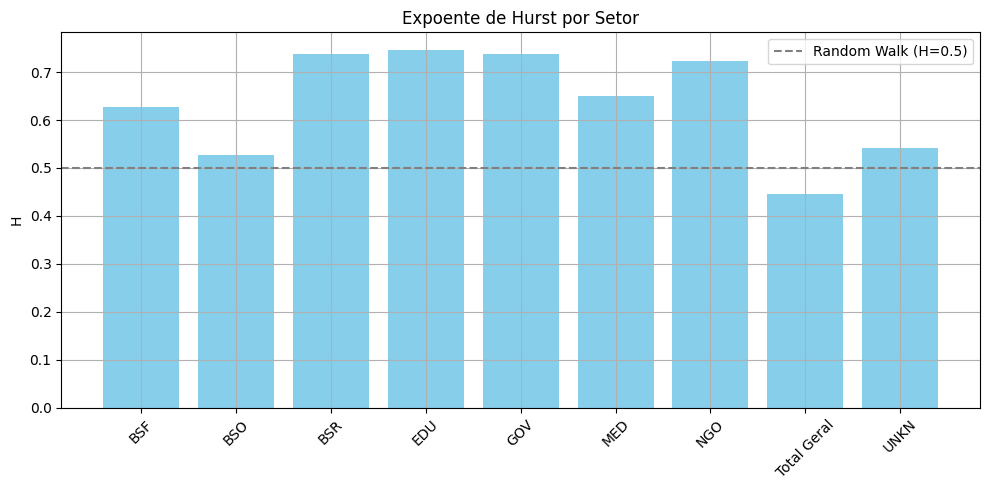

In [ ]:
# ==========================================
# Instalação e Importações - Expoente de Hurst
# ==========================================
!pip install hurst --quiet
from hurst import compute_Hc
import matplotlib.pyplot as plt

# ==========================================
# Agrupamento mensal (índice já é datetime)
# ==========================================
df_mensal = df.resample("M").sum()

# ==========================================
# Cálculo do Expoente de Hurst por setor
# ==========================================
hurst_resultados = {}

for coluna in df_mensal.columns:
    serie = df_mensal[coluna].fillna(0).values
    if len(serie[serie > 0]) > 10:                 # precisa de dados suficientes
        H, _, _ = compute_Hc(serie, kind='change', simplified=True)
        hurst_resultados[coluna] = round(H, 4)

# ==========================================
# Exibição dos resultados
# ==========================================
print("📈 Expoente de Hurst por setor:\n")
for setor, hurst in hurst_resultados.items():
    if hurst < 0.5:
        interpretacao = "↘ Reversão à média (H < 0.5)"
    elif round(hurst, 1) == 0.5:
        interpretacao = "📉 Comportamento aleatório (H ≈ 0.5)"
    else:
        interpretacao = "↗ Tendência (H > 0.5)"
    print(f"{setor}: H = {hurst} → {interpretacao}")

# ==========================================
# Visualização Gráfica
# ==========================================
plt.figure(figsize=(10, 5))
plt.bar(hurst_resultados.keys(), hurst_resultados.values(), color='skyblue')
plt.axhline(0.5, color='gray', linestyle='--', label='Random Walk (H=0.5)')
plt.title("Expoente de Hurst por Setor")
plt.ylabel("H")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()


INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para BSF
MAE:  13.21
RMSE: 15.37
MAPE: 39.47%
Melhores parâmetros: {'changepoint_prior_scale': 0.05, 'fourier_order': 15, 'n_changepoints': 50}


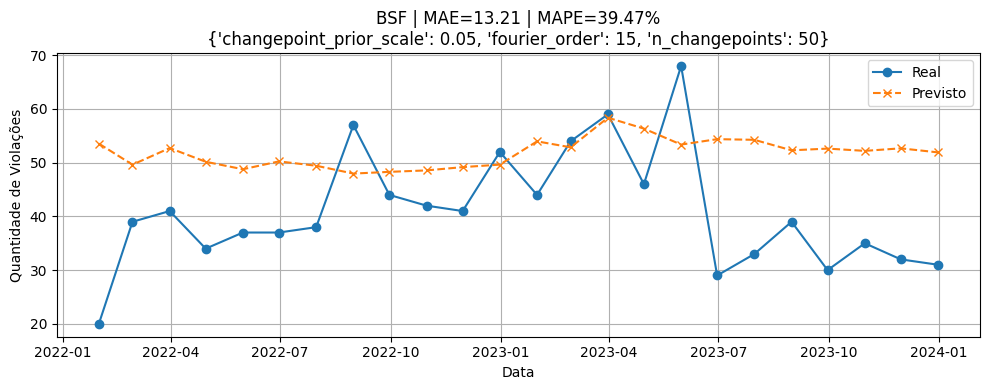

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para BSO
MAE:  23.26
RMSE: 25.91
MAPE: 32.13%
Melhores parâmetros: {'changepoint_prior_scale': 0.05, 'fourier_order': 15, 'n_changepoints': 25}


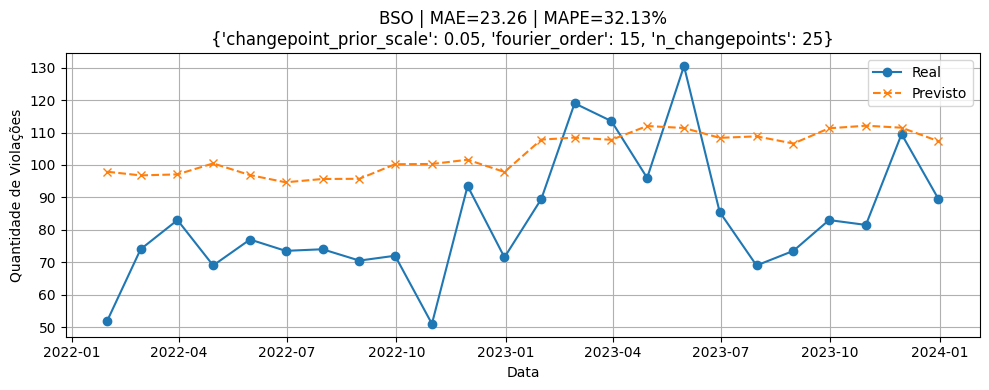

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para BSR
MAE:  7.10
RMSE: 8.73
MAPE: 73.13%
Melhores parâmetros: {'changepoint_prior_scale': 0.1, 'fourier_order': 5, 'n_changepoints': 50}


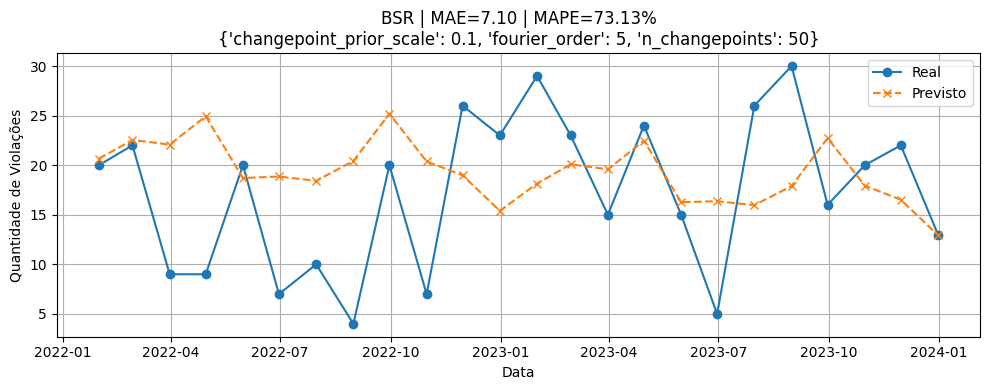

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para EDU
MAE:  8.70
RMSE: 10.24
MAPE: 34.40%
Melhores parâmetros: {'changepoint_prior_scale': 0.1, 'fourier_order': 10, 'n_changepoints': 50}


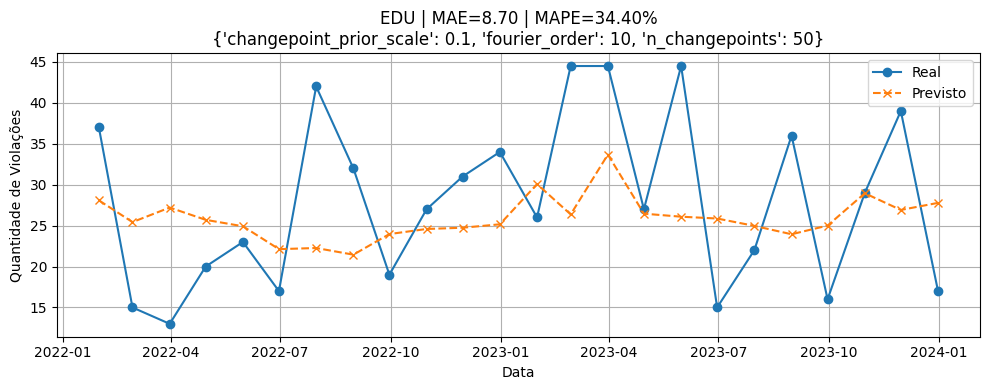

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para GOV
MAE:  3.68
RMSE: 4.64
MAPE: 39.47%
Melhores parâmetros: {'changepoint_prior_scale': 0.3, 'fourier_order': 5, 'n_changepoints': 50}


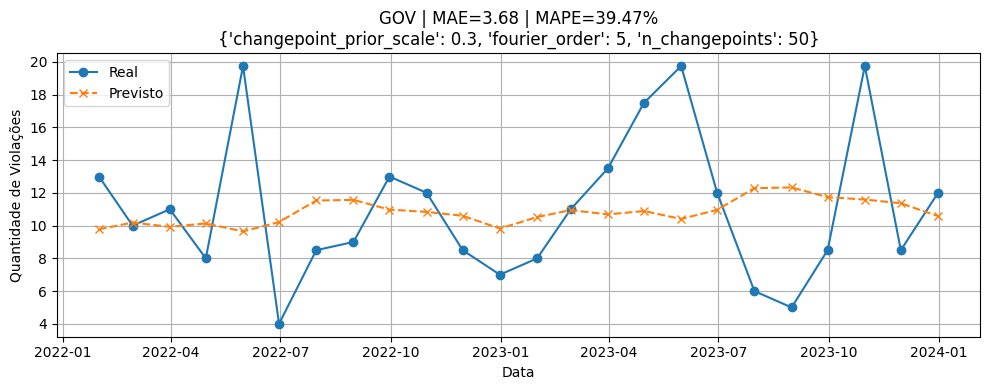

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para MED
MAE:  15.53
RMSE: 18.20
MAPE: 26.54%
Melhores parâmetros: {'changepoint_prior_scale': 0.05, 'fourier_order': 15, 'n_changepoints': 50}


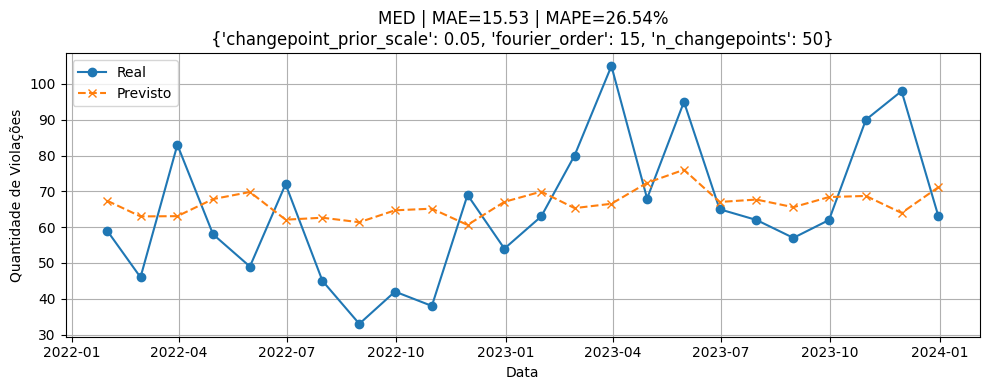

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para NGO
MAE:  5.35
RMSE: 5.97
MAPE: 48.57%
Melhores parâmetros: {'changepoint_prior_scale': 0.05, 'fourier_order': 5, 'n_changepoints': 50}


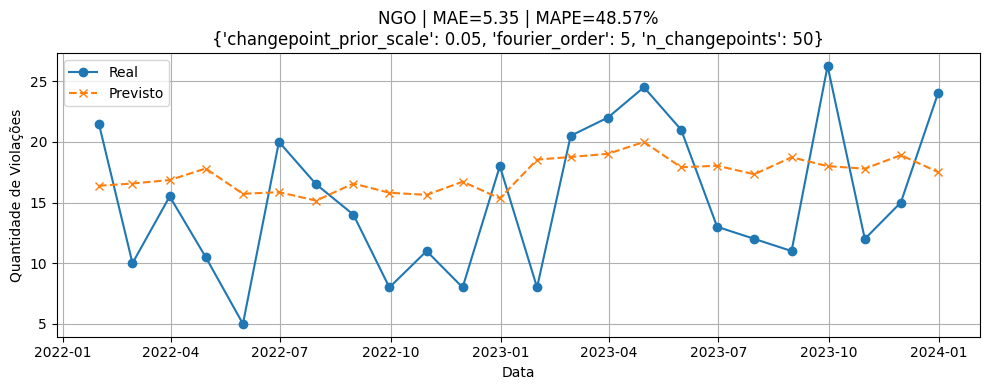

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para Total Geral
MAE:  61.73
RMSE: 69.66
MAPE: 17.63%
Melhores parâmetros: {'changepoint_prior_scale': 0.05, 'fourier_order': 15, 'n_changepoints': 25}


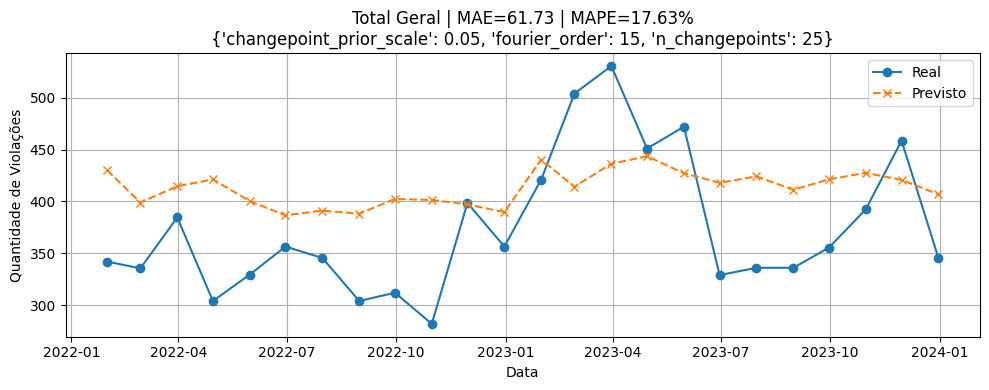

INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local/lib/python3.12/dist-packages/prophet/forecaster.py:1872: FutureWarning: 'M' is deprecated and will be removed in a future version, please use 'ME' instead.
  dates = pd.date_range(
INFO:prophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
/usr/local


📊 Resultados para UNKN
MAE:  21.41
RMSE: 24.87
MAPE: 22.54%
Melhores parâmetros: {'changepoint_prior_scale': 0.1, 'fourier_order': 15, 'n_changepoints': 50}


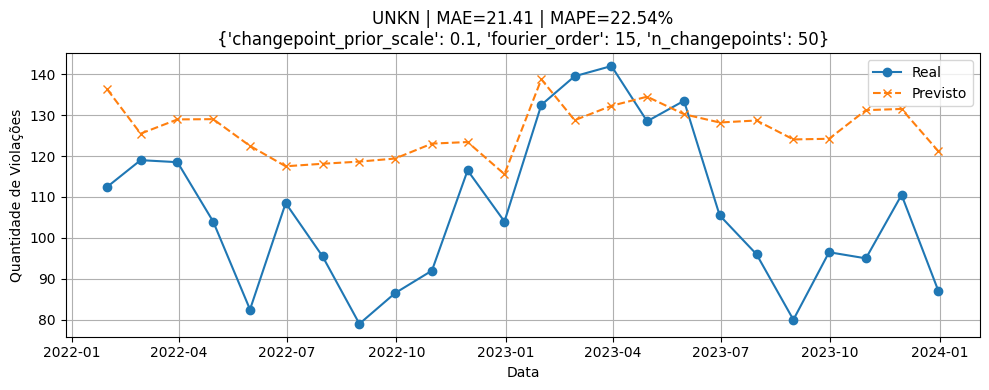


✅ Resultados Consolidados (amostra):
        Coluna    MAE   RMSE   MAPE  changepoint_prior_scale  fourier_order  \
0          BSF  13.21  15.37  39.47                     0.05             15   
1          BSO  23.26  25.91  32.13                     0.05             15   
2          BSR   7.10   8.73  73.13                     0.10              5   
3          EDU   8.70  10.24  34.40                     0.10             10   
4          GOV   3.68   4.64  39.47                     0.30              5   
5          MED  15.53  18.20  26.54                     0.05             15   
6          NGO   5.35   5.97  48.57                     0.05              5   
7  Total Geral  61.73  69.66  17.63                     0.05             15   
8         UNKN  21.41  24.87  22.54                     0.10             15   

   n_changepoints   Status  
0              50  Sucesso  
1              25  Sucesso  
2              50  Sucesso  
3              50  Sucesso  
4              50  Sucesso

In [ ]:
# ==========================================
# 📦 Importações de Bibliotecas - prophet
# ==========================================
from prophet import Prophet                           # Modelo Prophet para previsão de séries temporais
import itertools                                      # Para criar combinações de parâmetros
import numpy as np                                    # Operações numéricas
from sklearn.metrics import mean_absolute_error, mean_squared_error  # Métricas de avaliação
import matplotlib.pyplot as plt                       # Para gráficos
import pandas as pd                                    # Para manipulação de dados (se ainda não importado)

# ==========================================
# ⚙️ Definição do Grid Search
# ==========================================
changepoint_values = [0.05, 0.1, 0.3, 0.5]      # Controle da flexibilidade dos pontos de mudança
fourier_orders = [5, 10, 15]                    # Ordem da série de Fourier (captura sazonalidades)
n_changepoints_values = [25, 50]                # Número de pontos de mudança

# Cria todas as combinações possíveis de parâmetros
param_grid = list(itertools.product(
    changepoint_values,
    fourier_orders,
    n_changepoints_values
))

# Lista para armazenar os resultados de cada coluna
resultados_prophet = []

# ==========================================
# 📈 Função para aplicar Prophet em uma série
# ==========================================
def aplicar_prophet_serie(nome_coluna, df_series):
    """
    Aplica Prophet a uma série temporal:
    - Divide em treino (exceto últimas 24 observações) e teste (últimas 24)
    - Testa todas as combinações do grid search
    - Seleciona o melhor modelo (menor MAE)
    - Exibe gráfico comparando valores reais vs previstos
    - Armazena resultados na lista global
    """

    # Prepara DataFrame no formato exigido pelo Prophet
    df_temp = df_series[[nome_coluna]].copy()
    df_temp = df_temp.rename(columns={nome_coluna: 'y'})
    df_temp['ds'] = df_temp.index
    df_temp = df_temp[['ds', 'y']]

    # Divide em treino e teste
    train = df_temp[:-24]
    test = df_temp[-24:]

    # Variáveis para armazenar o melhor resultado
    best_model = None
    best_forecast = None
    best_metrics = {'mae': np.inf}
    best_params = None

    # ==========================================
    # 🔎 Loop de Grid Search
    # ==========================================
    for changepoint_prior_scale, fourier_order, n_changepoints in param_grid:
        try:
            # Configura e treina o modelo Prophet
            model = Prophet(
                yearly_seasonality=False,
                changepoint_prior_scale=changepoint_prior_scale,
                n_changepoints=n_changepoints
            )

            # Adiciona sazonalidade anual
            model.add_seasonality(
                name='anual',
                period=365.25,
                fourier_order=fourier_order
            )

            model.fit(train)

            # Gera previsões para os próximos 24 meses
            future = model.make_future_dataframe(periods=24, freq='M')
            forecast = model.predict(future)

            # Avaliação do modelo
            forecast_test = forecast.set_index('ds').loc[test['ds']]
            predicted = forecast_test['yhat'].values
            actual = test['y'].values

            mae = mean_absolute_error(actual, predicted)
            rmse = np.sqrt(mean_squared_error(actual, predicted))
            mape = np.mean(np.abs((actual - predicted) / actual)) * 100

            # Atualiza o melhor modelo
            if mae < best_metrics['mae']:
                best_model = model
                best_forecast = forecast
                best_metrics = {'mae': mae, 'rmse': rmse, 'mape': mape}
                best_params = {
                    'changepoint_prior_scale': changepoint_prior_scale,
                    'fourier_order': fourier_order,
                    'n_changepoints': n_changepoints
                }

        except Exception as e:
            print(f"⚠️ Erro em {nome_coluna} - params=({changepoint_prior_scale}, {fourier_order}, {n_changepoints}): {e}")
            continue

    # ==========================================
    # 🔎 Verifica se houve modelo válido
    # ==========================================
    if best_model is None:
        print(f"⚠️ Nenhum modelo válido para {nome_coluna}.")
        resultados_prophet.append({
            'Coluna': nome_coluna,
            'MAE': None,
            'RMSE': None,
            'MAPE': None,
            'changepoint_prior_scale': None,
            'fourier_order': None,
            'n_changepoints': None,
            'Status': 'Erro no ajuste'
        })
        return

    # ==========================================
    # 📊 Exibição do melhor resultado
    # ==========================================
    forecast_test = best_forecast.set_index('ds').loc[test['ds']]
    predicted = forecast_test['yhat'].values
    actual = test['y'].values

    print(f"\n📊 Resultados para {nome_coluna}")
    print(f"MAE:  {best_metrics['mae']:.2f}")
    print(f"RMSE: {best_metrics['rmse']:.2f}")
    print(f"MAPE: {best_metrics['mape']:.2f}%")
    print(f"Melhores parâmetros: {best_params}")

    # ==========================================
    # 📈 Gráfico Real vs Previsto
    # ==========================================
    plt.figure(figsize=(10, 4))
    plt.plot(test['ds'], actual, marker='o', label='Real')
    plt.plot(test['ds'], predicted, marker='x', linestyle='--', label='Previsto')
    plt.title(f"{nome_coluna} | MAE={best_metrics['mae']:.2f} | MAPE={best_metrics['mape']:.2f}%\n{best_params}")
    plt.xlabel('Data')
    plt.ylabel('Quantidade de Violações')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    # ==========================================
    # 📝 Armazena os resultados
    # ==========================================
    resultados_prophet.append({
        'Coluna': nome_coluna,
        'MAE': round(best_metrics['mae'], 2),
        'RMSE': round(best_metrics['rmse'], 2),
        'MAPE': round(best_metrics['mape'], 2),
        'changepoint_prior_scale': best_params['changepoint_prior_scale'],
        'fourier_order': best_params['fourier_order'],
        'n_changepoints': best_params['n_changepoints'],
        'Status': 'Sucesso'
    })

# ==========================================
# 🚀 Aplicação do Prophet para cada coluna
# ==========================================
for col in df_filtered.columns:
    if df_filtered[col].sum() > 0:           # Considera apenas séries com dados > 0
        aplicar_prophet_serie(col, df_filtered)

# ==========================================
# 💾 Consolidação e Exportação dos Resultados - Prophet
# ==========================================
#from google.colab import drive
import pandas as pd
from datetime import datetime

# Cria o DataFrame com os resultados do Prophet
df_resultados_prophet = pd.DataFrame(resultados_prophet)
print("\n✅ Resultados Consolidados (amostra):")
print(df_resultados_prophet.head(9))

df_resultados_prophet.to_csv('/content/resultados_prophet.csv', index=False)


🚩 Iniciando ARIMA para: BSF

📊 Resultados para BSF
MAE:  18.84
RMSE: 20.99
MAPE: 55.43%
Melhores parâmetros: Order=(0, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=824.61


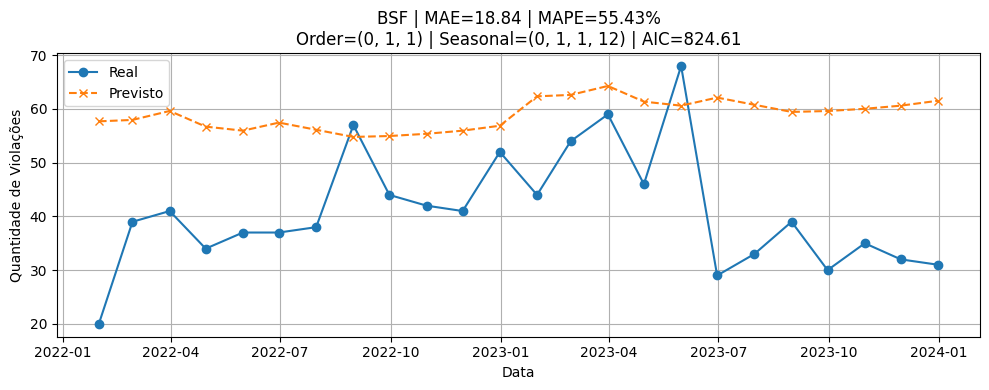


🚩 Iniciando ARIMA para: BSO

📊 Resultados para BSO
MAE:  25.12
RMSE: 27.89
MAPE: 34.77%
Melhores parâmetros: Order=(0, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=906.69


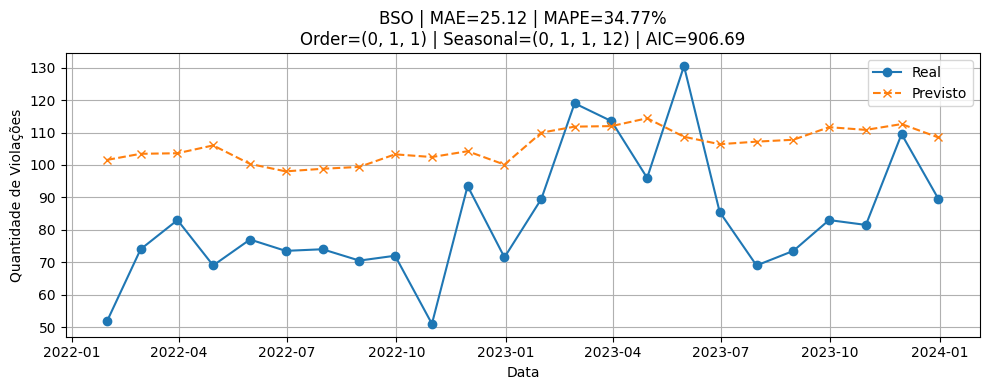


🚩 Iniciando ARIMA para: BSR


/usr/local/lib/python3.12/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



📊 Resultados para BSR
MAE:  7.52
RMSE: 9.35
MAPE: 80.64%
Melhores parâmetros: Order=(0, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=836.44


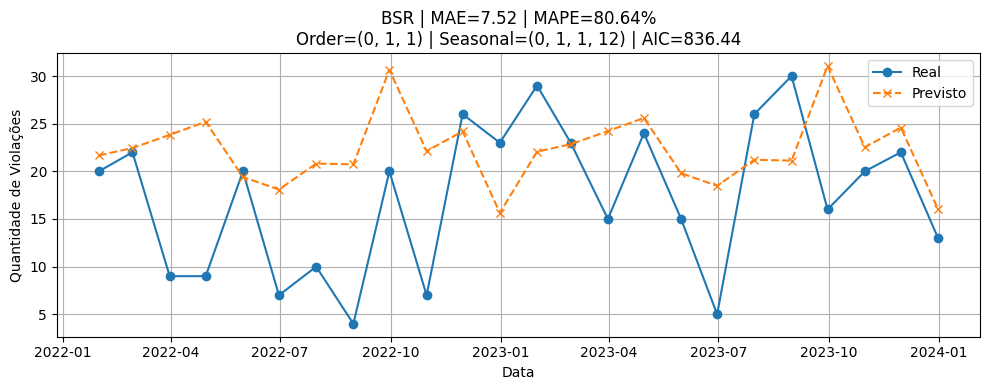


🚩 Iniciando ARIMA para: EDU


/usr/local/lib/python3.12/dist-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "



📊 Resultados para EDU
MAE:  9.03
RMSE: 10.38
MAPE: 34.90%
Melhores parâmetros: Order=(0, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=798.98


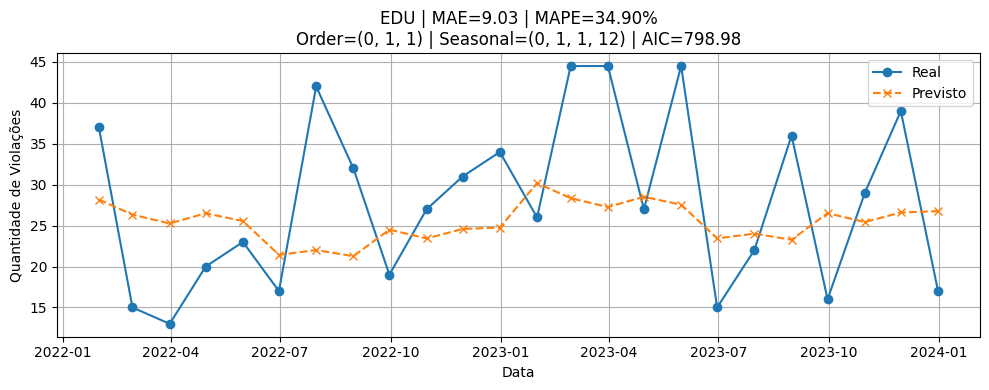


🚩 Iniciando ARIMA para: GOV

📊 Resultados para GOV
MAE:  3.87
RMSE: 4.76
MAPE: 42.57%
Melhores parâmetros: Order=(1, 1, 1) | Seasonal=(1, 1, 1, 12) | AIC=635.05


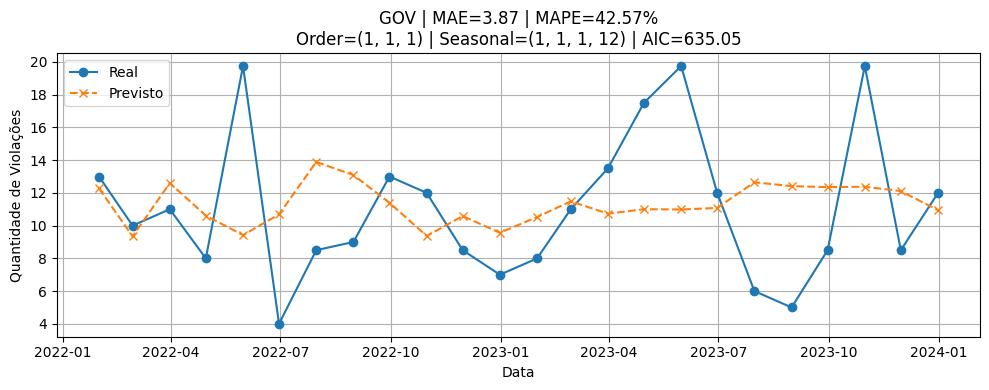


🚩 Iniciando ARIMA para: MED

📊 Resultados para MED
MAE:  17.47
RMSE: 19.64
MAPE: 32.19%
Melhores parâmetros: Order=(1, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=907.35


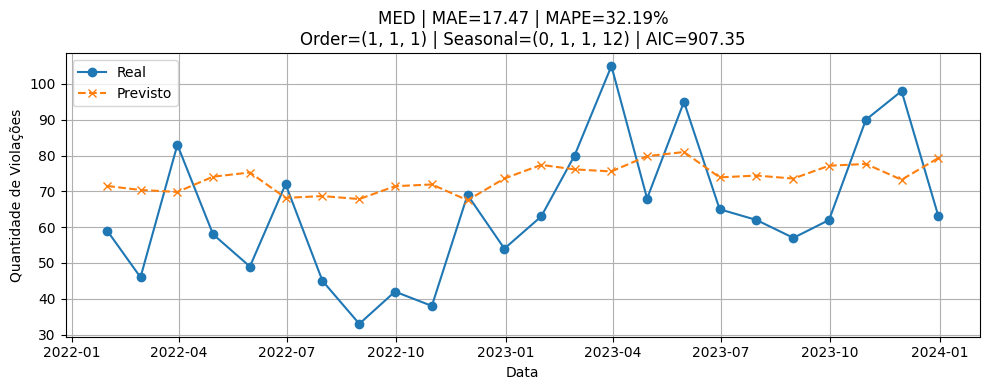


🚩 Iniciando ARIMA para: NGO

📊 Resultados para NGO
MAE:  5.65
RMSE: 6.55
MAPE: 53.38%
Melhores parâmetros: Order=(1, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=650.87


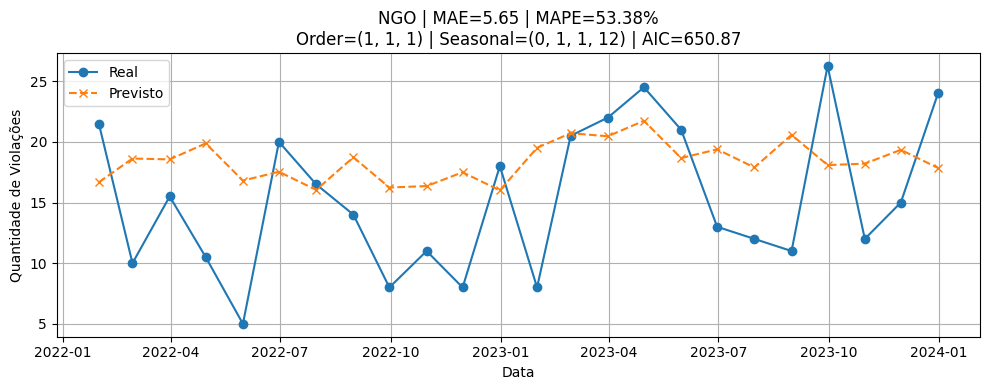


🚩 Iniciando ARIMA para: Total Geral

📊 Resultados para Total Geral
MAE:  93.98
RMSE: 104.40
MAPE: 27.61%
Melhores parâmetros: Order=(1, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=1200.00


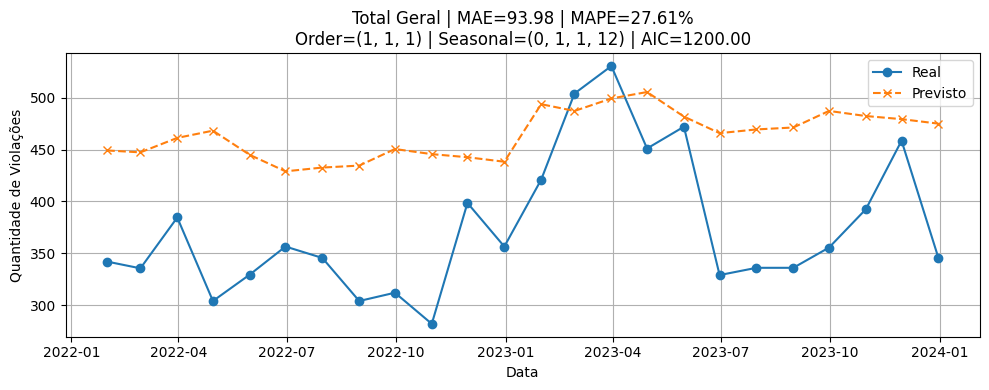


🚩 Iniciando ARIMA para: UNKN

📊 Resultados para UNKN
MAE:  31.58
RMSE: 35.08
MAPE: 32.76%
Melhores parâmetros: Order=(1, 1, 1) | Seasonal=(0, 1, 1, 12) | AIC=1015.65


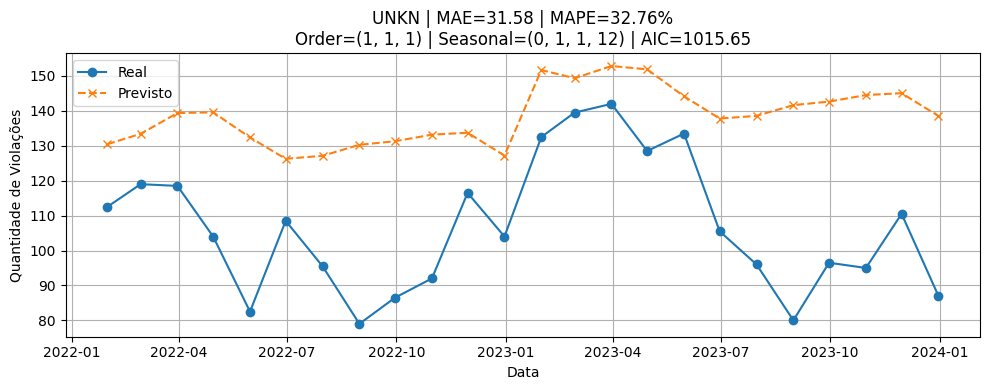


✅ Resultados Consolidados (amostra):
        Coluna      Order Seasonal_Order      AIC    MAE    RMSE  MAPE%  \
0          BSF  (0, 1, 1)  (0, 1, 1, 12)   824.61  18.84   20.99  55.43   
1          BSO  (0, 1, 1)  (0, 1, 1, 12)   906.69  25.12   27.89  34.77   
2          BSR  (0, 1, 1)  (0, 1, 1, 12)   836.44   7.52    9.35  80.64   
3          EDU  (0, 1, 1)  (0, 1, 1, 12)   798.98   9.03   10.38  34.90   
4          GOV  (1, 1, 1)  (1, 1, 1, 12)   635.05   3.87    4.76  42.57   
5          MED  (1, 1, 1)  (0, 1, 1, 12)   907.35  17.47   19.64  32.19   
6          NGO  (1, 1, 1)  (0, 1, 1, 12)   650.87   5.65    6.55  53.38   
7  Total Geral  (1, 1, 1)  (0, 1, 1, 12)  1200.00  93.98  104.40  27.61   
8         UNKN  (1, 1, 1)  (0, 1, 1, 12)  1015.65  31.58   35.08  32.76   

    Status  
0  Sucesso  
1  Sucesso  
2  Sucesso  
3  Sucesso  
4  Sucesso  
5  Sucesso  
6  Sucesso  
7  Sucesso  
8  Sucesso  


In [ ]:
# ==========================================
# 📦 Importações Arima
# ==========================================
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from statsmodels.tsa.statespace.sarimax import SARIMAX
from sklearn.metrics import mean_absolute_error, mean_squared_error
from google.colab import drive
from datetime import datetime

# ==========================================
# ⚙️ Definição dos Parâmetros do Grid Search
# ==========================================
p = d = q = range(0, 2)
P = D = Q = range(0, 2)
s = 12  # Sazonalidade mensal (12 meses)

param_combinations = list(itertools.product(p, d, q))
seasonal_combinations = list(itertools.product(P, D, Q))

# Lista para armazenar resultados
resultados_arima = []

# ==========================================
# 🔹 Função para aplicar ARIMA em uma série
# ==========================================
def aplicar_arima_serie(nome_coluna, df_series):
    """
    Ajusta um modelo SARIMA para a série temporal de cada coluna.
    - Divide dados em treino e teste (últimos 24 meses)
    - Faz grid search (menor AIC)
    - Calcula métricas (MAE, RMSE, MAPE)
    - Plota gráfico comparando valores reais e previstos
    - Armazena os resultados globais
    """
    print(f"\n🚩 Iniciando ARIMA para: {nome_coluna}")

    serie = df_series[nome_coluna].dropna()
    if serie.sum() == 0:
        print(f"⚠️ Série {nome_coluna} sem dados relevantes. Pulando...")
        return

    # Divide treino/teste
    train = serie[:-24]
    test = serie[-24:]

    best_aic = np.inf
    best_model = None
    best_params = None

    # ==========================================
    # 🔎 Grid Search
    # ==========================================
    for param in param_combinations:
        for seasonal_param in seasonal_combinations:
            try:
                model = SARIMAX(
                    train,
                    order=param,
                    seasonal_order=seasonal_param + (s,),
                    enforce_stationarity=False,
                    enforce_invertibility=False
                )
                fit = model.fit(disp=False)

                if fit.aic < best_aic:
                    best_aic = fit.aic
                    best_model = fit
                    best_params = (param, seasonal_param + (s,))
            except Exception:
                continue

    # ==========================================
    # 🔎 Verifica se encontrou modelo
    # ==========================================
    if best_model is None:
        print(f"⚠️ Nenhum modelo válido para {nome_coluna}. Registrando falha.")
        resultados_arima.append({
            'Coluna': nome_coluna,
            'Order': None,
            'Seasonal_Order': None,
            'AIC': None,
            'MAE': None,
            'RMSE': None,
            'MAPE%': None,
            'Status': 'Erro no ajuste'
        })
        return

    # ==========================================
    # ✅ Forecast com melhor modelo
    # ==========================================
    try:
        forecast = best_model.forecast(steps=24)
        forecast.index = test.index

        mae = mean_absolute_error(test, forecast)
        rmse = np.sqrt(mean_squared_error(test, forecast))
        mask = test != 0
        mape = (
            np.mean(np.abs((test[mask] - forecast[mask]) / test[mask])) * 100
            if mask.sum() > 0 else None
        )

        print(f"\n📊 Resultados para {nome_coluna}")
        print(f"MAE:  {mae:.2f}")
        print(f"RMSE: {rmse:.2f}")
        print(f"MAPE: {mape:.2f}%")
        print(f"Melhores parâmetros: Order={best_params[0]} | Seasonal={best_params[1]} | AIC={best_aic:.2f}")

        # 📈 Gráfico Real vs Previsto
        plt.figure(figsize=(10, 4))
        plt.plot(test, label='Real', marker='o')
        plt.plot(forecast, label='Previsto', marker='x', linestyle='--')
        plt.title(f"{nome_coluna} | MAE={mae:.2f} | MAPE={mape:.2f}%\n"
                  f"Order={best_params[0]} | Seasonal={best_params[1]} | AIC={best_aic:.2f}")
        plt.xlabel('Data')
        plt.ylabel('Quantidade de Violações')
        plt.legend()
        plt.grid(True)
        plt.tight_layout()
        plt.show()

        # Armazena resultados
        resultados_arima.append({
            'Coluna': nome_coluna,
            'Order': best_params[0],
            'Seasonal_Order': best_params[1],
            'AIC': round(best_aic, 2),
            'MAE': round(mae, 2),
            'RMSE': round(rmse, 2),
            'MAPE%': round(mape, 2) if mape is not None else None,
            'Status': 'Sucesso'
        })

    except Exception as e:
        print(f"⚠️ Erro ao prever {nome_coluna}: {e}")
        resultados_arima.append({
            'Coluna': nome_coluna,
            'Order': best_params[0],
            'Seasonal_Order': best_params[1],
            'AIC': round(best_aic, 2),
            'MAE': None,
            'RMSE': None,
            'MAPE%': None,
            'Status': 'Erro na previsão'
        })

# ==========================================
# 🚀 Aplicar ARIMA em todas as colunas
# ==========================================
for col in df_filtered.columns:
    if df_filtered[col].sum() > 0:
        aplicar_arima_serie(col, df_filtered)

# Cria o DataFrame com os resultados
df_resultados_arima = pd.DataFrame(resultados_arima)
print("\n✅ Resultados Consolidados (amostra):")
print(df_resultados_arima.head(9))

# Salva no Drive
df_resultados_prophet.to_csv('/content/resultados_sarima.csv', index=False)



🚩 Iniciando XGBoost para: BSF

📊 Resultados para BSF
MAE:  7.40
RMSE: 9.39
MAPE: 19.96%
Melhores parâmetros: {'n_estimators': 50, 'learning_rate': 0.05, 'max_depth': 5}


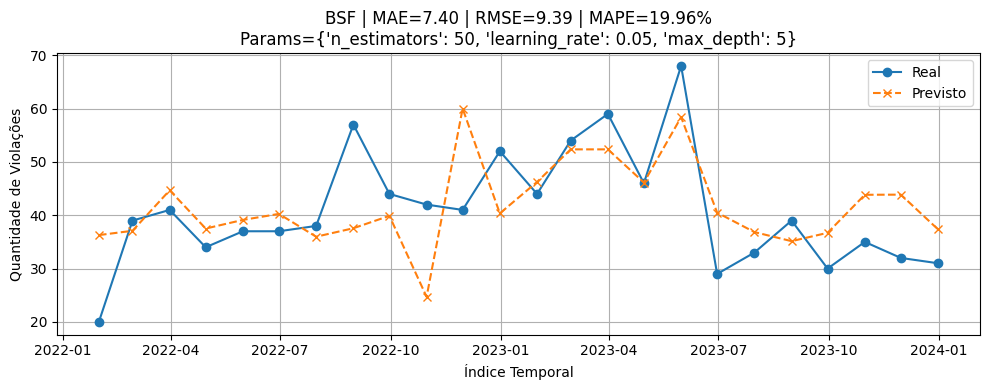


🚩 Iniciando XGBoost para: BSO

📊 Resultados para BSO
MAE:  9.53
RMSE: 13.06
MAPE: 11.40%
Melhores parâmetros: {'n_estimators': 100, 'learning_rate': 0.05, 'max_depth': 3}


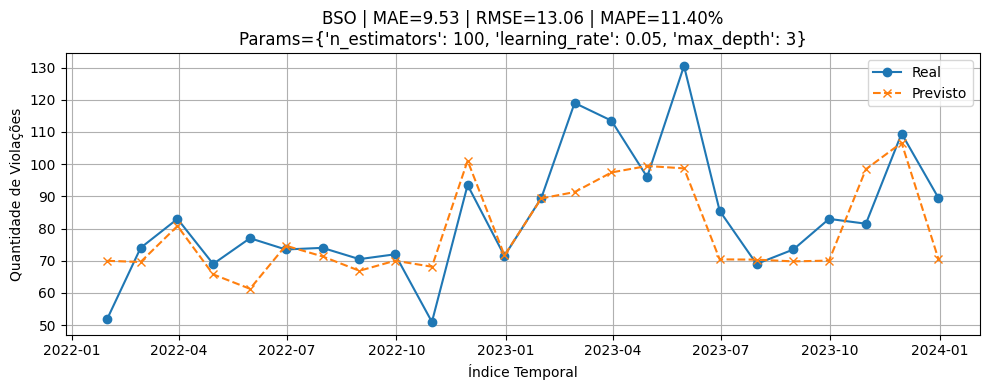


🚩 Iniciando XGBoost para: BSR

📊 Resultados para BSR
MAE:  7.33
RMSE: 9.30
MAPE: 83.34%
Melhores parâmetros: {'n_estimators': 100, 'learning_rate': 0.05, 'max_depth': 3}


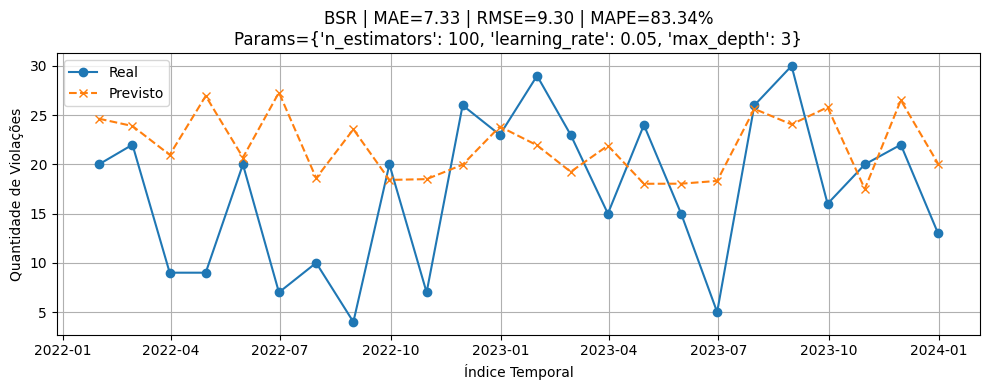


🚩 Iniciando XGBoost para: EDU

📊 Resultados para EDU
MAE:  10.56
RMSE: 12.64
MAPE: 35.47%
Melhores parâmetros: {'n_estimators': 50, 'learning_rate': 0.1, 'max_depth': 3}


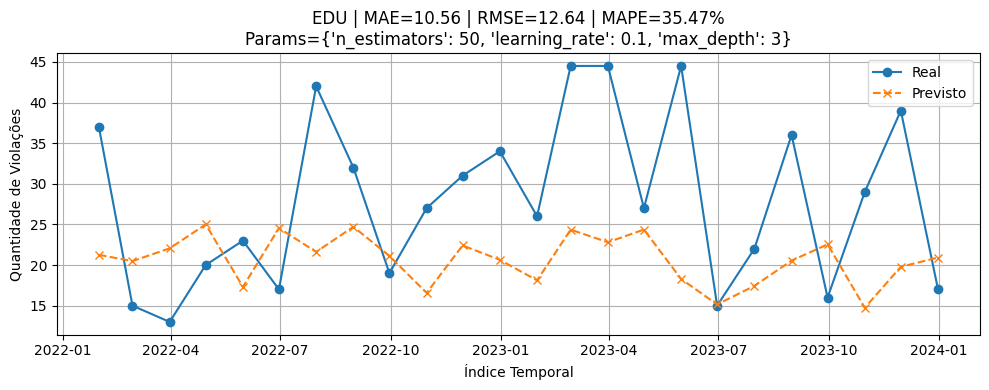


🚩 Iniciando XGBoost para: GOV

📊 Resultados para GOV
MAE:  3.69
RMSE: 4.97
MAPE: 35.03%
Melhores parâmetros: {'n_estimators': 100, 'learning_rate': 0.05, 'max_depth': 3}


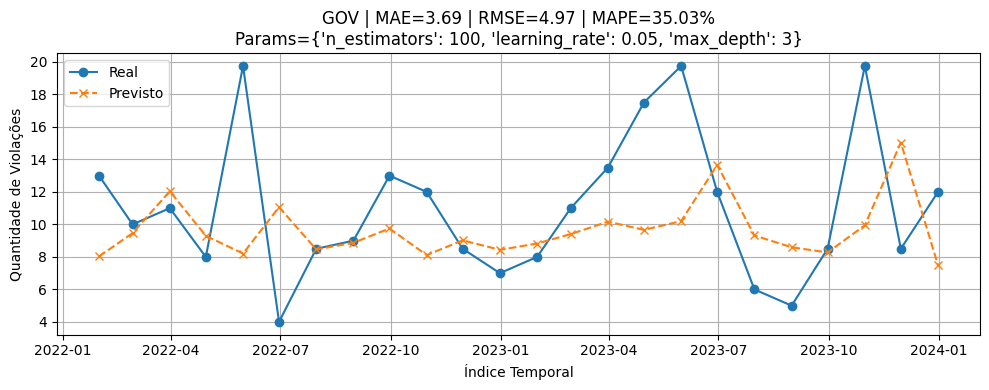


🚩 Iniciando XGBoost para: MED

📊 Resultados para MED
MAE:  12.64
RMSE: 15.41
MAPE: 21.53%
Melhores parâmetros: {'n_estimators': 100, 'learning_rate': 0.1, 'max_depth': 3}


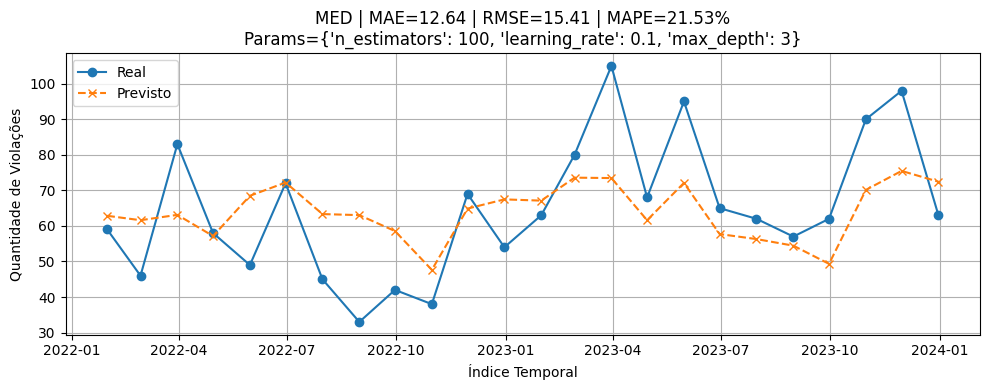


🚩 Iniciando XGBoost para: NGO

📊 Resultados para NGO
MAE:  5.28
RMSE: 6.47
MAPE: 42.10%
Melhores parâmetros: {'n_estimators': 50, 'learning_rate': 0.05, 'max_depth': 3}


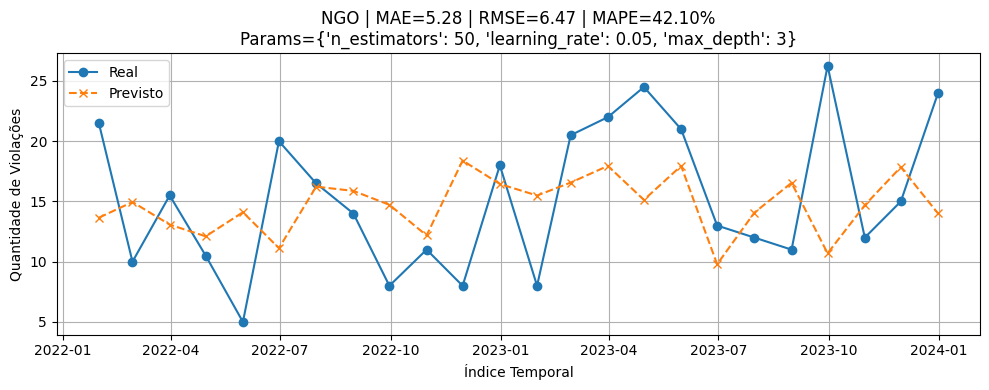


🚩 Iniciando XGBoost para: Total Geral

📊 Resultados para Total Geral
MAE:  23.74
RMSE: 32.80
MAPE: 5.97%
Melhores parâmetros: {'n_estimators': 100, 'learning_rate': 0.1, 'max_depth': 3}


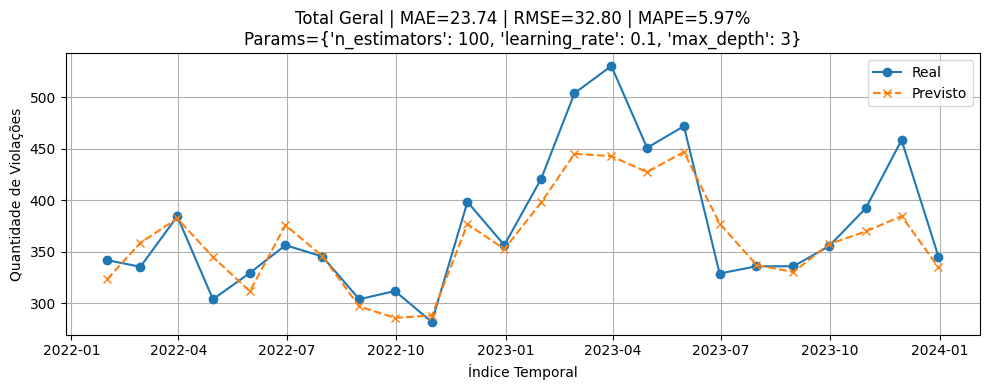


🚩 Iniciando XGBoost para: UNKN

📊 Resultados para UNKN
MAE:  10.07
RMSE: 12.57
MAPE: 10.03%
Melhores parâmetros: {'n_estimators': 50, 'learning_rate': 0.05, 'max_depth': 3}


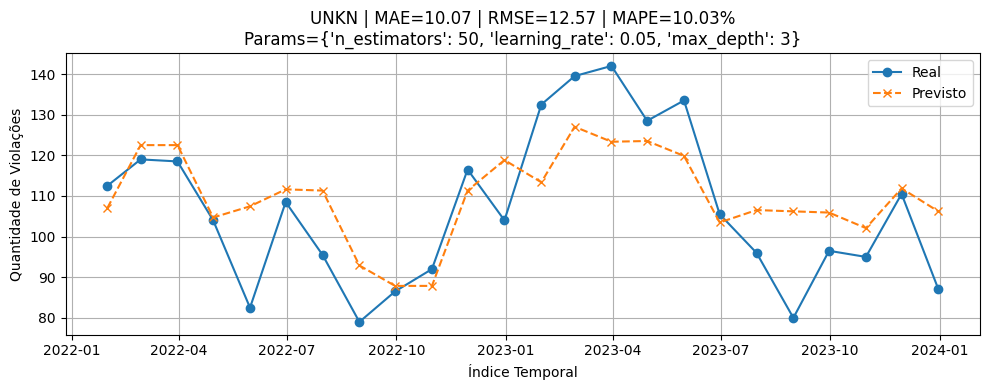


✅ Melhores modelos por série (amostra):
        Coluna    MAE   RMSE  MAPE%  \
0          BSF   7.40   9.39  19.96   
1          BSO   9.53  13.06  11.40   
2          BSR   7.33   9.30  83.34   
3          EDU  10.56  12.64  35.47   
4          GOV   3.69   4.97  35.03   
5          MED  12.64  15.41  21.53   
6          NGO   5.28   6.47  42.10   
7  Total Geral  23.74  32.80   5.97   
8         UNKN  10.07  12.57  10.03   

                                         Best Params   Status  
0  {'n_estimators': 50, 'learning_rate': 0.05, 'm...  Sucesso  
1  {'n_estimators': 100, 'learning_rate': 0.05, '...  Sucesso  
2  {'n_estimators': 100, 'learning_rate': 0.05, '...  Sucesso  
3  {'n_estimators': 50, 'learning_rate': 0.1, 'ma...  Sucesso  
4  {'n_estimators': 100, 'learning_rate': 0.05, '...  Sucesso  
5  {'n_estimators': 100, 'learning_rate': 0.1, 'm...  Sucesso  
6  {'n_estimators': 50, 'learning_rate': 0.05, 'm...  Sucesso  
7  {'n_estimators': 100, 'learning_rate': 0.1, 'm...  Su

In [ ]:
# ==========================================
# 📦 Importações - XGBoost
# ==========================================
import itertools
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_absolute_error, mean_squared_error
from xgboost import XGBRegressor
from google.colab import drive
from datetime import datetime

# ==========================================
# ⚙️ Função para criar features defasadas
# ==========================================
def create_features(df, target_col, lags=12):
    """
    Cria colunas defasadas (lags) para a série temporal.
    Isso permite ao modelo XGBoost aprender padrões temporais.
    """
    df_feat = df.copy()
    for lag in range(1, lags + 1):
        df_feat[f'{target_col}_lag{lag}'] = df_feat[target_col].shift(lag)
    df_feat = df_feat.dropna()
    return df_feat

# ==========================================
# ⚙️ Definição dos Hiperparâmetros para Grid Search
# ==========================================
param_grid = {
    'n_estimators': [50, 100],
    'learning_rate': [0.05, 0.1],
    'max_depth': [3, 5]
}
grid_combinations = list(itertools.product(*param_grid.values()))

# ==========================================
# 📂 Listas para armazenar resultados
# ==========================================
resultados_xgb = []             # Melhores modelos por coluna
grid_search_resultados = []     # Todos os resultados do grid

# ==========================================
# 🚀 Aplicar XGBoost para cada série
# ==========================================
for col in df_filtered.columns:
    print(f"\n🚩 Iniciando XGBoost para: {col}")

    # Criar features defasadas
    df_feat = create_features(df_filtered, col, lags=12)

    if df_feat.empty or df_feat[col].sum() == 0:
        print(f"⚠️ Série {col} sem dados relevantes. Pulando...")
        continue

    # Divide em treino e teste (últimos 24 períodos)
    X = df_feat.drop(columns=[col])
    y = df_feat[col]

    X_train, X_test, y_train, y_test = train_test_split(
        X, y, shuffle=False, test_size=24
    )

    best_model = None
    best_rmse = np.inf
    best_params = None
    best_y_pred = None

    # ==========================================
    # 🔎 Grid Search Manual
    # ==========================================
    for params in grid_combinations:
        param_dict = dict(zip(param_grid.keys(), params))
        try:
            model = XGBRegressor(random_state=42, **param_dict)
            model.fit(X_train, y_train)

            # Previsão
            y_pred = model.predict(X_test)

            # Métricas
            mae = mean_absolute_error(y_test, y_pred)
            rmse = np.sqrt(mean_squared_error(y_test, y_pred))
            mape = np.mean(np.abs((y_test - y_pred) / y_test.replace(0, np.nan))) * 100

            grid_search_resultados.append({
                'Coluna': col,
                'n_estimators': param_dict['n_estimators'],
                'learning_rate': param_dict['learning_rate'],
                'max_depth': param_dict['max_depth'],
                'MAE': round(mae, 2),
                'RMSE': round(rmse, 2),
                'MAPE%': round(mape, 2) if not np.isnan(mape) else 'N/A'
            })

            # Atualiza o melhor modelo
            if rmse < best_rmse:
                best_rmse = rmse
                best_model = model
                best_params = param_dict
                best_y_pred = y_pred

        except Exception as e:
            print(f"⚠️ Erro ao ajustar modelo para {col} com params {param_dict}: {e}")
            continue

    # ==========================================
    # ✅ Melhor modelo encontrado
    # ==========================================
    if best_model is None:
        print(f"⚠️ Nenhum modelo válido para {col}.")
        resultados_xgb.append({
            'Coluna': col,
            'MAE': None,
            'RMSE': None,
            'MAPE%': None,
            'Best Params': None,
            'Status': 'Erro no ajuste'
        })
        continue

    mae = mean_absolute_error(y_test, best_y_pred)
    mape = np.mean(np.abs((y_test - best_y_pred) / y_test.replace(0, np.nan))) * 100

    print(f"\n📊 Resultados para {col}")
    print(f"MAE:  {mae:.2f}")
    print(f"RMSE: {best_rmse:.2f}")
    print(f"MAPE: {mape:.2f}%")
    print(f"Melhores parâmetros: {best_params}")

    # 📈 Gráfico Real vs Previsto
    plt.figure(figsize=(10, 4))
    plt.plot(y_test.index, y_test.values, label='Real', marker='o')
    plt.plot(y_test.index, best_y_pred, label='Previsto', marker='x', linestyle='--')
    plt.title(f"{col} | MAE={mae:.2f} | RMSE={best_rmse:.2f} | MAPE={mape:.2f}%\nParams={best_params}")
    plt.xlabel('Índice Temporal')
    plt.ylabel('Quantidade de Violações')
    plt.legend()
    plt.grid(True)
    plt.tight_layout()
    plt.show()

    resultados_xgb.append({
        'Coluna': col,
        'MAE': round(mae, 2),
        'RMSE': round(best_rmse, 2),
        'MAPE%': round(mape, 2) if not np.isnan(mape) else 'N/A',
        'Best Params': best_params,
        'Status': 'Sucesso'
    })

# ==========================================
# 💾 Consolidação e Exportação dos Resultados - XGBoost
# ==========================================

# Cria DataFrames
df_resultados_xgb = pd.DataFrame(resultados_xgb)

print("\n✅ Melhores modelos por série (amostra):")
print(df_resultados_xgb.head(9))

# ✅ Criar DataFrame com todos os resultados
df_resultados_xgb.to_csv('/content/resultados_xgb.csv', index=False)

df_gridsearch_xgb = pd.DataFrame(grid_search_resultados)
df_gridsearch_xgb.to_csv('/content/gridsearch_xgb.csv', index=False)


In [ ]:
# ==============================================================================
# DEFINIÇÃO DE FUNÇÕES LSTM
# ==============================================================================

import os  # Para manipulação de arquivos e diretórios

# Definir um diretório para salvar os gráficos (opcional)
OUTPUT_DIR = "resultados_lstm"
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

# Funções auxiliares e a função principal de treinamento/avaliação

def create_dataset(dataset, look_back=6):
    """
    Converte uma série temporal em um conjunto de dados para LSTM.

    Args:
        dataset: A série temporal (array numpy normalizado).
        look_back: O número de passos anteriores a serem usados para prever o próximo passo.

    Returns:
        Uma tupla contendo os dados de entrada (X) e os dados de saída (y).
    """
    X, y = [], []
    # Garante que não tentamos acessar índices negativos ou além do limite
    if len(dataset) <= look_back:
        return np.array(X), np.array(y) # Retorna arrays vazios se não houver dados suficientes

    for i in range(len(dataset) - look_back):
        a = dataset[i:(i + look_back), 0] # Pega a fatia correta
        X.append(a)
        y.append(dataset[i + look_back, 0]) # Pega o valor alvo
    return np.array(X), np.array(y)

# --- Função Principal Modificada ---
def treinar_e_avaliar_lstm(serie_scaled, look_back, epochs, batch_size, test_size, setor, scaler, output_dir=OUTPUT_DIR):
    """
    Treina um modelo LSTM, avalia seu desempenho, gera, salva e exibe um gráfico.
    AGORA ACEITA test_size COMO ARGUMENTO.

    Args:
        serie_scaled: A série temporal normalizada.
        look_back: O número de passos anteriores (janela).
        epochs: O número de épocas de treinamento.
        batch_size: O tamanho do lote para o treinamento.
        test_size: O número de pontos de dados a serem usados para teste. <<< NOVO ARGUMENTO
        setor: O nome do setor.
        scaler: O objeto MinMaxScaler.
        output_dir: O diretório para salvar os gráficos.

    Returns:
        Um dicionário com as métricas ou None se houver falha.
    """
    # Cria o dataset para o LSTM
    X, y = create_dataset(serie_scaled, look_back)

    # Define o tamanho do conjunto de teste (últimos 'test_size' meses) <<< USA O ARGUMENTO
    # test_size = 24 <<< REMOVIDO - agora vem como argumento

    # Verifica se há dados suficientes para criar treino E teste
    if len(X) < test_size + 1: # Precisa de pelo menos 1 amostra de treino
        print(f"⚠️ Aviso: Dados insuficientes ({len(X)} amostras) para treino/teste com look_back={look_back} e test_size={test_size} no setor '{setor}'.")
        return None # Retorna None para indicar falha

    # Separa em treino e teste usando o test_size fornecido
    X_train, X_test = X[:-test_size], X[-test_size:]
    y_train, y_test = y[:-test_size], y[-test_size:]

    # Verifica se o conjunto de treino não ficou vazio
    if X_train.shape[0] == 0:
        print(f"⚠️ Aviso: Conjunto de treino vazio para look_back={look_back} e test_size={test_size} no setor '{setor}'.")
        return None # Retorna None para indicar falha

    # Reshape para o formato do LSTM [samples, time steps, features]
    X_train = X_train.reshape(X_train.shape[0], look_back, 1)
    X_test = X_test.reshape(X_test.shape[0], look_back, 1)

    # Constrói o modelo LSTM
    model = Sequential()
    # Considerar ajustar a ativação ou unidades LSTM se necessário
    model.add(LSTM(50, activation='relu', input_shape=(look_back, 1)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')

    # Treina o modelo
    model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

    # Faz as previsões no conjunto de teste
    y_pred_scaled = model.predict(X_test)

    # Inversão da normalização
    y_pred = scaler.inverse_transform(y_pred_scaled)
    y_pred = np.clip(y_pred, 0, None) # Garante não negatividade
    y_real = scaler.inverse_transform(y_test.reshape(-1, 1))

    # Cálculo das Métricas
    mae = mean_absolute_error(y_real, y_pred)
    rmse = np.sqrt(mean_squared_error(y_real, y_pred))
    mask = y_real != 0
    y_real_filt = y_real[mask].flatten()
    y_pred_filt = y_pred[mask].flatten()
    if len(y_real_filt) > 0:
        mape = np.mean(np.abs((y_real_filt - y_pred_filt) / y_real_filt)) * 100
    else:
        mape = np.nan

    # --- Geração, Salvamento e Exibição do Gráfico ---
    plt.figure(figsize=(12, 5))
    plt.plot(y_real, label='Real', marker='o', linestyle='-', markersize=5)
    plt.plot(y_pred, label='Previsto (LSTM)', marker='x', linestyle='--', markersize=5)
    mape_title_str = f"{mape:.2f}%" if not np.isnan(mape) else "N/A"
    # <<< ATUALIZADO: Inclui test_size no título
    plt.title(f'Setor: {setor} - Real vs. Previsto\n(MAPE: {mape_title_str} | LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size})')
    plt.xlabel(f'Meses (Período de Teste - {test_size} pontos)') # Indica o tamanho do teste
    plt.ylabel('Número de Violações de Dados')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()

    # 1. Salvar o gráfico em arquivo <<< ATUALIZADO: Inclui test_size no nome
    filename = f"{setor}_lb{look_back}_ep{epochs}_bs{batch_size}_ts{test_size}.png"
    filepath = os.path.join(output_dir, filename)
    try:
        plt.savefig(filepath)
    except Exception as e:
        print(f"Erro ao salvar gráfico {filepath}: {e}")

    # 2. Mostrar o gráfico na saída da célula
    plt.show()

    # 3. Fechar a figura para liberar memória
    plt.close()
    # --- Fim da seção do gráfico ---

    # Retornar as métricas calculadas
    return {'MAE': round(mae, 2), 'RMSE': round(rmse, 2), 'MAPE (%)': round(mape, 2) if not np.isnan(mape) else np.nan}
#-----------------------------------
# Definição do Grid Search
# Lista completa dos setores a serem analisados (ajuste conforme necessário)
setores = ['BSF','BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral','UNKN']
print(f"Setores a serem analisados: {setores}")

# --- Definição dos Hiperparâmetros para Grid Search ---
look_back_values = [6, 12, 18]
epochs_values = [200, 300, 100]
batch_sizes = [16, 32, 64]
test_size_values = [24]#,18, 30] # <<< NOVO: Adicionando os tamanhos de teste desejados

print(f"\nGrade de Hiperparâmetros:")
print(f"  Look Backs: {look_back_values}")
print(f"  Epochs: {epochs_values}")
print(f"  Batch Sizes: {batch_sizes}")
print(f"  Test Sizes: {test_size_values}")

# Gera todas as combinações possíveis, incluindo test_size
param_grid = list(product(look_back_values, epochs_values, batch_sizes, test_size_values))
print(f"\nTotal de combinações de hiperparâmetros a serem testadas: {len(param_grid)}")
# print(f"Primeiras combinações: {param_grid[:5]}") # Opcional: ver as primeiras combinações

Setores a serem analisados: ['BSF', 'BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral', 'UNKN']

Grade de Hiperparâmetros:
  Look Backs: [6, 12, 18]
  Epochs: [200, 300, 100]
  Batch Sizes: [16, 32, 64]
  Test Sizes: [24]

Total de combinações de hiperparâmetros a serem testadas: 27


Verificação inicial usará MAX_TEST_SET_SIZE = 24

==================== INICIANDO TREINAMENTO PARA SETOR: BSF ====================
Iniciando Grid Search para o setor: BSF (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


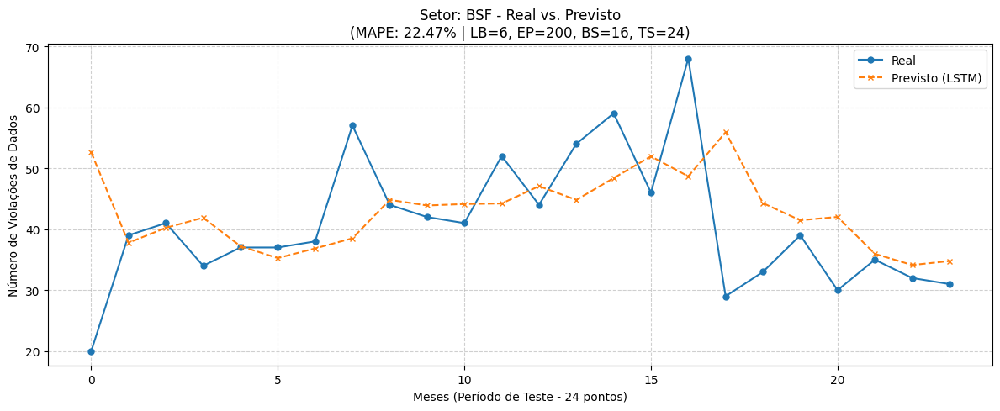

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=200, BS=16, TS=24]:
   MAE : 7.73
   RMSE: 11.52
   MAPE: 22.47%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


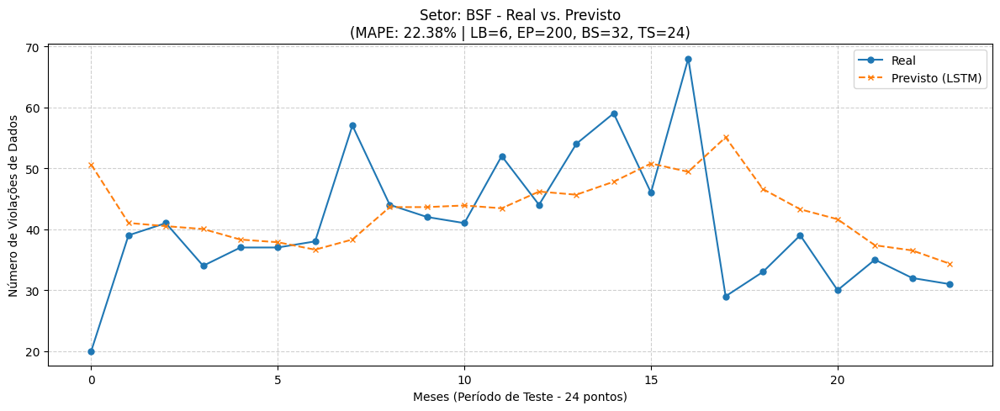

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=200, BS=32, TS=24]:
   MAE : 7.74
   RMSE: 11.25
   MAPE: 22.38%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


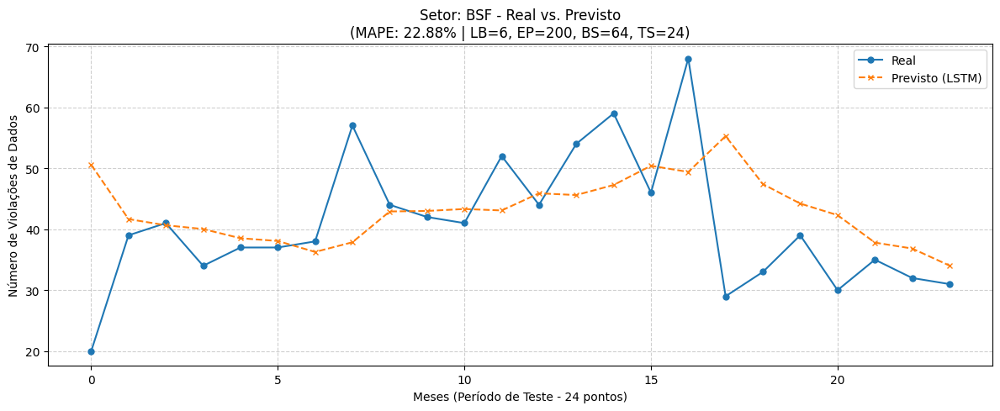

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=200, BS=64, TS=24]:
   MAE : 7.93
   RMSE: 11.42
   MAPE: 22.88%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step


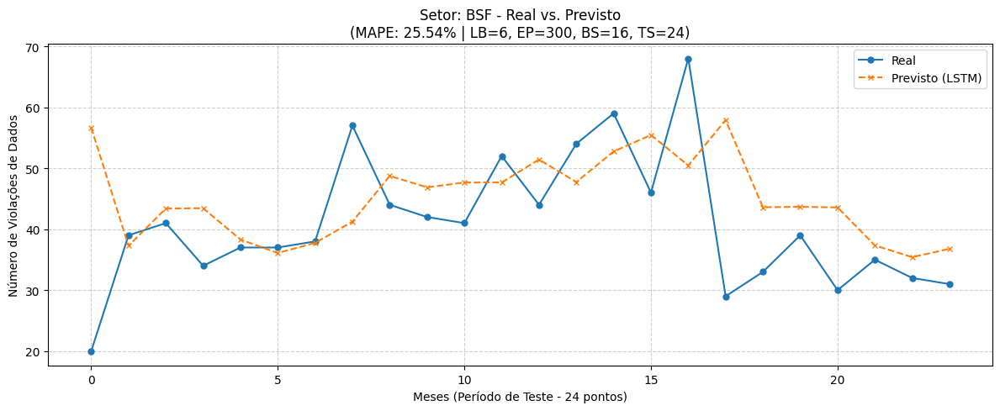

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=300, BS=16, TS=24]:
   MAE : 8.55
   RMSE: 12.14
   MAPE: 25.54%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


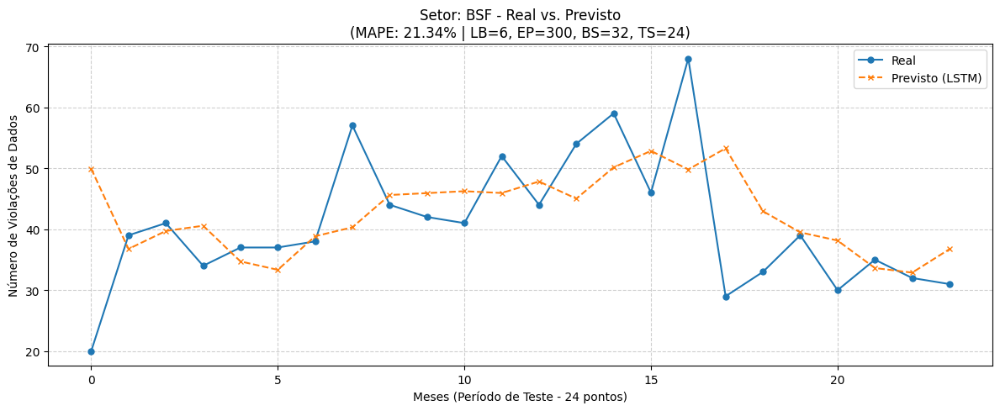

/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=300, BS=32, TS=24]:
   MAE : 7.41
   RMSE: 10.54
   MAPE: 21.34%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


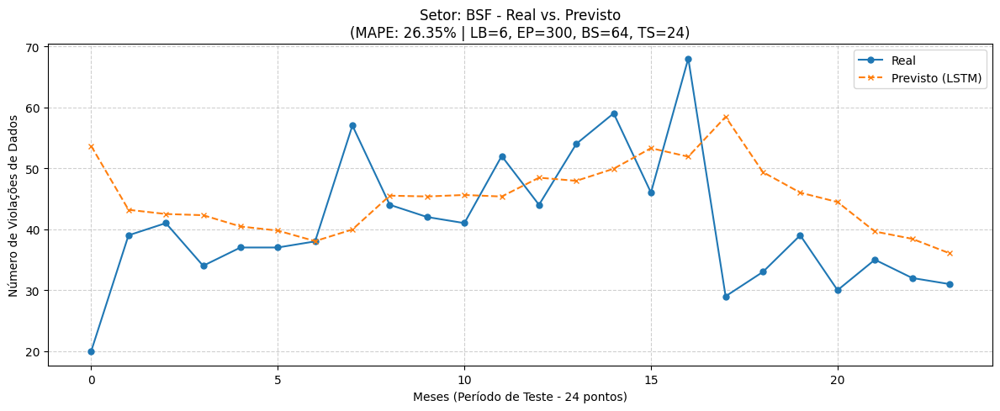

/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=300, BS=64, TS=24]:
   MAE : 8.89
   RMSE: 12.15
   MAPE: 26.35%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


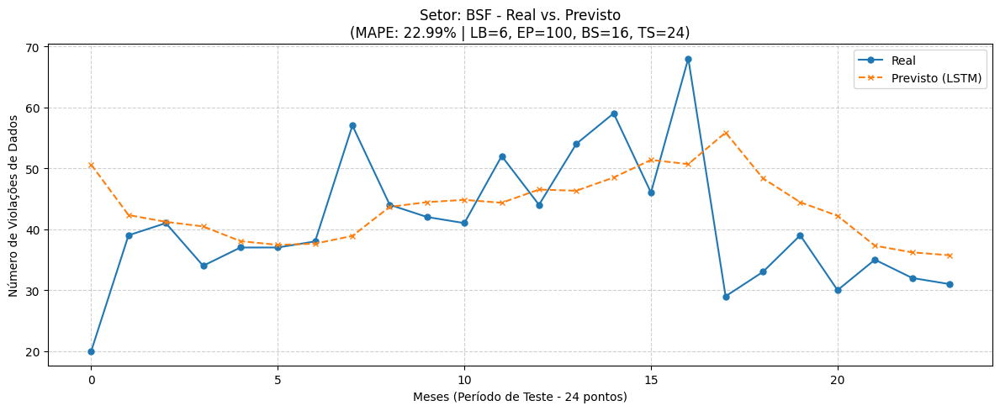

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=100, BS=16, TS=24]:
   MAE : 7.88
   RMSE: 11.33
   MAPE: 22.99%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


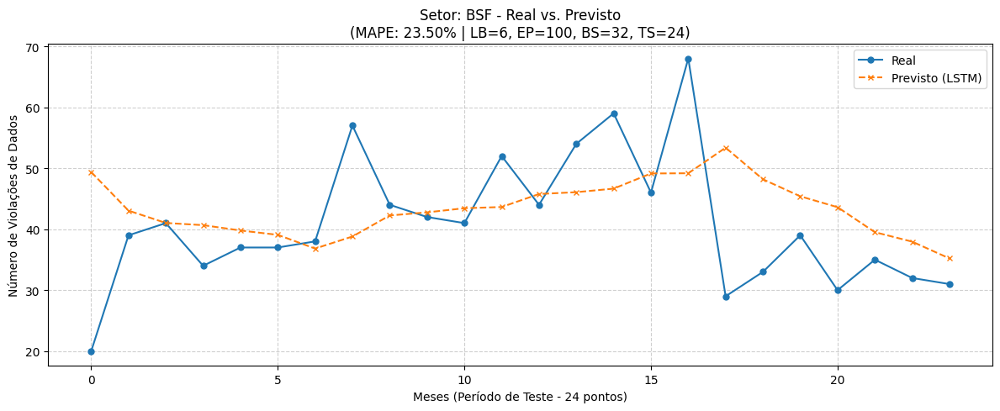

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=100, BS=32, TS=24]:
   MAE : 8.16
   RMSE: 11.28
   MAPE: 23.50%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


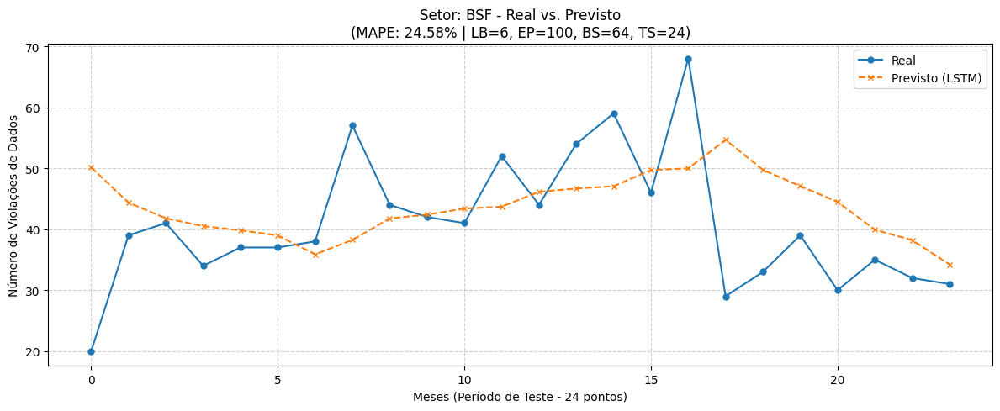

--------------------------------------------------
📊 Resultados para BSF [LB=6, EP=100, BS=64, TS=24]:
   MAE : 8.51
   RMSE: 11.64
   MAPE: 24.58%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


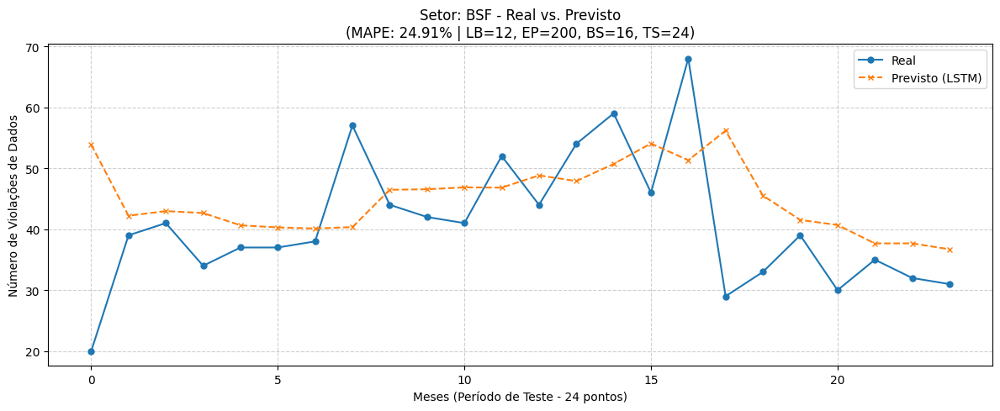

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=200, BS=16, TS=24]:
   MAE : 8.43
   RMSE: 11.53
   MAPE: 24.91%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


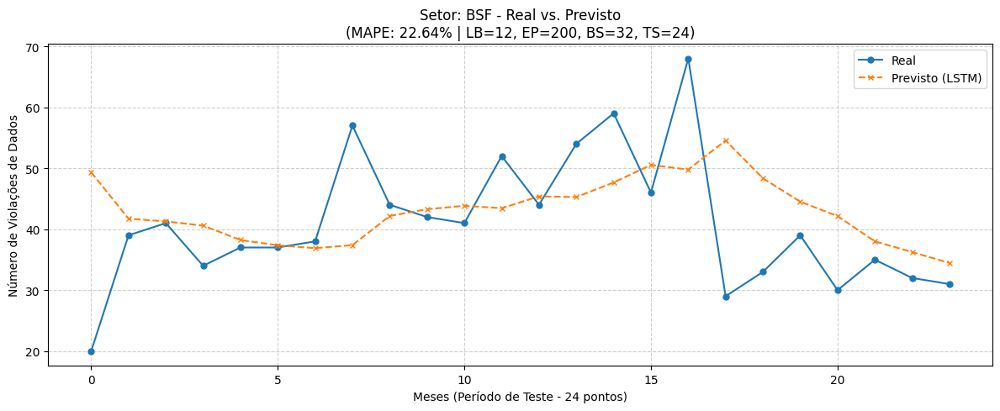

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=200, BS=32, TS=24]:
   MAE : 7.88
   RMSE: 11.27
   MAPE: 22.64%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


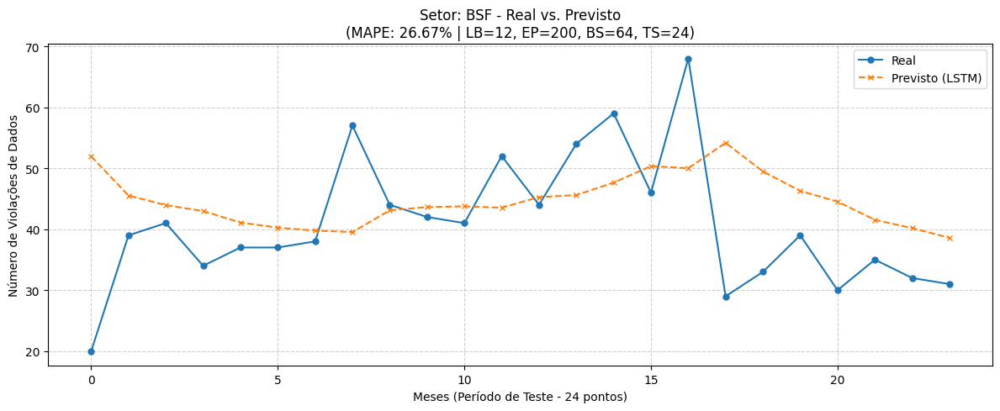

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=200, BS=64, TS=24]:
   MAE : 9.16
   RMSE: 11.99
   MAPE: 26.67%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


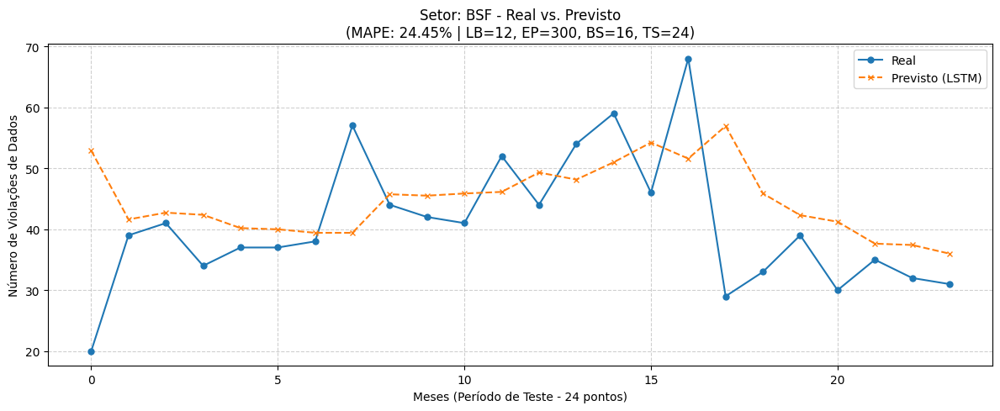

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=300, BS=16, TS=24]:
   MAE : 8.29
   RMSE: 11.50
   MAPE: 24.45%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


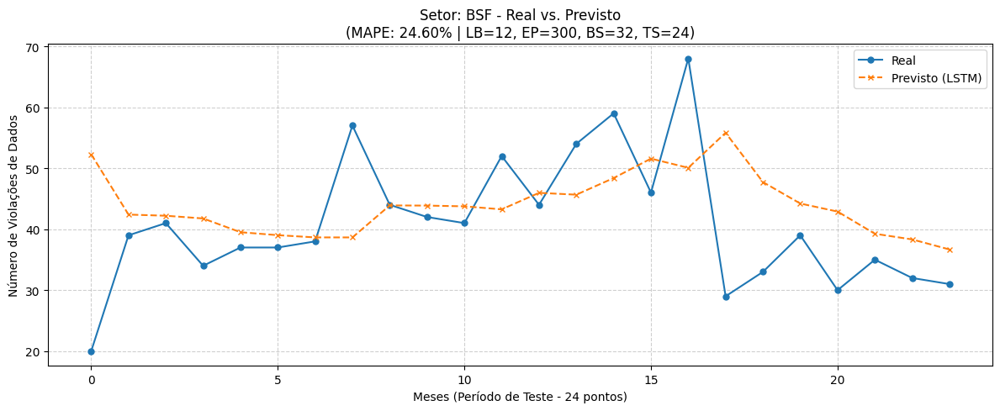

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=300, BS=32, TS=24]:
   MAE : 8.42
   RMSE: 11.74
   MAPE: 24.60%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


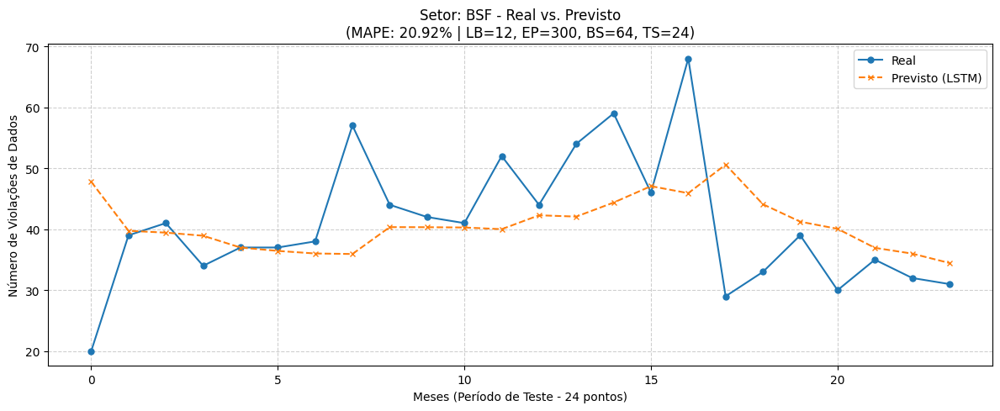

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=300, BS=64, TS=24]:
   MAE : 7.60
   RMSE: 11.15
   MAPE: 20.92%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


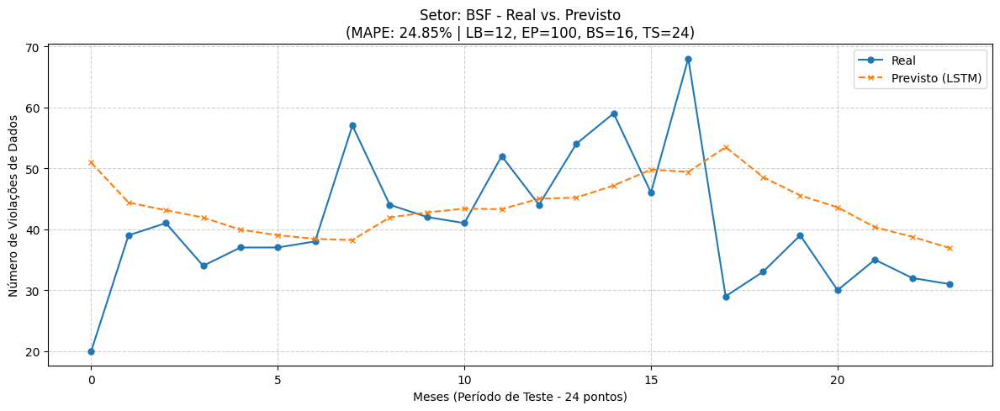

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=100, BS=16, TS=24]:
   MAE : 8.61
   RMSE: 11.65
   MAPE: 24.85%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


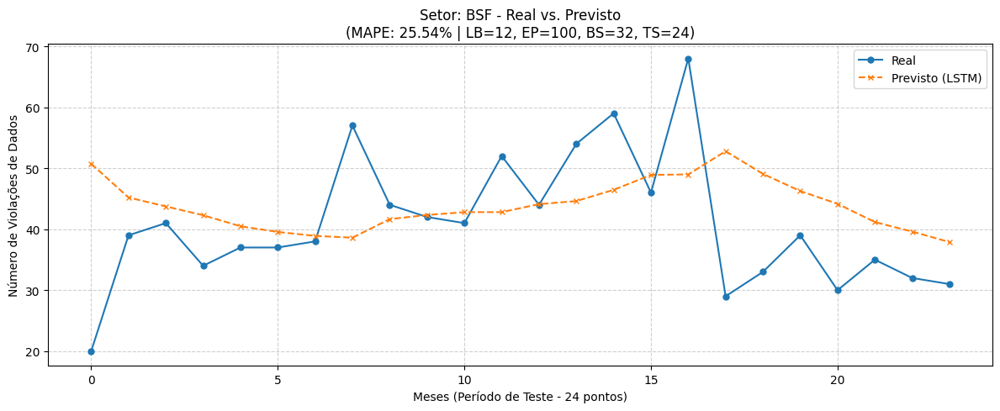

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=100, BS=32, TS=24]:
   MAE : 8.87
   RMSE: 11.81
   MAPE: 25.54%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step


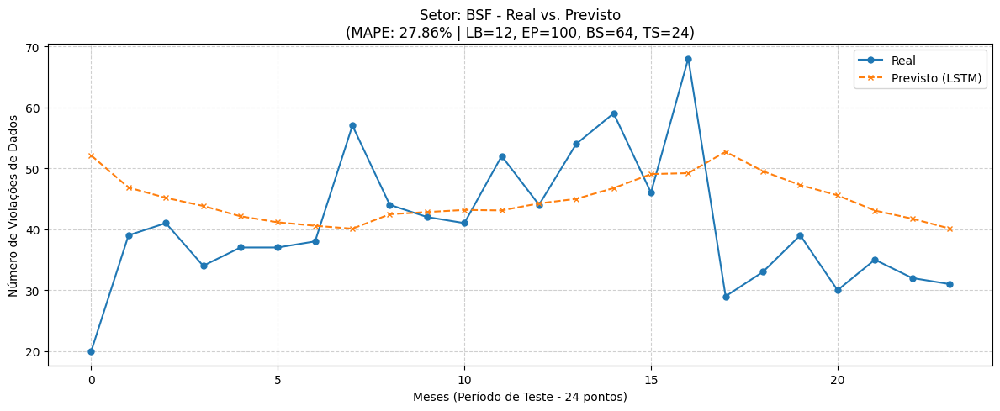

--------------------------------------------------
📊 Resultados para BSF [LB=12, EP=100, BS=64, TS=24]:
   MAE : 9.60
   RMSE: 12.26
   MAPE: 27.86%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


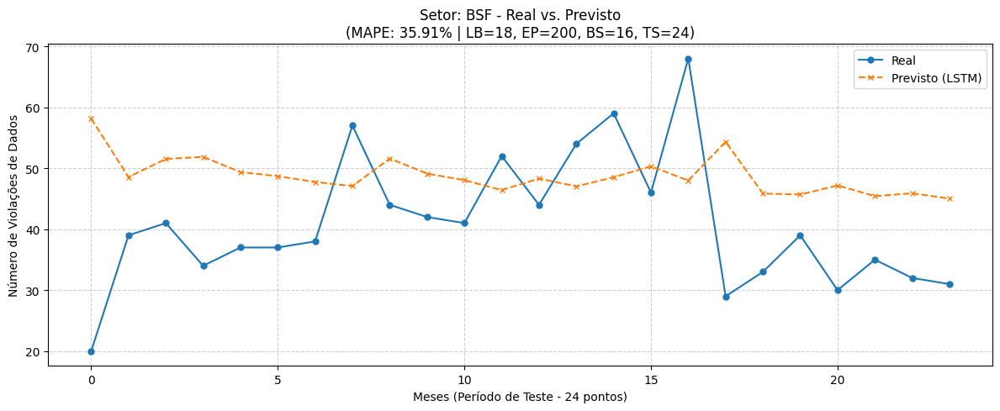

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=200, BS=16, TS=24]:
   MAE : 12.23
   RMSE: 14.27
   MAPE: 35.91%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


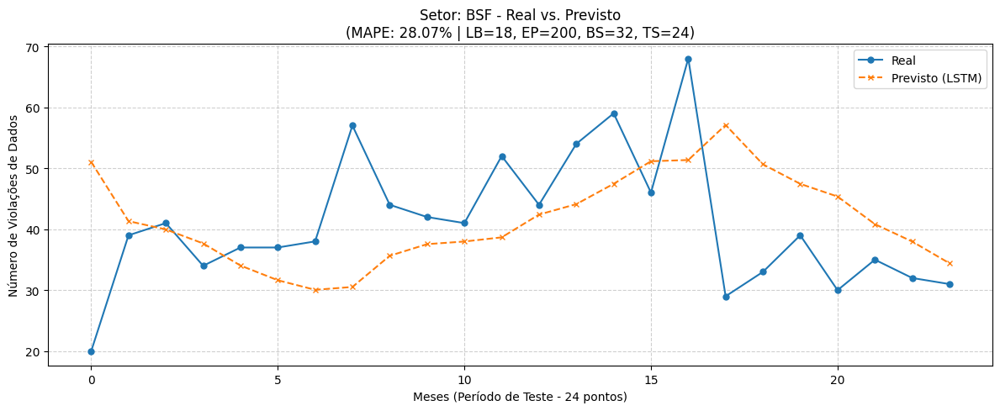

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=200, BS=32, TS=24]:
   MAE : 9.98
   RMSE: 13.05
   MAPE: 28.07%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


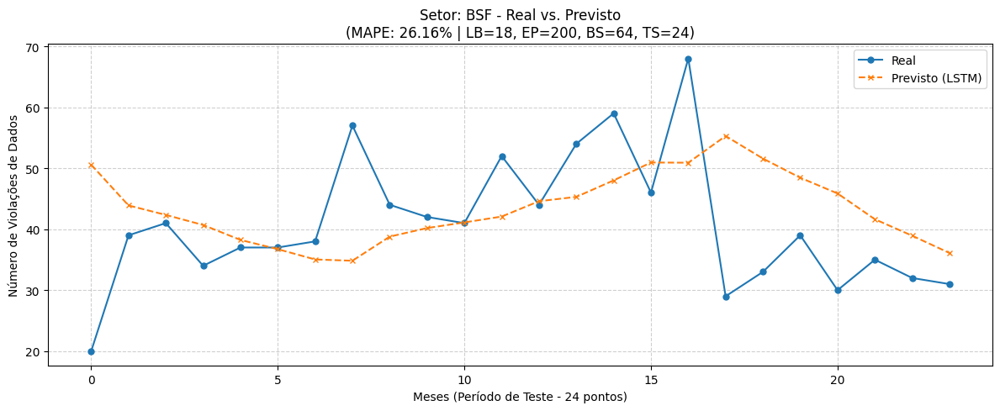

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=200, BS=64, TS=24]:
   MAE : 9.10
   RMSE: 12.32
   MAPE: 26.16%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


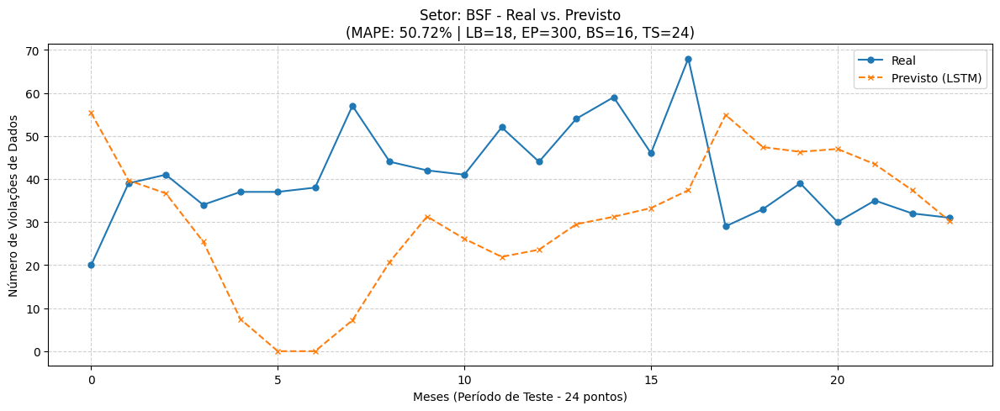

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=300, BS=16, TS=24]:
   MAE : 19.89
   RMSE: 23.72
   MAPE: 50.72%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


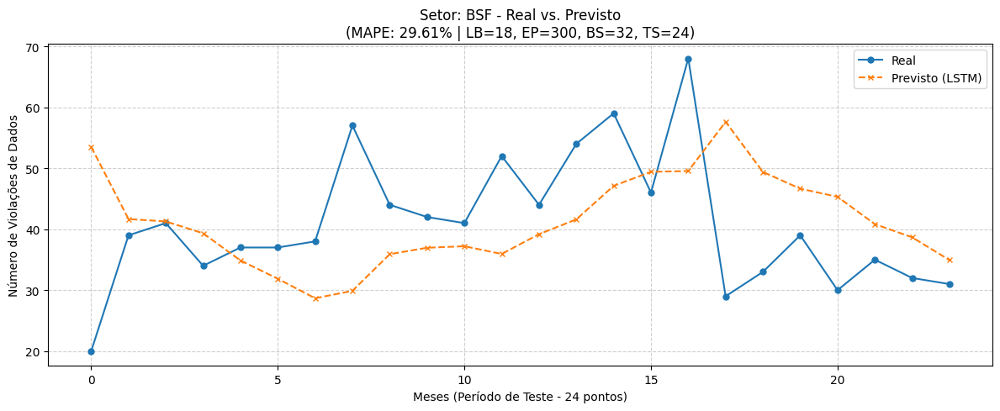

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=300, BS=32, TS=24]:
   MAE : 10.57
   RMSE: 13.72
   MAPE: 29.61%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


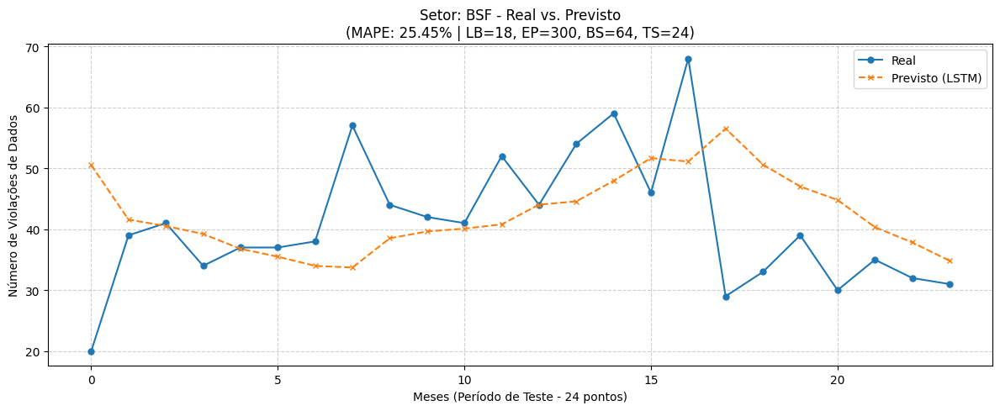

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=300, BS=64, TS=24]:
   MAE : 8.91
   RMSE: 12.32
   MAPE: 25.45%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


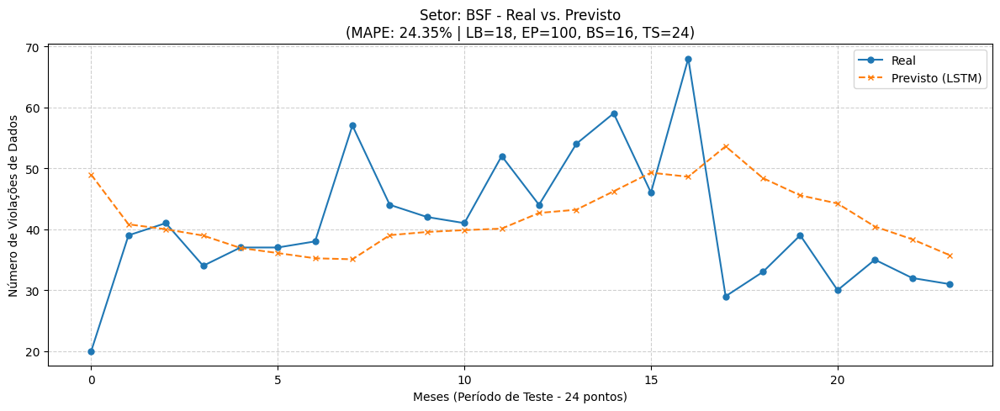

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=100, BS=16, TS=24]:
   MAE : 8.66
   RMSE: 11.86
   MAPE: 24.35%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


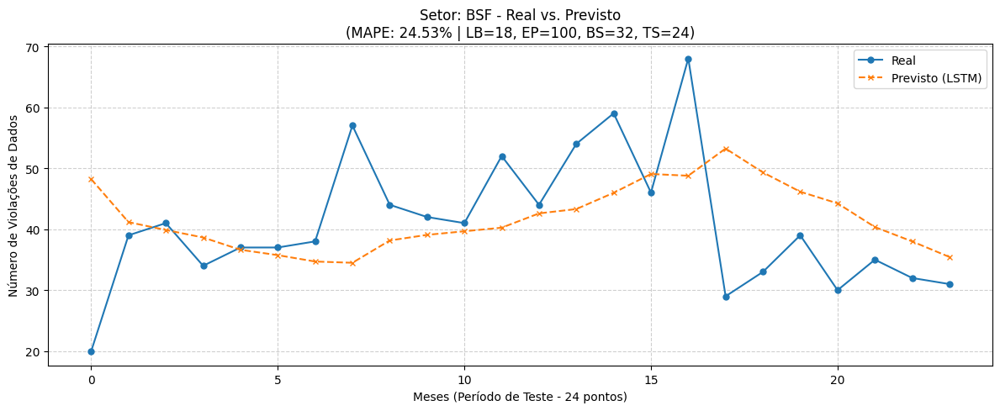

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=100, BS=32, TS=24]:
   MAE : 8.77
   RMSE: 11.87
   MAPE: 24.53%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


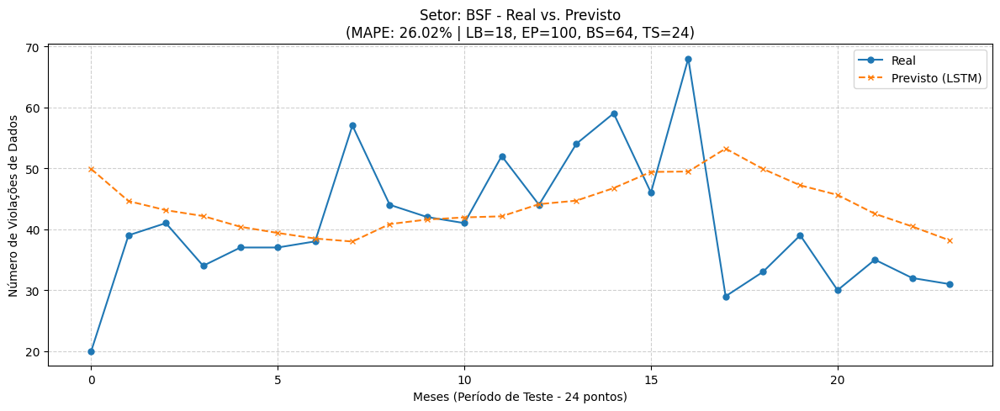

--------------------------------------------------
📊 Resultados para BSF [LB=18, EP=100, BS=64, TS=24]:
   MAE : 9.05
   RMSE: 11.97
   MAPE: 26.02%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: BSO ====================
Iniciando Grid Search para o setor: BSO (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


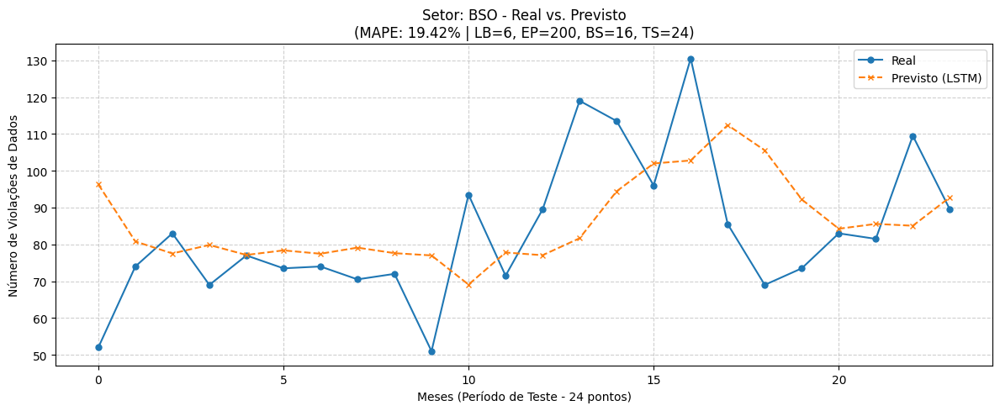

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=200, BS=16, TS=24]:
   MAE : 15.19
   RMSE: 19.75
   MAPE: 19.42%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


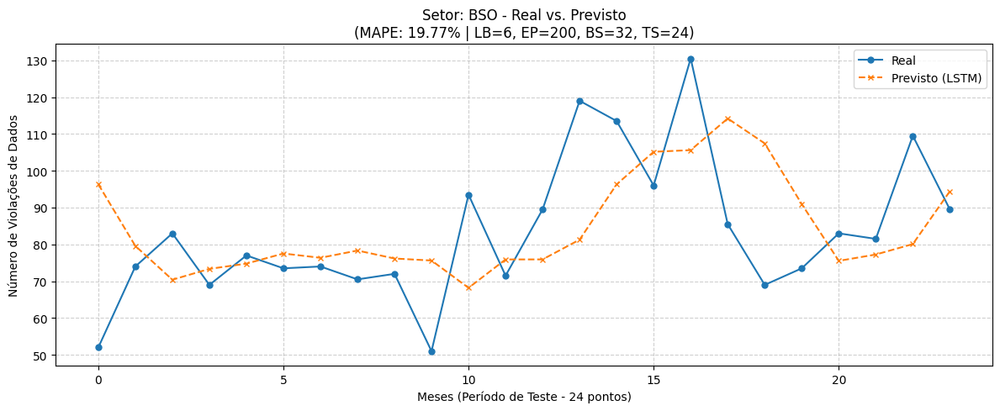

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=200, BS=32, TS=24]:
   MAE : 15.62
   RMSE: 20.12
   MAPE: 19.77%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


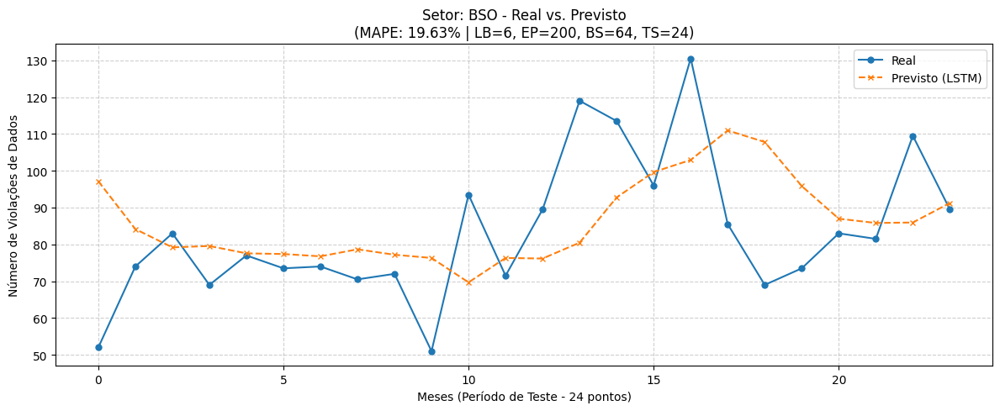

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=200, BS=64, TS=24]:
   MAE : 15.34
   RMSE: 20.13
   MAPE: 19.63%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


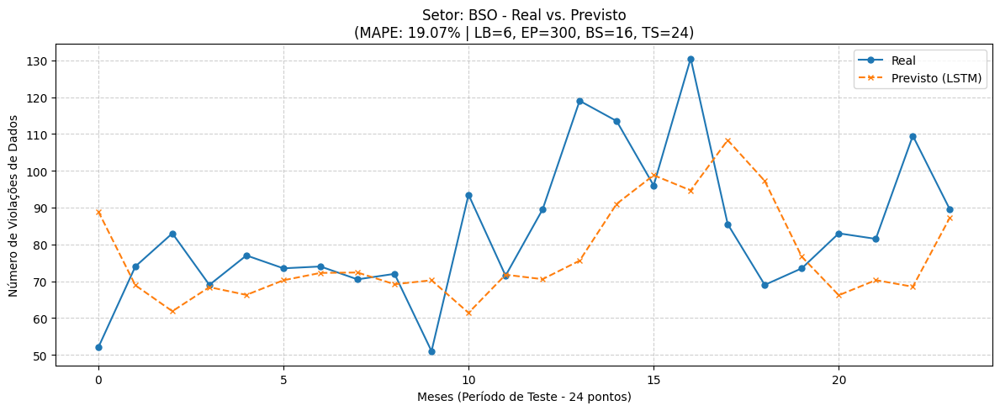

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=300, BS=16, TS=24]:
   MAE : 16.03
   RMSE: 21.26
   MAPE: 19.07%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


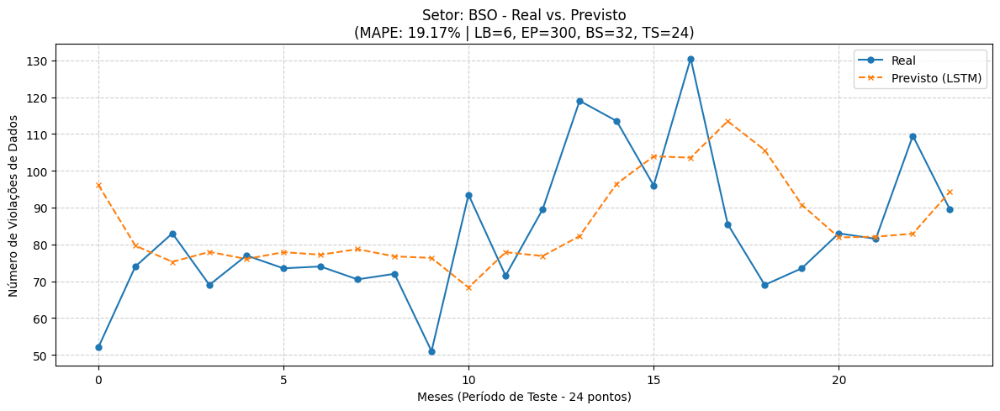

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=300, BS=32, TS=24]:
   MAE : 15.05
   RMSE: 19.69
   MAPE: 19.17%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


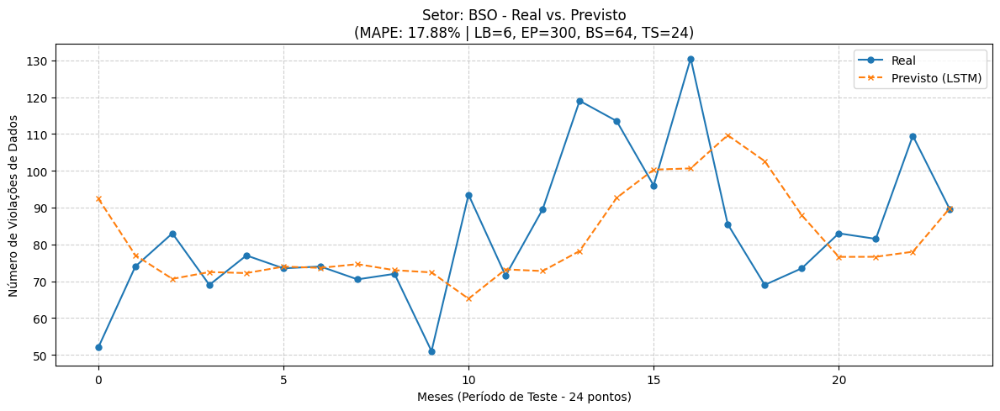

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=300, BS=64, TS=24]:
   MAE : 14.55
   RMSE: 19.77
   MAPE: 17.88%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


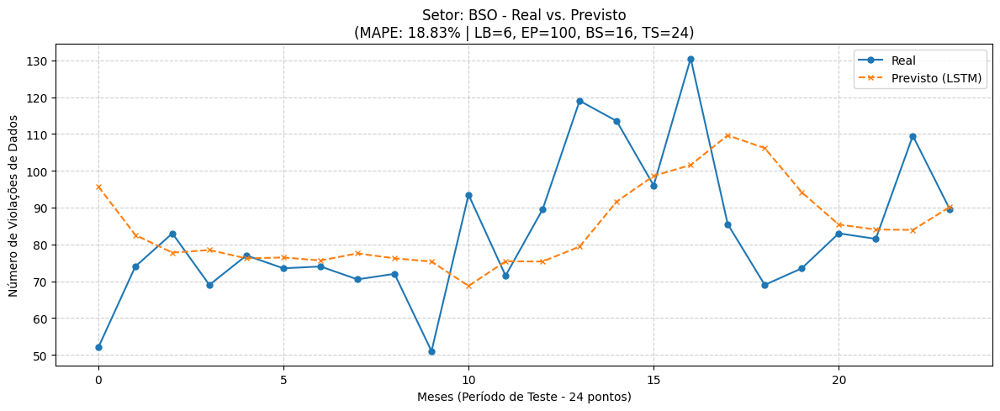

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=100, BS=16, TS=24]:
   MAE : 14.87
   RMSE: 19.95
   MAPE: 18.83%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


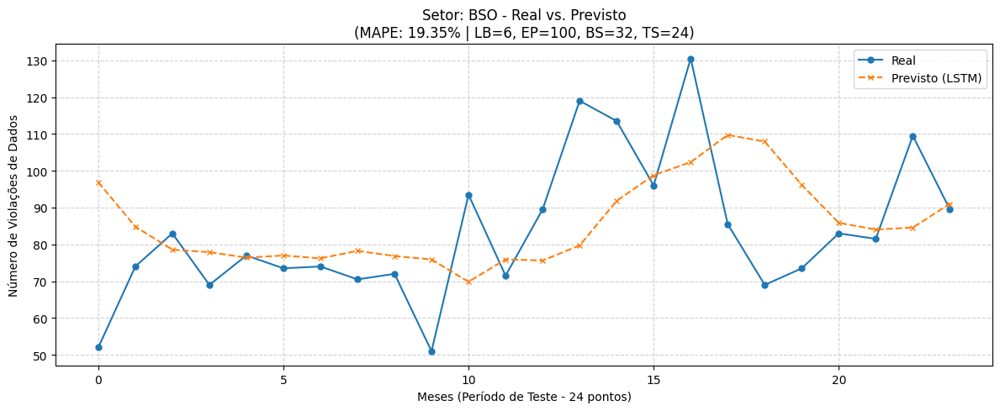

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=100, BS=32, TS=24]:
   MAE : 15.18
   RMSE: 20.20
   MAPE: 19.35%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


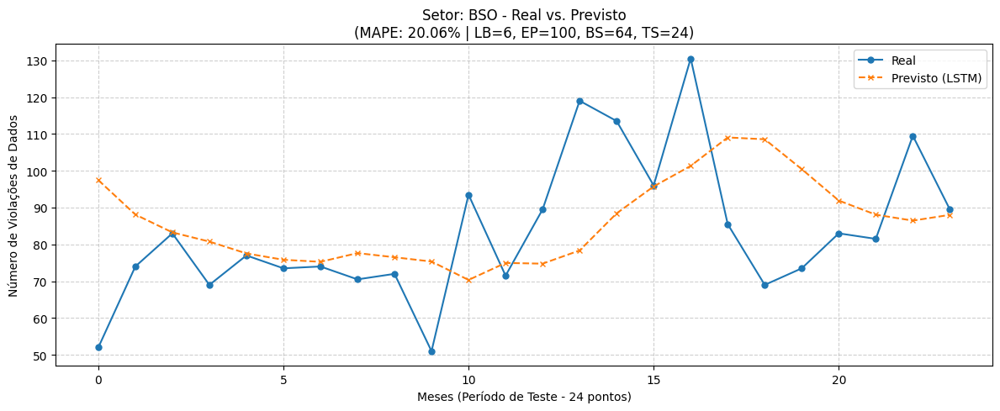

--------------------------------------------------
📊 Resultados para BSO [LB=6, EP=100, BS=64, TS=24]:
   MAE : 15.76
   RMSE: 20.89
   MAPE: 20.06%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


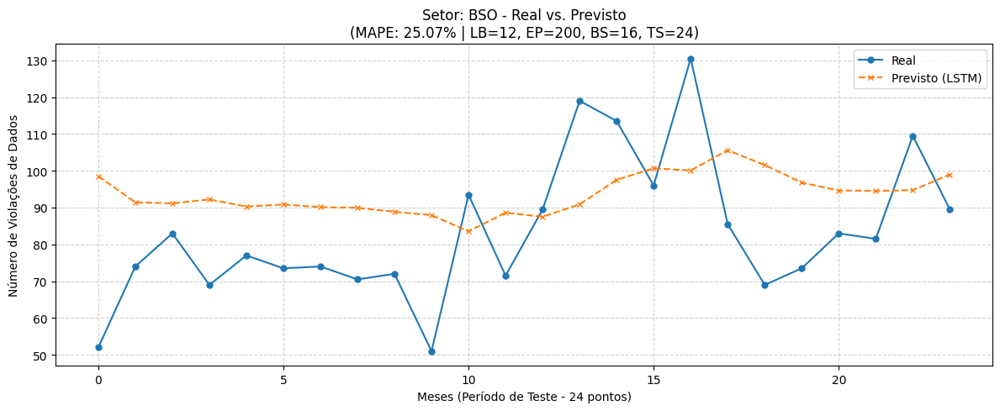

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=200, BS=16, TS=24]:
   MAE : 18.68
   RMSE: 21.26
   MAPE: 25.07%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


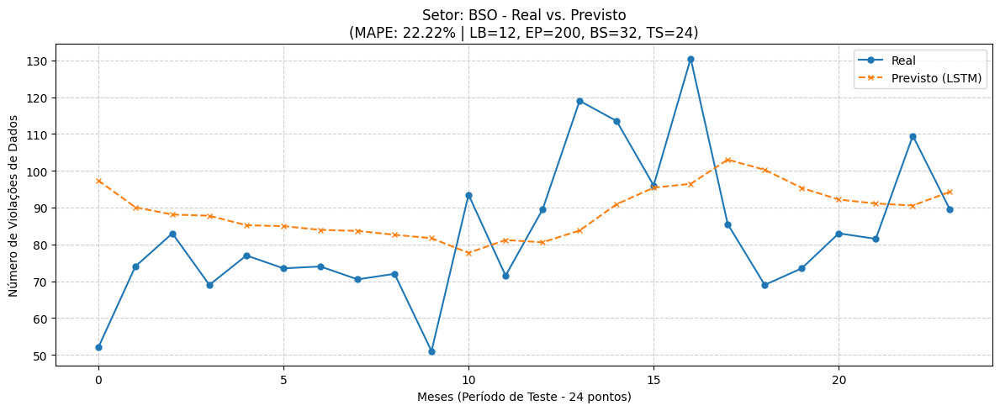

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=200, BS=32, TS=24]:
   MAE : 17.06
   RMSE: 20.28
   MAPE: 22.22%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


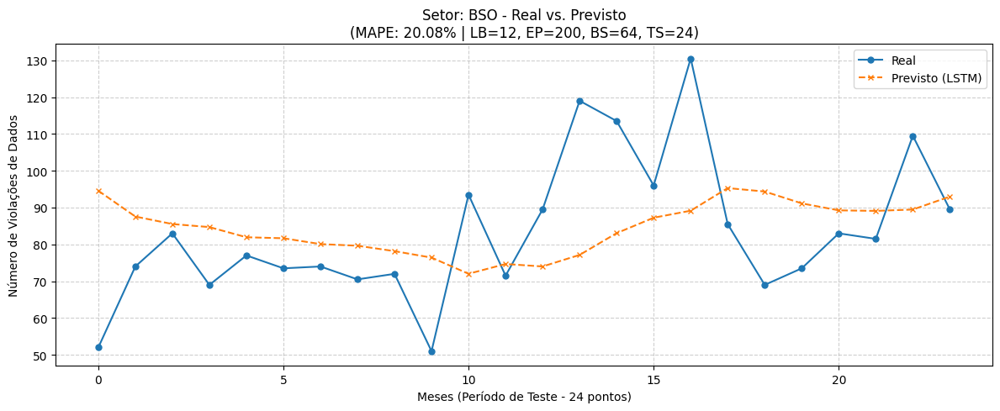

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=200, BS=64, TS=24]:
   MAE : 16.12
   RMSE: 20.29
   MAPE: 20.08%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


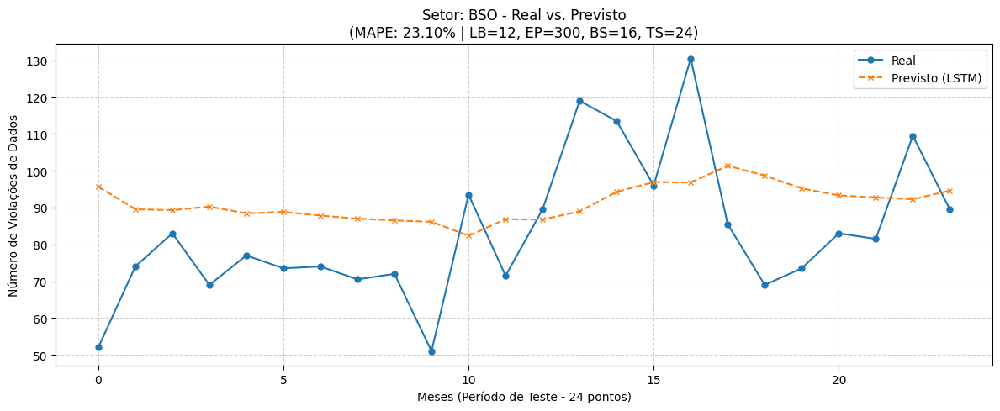

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=300, BS=16, TS=24]:
   MAE : 17.41
   RMSE: 20.26
   MAPE: 23.10%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


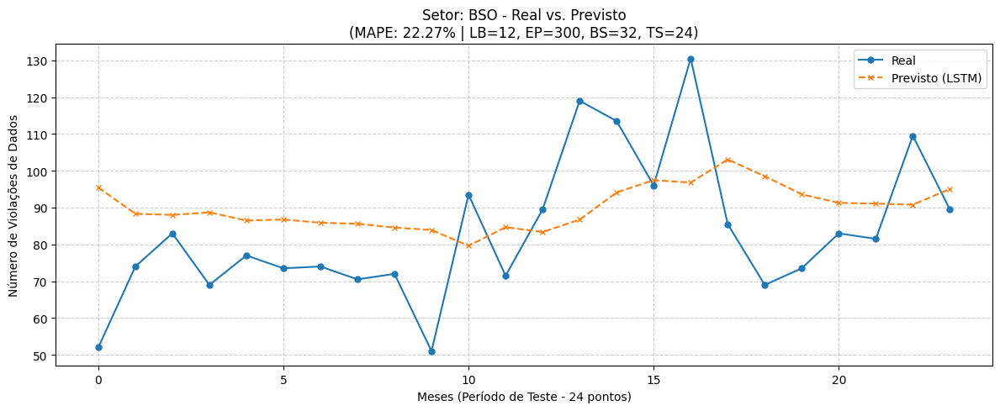

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=300, BS=32, TS=24]:
   MAE : 16.95
   RMSE: 19.86
   MAPE: 22.27%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


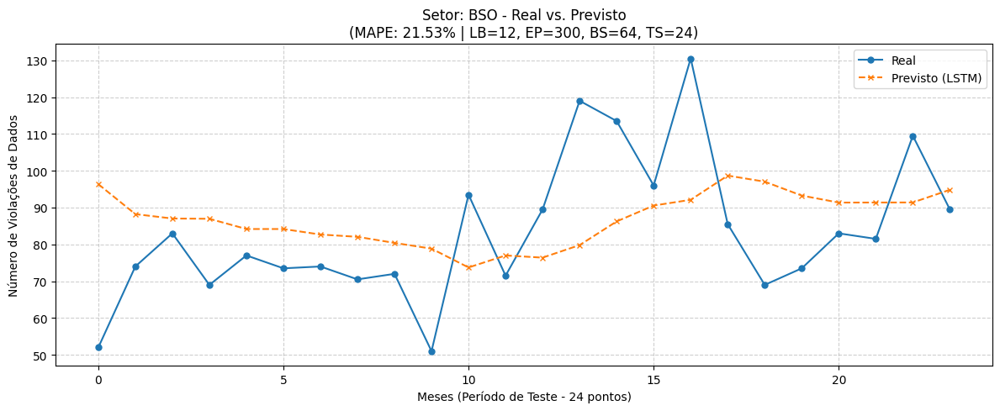

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=300, BS=64, TS=24]:
   MAE : 16.92
   RMSE: 20.39
   MAPE: 21.53%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


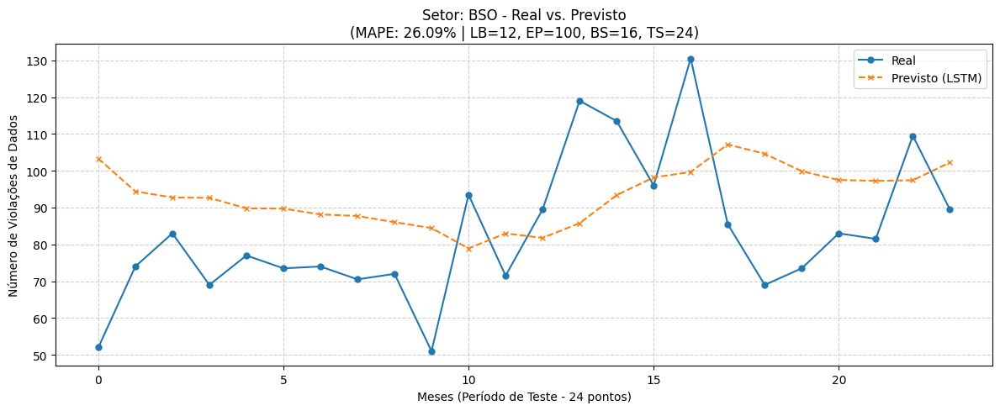

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=100, BS=16, TS=24]:
   MAE : 19.66
   RMSE: 22.37
   MAPE: 26.09%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


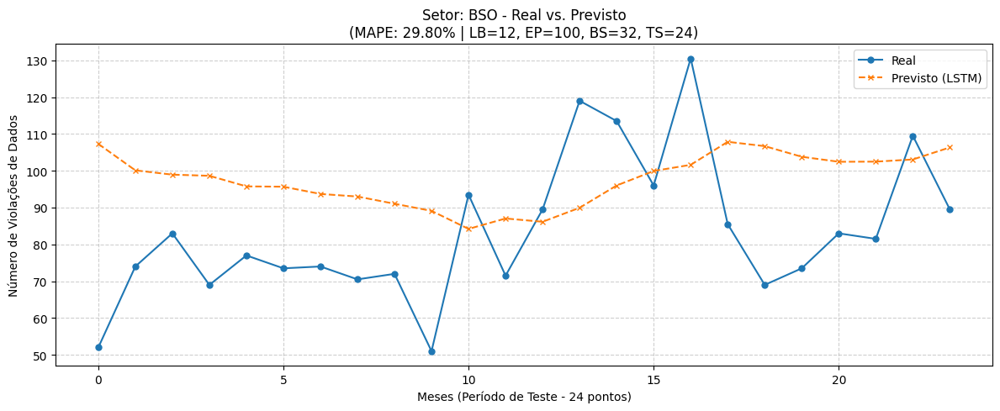

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=100, BS=32, TS=24]:
   MAE : 22.03
   RMSE: 24.79
   MAPE: 29.80%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


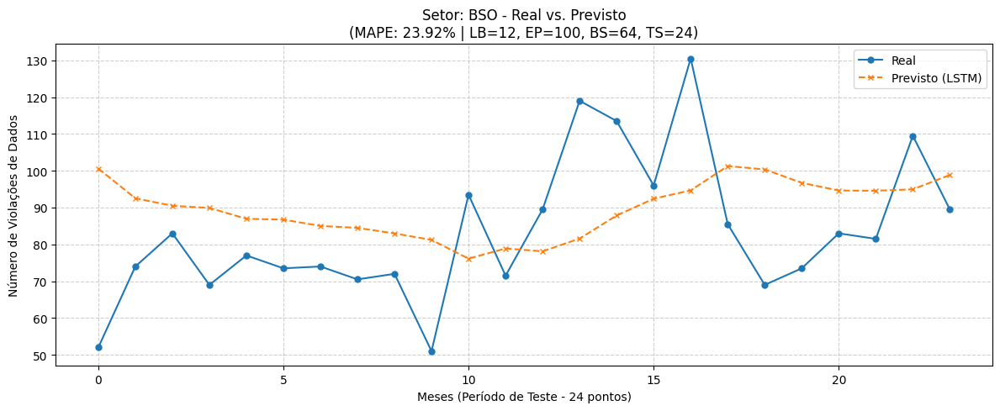

--------------------------------------------------
📊 Resultados para BSO [LB=12, EP=100, BS=64, TS=24]:
   MAE : 18.44
   RMSE: 21.45
   MAPE: 23.92%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


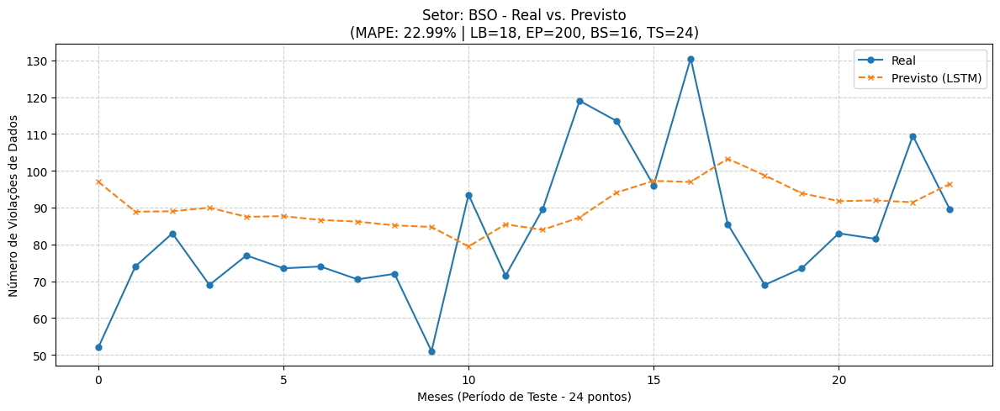

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=200, BS=16, TS=24]:
   MAE : 17.43
   RMSE: 20.27
   MAPE: 22.99%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


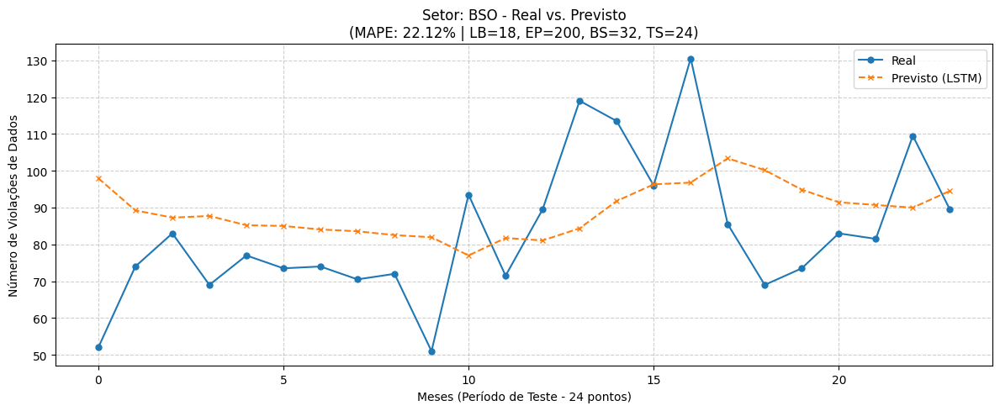

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=200, BS=32, TS=24]:
   MAE : 16.94
   RMSE: 20.23
   MAPE: 22.12%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


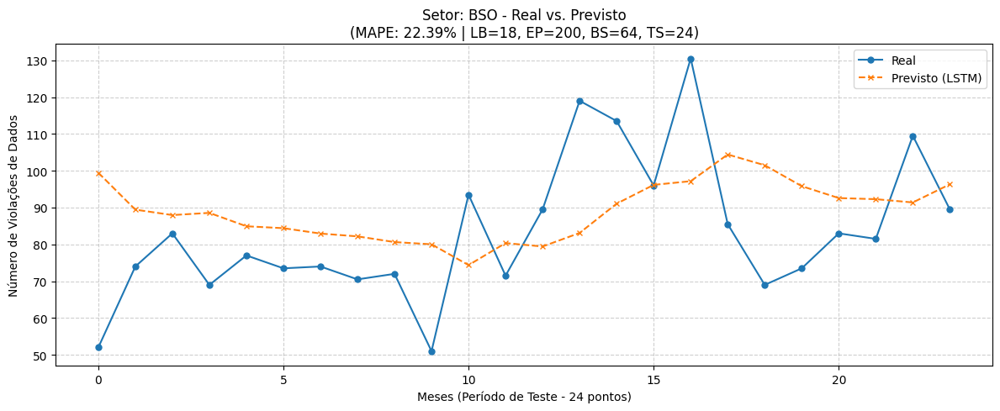

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=200, BS=64, TS=24]:
   MAE : 17.23
   RMSE: 20.57
   MAPE: 22.39%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


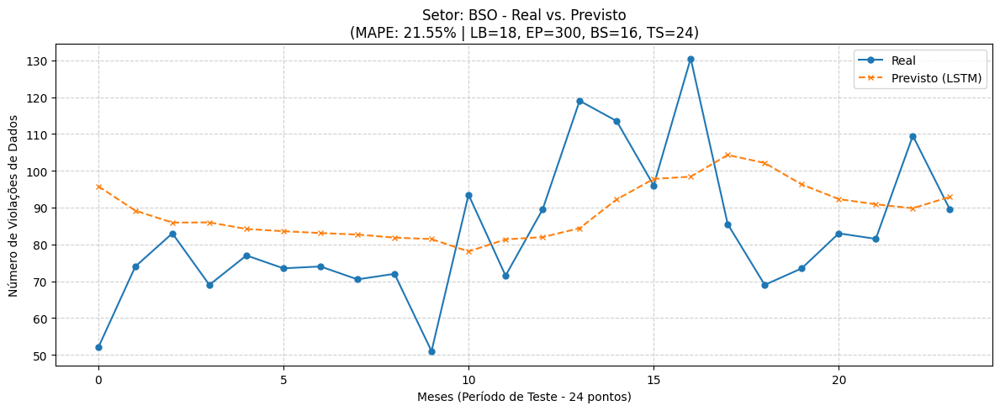

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=300, BS=16, TS=24]:
   MAE : 16.53
   RMSE: 19.86
   MAPE: 21.55%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


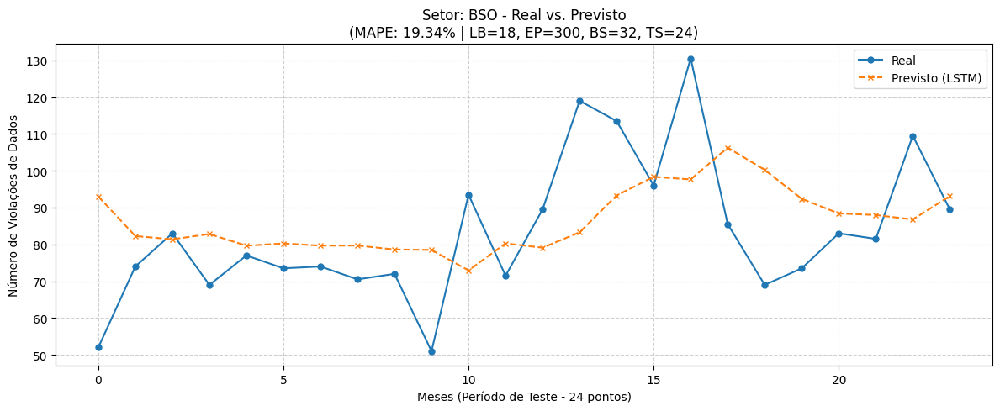

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=300, BS=32, TS=24]:
   MAE : 15.13
   RMSE: 18.99
   MAPE: 19.34%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


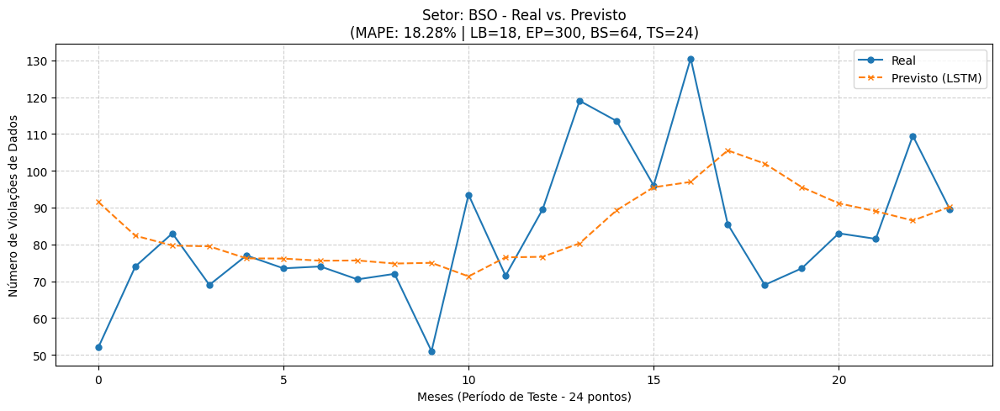

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=300, BS=64, TS=24]:
   MAE : 14.58
   RMSE: 19.25
   MAPE: 18.28%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


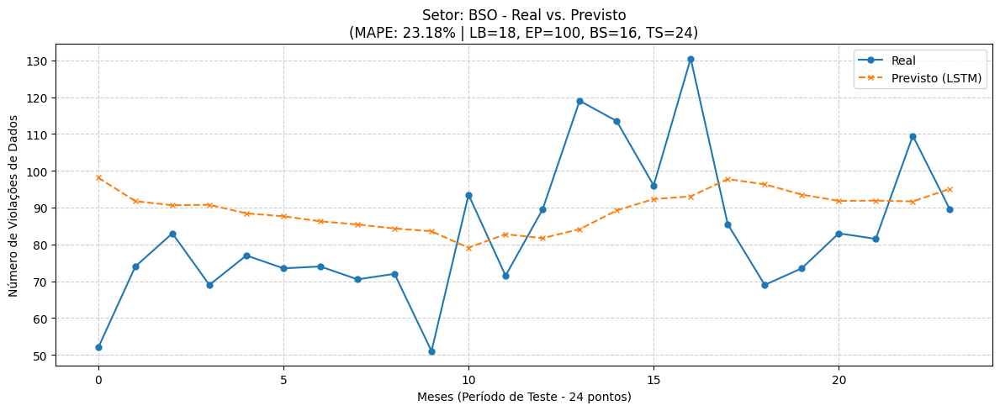

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=100, BS=16, TS=24]:
   MAE : 17.78
   RMSE: 20.75
   MAPE: 23.18%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


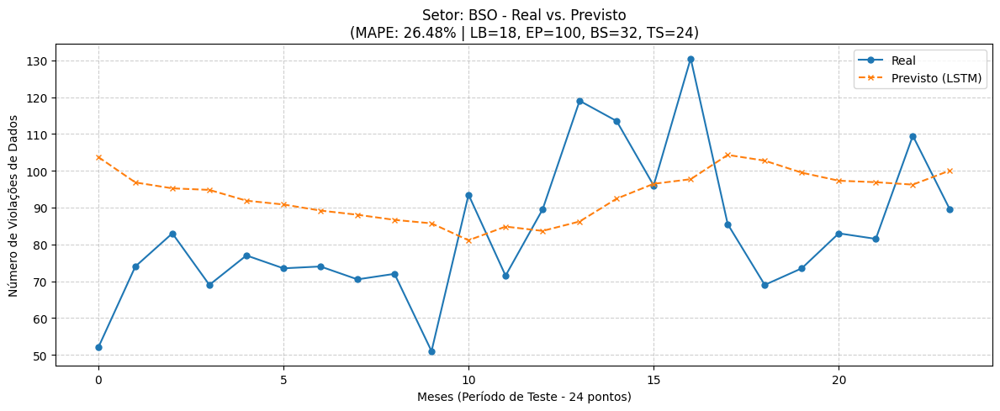

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=100, BS=32, TS=24]:
   MAE : 19.90
   RMSE: 22.68
   MAPE: 26.48%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


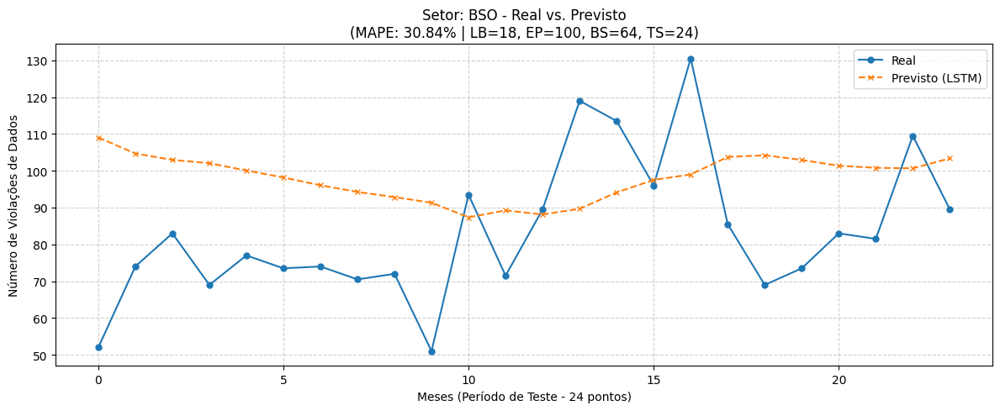

--------------------------------------------------
📊 Resultados para BSO [LB=18, EP=100, BS=64, TS=24]:
   MAE : 22.73
   RMSE: 25.77
   MAPE: 30.84%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: BSR ====================
Iniciando Grid Search para o setor: BSR (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


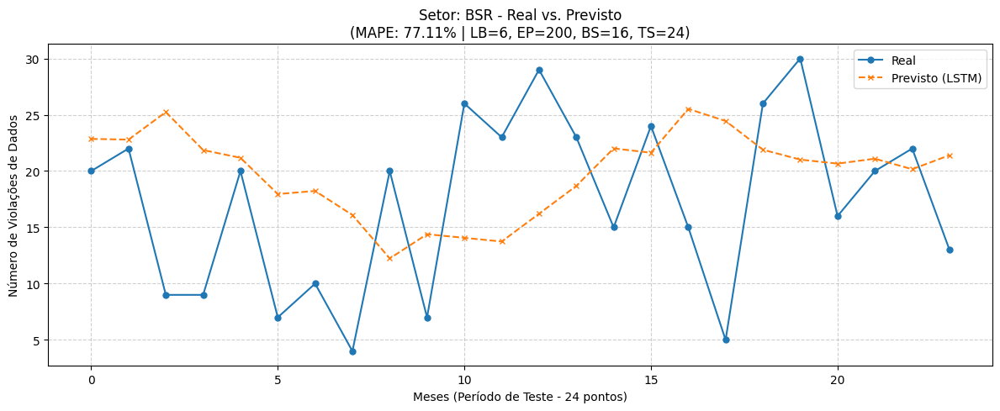

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=200, BS=16, TS=24]:
   MAE : 7.80
   RMSE: 9.21
   MAPE: 77.11%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


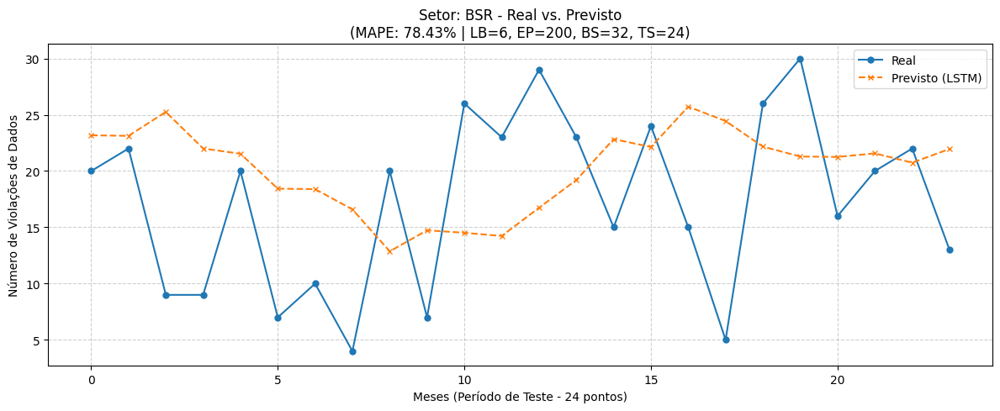

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=200, BS=32, TS=24]:
   MAE : 7.84
   RMSE: 9.24
   MAPE: 78.43%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


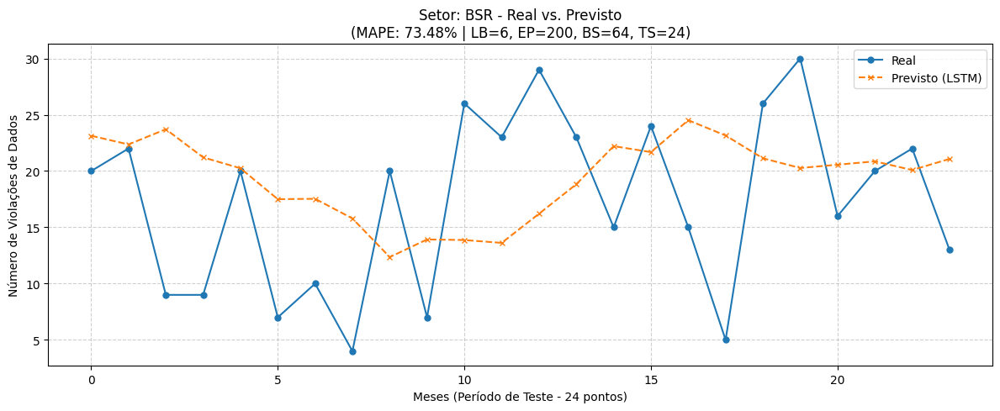

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=200, BS=64, TS=24]:
   MAE : 7.53
   RMSE: 8.88
   MAPE: 73.48%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


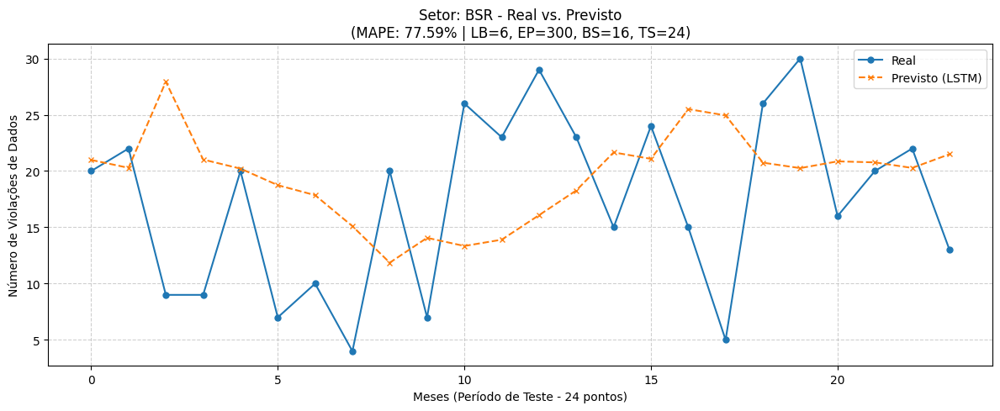

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=300, BS=16, TS=24]:
   MAE : 7.92
   RMSE: 9.49
   MAPE: 77.59%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


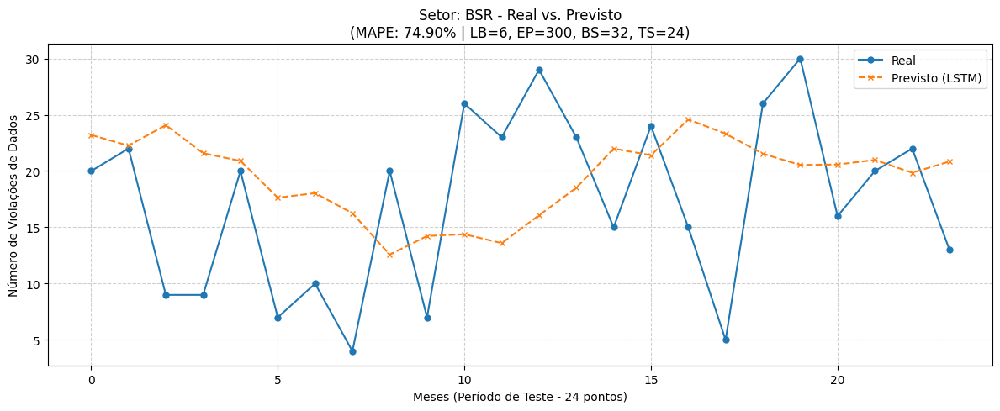

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=300, BS=32, TS=24]:
   MAE : 7.63
   RMSE: 8.95
   MAPE: 74.90%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


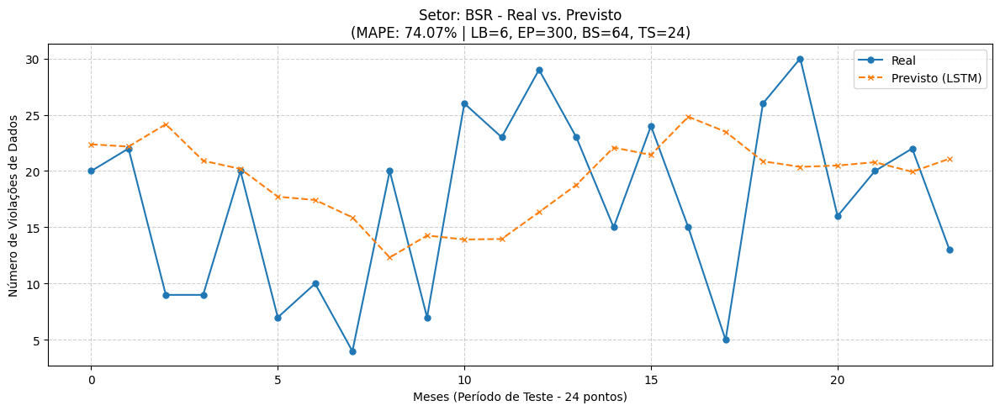

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=300, BS=64, TS=24]:
   MAE : 7.54
   RMSE: 8.92
   MAPE: 74.07%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


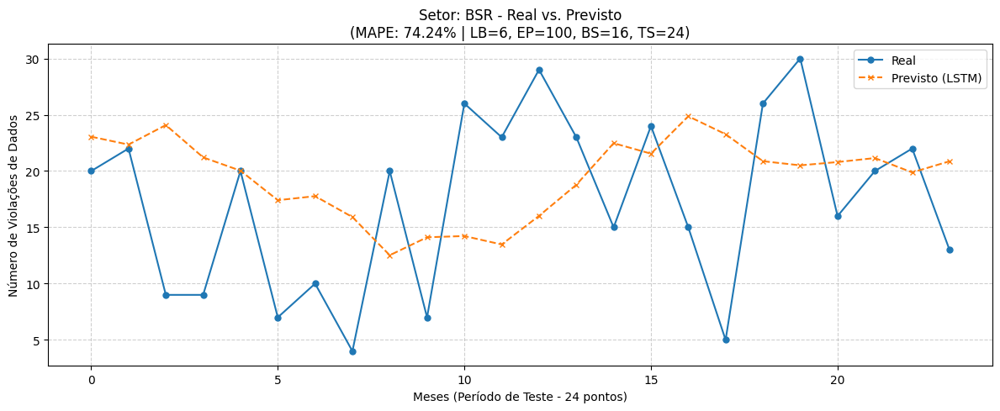

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=100, BS=16, TS=24]:
   MAE : 7.61
   RMSE: 8.94
   MAPE: 74.24%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


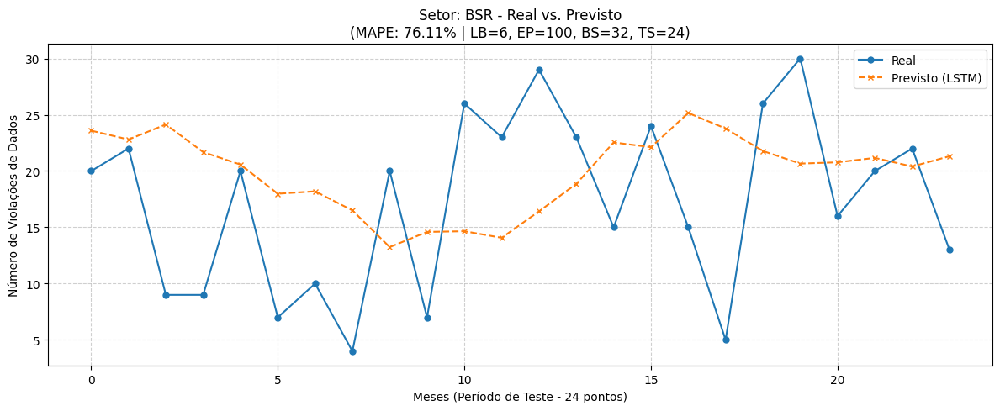

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=100, BS=32, TS=24]:
   MAE : 7.65
   RMSE: 9.02
   MAPE: 76.11%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


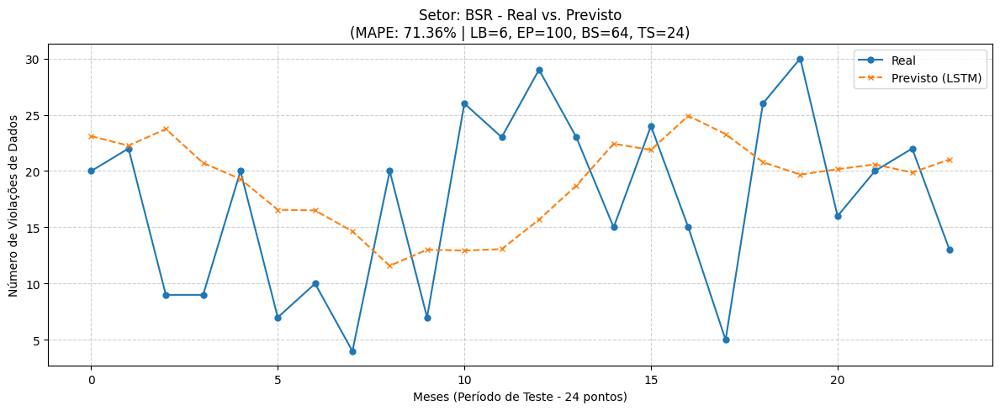

--------------------------------------------------
📊 Resultados para BSR [LB=6, EP=100, BS=64, TS=24]:
   MAE : 7.52
   RMSE: 8.89
   MAPE: 71.36%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


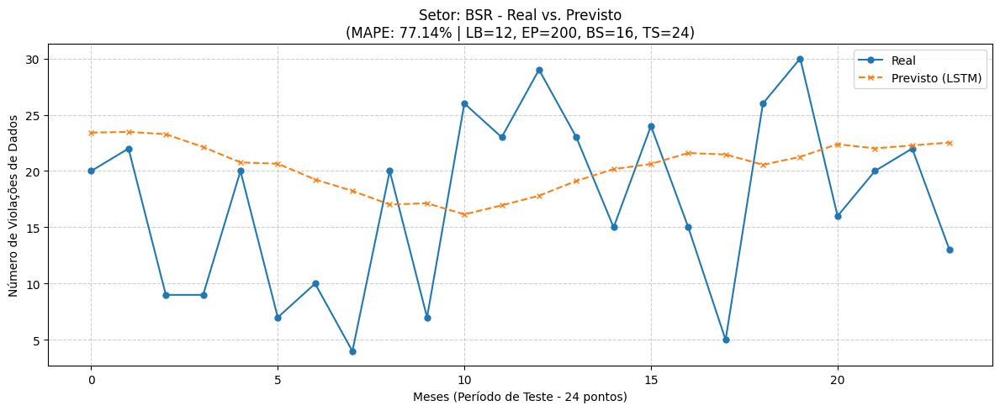

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=200, BS=16, TS=24]:
   MAE : 7.43
   RMSE: 8.77
   MAPE: 77.14%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


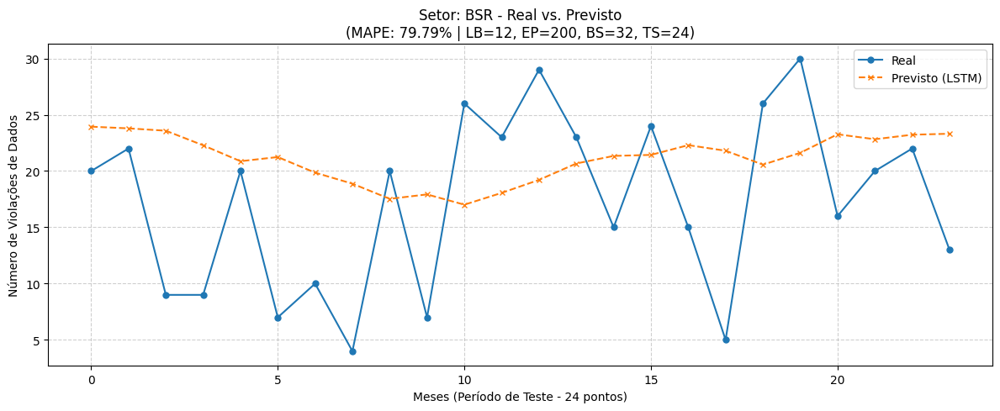

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=200, BS=32, TS=24]:
   MAE : 7.56
   RMSE: 8.93
   MAPE: 79.79%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


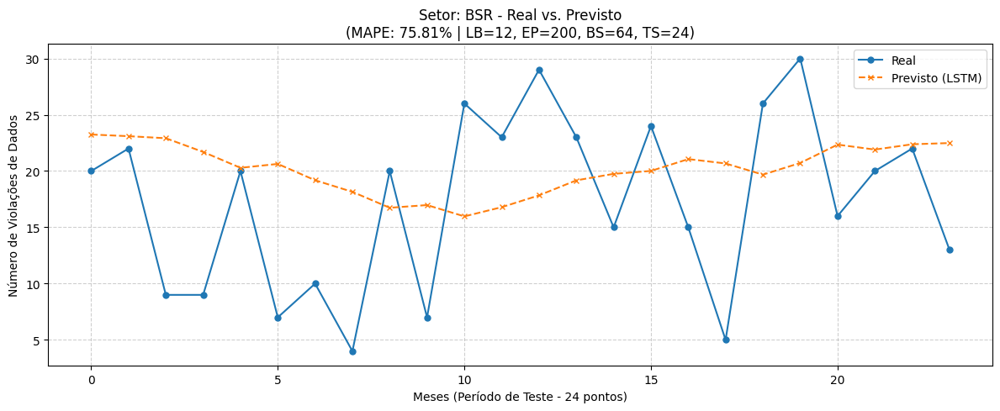

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=200, BS=64, TS=24]:
   MAE : 7.37
   RMSE: 8.68
   MAPE: 75.81%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


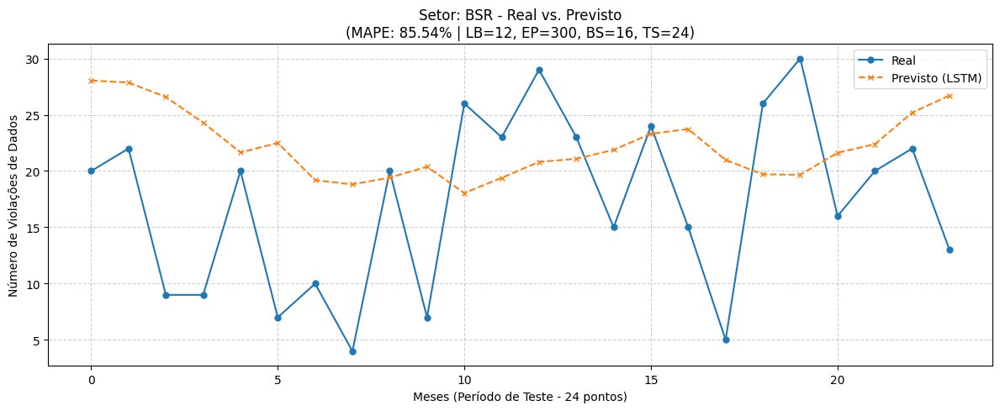

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=300, BS=16, TS=24]:
   MAE : 8.22
   RMSE: 9.74
   MAPE: 85.54%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


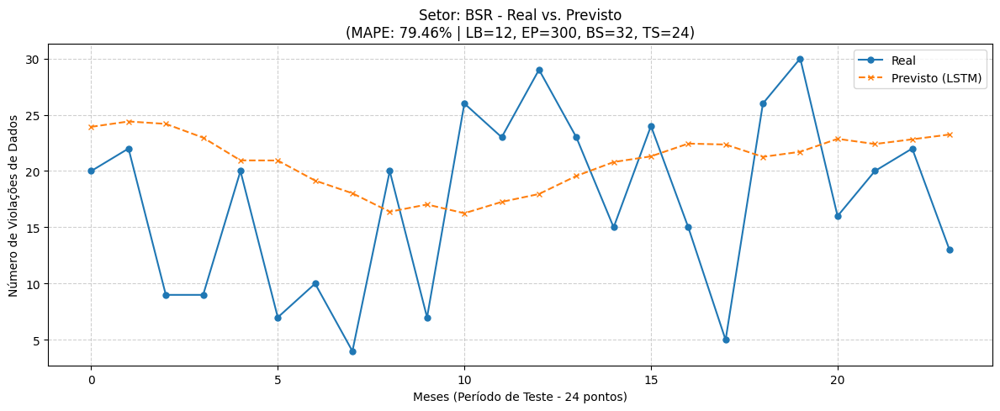

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=300, BS=32, TS=24]:
   MAE : 7.66
   RMSE: 9.00
   MAPE: 79.46%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


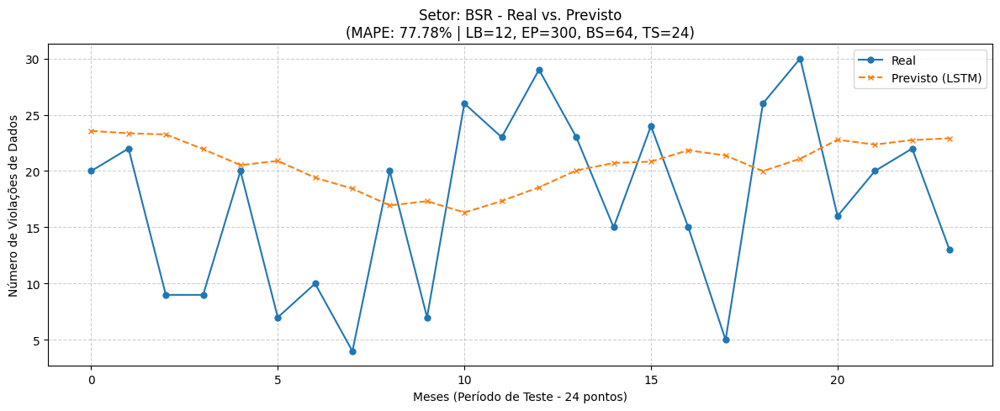

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=300, BS=64, TS=24]:
   MAE : 7.47
   RMSE: 8.80
   MAPE: 77.78%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


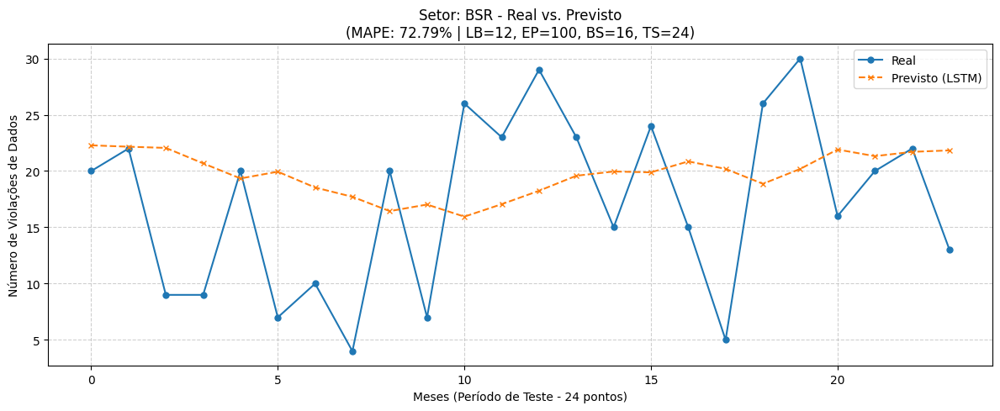

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=100, BS=16, TS=24]:
   MAE : 7.09
   RMSE: 8.38
   MAPE: 72.79%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


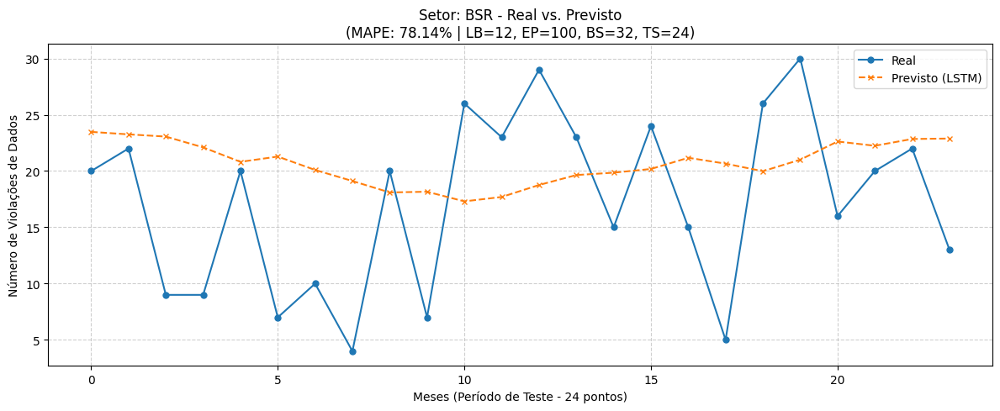

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=100, BS=32, TS=24]:
   MAE : 7.42
   RMSE: 8.78
   MAPE: 78.14%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


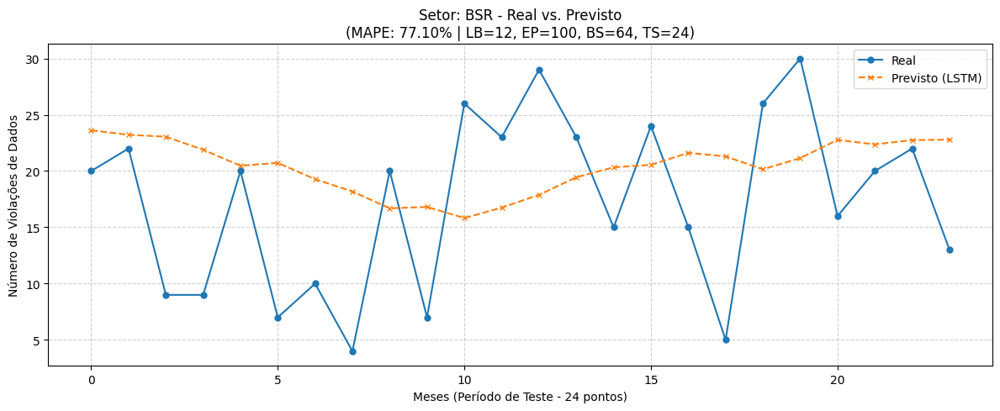

--------------------------------------------------
📊 Resultados para BSR [LB=12, EP=100, BS=64, TS=24]:
   MAE : 7.49
   RMSE: 8.78
   MAPE: 77.10%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


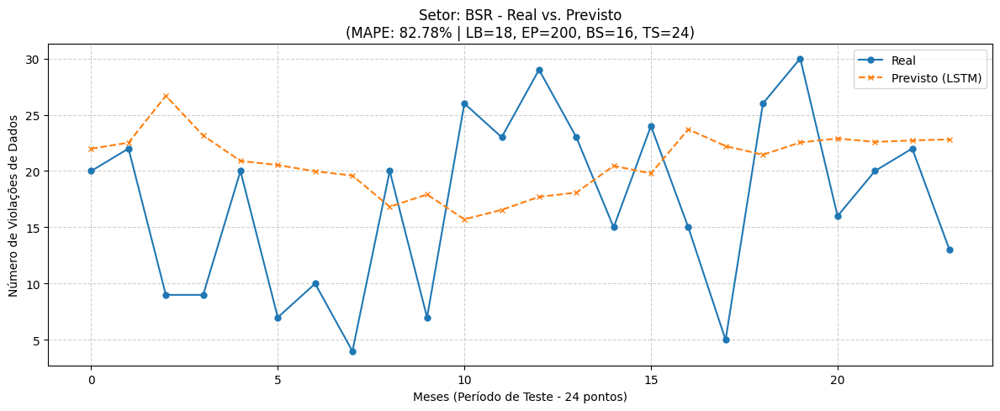

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=200, BS=16, TS=24]:
   MAE : 7.87
   RMSE: 9.40
   MAPE: 82.78%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


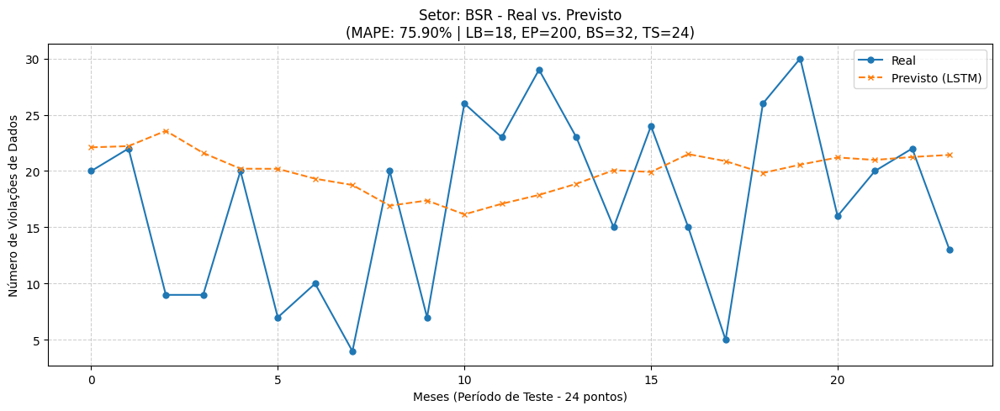

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=200, BS=32, TS=24]:
   MAE : 7.25
   RMSE: 8.68
   MAPE: 75.90%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


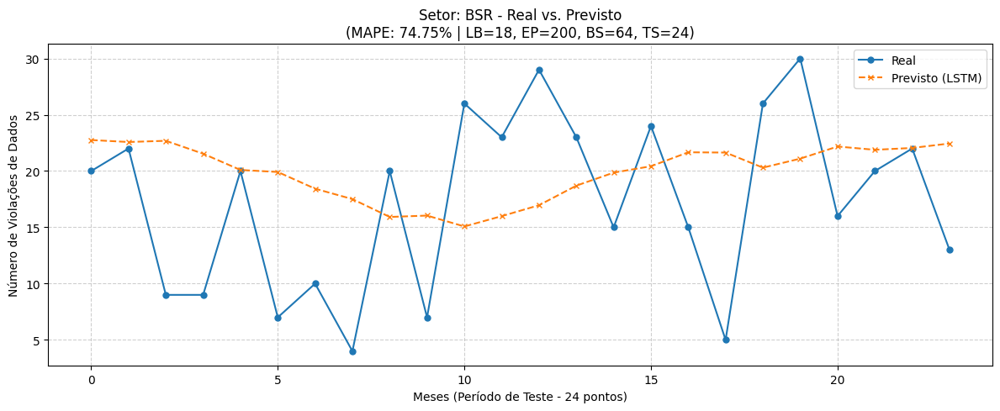

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=200, BS=64, TS=24]:
   MAE : 7.32
   RMSE: 8.67
   MAPE: 74.75%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


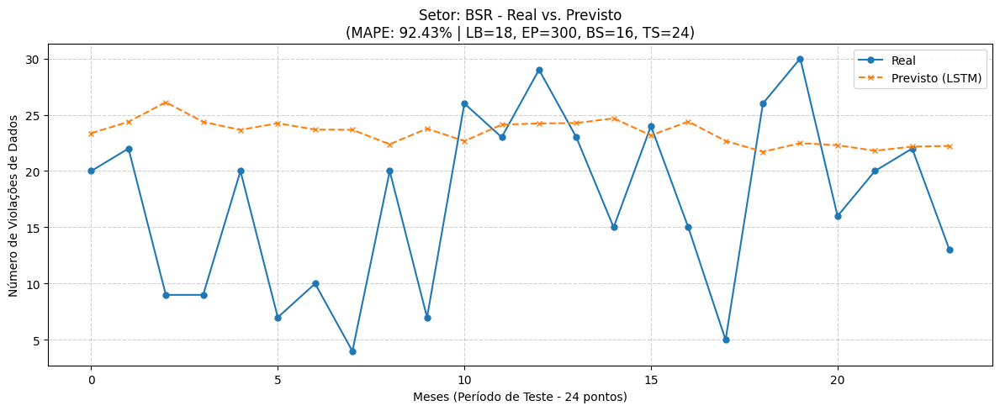

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=300, BS=16, TS=24]:
   MAE : 7.87
   RMSE: 10.11
   MAPE: 92.43%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


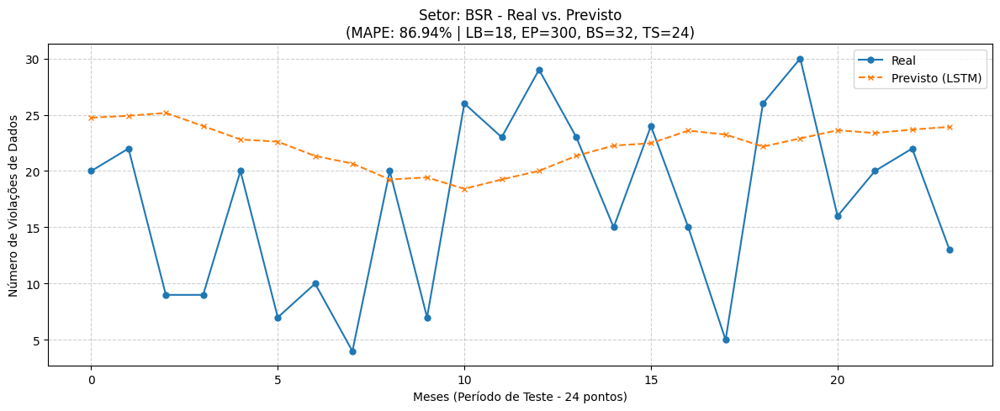

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=300, BS=32, TS=24]:
   MAE : 7.94
   RMSE: 9.58
   MAPE: 86.94%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


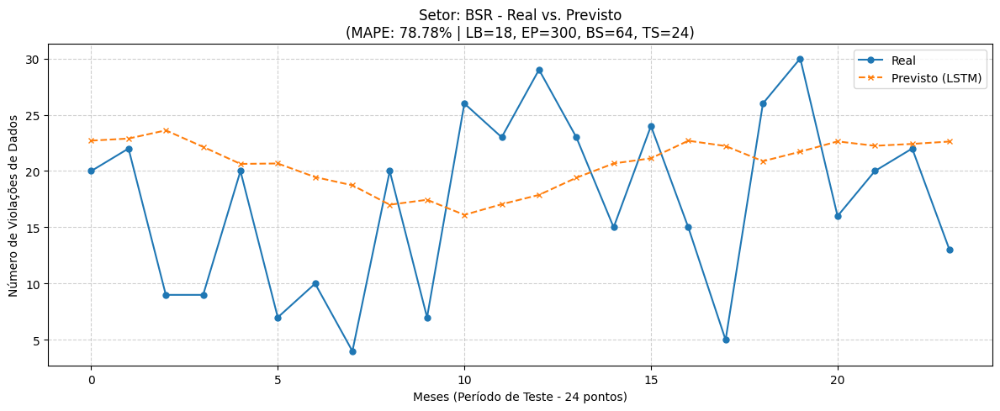

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=300, BS=64, TS=24]:
   MAE : 7.48
   RMSE: 8.92
   MAPE: 78.78%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


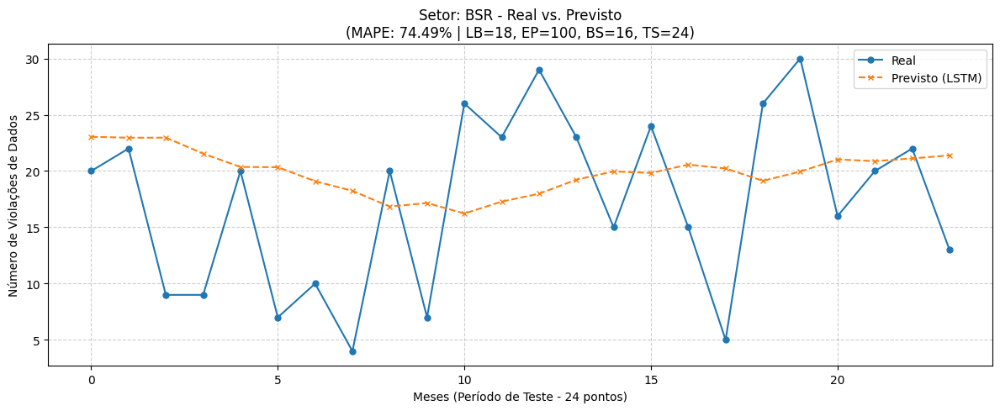

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=100, BS=16, TS=24]:
   MAE : 7.22
   RMSE: 8.55
   MAPE: 74.49%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


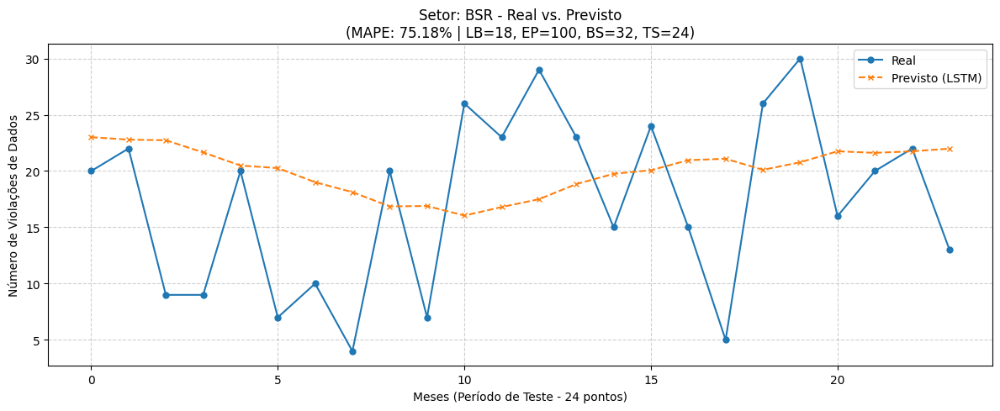

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=100, BS=32, TS=24]:
   MAE : 7.27
   RMSE: 8.61
   MAPE: 75.18%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


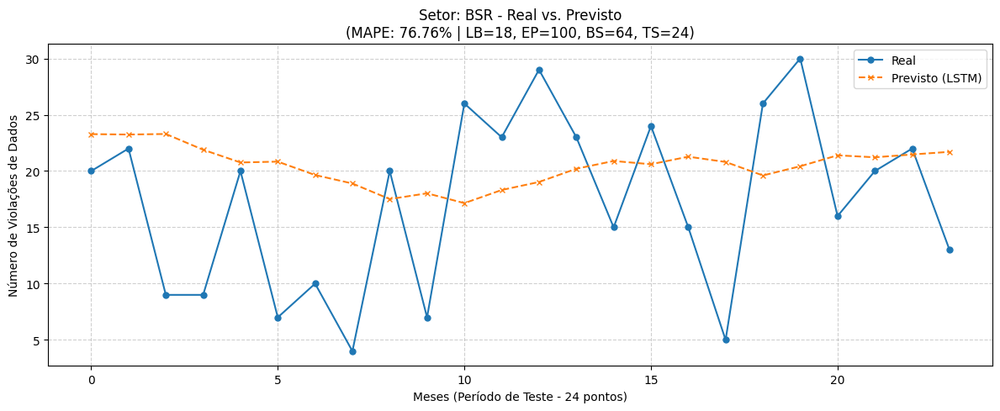

--------------------------------------------------
📊 Resultados para BSR [LB=18, EP=100, BS=64, TS=24]:
   MAE : 7.24
   RMSE: 8.66
   MAPE: 76.76%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: EDU ====================
Iniciando Grid Search para o setor: EDU (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


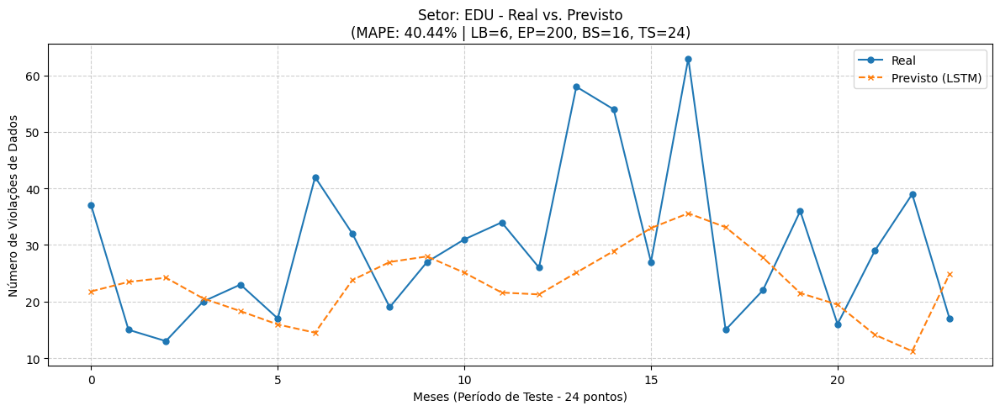

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=200, BS=16, TS=24]:
   MAE : 12.19
   RMSE: 15.40
   MAPE: 40.44%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


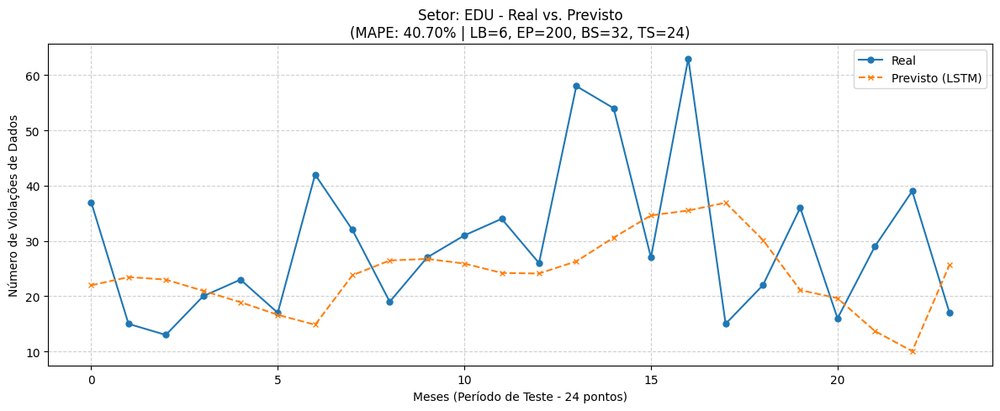

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=200, BS=32, TS=24]:
   MAE : 12.10
   RMSE: 15.41
   MAPE: 40.70%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


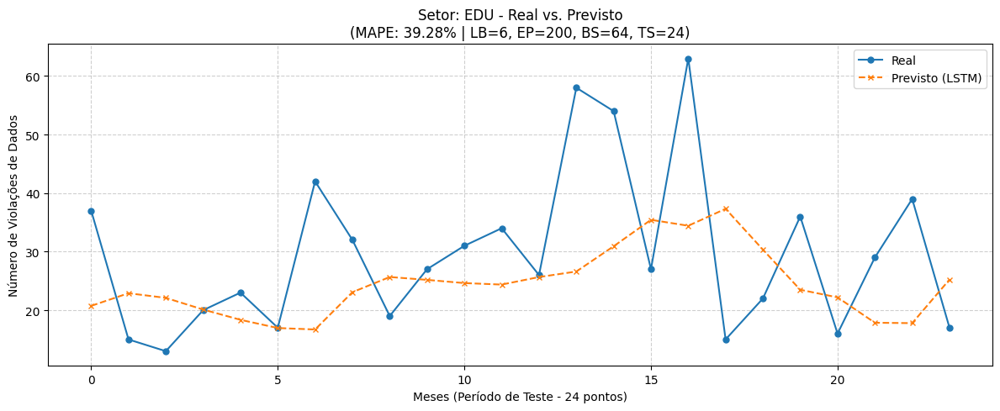

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=200, BS=64, TS=24]:
   MAE : 11.61
   RMSE: 14.64
   MAPE: 39.28%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


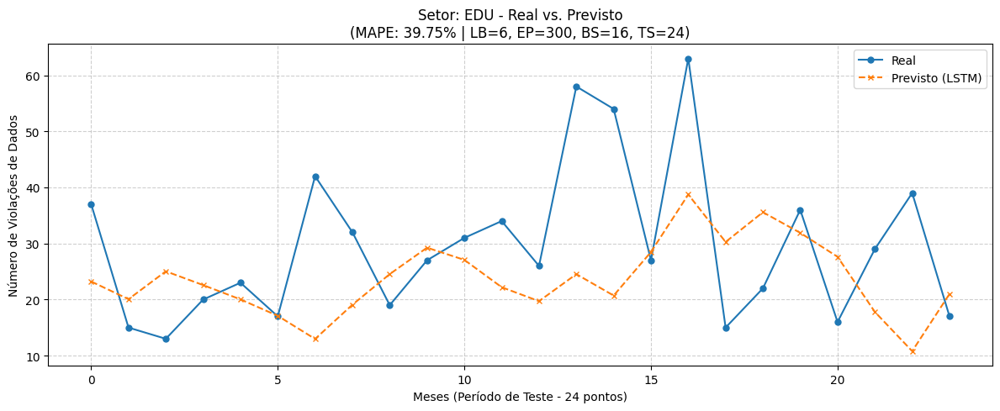

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=300, BS=16, TS=24]:
   MAE : 12.03
   RMSE: 15.73
   MAPE: 39.75%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


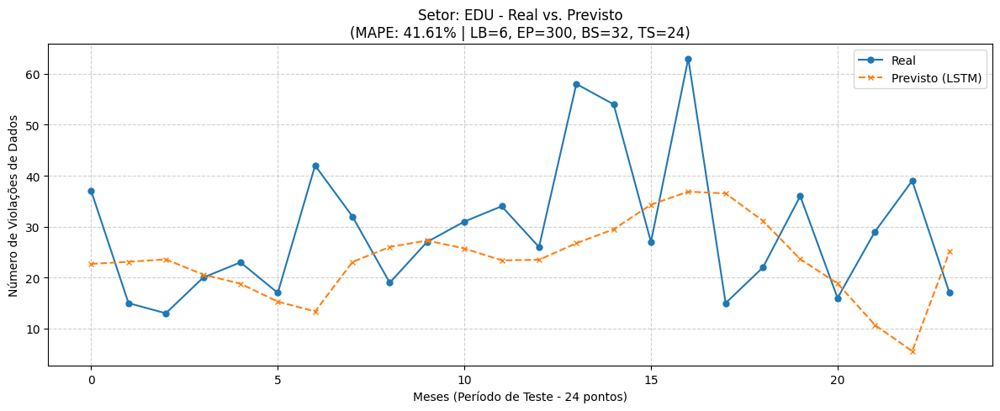

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=300, BS=32, TS=24]:
   MAE : 12.40
   RMSE: 15.86
   MAPE: 41.61%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


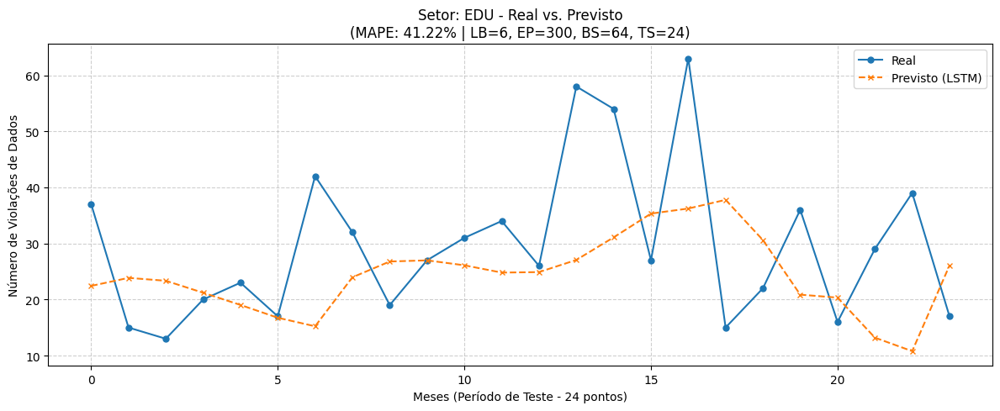

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=300, BS=64, TS=24]:
   MAE : 12.08
   RMSE: 15.28
   MAPE: 41.22%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


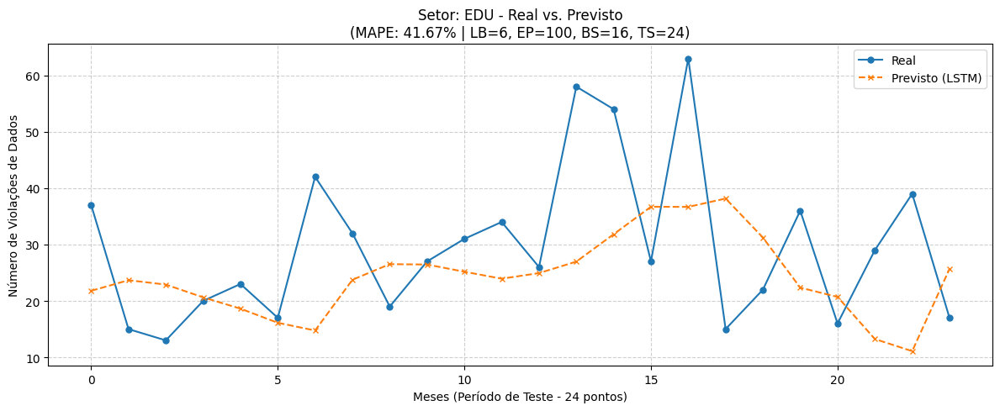

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=100, BS=16, TS=24]:
   MAE : 12.19
   RMSE: 15.28
   MAPE: 41.67%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


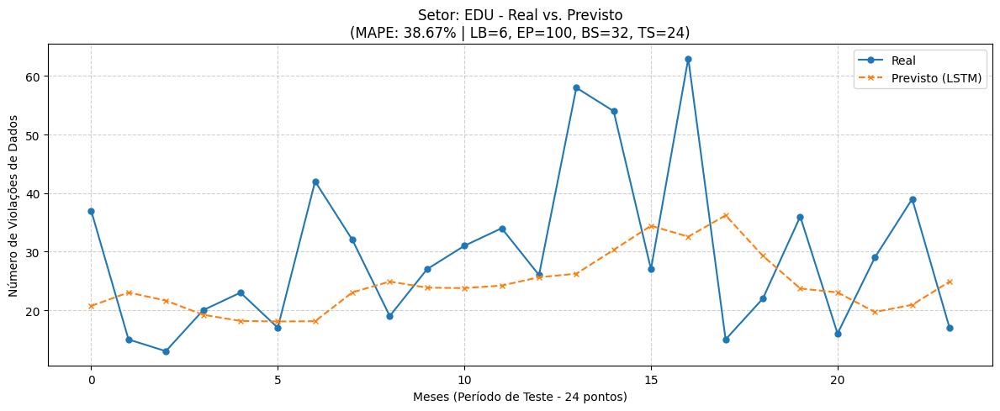

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=100, BS=32, TS=24]:
   MAE : 11.47
   RMSE: 14.44
   MAPE: 38.67%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


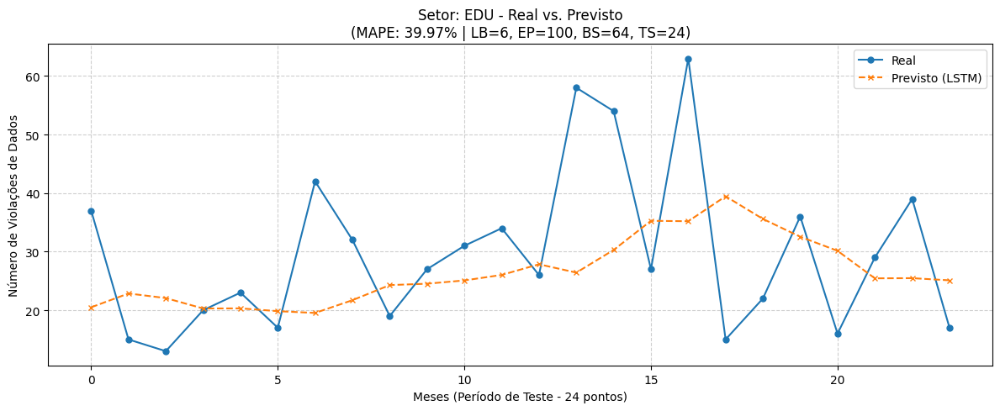

--------------------------------------------------
📊 Resultados para EDU [LB=6, EP=100, BS=64, TS=24]:
   MAE : 11.15
   RMSE: 14.19
   MAPE: 39.97%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


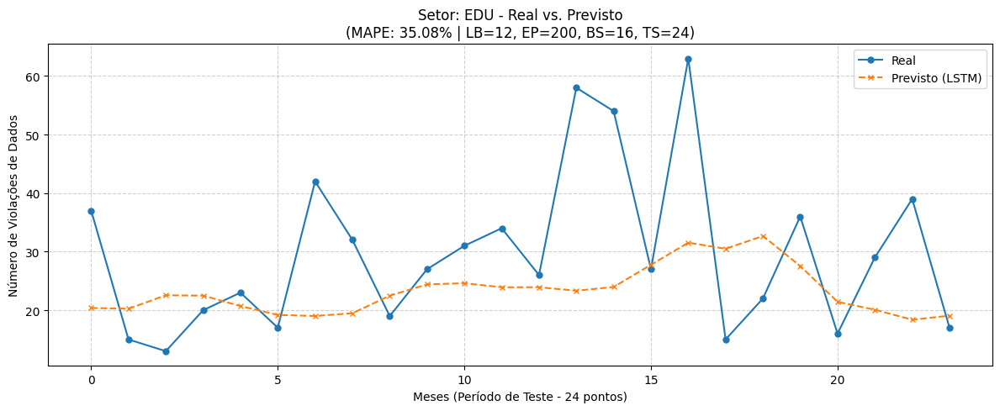

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=200, BS=16, TS=24]:
   MAE : 11.13
   RMSE: 14.89
   MAPE: 35.08%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


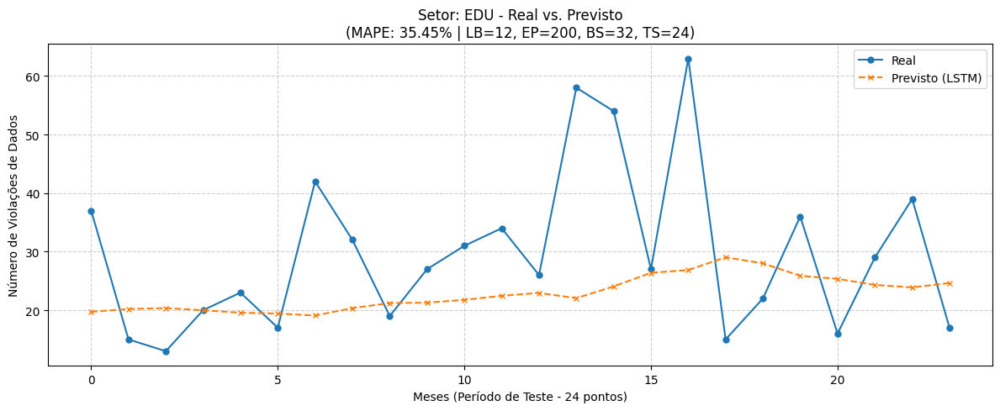

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=200, BS=32, TS=24]:
   MAE : 11.32
   RMSE: 15.21
   MAPE: 35.45%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


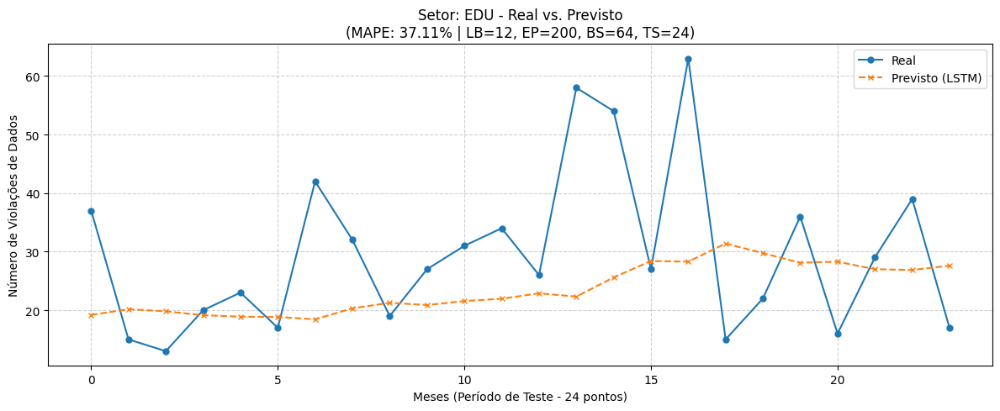

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=200, BS=64, TS=24]:
   MAE : 11.42
   RMSE: 15.11
   MAPE: 37.11%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


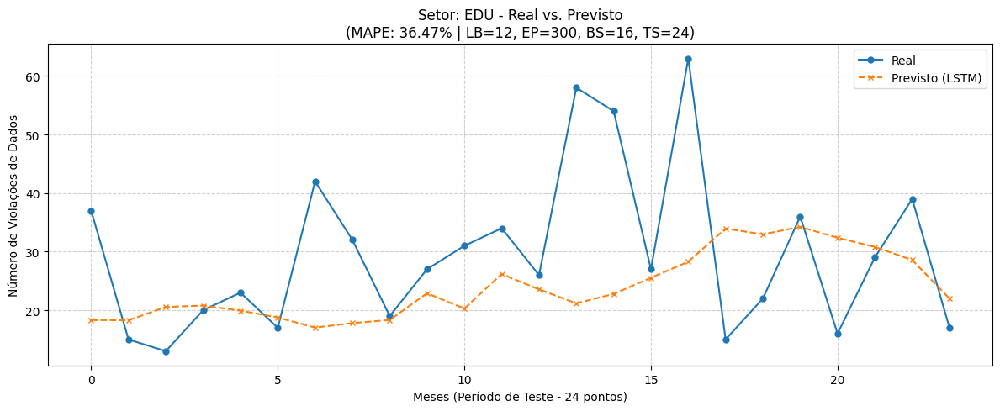

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=300, BS=16, TS=24]:
   MAE : 11.23
   RMSE: 15.65
   MAPE: 36.47%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


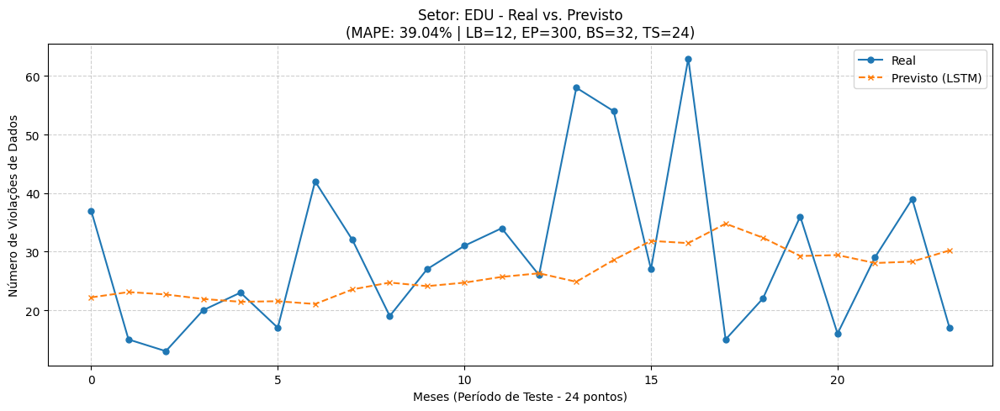

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=300, BS=32, TS=24]:
   MAE : 10.99
   RMSE: 14.21
   MAPE: 39.04%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


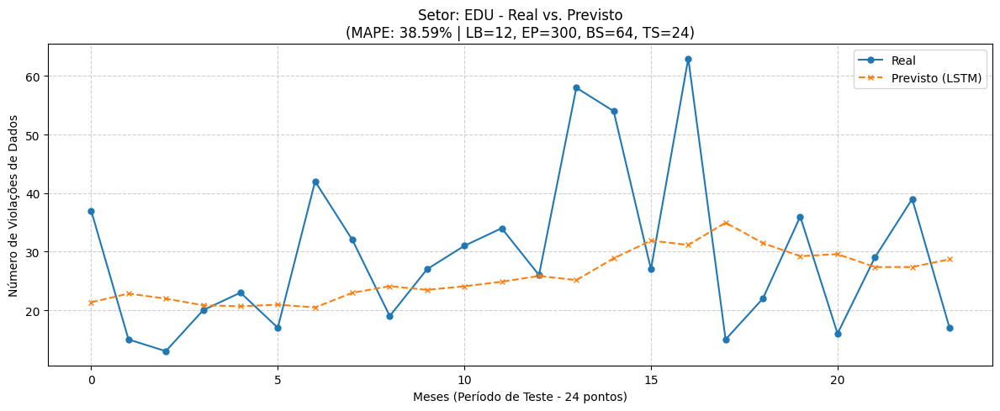

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=300, BS=64, TS=24]:
   MAE : 11.02
   RMSE: 14.24
   MAPE: 38.59%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


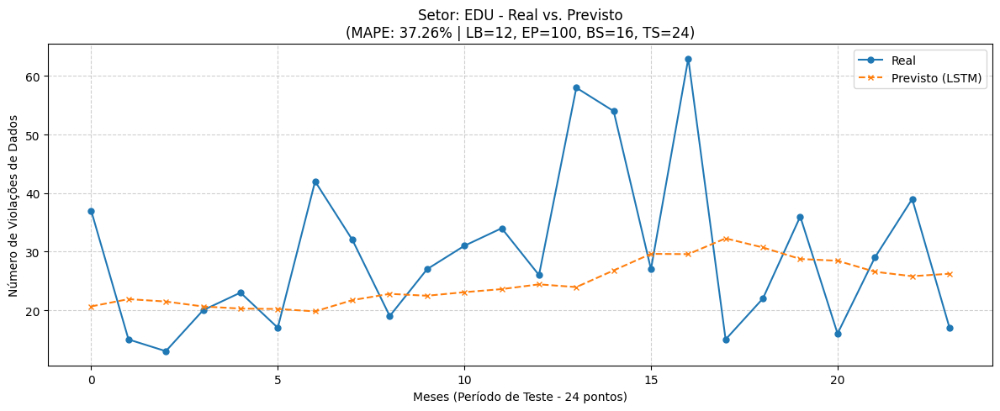

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=100, BS=16, TS=24]:
   MAE : 11.12
   RMSE: 14.55
   MAPE: 37.26%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


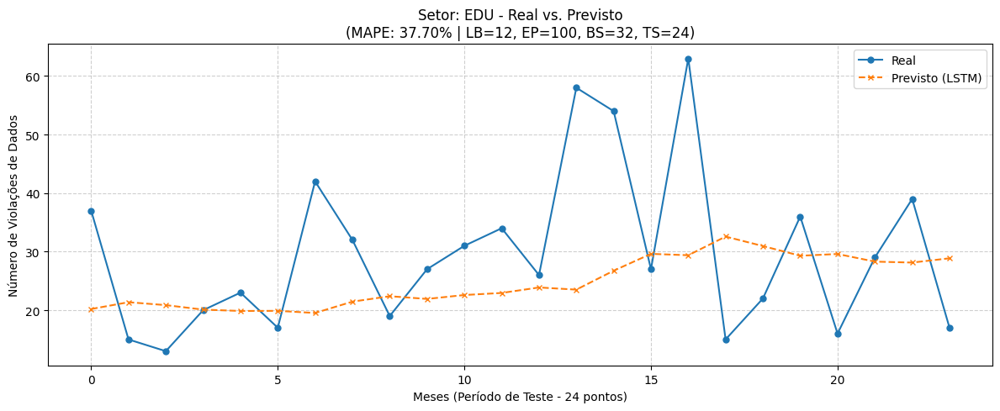

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=100, BS=32, TS=24]:
   MAE : 11.19
   RMSE: 14.72
   MAPE: 37.70%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


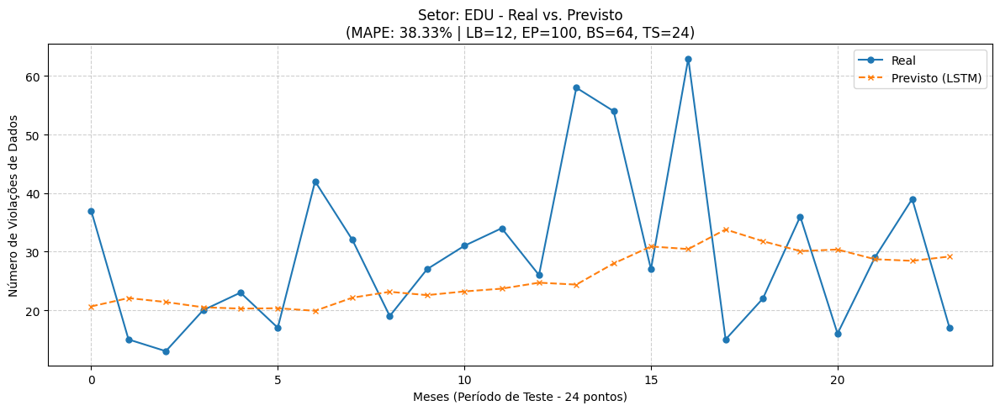

--------------------------------------------------
📊 Resultados para EDU [LB=12, EP=100, BS=64, TS=24]:
   MAE : 11.10
   RMSE: 14.48
   MAPE: 38.33%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


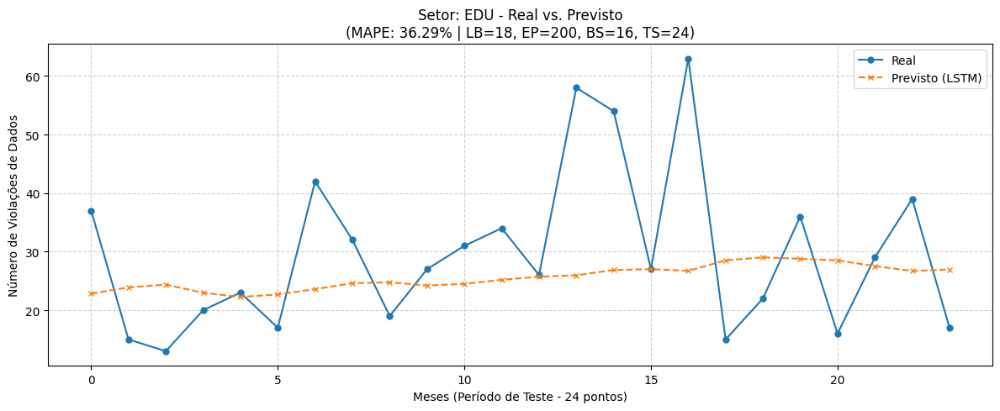

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=200, BS=16, TS=24]:
   MAE : 10.55
   RMSE: 14.11
   MAPE: 36.29%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


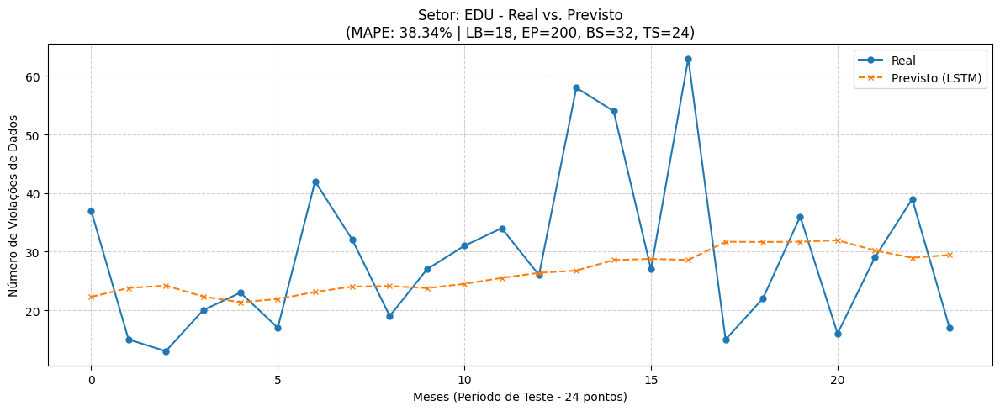

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=200, BS=32, TS=24]:
   MAE : 10.72
   RMSE: 14.04
   MAPE: 38.34%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


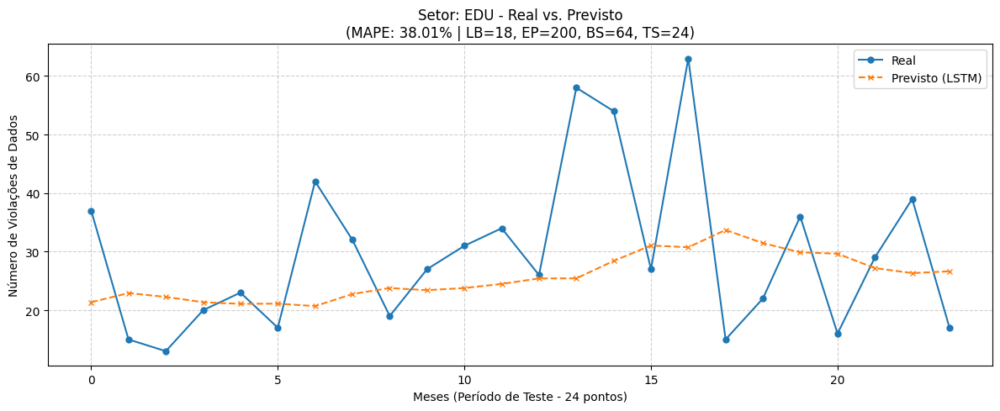

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=200, BS=64, TS=24]:
   MAE : 10.96
   RMSE: 14.18
   MAPE: 38.01%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


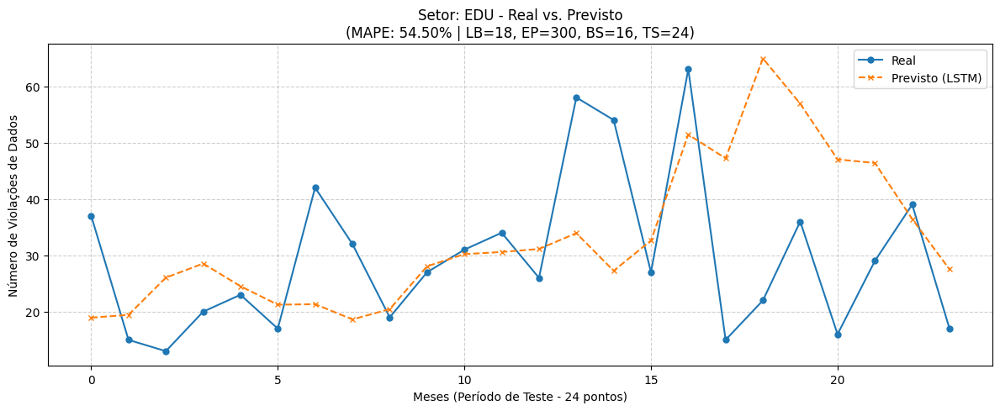

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=300, BS=16, TS=24]:
   MAE : 13.38
   RMSE: 17.57
   MAPE: 54.50%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


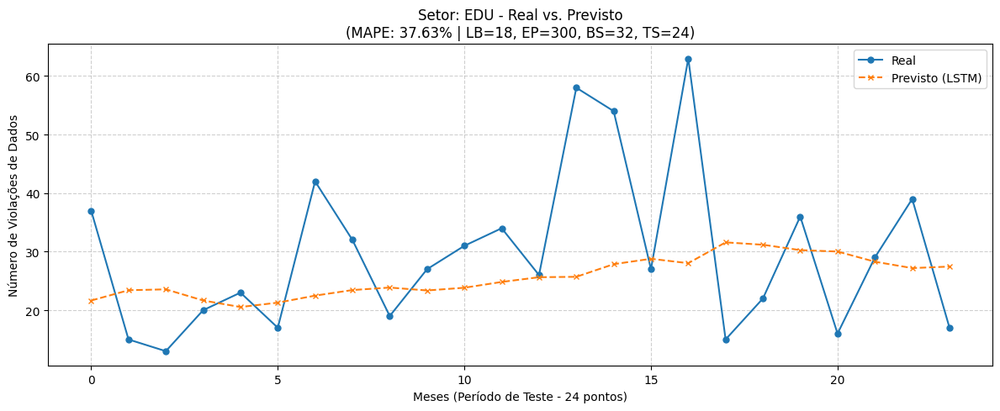

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=300, BS=32, TS=24]:
   MAE : 10.82
   RMSE: 14.23
   MAPE: 37.63%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 97ms/step


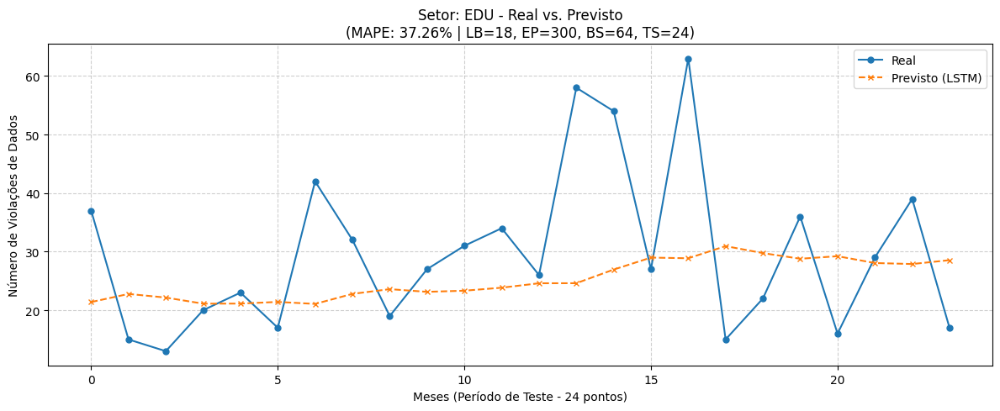

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=300, BS=64, TS=24]:
   MAE : 10.92
   RMSE: 14.36
   MAPE: 37.26%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


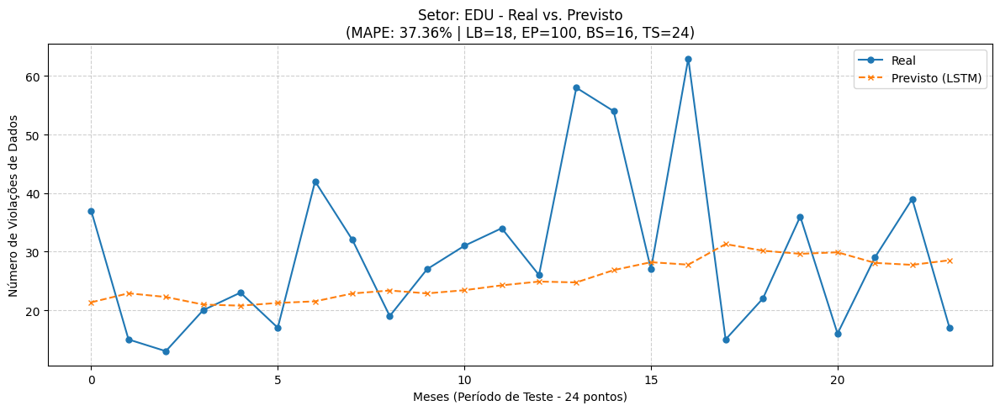

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=100, BS=16, TS=24]:
   MAE : 10.92
   RMSE: 14.47
   MAPE: 37.36%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


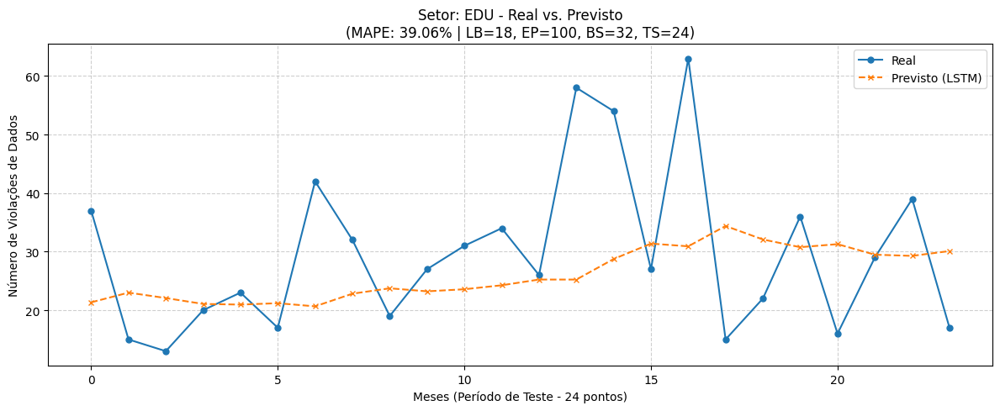

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=100, BS=32, TS=24]:
   MAE : 11.03
   RMSE: 14.30
   MAPE: 39.06%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


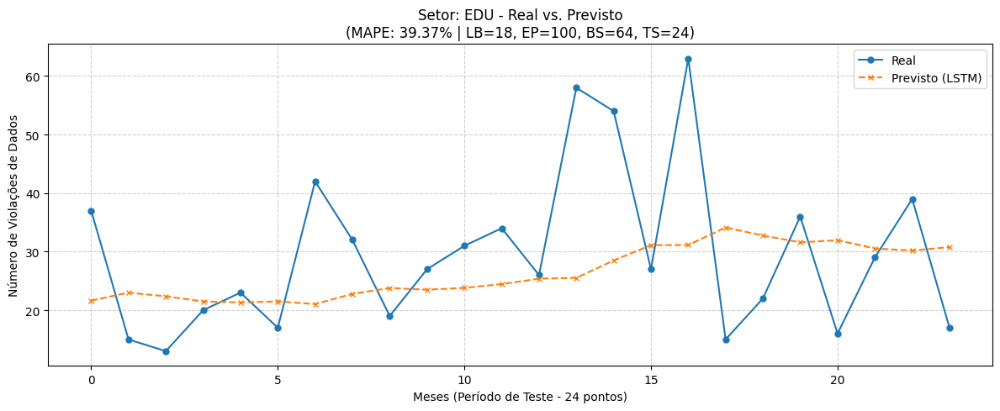

--------------------------------------------------
📊 Resultados para EDU [LB=18, EP=100, BS=64, TS=24]:
   MAE : 11.02
   RMSE: 14.26
   MAPE: 39.37%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: GOV ====================
Iniciando Grid Search para o setor: GOV (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


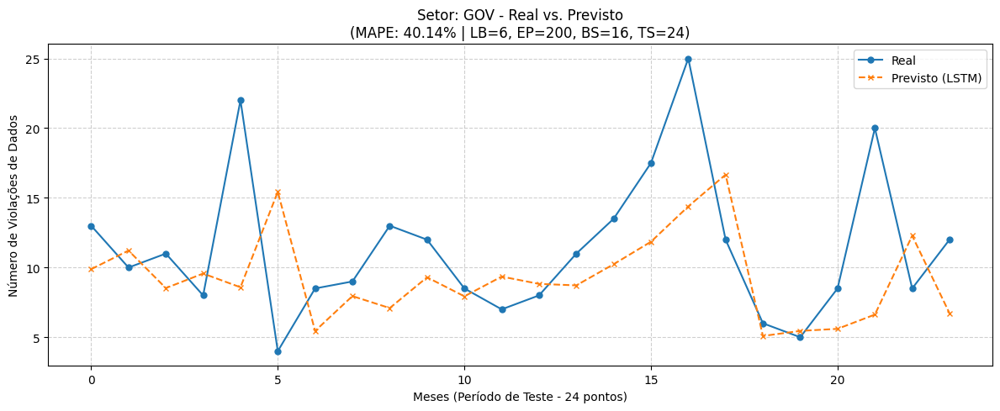

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=200, BS=16, TS=24]:
   MAE : 4.29
   RMSE: 5.78
   MAPE: 40.14%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


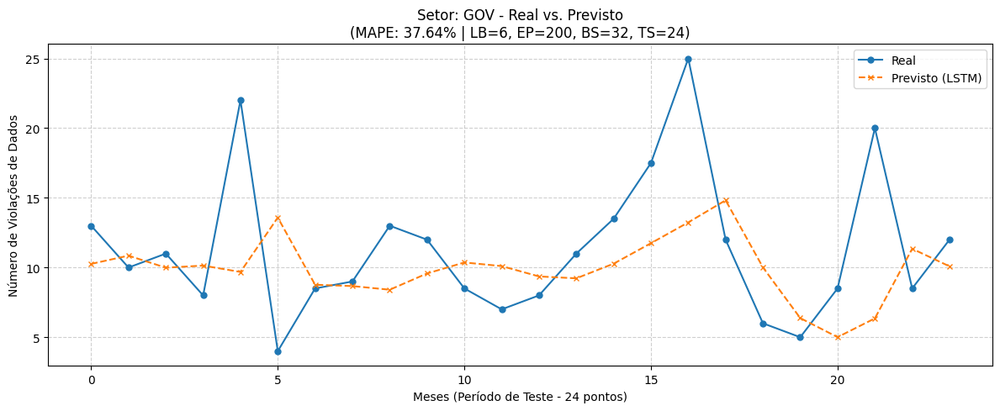

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=200, BS=32, TS=24]:
   MAE : 3.97
   RMSE: 5.48
   MAPE: 37.64%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


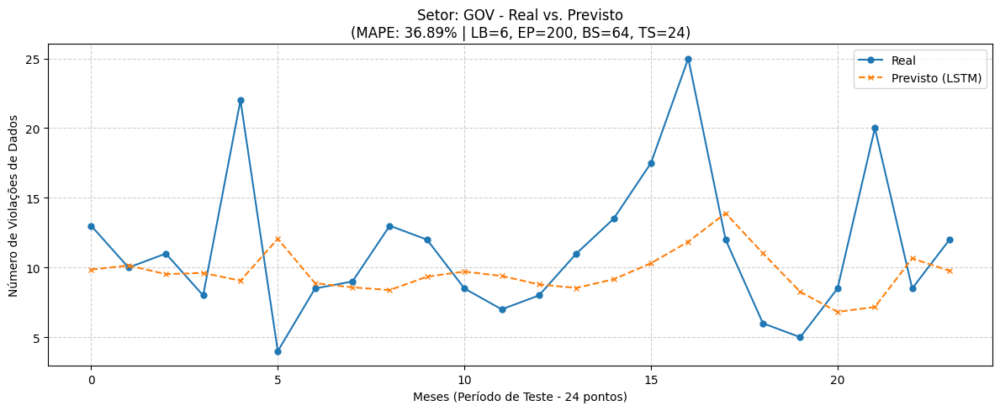

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=200, BS=64, TS=24]:
   MAE : 4.00
   RMSE: 5.59
   MAPE: 36.89%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


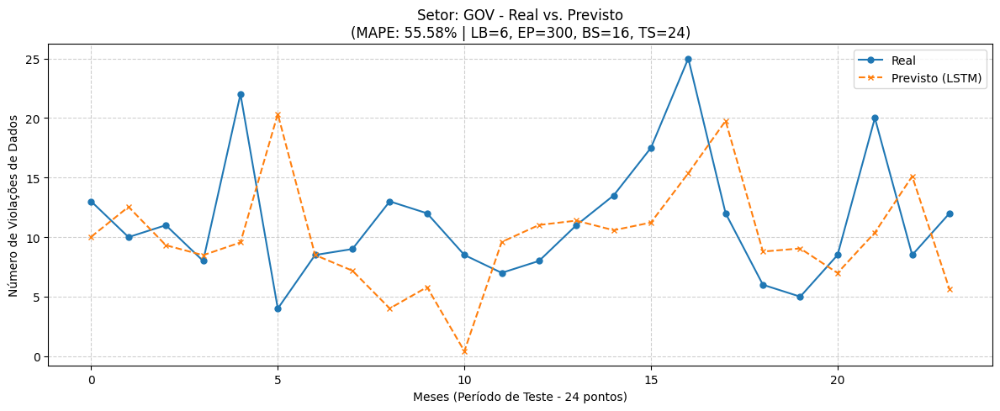

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=300, BS=16, TS=24]:
   MAE : 5.21
   RMSE: 6.61
   MAPE: 55.58%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


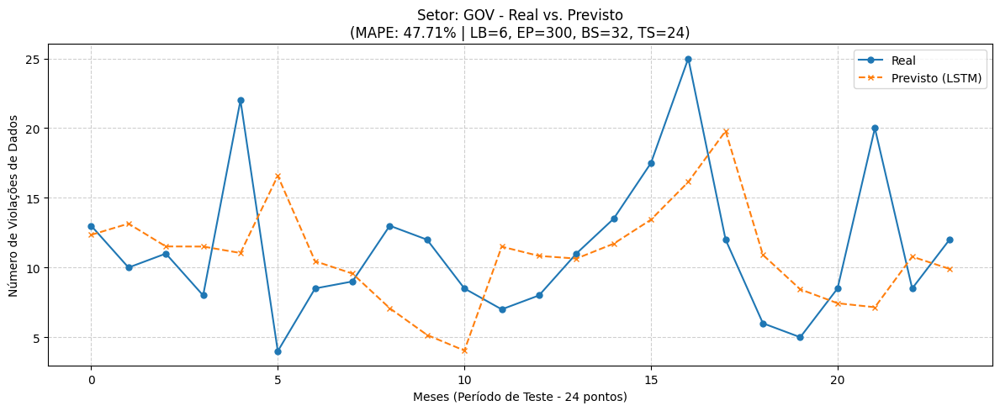

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=300, BS=32, TS=24]:
   MAE : 4.50
   RMSE: 5.80
   MAPE: 47.71%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


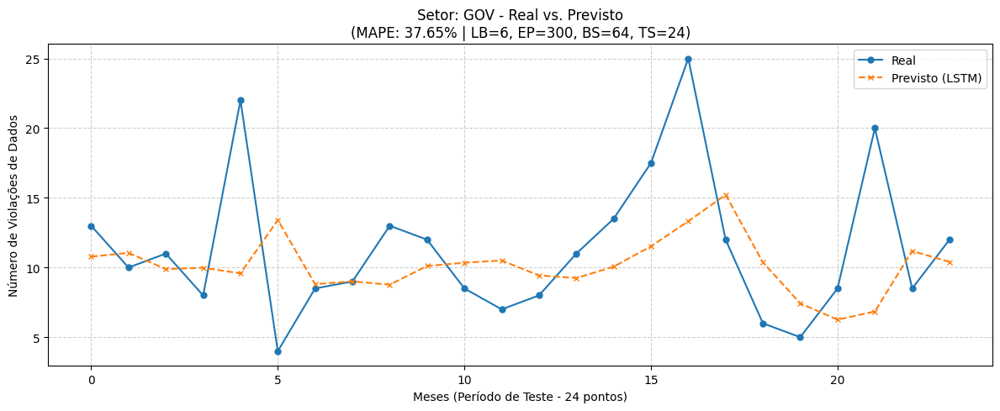

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=300, BS=64, TS=24]:
   MAE : 3.92
   RMSE: 5.41
   MAPE: 37.65%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


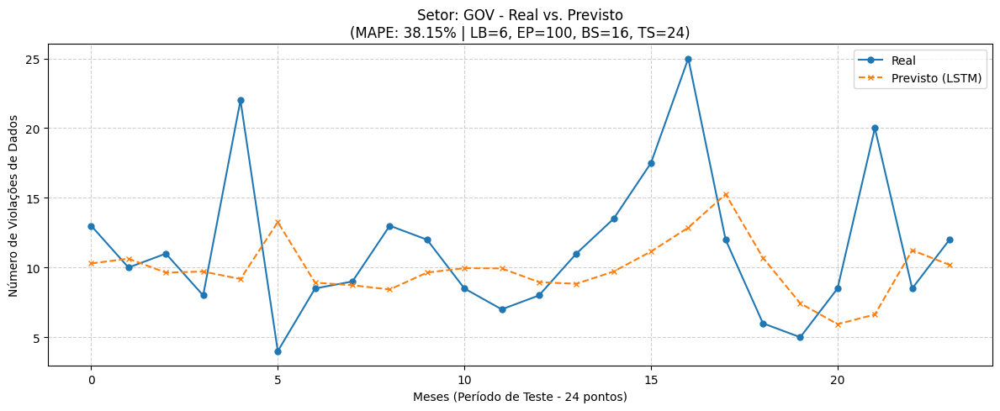

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=100, BS=16, TS=24]:
   MAE : 4.03
   RMSE: 5.56
   MAPE: 38.15%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


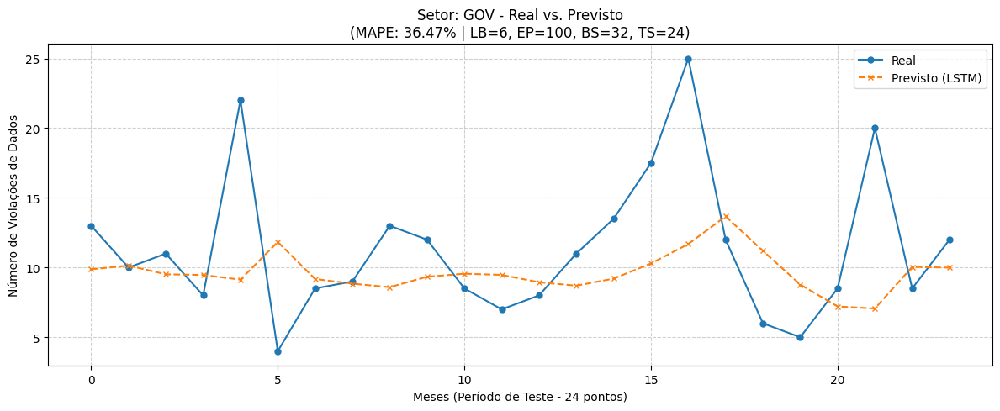

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=100, BS=32, TS=24]:
   MAE : 3.95
   RMSE: 5.59
   MAPE: 36.47%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


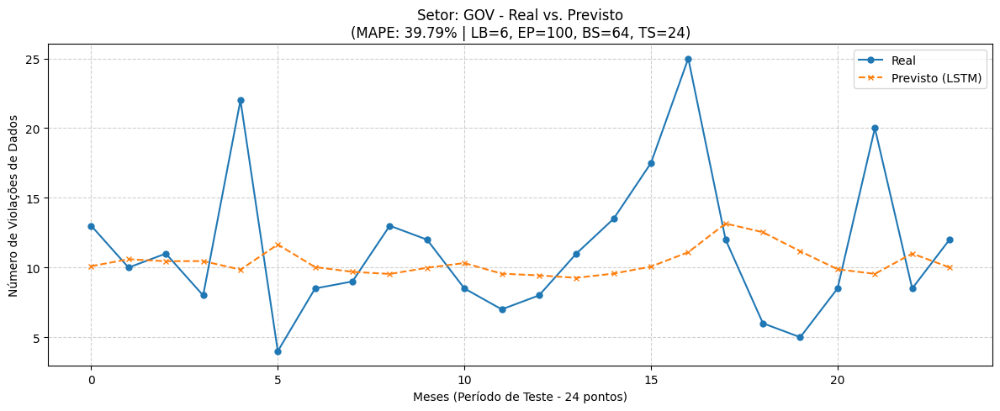

--------------------------------------------------
📊 Resultados para GOV [LB=6, EP=100, BS=64, TS=24]:
   MAE : 4.04
   RMSE: 5.49
   MAPE: 39.79%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


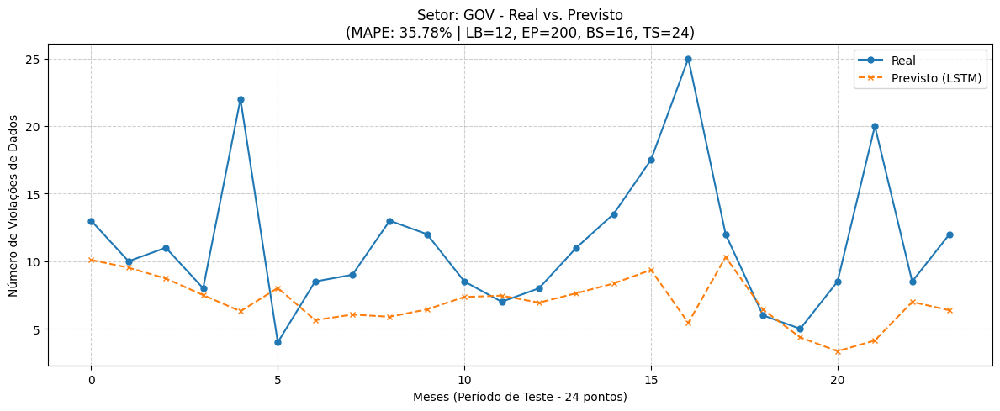

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=200, BS=16, TS=24]:
   MAE : 4.76
   RMSE: 7.01
   MAPE: 35.78%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


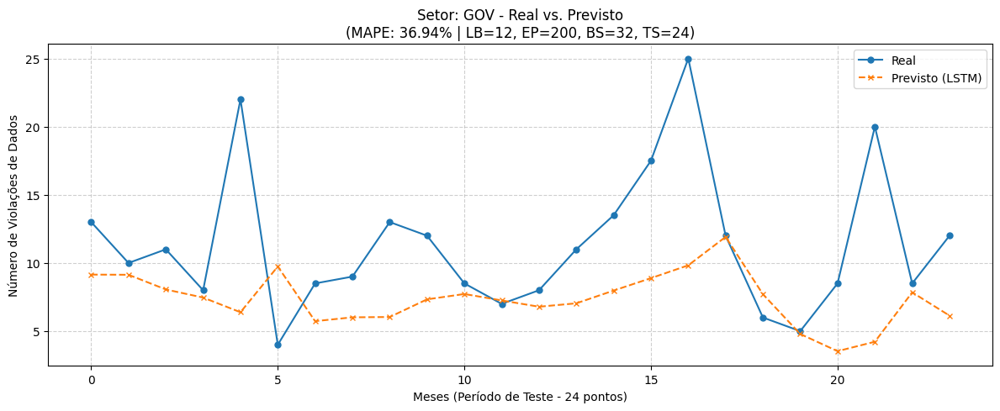

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=200, BS=32, TS=24]:
   MAE : 4.65
   RMSE: 6.62
   MAPE: 36.94%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


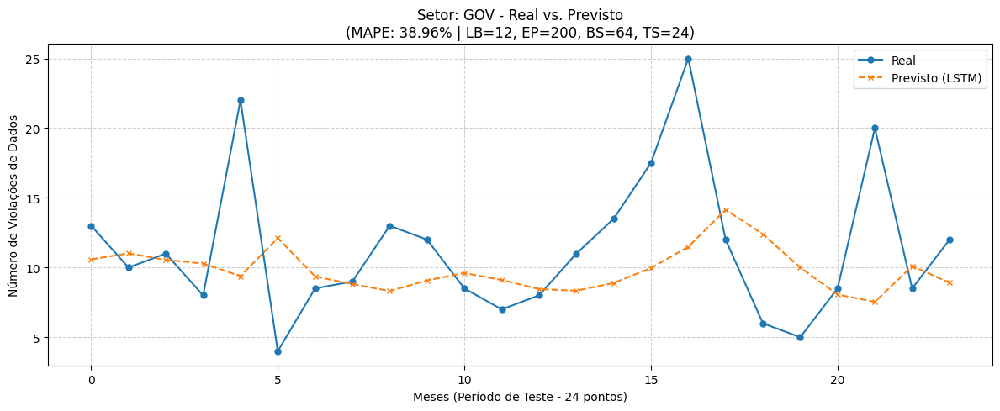

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=200, BS=64, TS=24]:
   MAE : 4.11
   RMSE: 5.70
   MAPE: 38.96%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


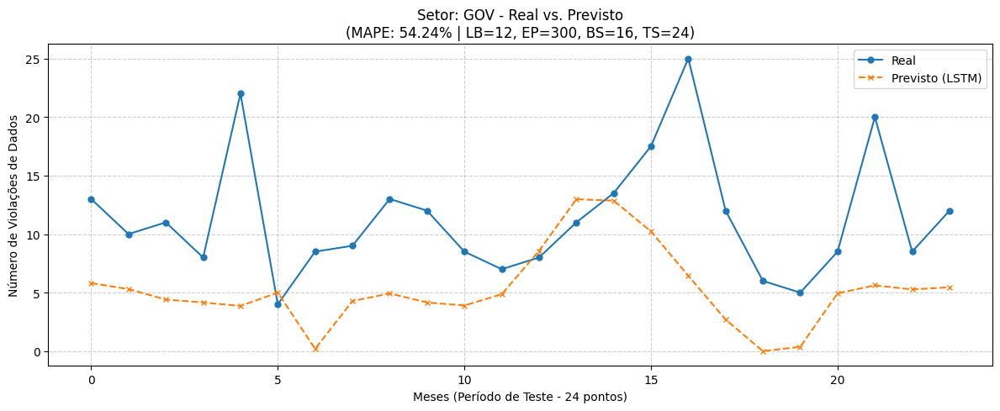

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=300, BS=16, TS=24]:
   MAE : 6.41
   RMSE: 7.97
   MAPE: 54.24%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


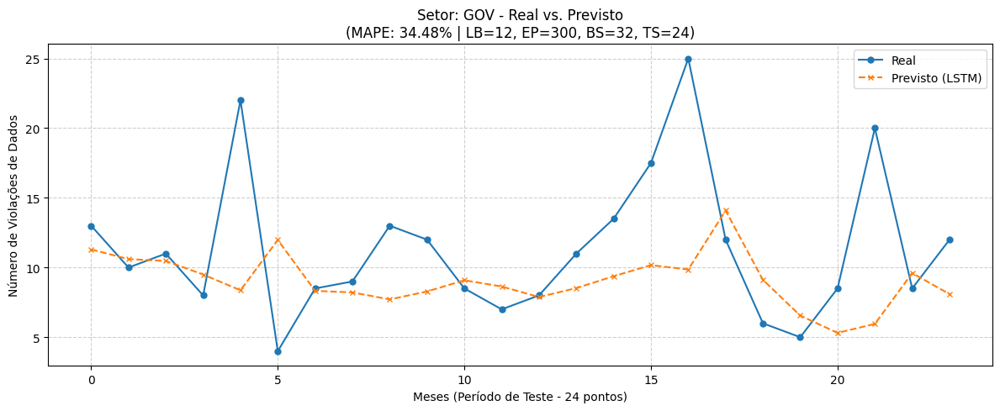

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=300, BS=32, TS=24]:
   MAE : 4.01
   RMSE: 5.94
   MAPE: 34.48%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


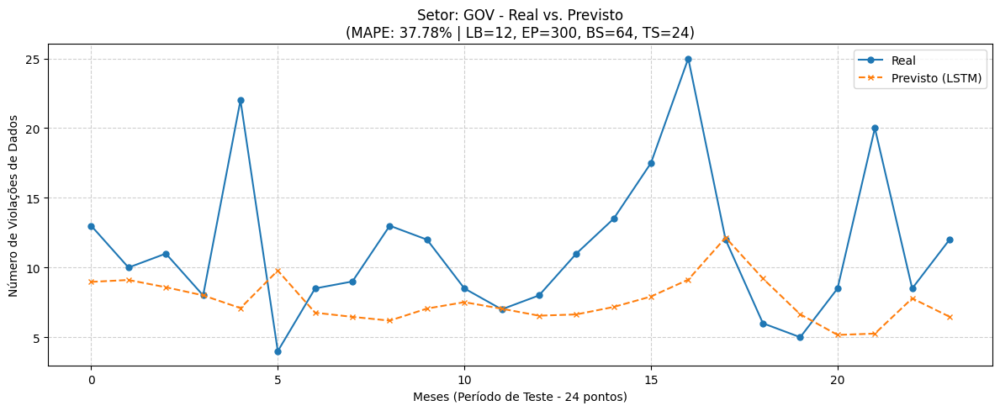

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=300, BS=64, TS=24]:
   MAE : 4.67
   RMSE: 6.57
   MAPE: 37.78%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


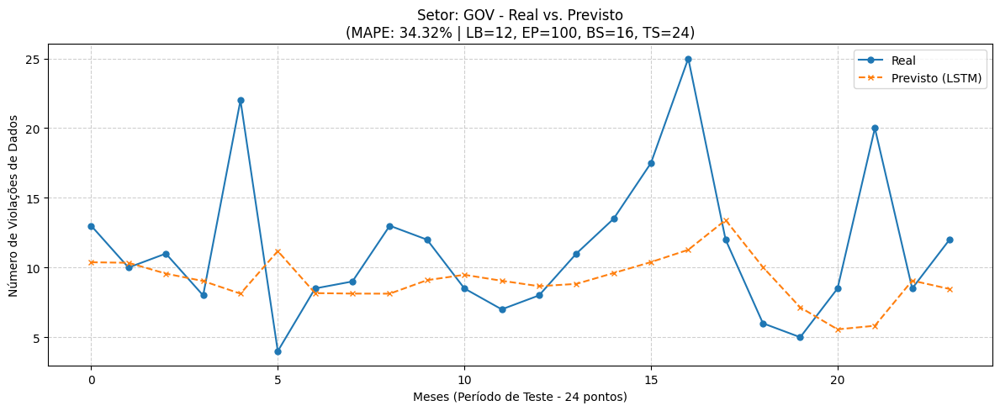

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=100, BS=16, TS=24]:
   MAE : 3.95
   RMSE: 5.76
   MAPE: 34.32%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


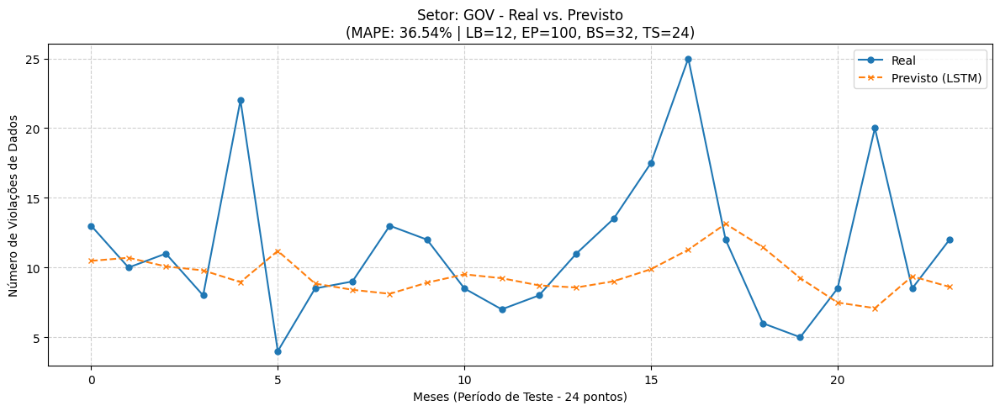

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=100, BS=32, TS=24]:
   MAE : 4.01
   RMSE: 5.68
   MAPE: 36.54%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


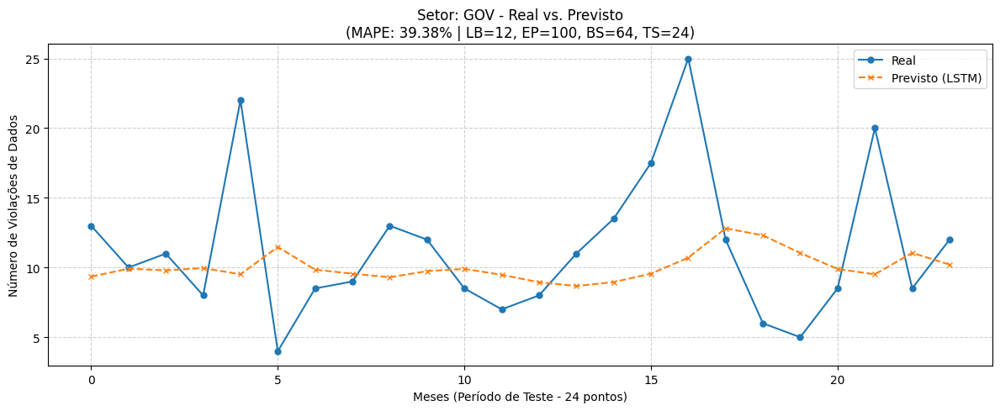

--------------------------------------------------
📊 Resultados para GOV [LB=12, EP=100, BS=64, TS=24]:
   MAE : 4.09
   RMSE: 5.60
   MAPE: 39.38%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


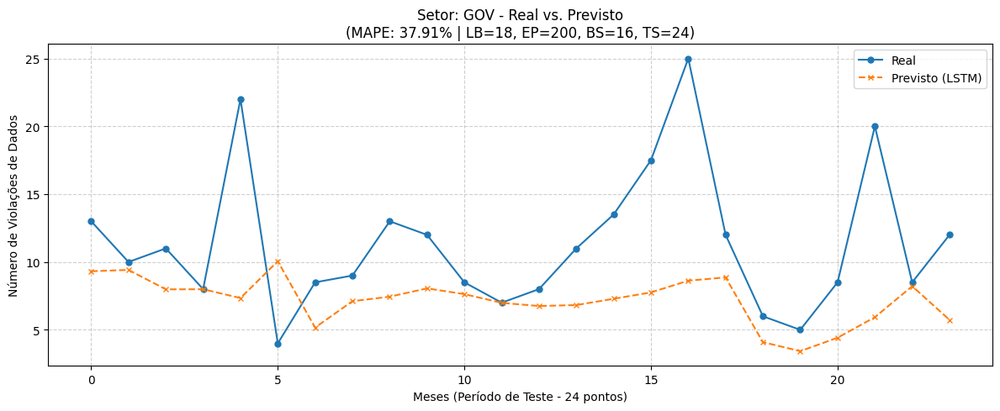

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=200, BS=16, TS=24]:
   MAE : 4.69
   RMSE: 6.54
   MAPE: 37.91%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


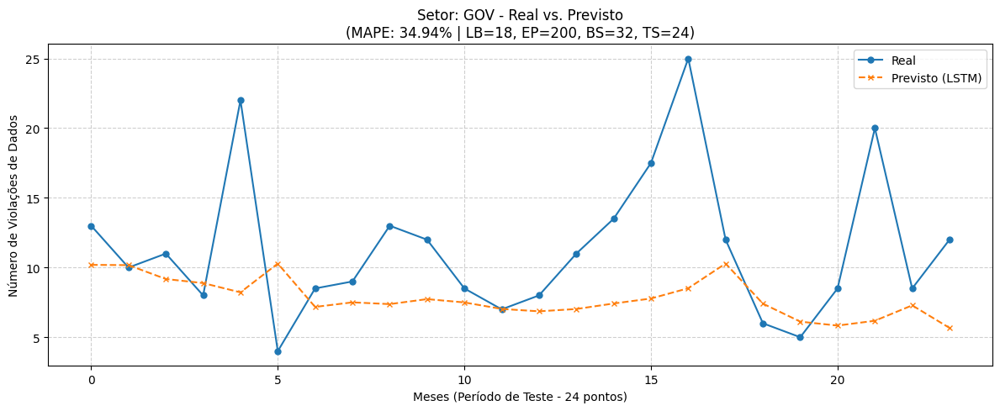

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=200, BS=32, TS=24]:
   MAE : 4.38
   RMSE: 6.33
   MAPE: 34.94%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


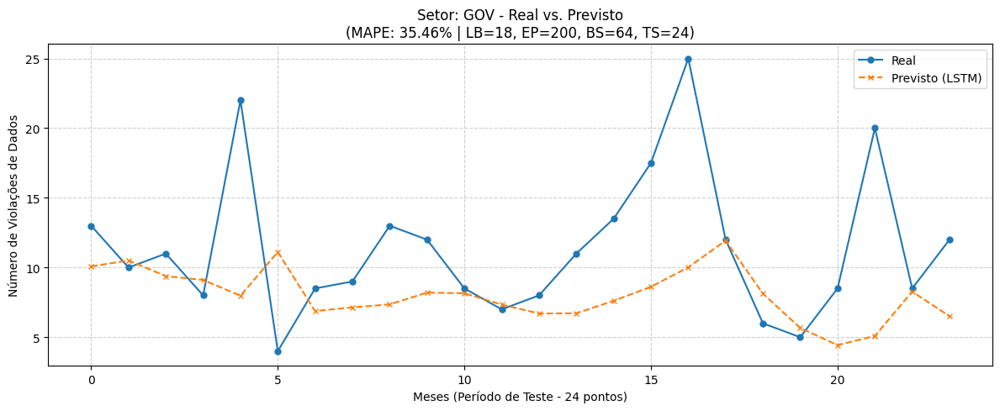

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=200, BS=64, TS=24]:
   MAE : 4.32
   RMSE: 6.27
   MAPE: 35.46%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


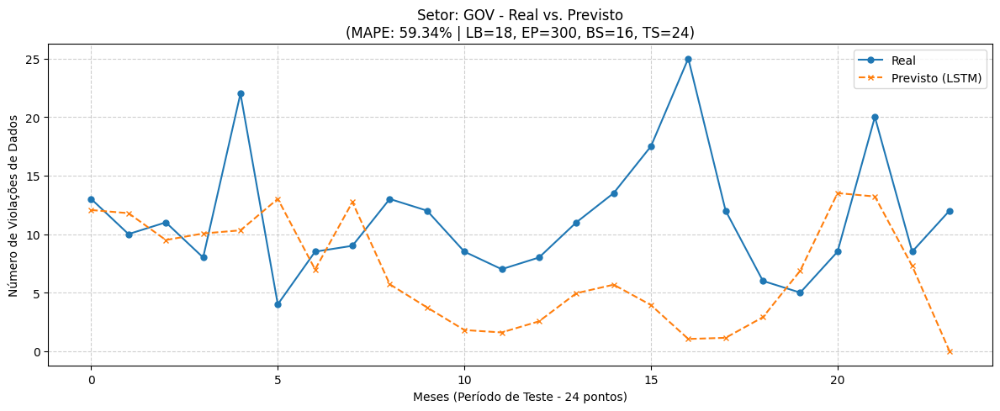

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=300, BS=16, TS=24]:
   MAE : 6.57
   RMSE: 8.35
   MAPE: 59.34%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


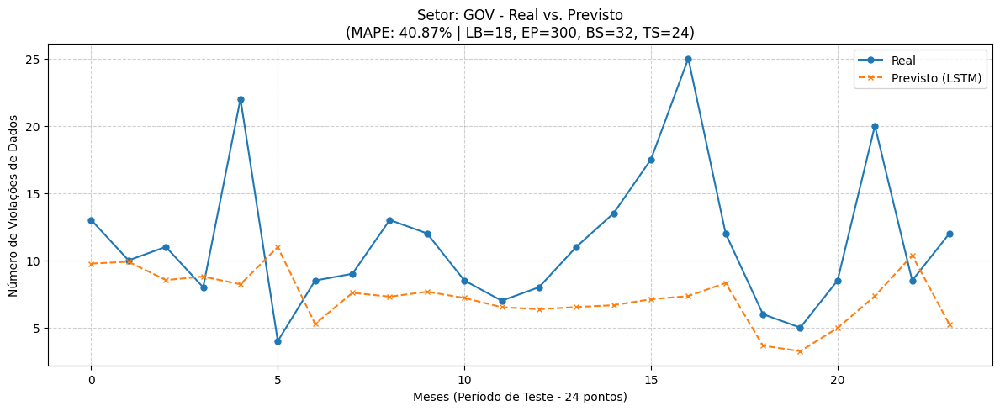

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=300, BS=32, TS=24]:
   MAE : 4.89
   RMSE: 6.63
   MAPE: 40.87%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


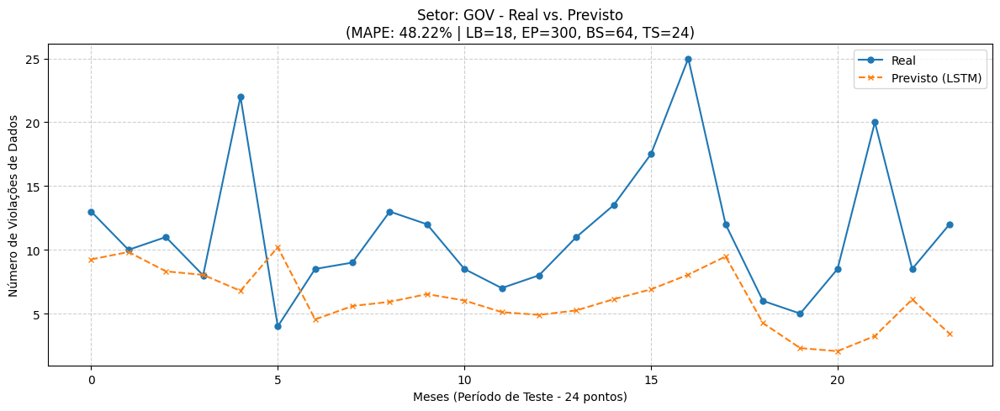

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=300, BS=64, TS=24]:
   MAE : 5.72
   RMSE: 7.42
   MAPE: 48.22%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


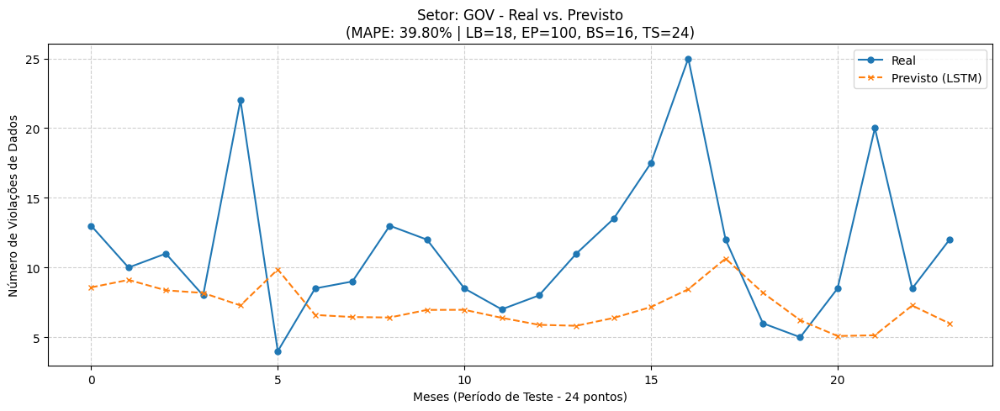

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=100, BS=16, TS=24]:
   MAE : 4.94
   RMSE: 6.77
   MAPE: 39.80%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


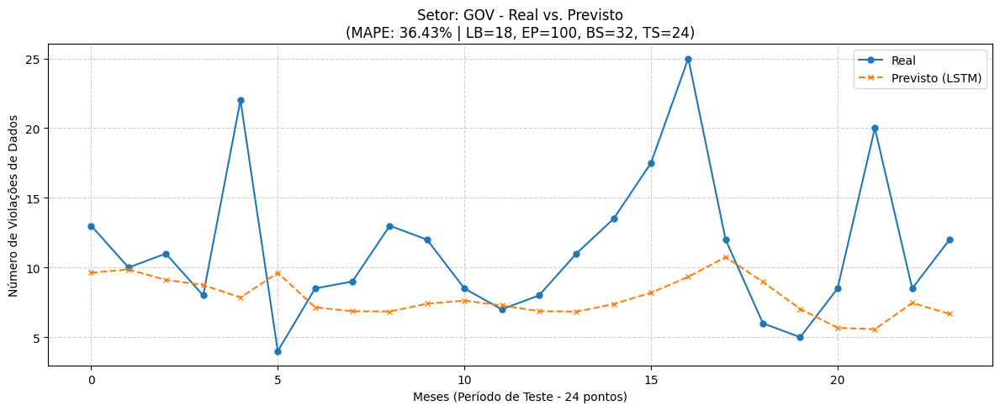

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=100, BS=32, TS=24]:
   MAE : 4.48
   RMSE: 6.33
   MAPE: 36.43%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


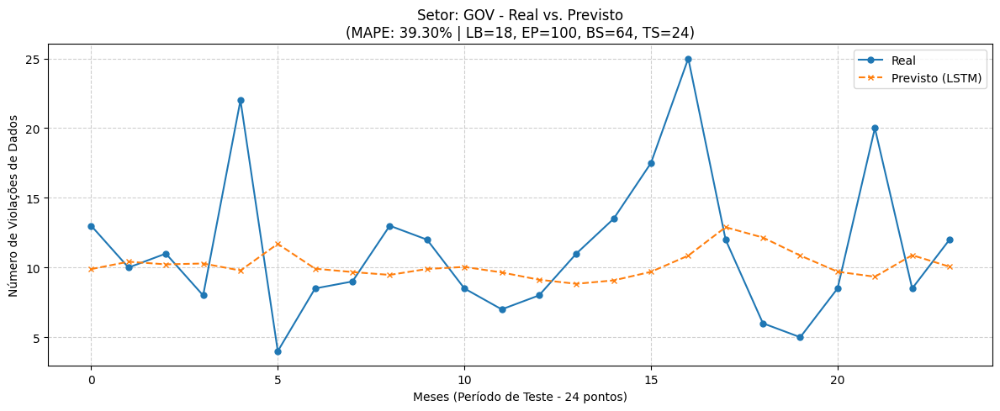

--------------------------------------------------
📊 Resultados para GOV [LB=18, EP=100, BS=64, TS=24]:
   MAE : 4.05
   RMSE: 5.54
   MAPE: 39.30%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: MED ====================
Iniciando Grid Search para o setor: MED (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


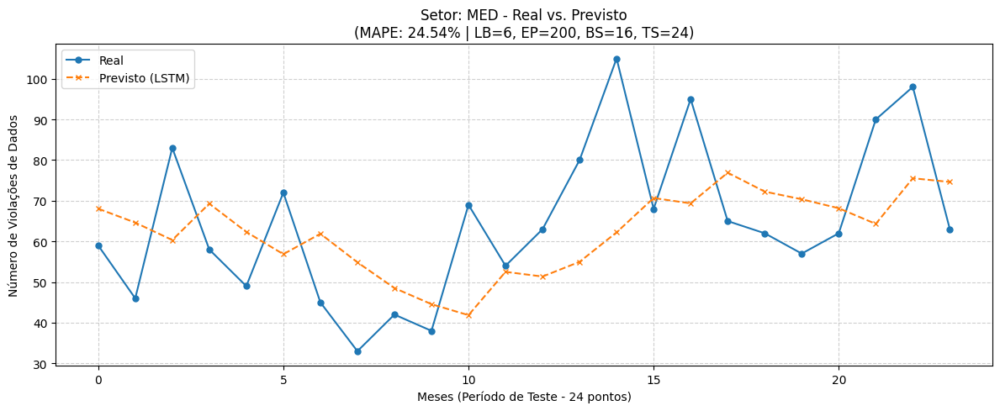

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=200, BS=16, TS=24]:
   MAE : 15.82
   RMSE: 18.35
   MAPE: 24.54%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


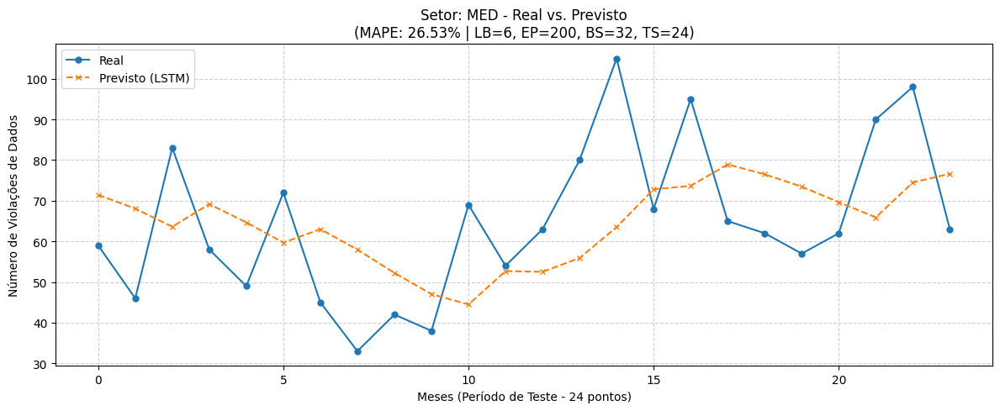

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=200, BS=32, TS=24]:
   MAE : 16.55
   RMSE: 18.51
   MAPE: 26.53%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


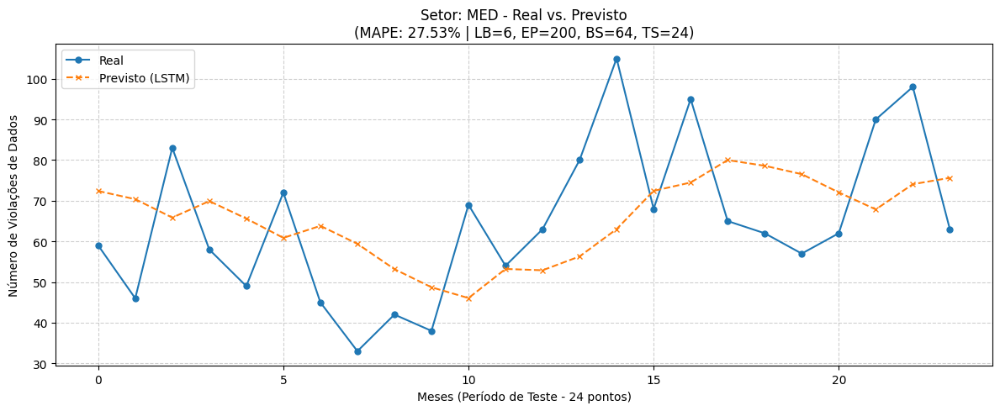

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=200, BS=64, TS=24]:
   MAE : 16.92
   RMSE: 18.82
   MAPE: 27.53%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


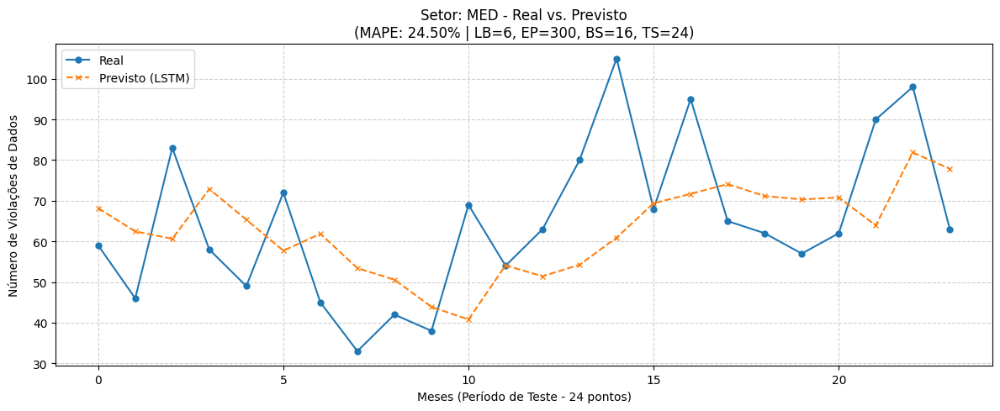

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=300, BS=16, TS=24]:
   MAE : 15.71
   RMSE: 18.28
   MAPE: 24.50%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


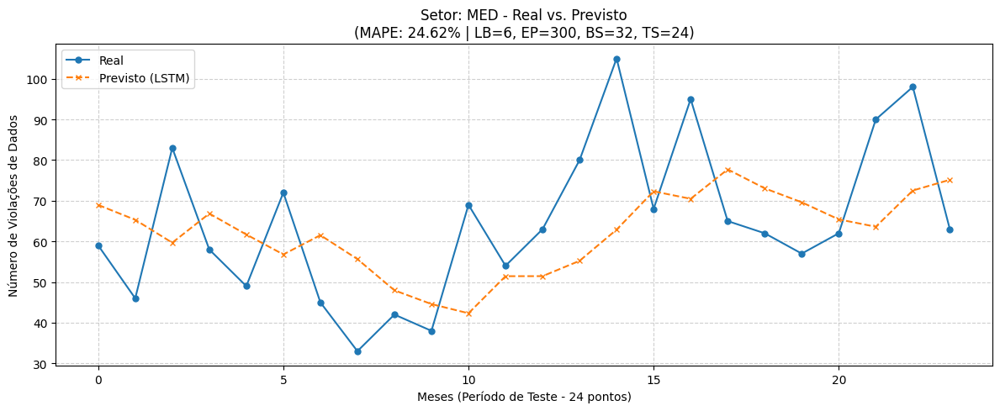

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=300, BS=32, TS=24]:
   MAE : 15.89
   RMSE: 18.44
   MAPE: 24.62%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


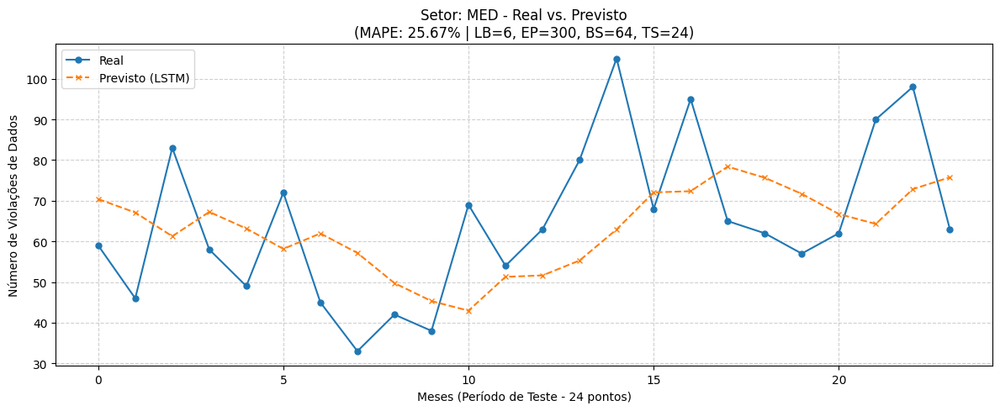

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=300, BS=64, TS=24]:
   MAE : 16.31
   RMSE: 18.59
   MAPE: 25.67%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


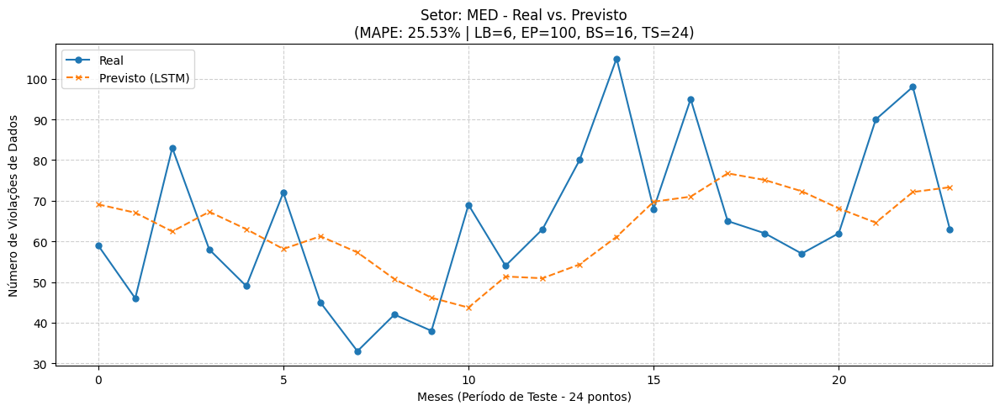

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=100, BS=16, TS=24]:
   MAE : 16.23
   RMSE: 18.70
   MAPE: 25.53%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


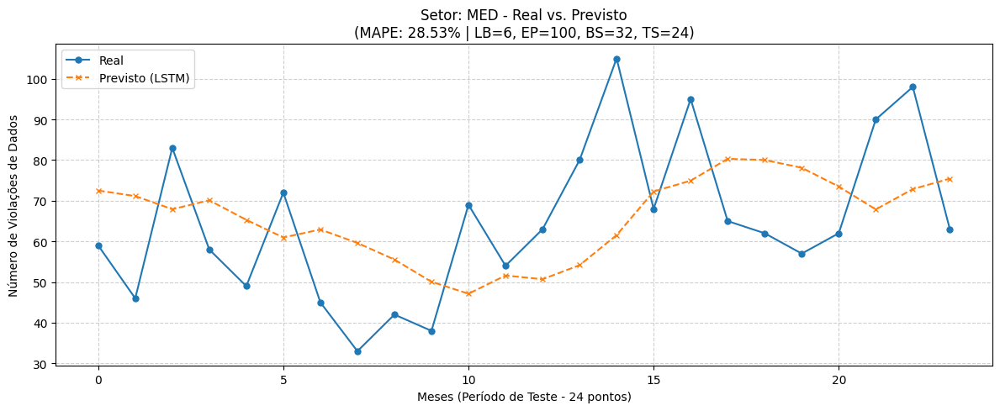

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=100, BS=32, TS=24]:
   MAE : 17.47
   RMSE: 19.32
   MAPE: 28.53%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


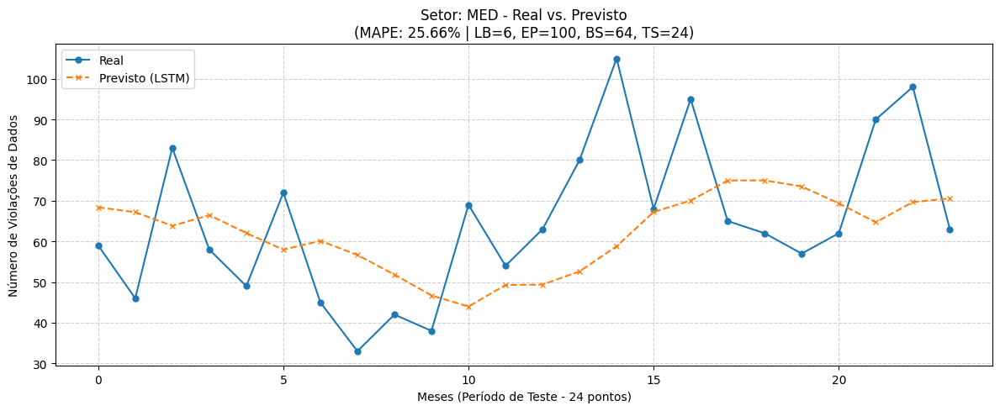

--------------------------------------------------
📊 Resultados para MED [LB=6, EP=100, BS=64, TS=24]:
   MAE : 16.39
   RMSE: 19.08
   MAPE: 25.66%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


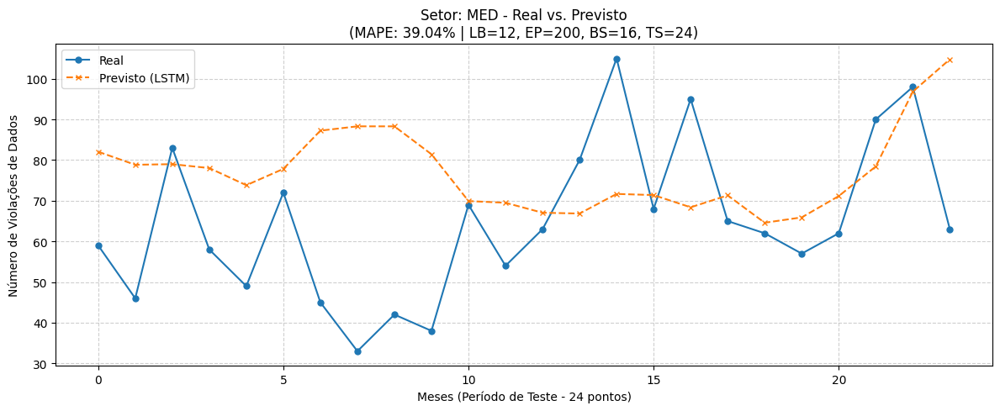

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=200, BS=16, TS=24]:
   MAE : 19.85
   RMSE: 25.74
   MAPE: 39.04%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


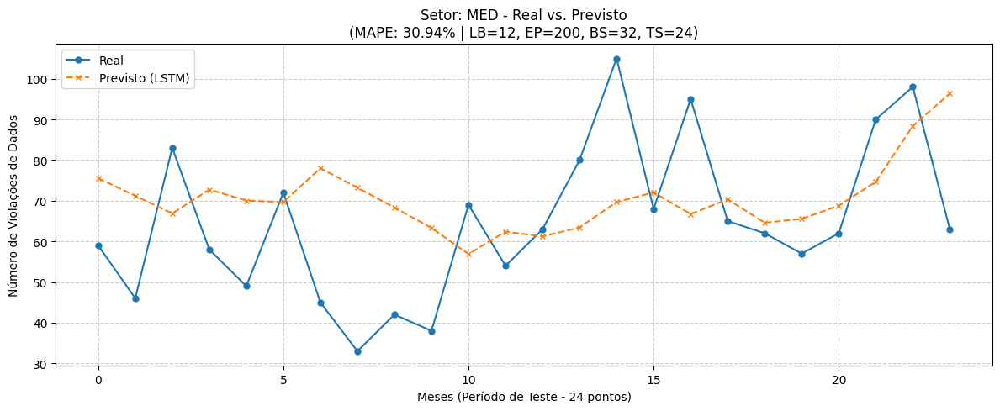

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=200, BS=32, TS=24]:
   MAE : 17.04
   RMSE: 20.44
   MAPE: 30.94%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


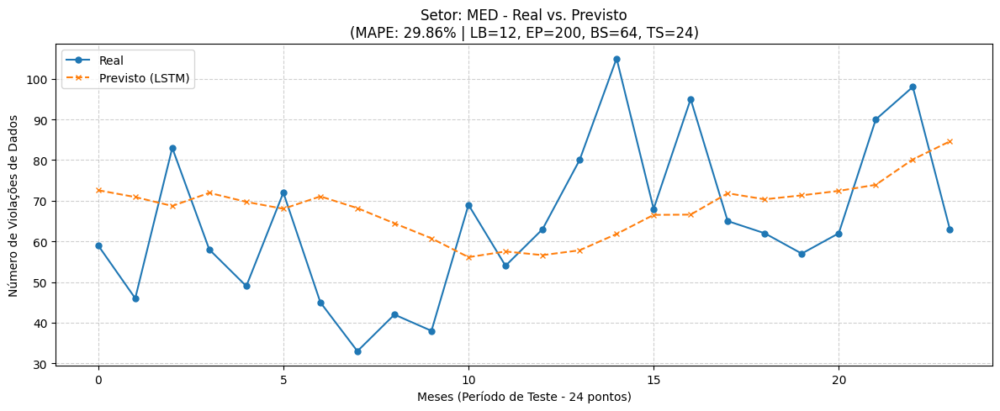

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=200, BS=64, TS=24]:
   MAE : 17.14
   RMSE: 19.84
   MAPE: 29.86%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


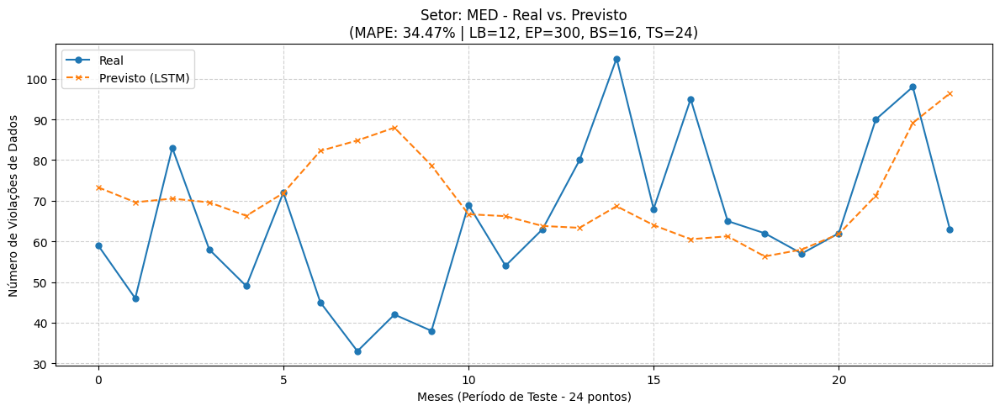

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=300, BS=16, TS=24]:
   MAE : 18.07
   RMSE: 23.94
   MAPE: 34.47%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


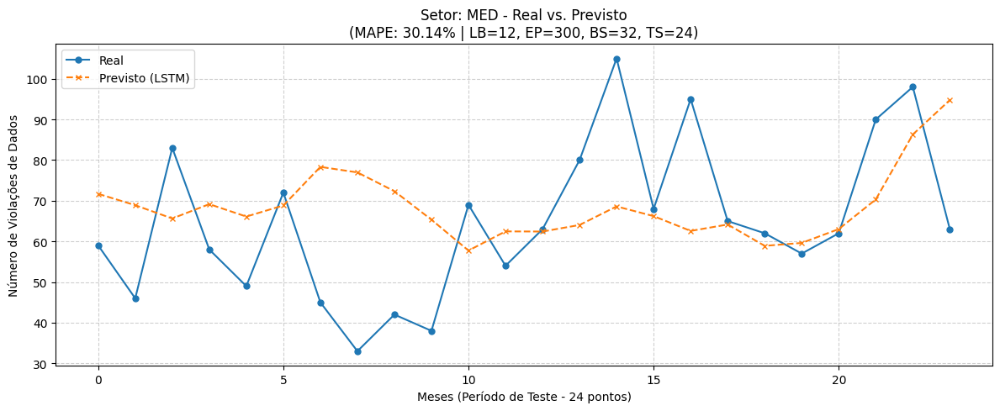

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=300, BS=32, TS=24]:
   MAE : 16.54
   RMSE: 20.93
   MAPE: 30.14%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


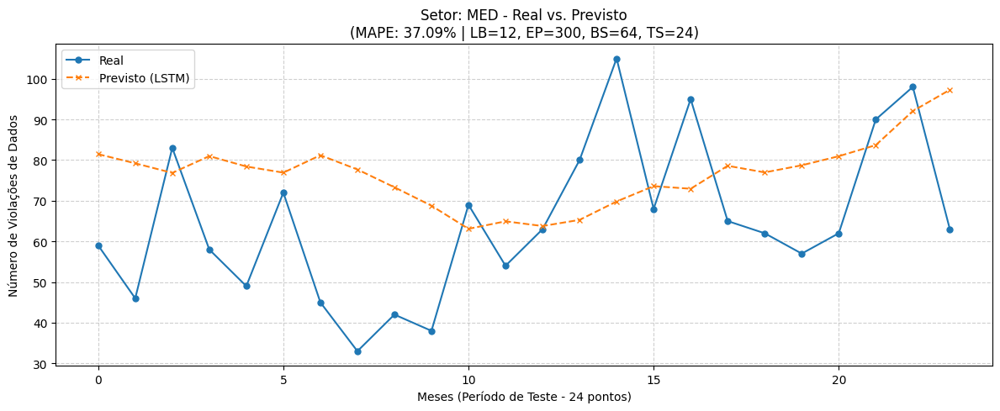

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=300, BS=64, TS=24]:
   MAE : 19.71
   RMSE: 23.20
   MAPE: 37.09%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


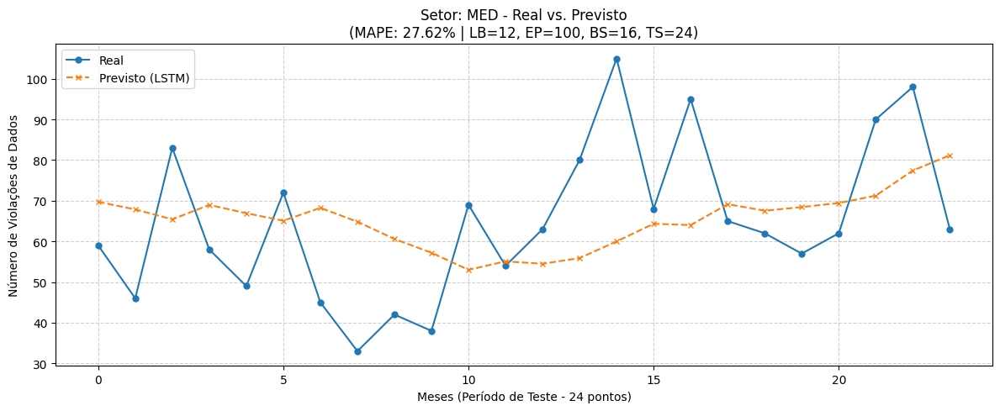

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=100, BS=16, TS=24]:
   MAE : 16.43
   RMSE: 19.27
   MAPE: 27.62%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step


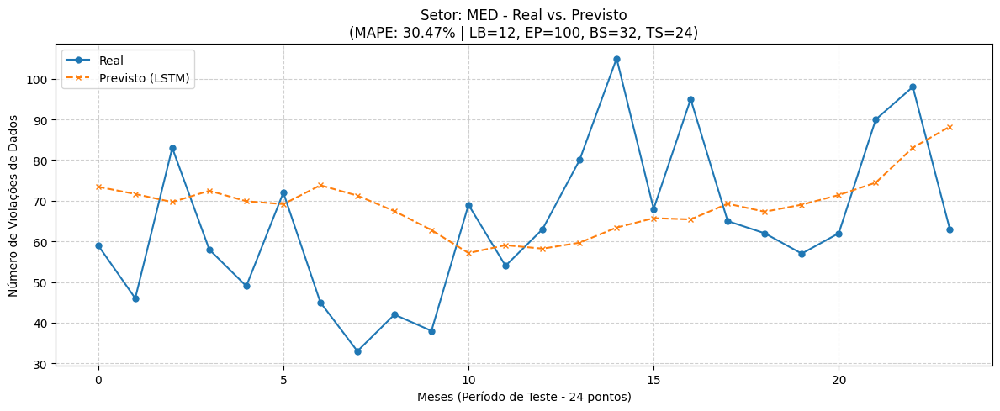

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=100, BS=32, TS=24]:
   MAE : 17.13
   RMSE: 20.26
   MAPE: 30.47%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


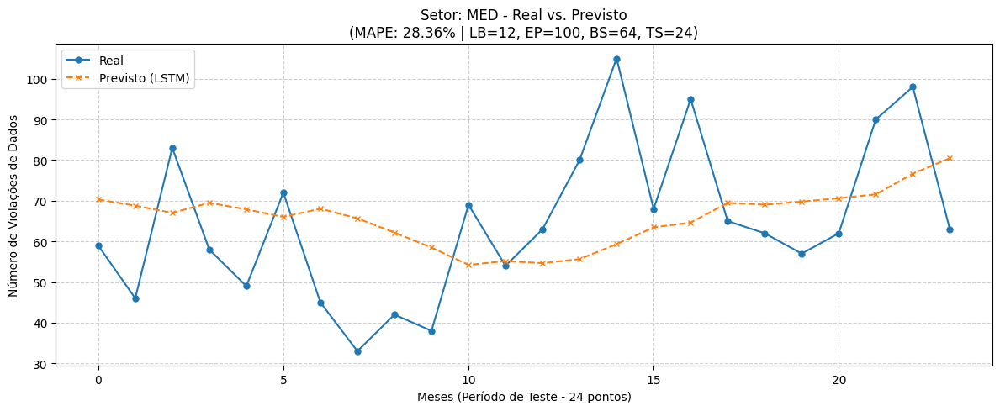

--------------------------------------------------
📊 Resultados para MED [LB=12, EP=100, BS=64, TS=24]:
   MAE : 16.76
   RMSE: 19.55
   MAPE: 28.36%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


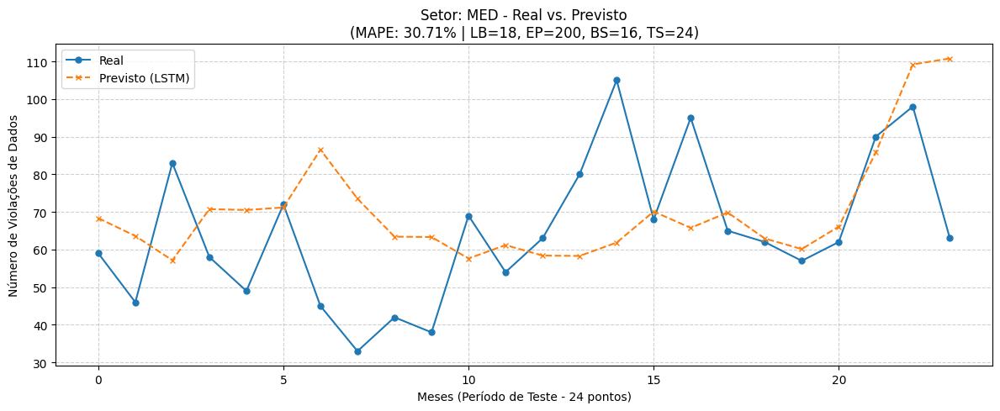

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=200, BS=16, TS=24]:
   MAE : 17.17
   RMSE: 22.39
   MAPE: 30.71%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


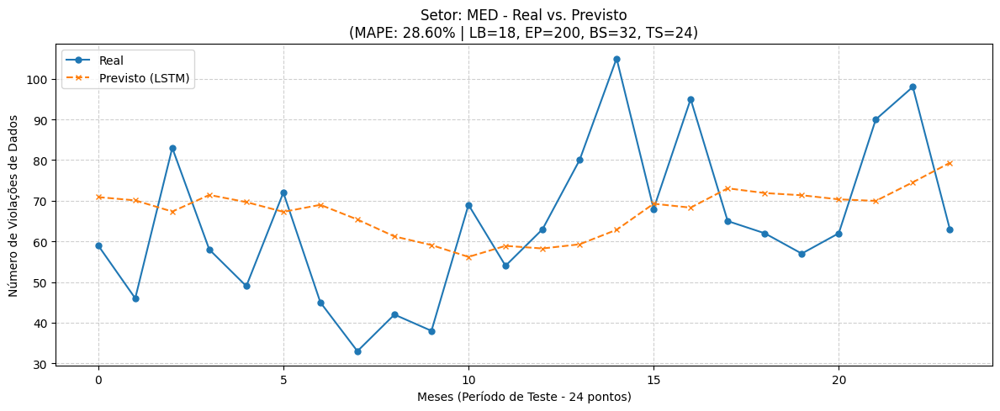

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=200, BS=32, TS=24]:
   MAE : 16.71
   RMSE: 19.17
   MAPE: 28.60%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


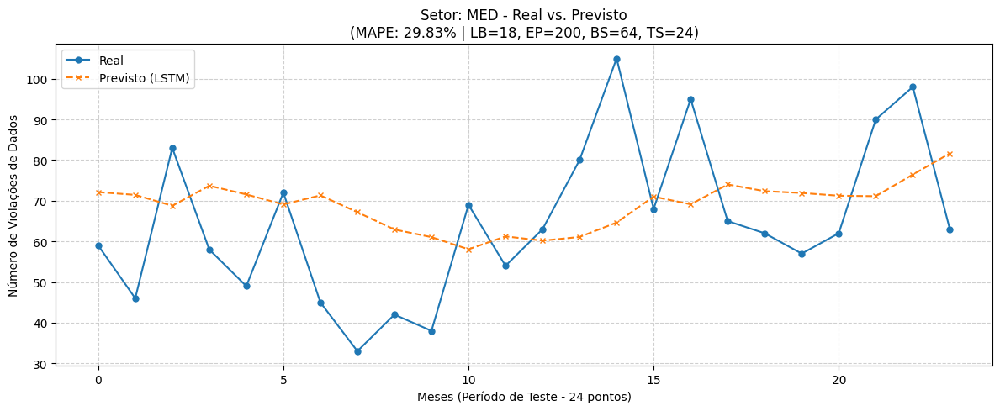

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=200, BS=64, TS=24]:
   MAE : 17.09
   RMSE: 19.50
   MAPE: 29.83%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


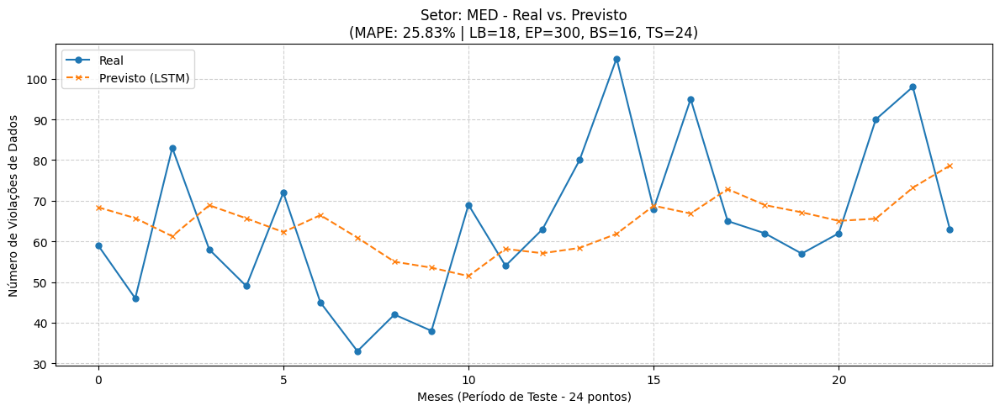

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=300, BS=16, TS=24]:
   MAE : 15.84
   RMSE: 18.54
   MAPE: 25.83%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


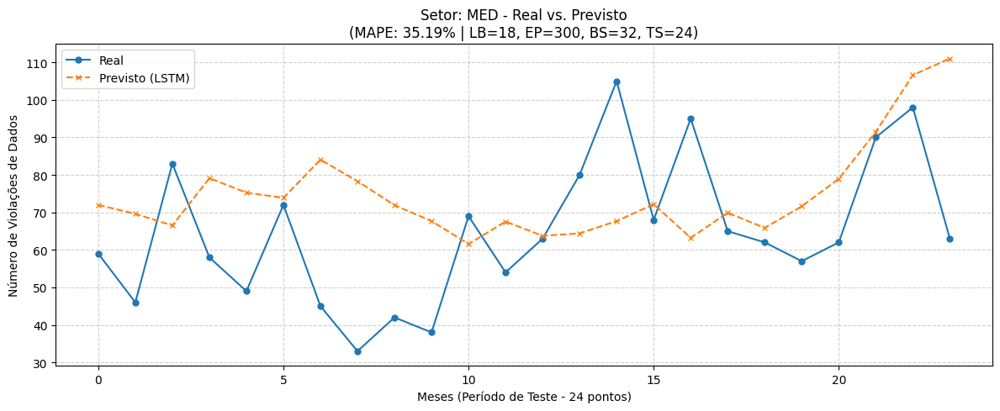

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=300, BS=32, TS=24]:
   MAE : 18.98
   RMSE: 23.56
   MAPE: 35.19%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


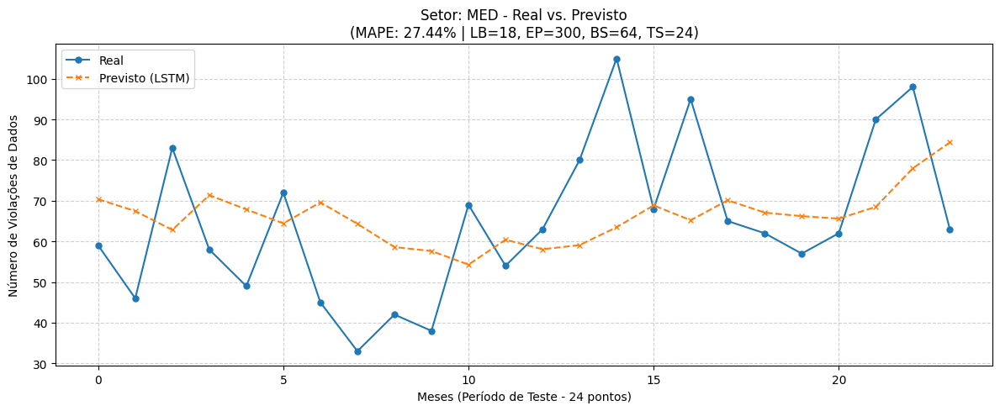

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=300, BS=64, TS=24]:
   MAE : 16.25
   RMSE: 18.97
   MAPE: 27.44%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


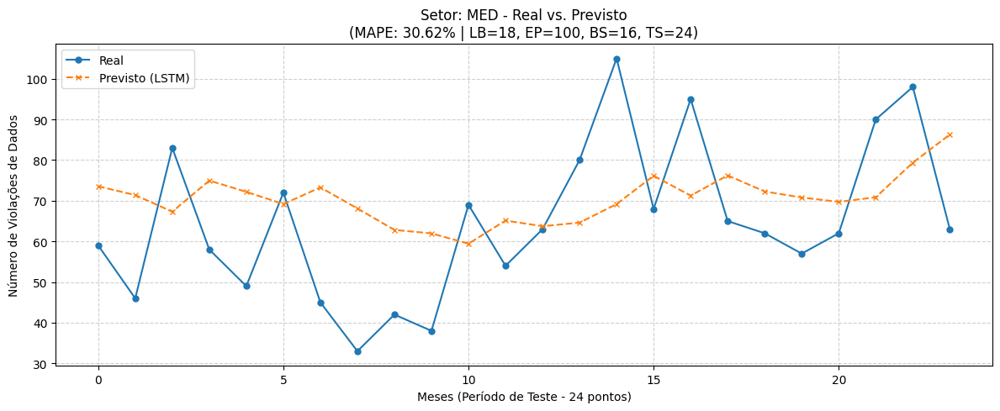

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=100, BS=16, TS=24]:
   MAE : 17.31
   RMSE: 19.45
   MAPE: 30.62%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


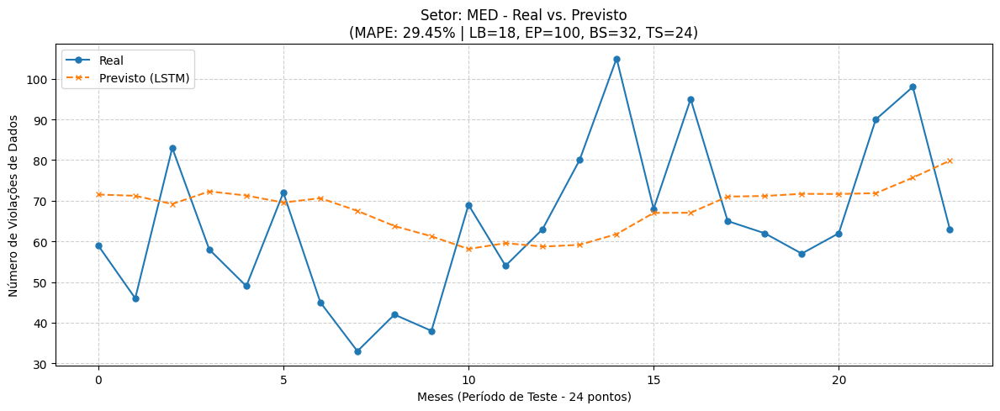

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=100, BS=32, TS=24]:
   MAE : 16.93
   RMSE: 19.73
   MAPE: 29.45%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


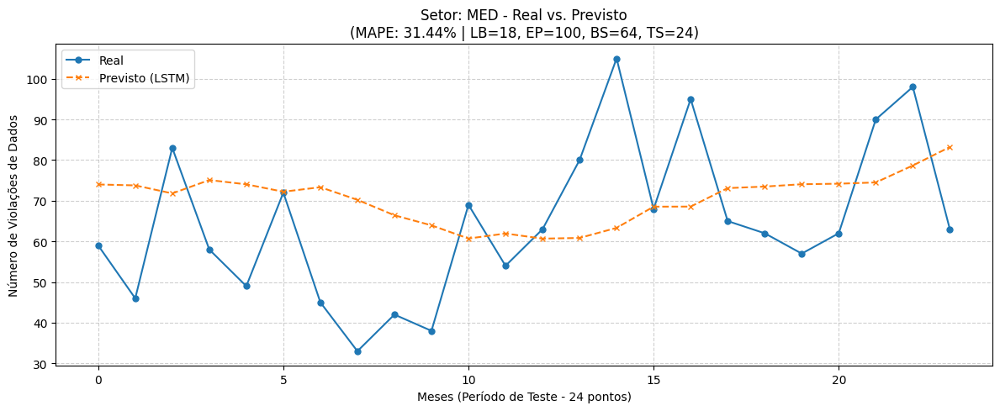

--------------------------------------------------
📊 Resultados para MED [LB=18, EP=100, BS=64, TS=24]:
   MAE : 17.60
   RMSE: 20.51
   MAPE: 31.44%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: NGO ====================
Iniciando Grid Search para o setor: NGO (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


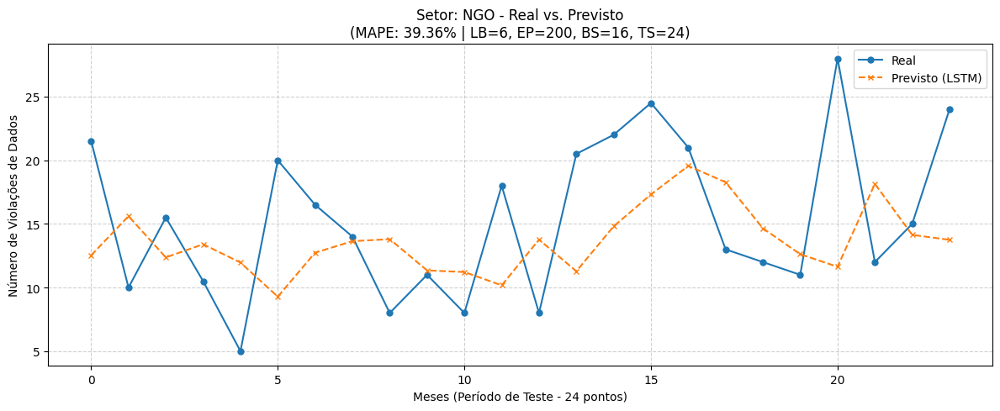

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=200, BS=16, TS=24]:
   MAE : 5.57
   RMSE: 6.73
   MAPE: 39.36%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


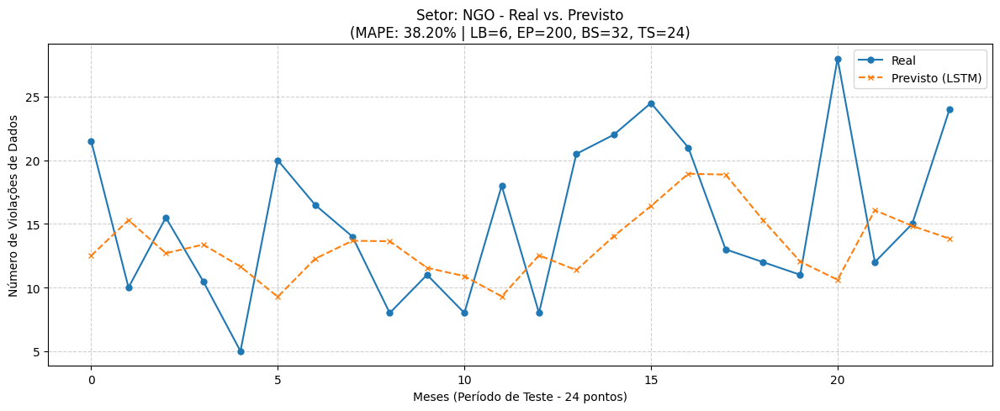

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=200, BS=32, TS=24]:
   MAE : 5.56
   RMSE: 6.85
   MAPE: 38.20%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


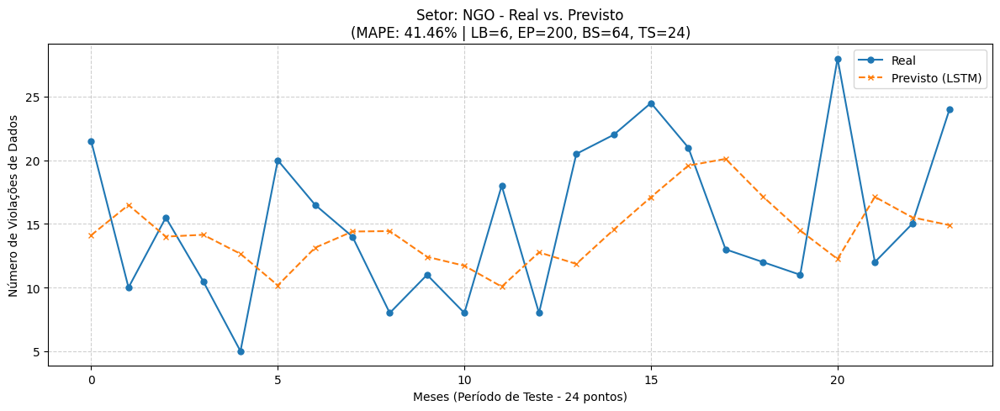

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=200, BS=64, TS=24]:
   MAE : 5.65
   RMSE: 6.63
   MAPE: 41.46%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


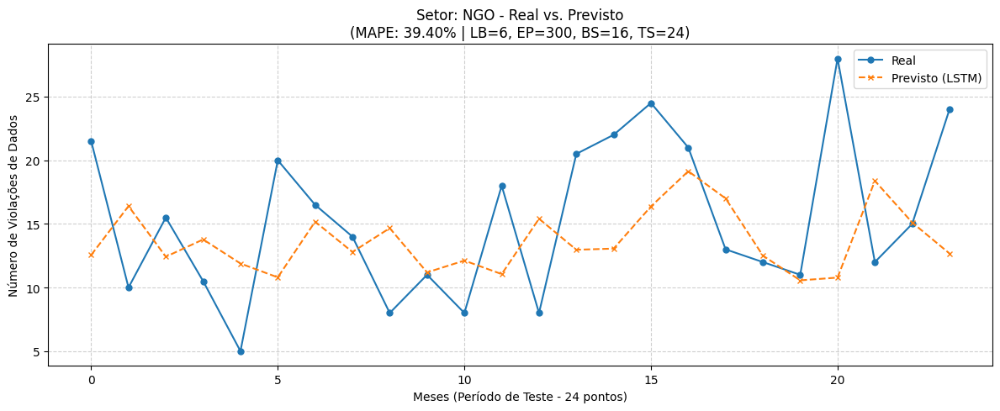

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=300, BS=16, TS=24]:
   MAE : 5.50
   RMSE: 6.86
   MAPE: 39.40%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


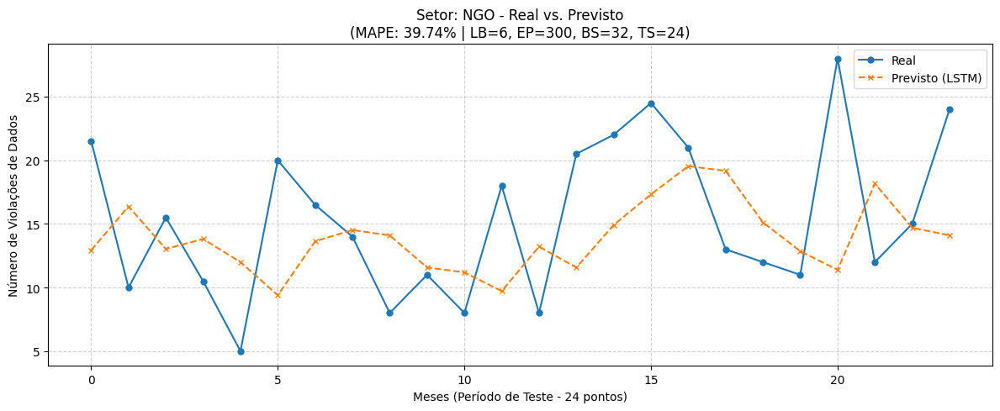

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=300, BS=32, TS=24]:
   MAE : 5.58
   RMSE: 6.74
   MAPE: 39.74%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


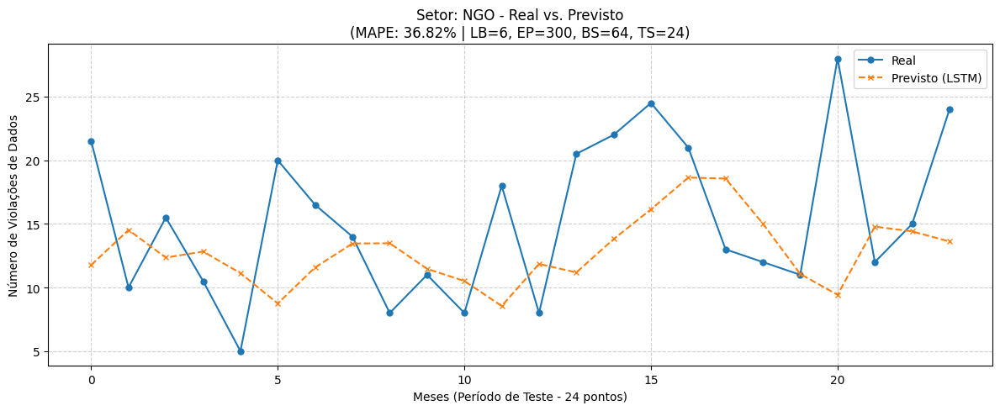

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=300, BS=64, TS=24]:
   MAE : 5.56
   RMSE: 7.04
   MAPE: 36.82%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


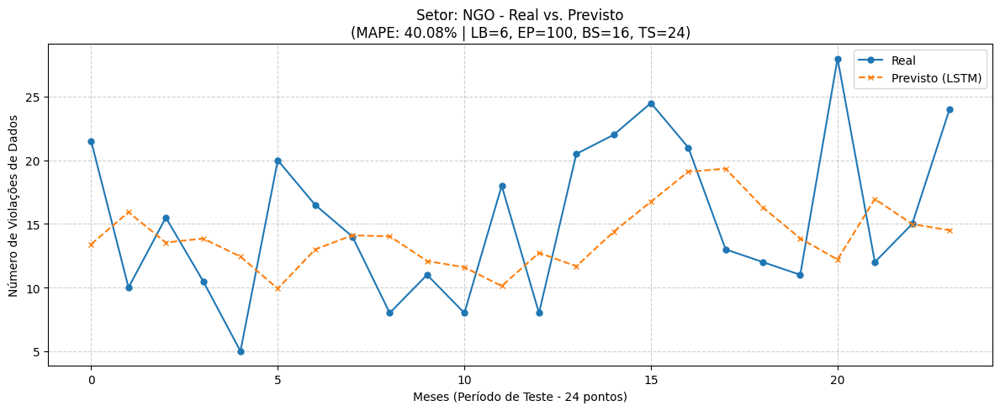

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=100, BS=16, TS=24]:
   MAE : 5.57
   RMSE: 6.62
   MAPE: 40.08%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


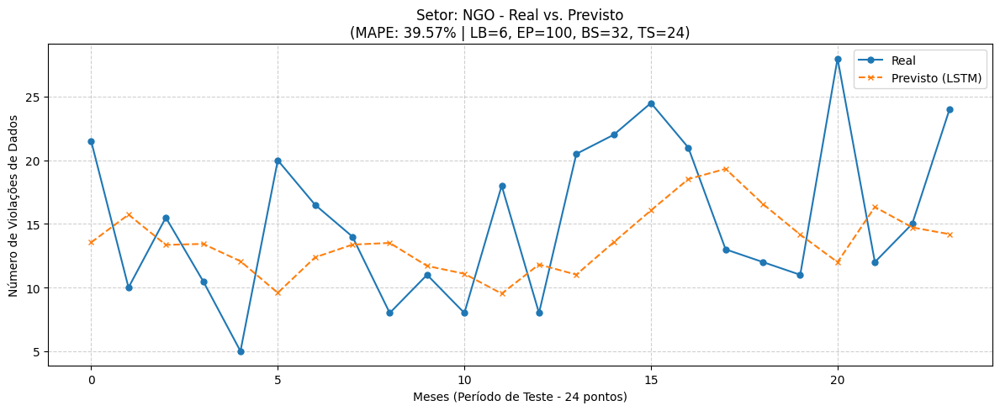

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=100, BS=32, TS=24]:
   MAE : 5.66
   RMSE: 6.75
   MAPE: 39.57%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


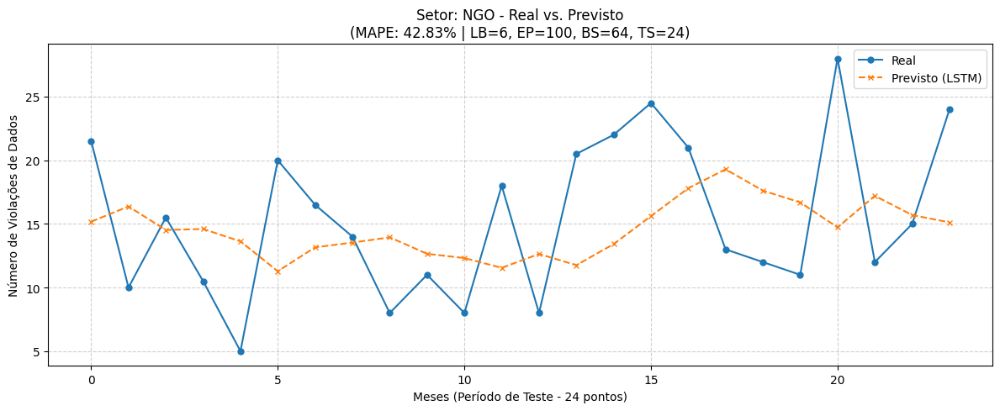

--------------------------------------------------
📊 Resultados para NGO [LB=6, EP=100, BS=64, TS=24]:
   MAE : 5.71
   RMSE: 6.47
   MAPE: 42.83%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


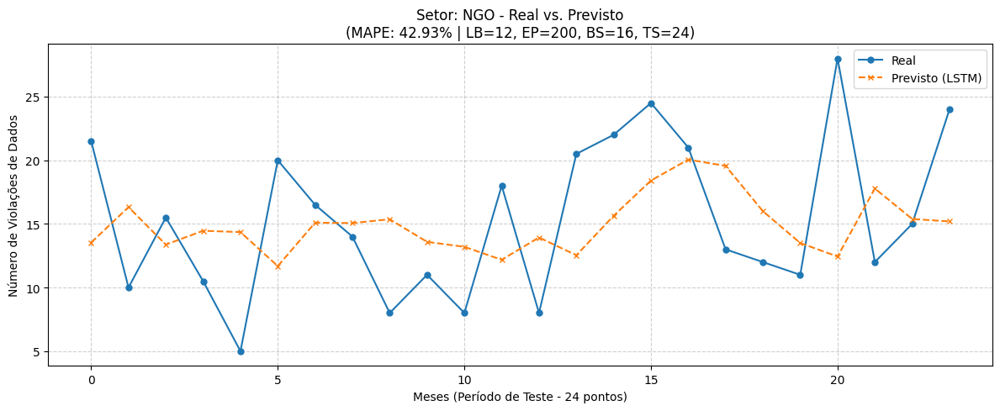

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=200, BS=16, TS=24]:
   MAE : 5.52
   RMSE: 6.46
   MAPE: 42.93%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


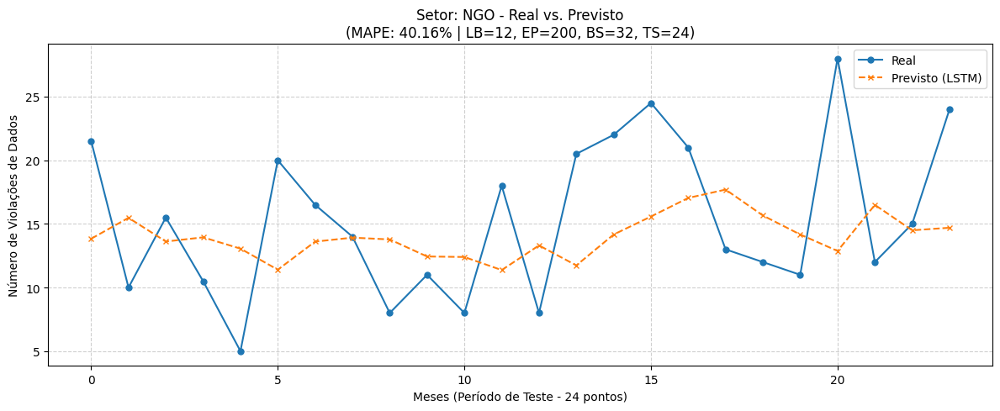

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=200, BS=32, TS=24]:
   MAE : 5.50
   RMSE: 6.43
   MAPE: 40.16%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


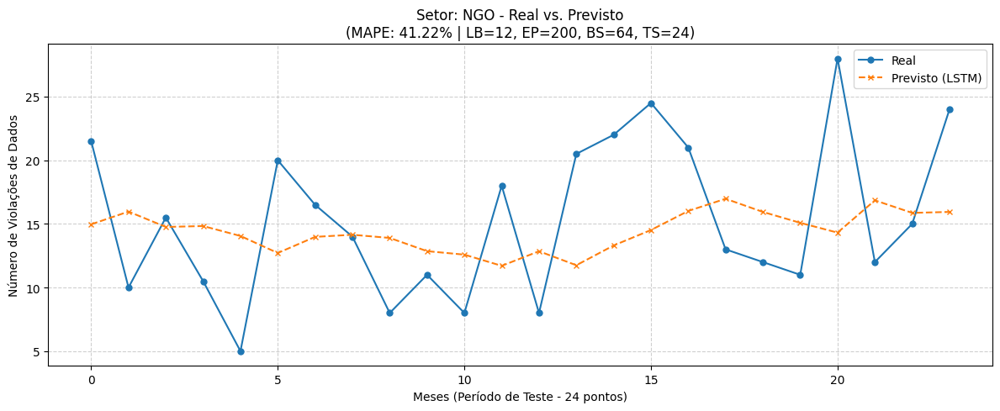

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=200, BS=64, TS=24]:
   MAE : 5.50
   RMSE: 6.33
   MAPE: 41.22%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


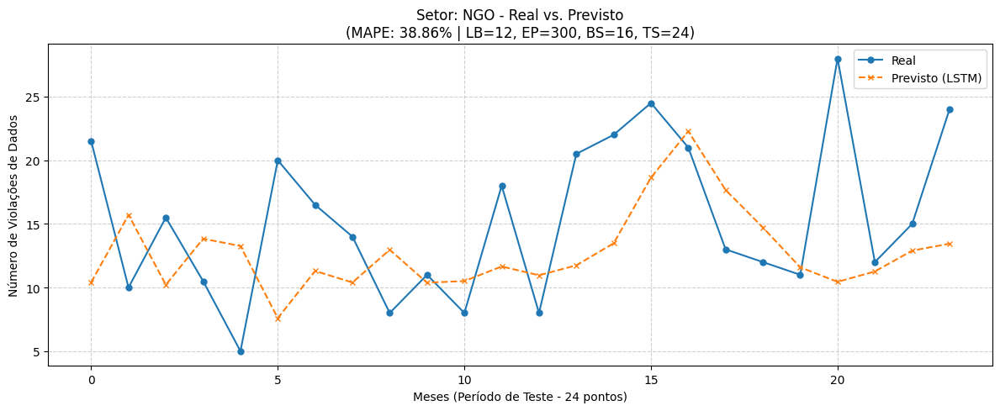

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=300, BS=16, TS=24]:
   MAE : 5.65
   RMSE: 7.00
   MAPE: 38.86%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


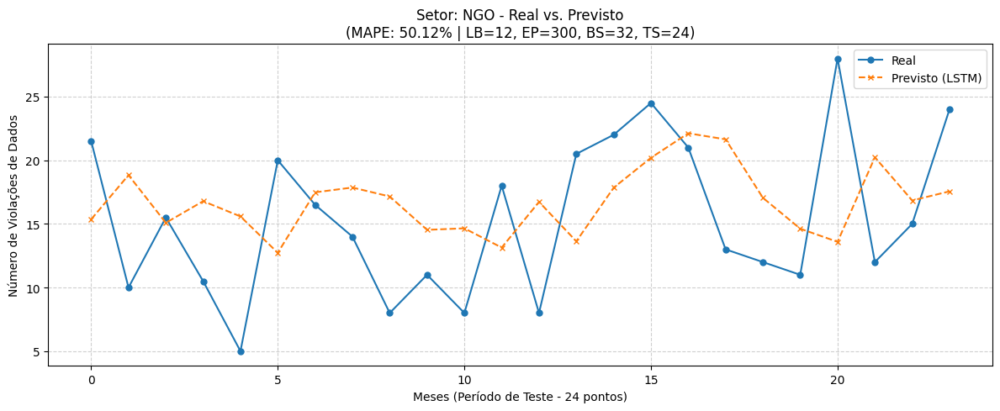

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=300, BS=32, TS=24]:
   MAE : 5.92
   RMSE: 6.75
   MAPE: 50.12%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


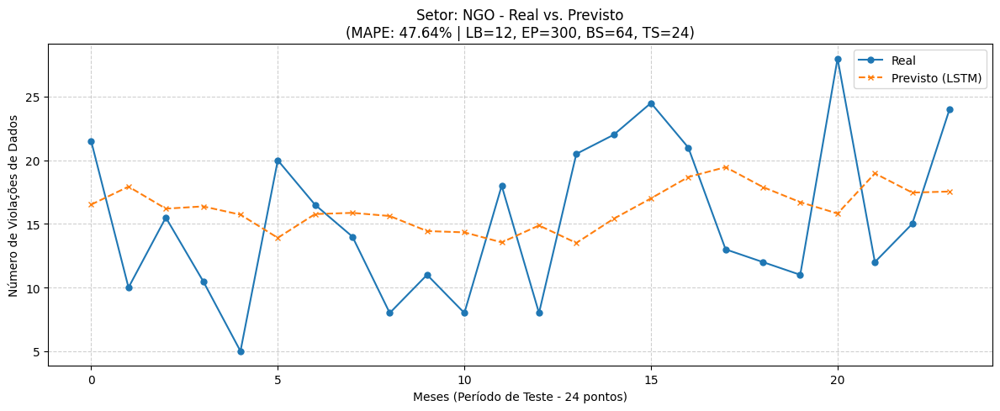

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=300, BS=64, TS=24]:
   MAE : 5.72
   RMSE: 6.34
   MAPE: 47.64%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


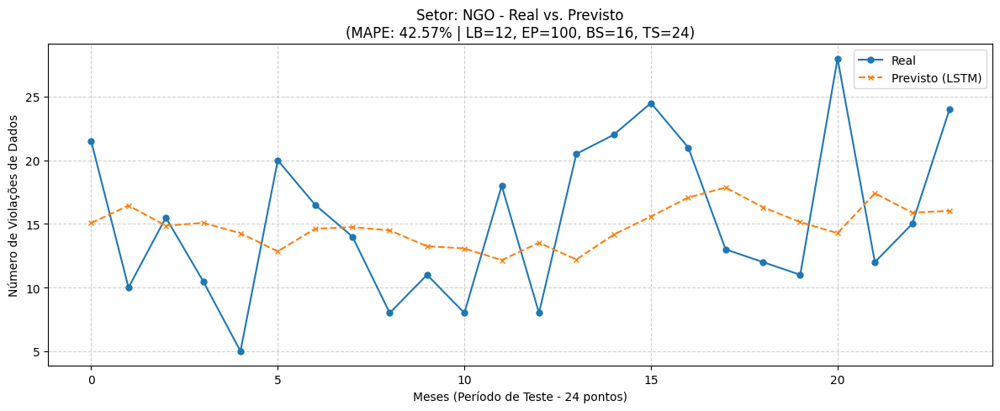

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=100, BS=16, TS=24]:
   MAE : 5.53
   RMSE: 6.29
   MAPE: 42.57%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


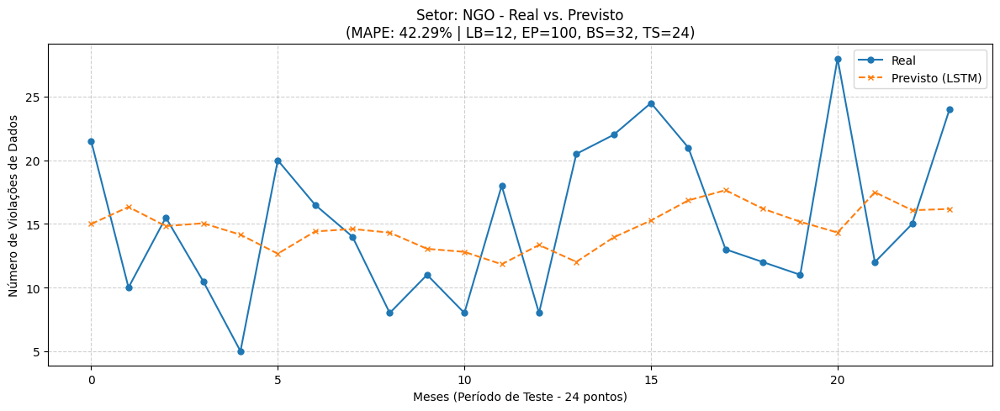

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=100, BS=32, TS=24]:
   MAE : 5.54
   RMSE: 6.31
   MAPE: 42.29%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


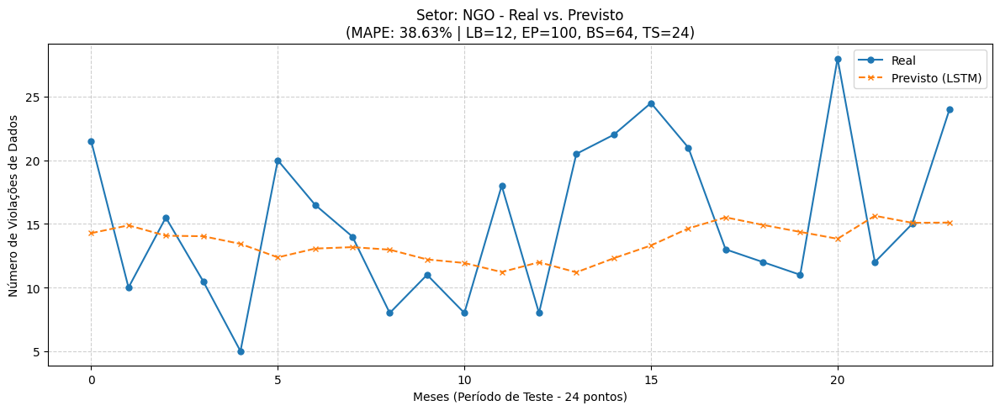

--------------------------------------------------
📊 Resultados para NGO [LB=12, EP=100, BS=64, TS=24]:
   MAE : 5.44
   RMSE: 6.46
   MAPE: 38.63%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


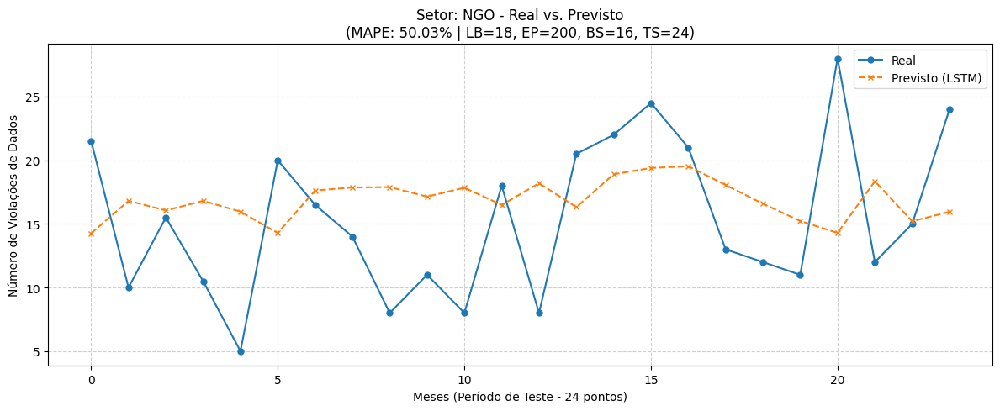

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=200, BS=16, TS=24]:
   MAE : 5.68
   RMSE: 6.64
   MAPE: 50.03%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


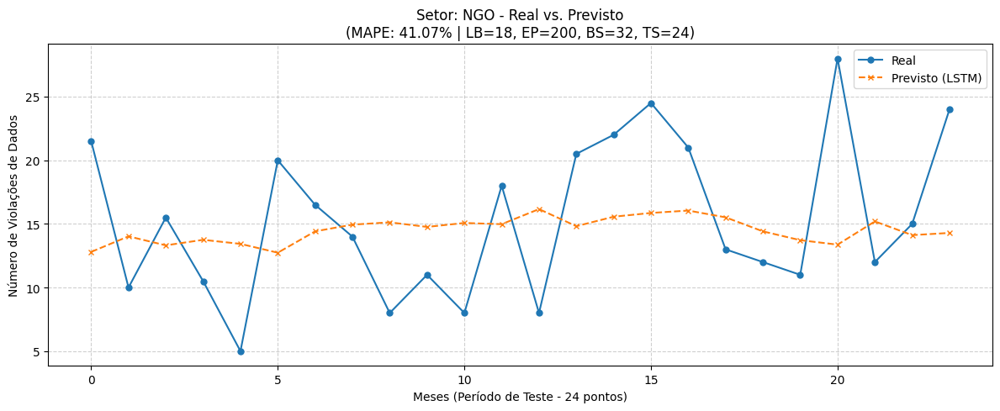

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=200, BS=32, TS=24]:
   MAE : 5.32
   RMSE: 6.25
   MAPE: 41.07%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


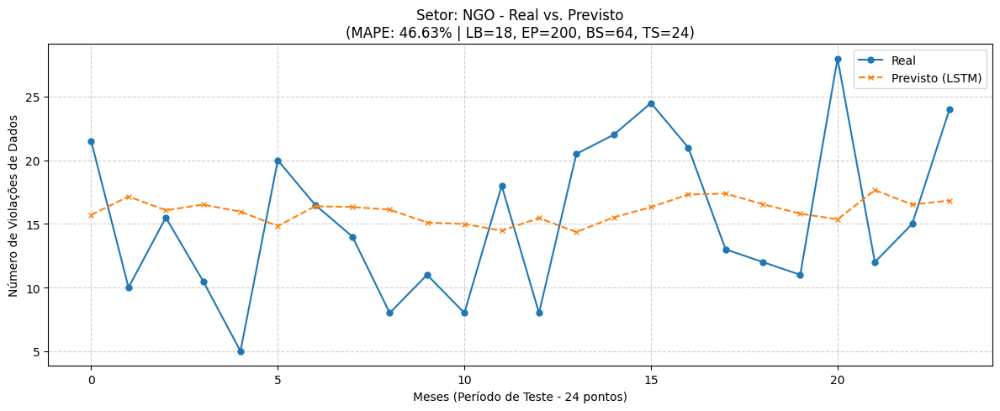

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=200, BS=64, TS=24]:
   MAE : 5.56
   RMSE: 6.27
   MAPE: 46.63%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


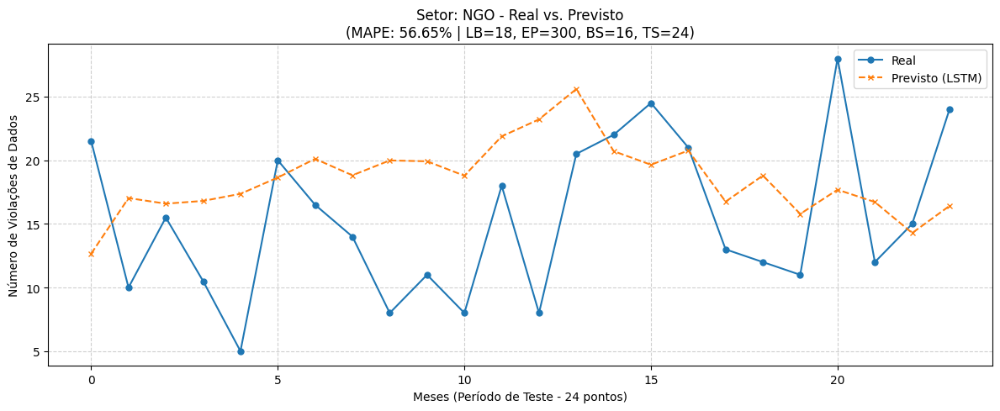

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=300, BS=16, TS=24]:
   MAE : 6.10
   RMSE: 7.26
   MAPE: 56.65%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


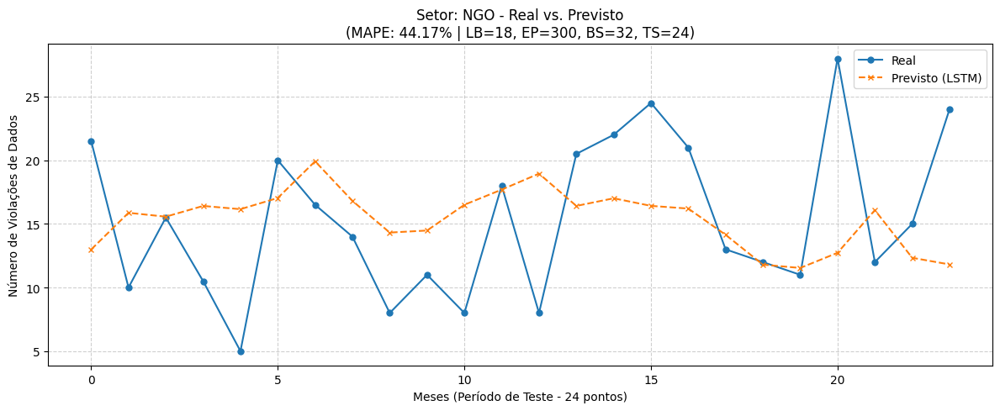

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=300, BS=32, TS=24]:
   MAE : 5.35
   RMSE: 6.70
   MAPE: 44.17%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


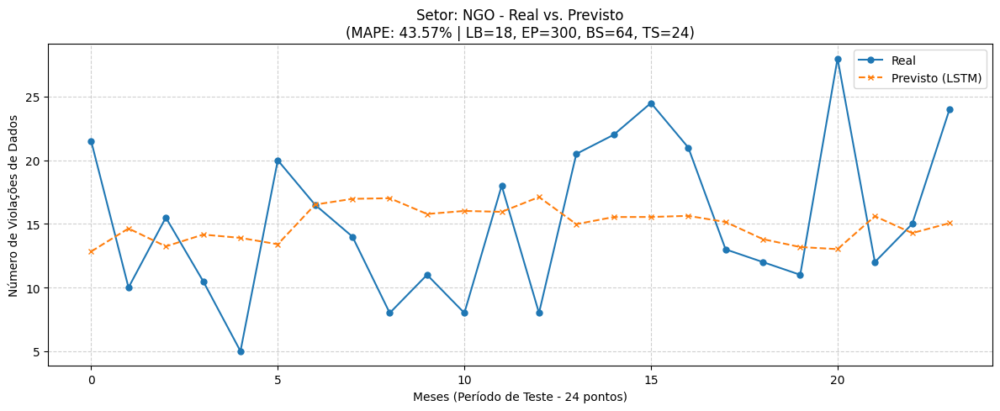

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=300, BS=64, TS=24]:
   MAE : 5.47
   RMSE: 6.50
   MAPE: 43.57%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


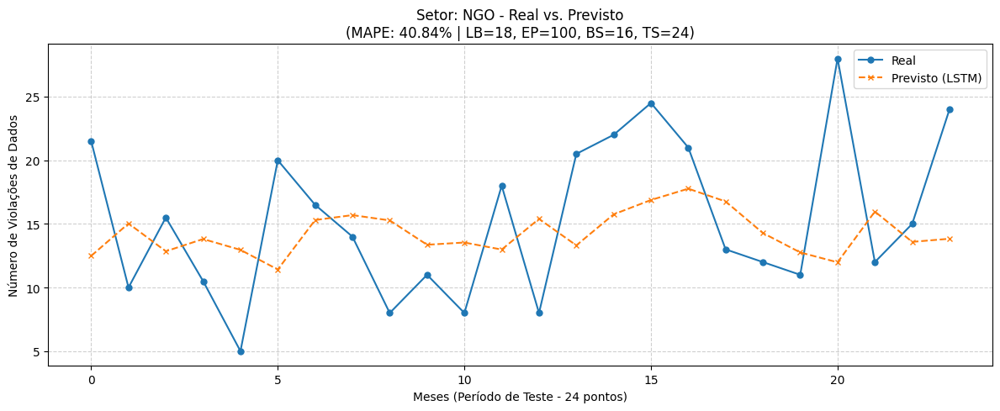

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=100, BS=16, TS=24]:
   MAE : 5.45
   RMSE: 6.44
   MAPE: 40.84%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


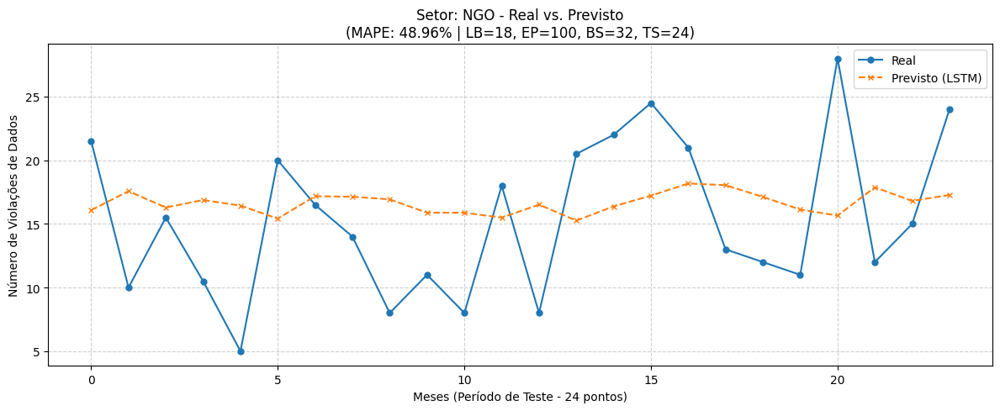

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=100, BS=32, TS=24]:
   MAE : 5.65
   RMSE: 6.35
   MAPE: 48.96%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


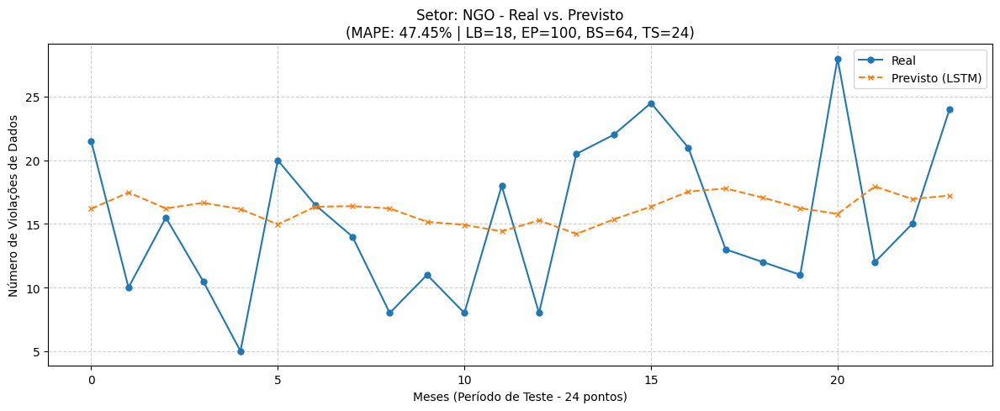

--------------------------------------------------
📊 Resultados para NGO [LB=18, EP=100, BS=64, TS=24]:
   MAE : 5.63
   RMSE: 6.29
   MAPE: 47.45%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: Total Geral ====================
Iniciando Grid Search para o setor: Total Geral (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


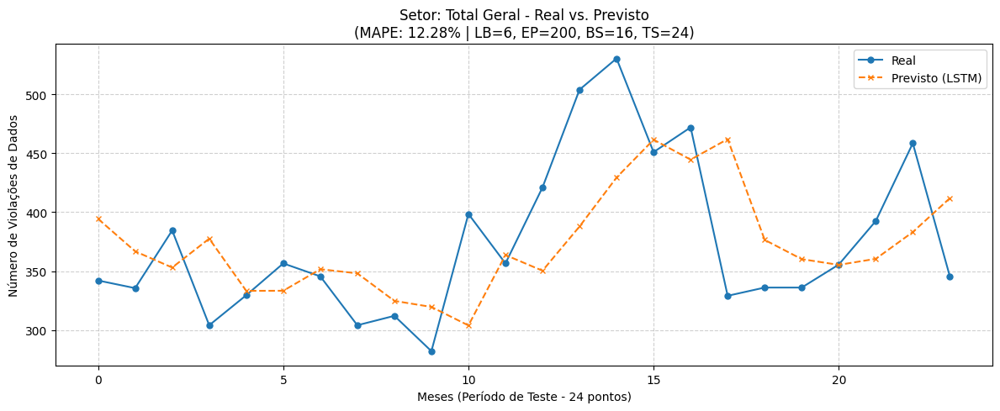

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=200, BS=16, TS=24]:
   MAE : 46.47
   RMSE: 59.10
   MAPE: 12.28%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


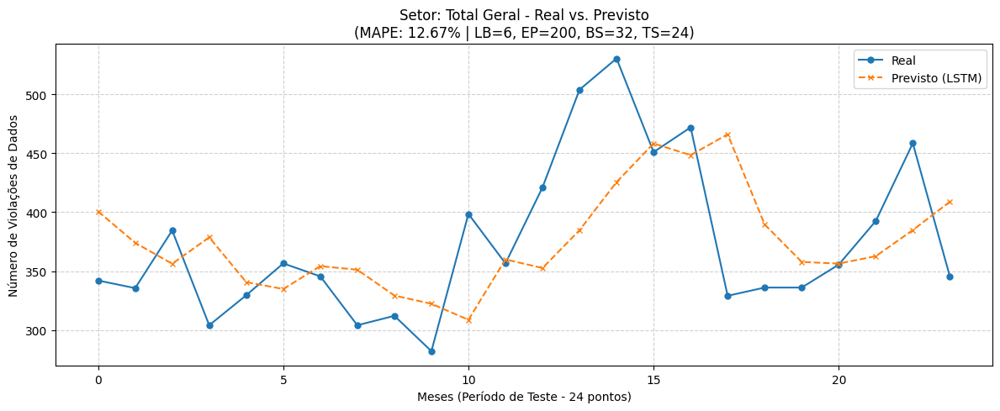

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=200, BS=32, TS=24]:
   MAE : 47.64
   RMSE: 60.28
   MAPE: 12.67%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


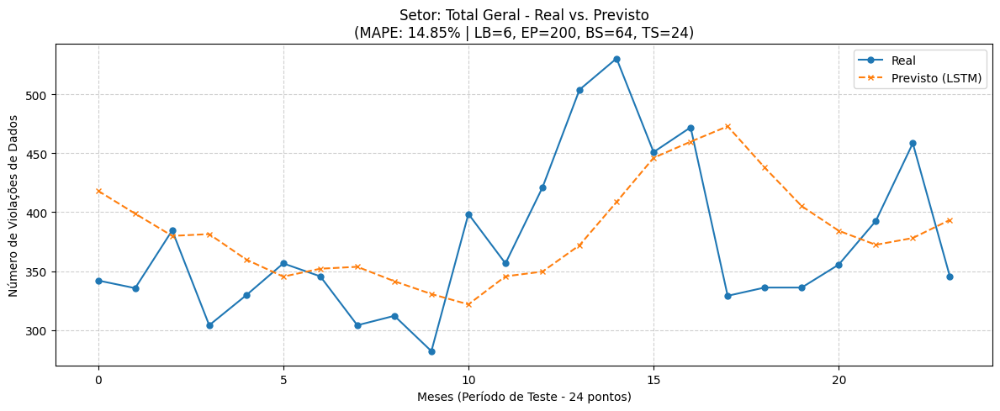

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=200, BS=64, TS=24]:
   MAE : 54.97
   RMSE: 68.32
   MAPE: 14.85%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


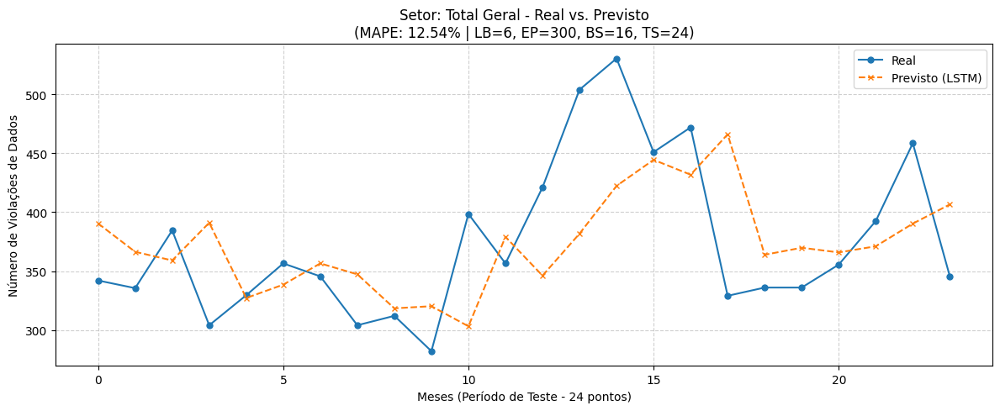

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=300, BS=16, TS=24]:
   MAE : 47.53
   RMSE: 60.73
   MAPE: 12.54%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


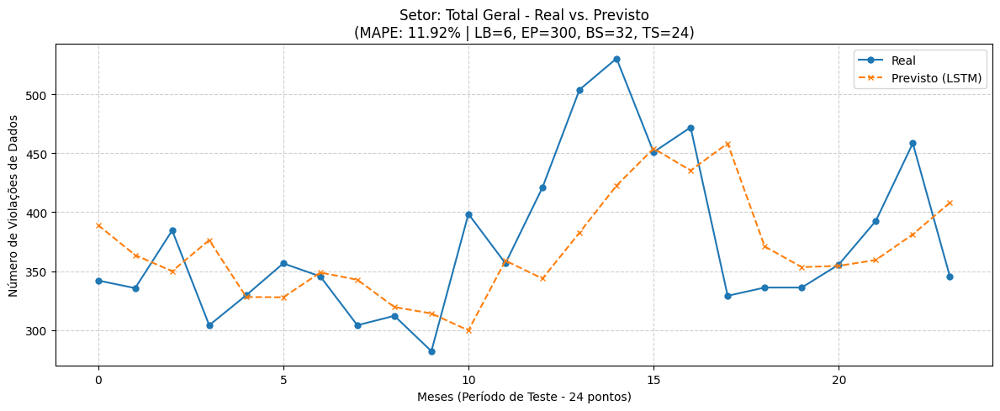

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=300, BS=32, TS=24]:
   MAE : 45.69
   RMSE: 59.71
   MAPE: 11.92%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


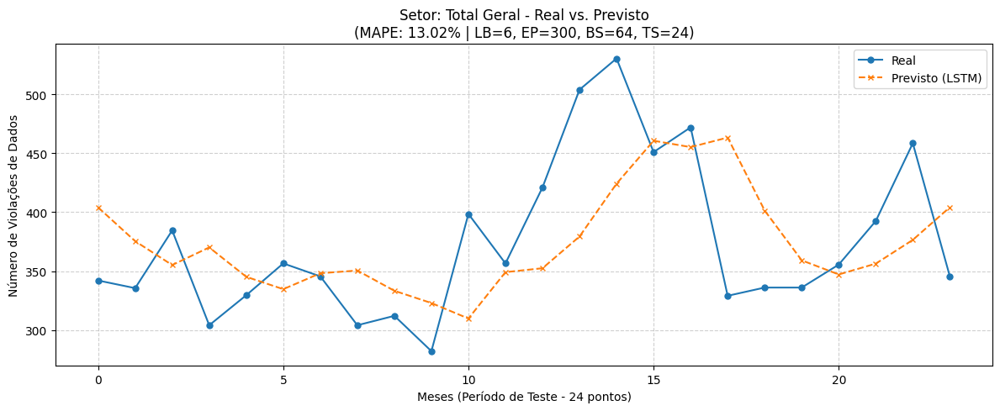

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=300, BS=64, TS=24]:
   MAE : 49.02
   RMSE: 61.22
   MAPE: 13.02%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


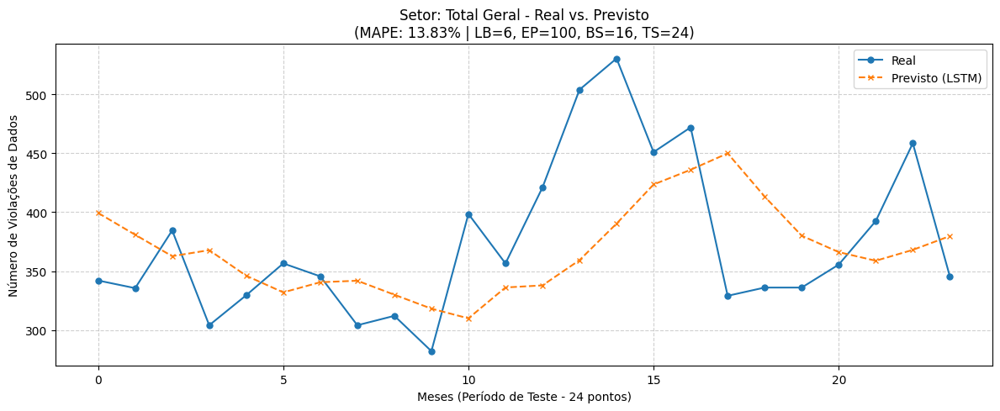

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=100, BS=16, TS=24]:
   MAE : 53.25
   RMSE: 66.09
   MAPE: 13.83%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


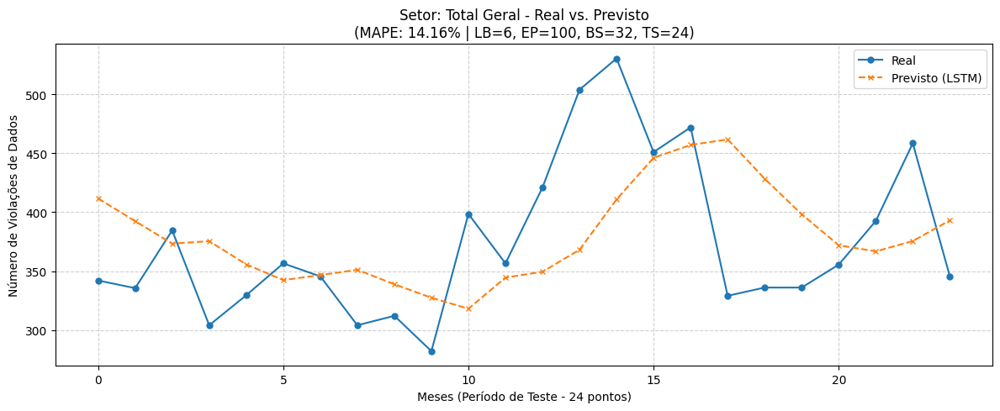

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=100, BS=32, TS=24]:
   MAE : 52.89
   RMSE: 65.86
   MAPE: 14.16%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 93ms/step


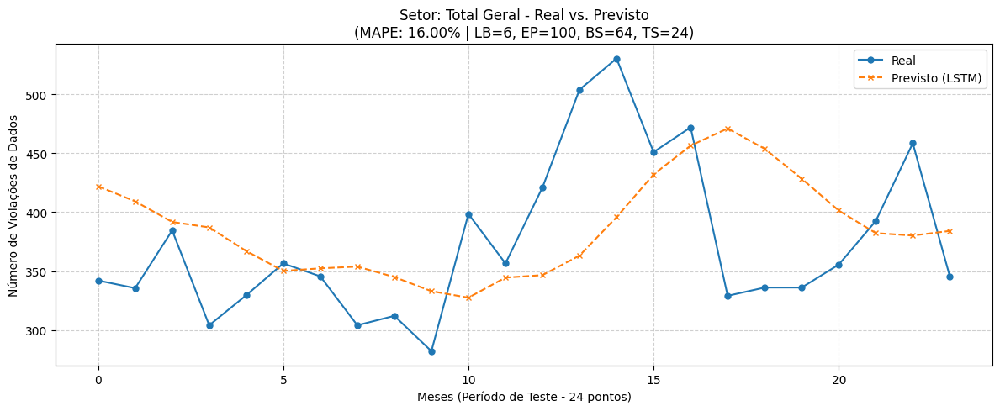

--------------------------------------------------
📊 Resultados para Total Geral [LB=6, EP=100, BS=64, TS=24]:
   MAE : 59.22
   RMSE: 73.09
   MAPE: 16.00%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


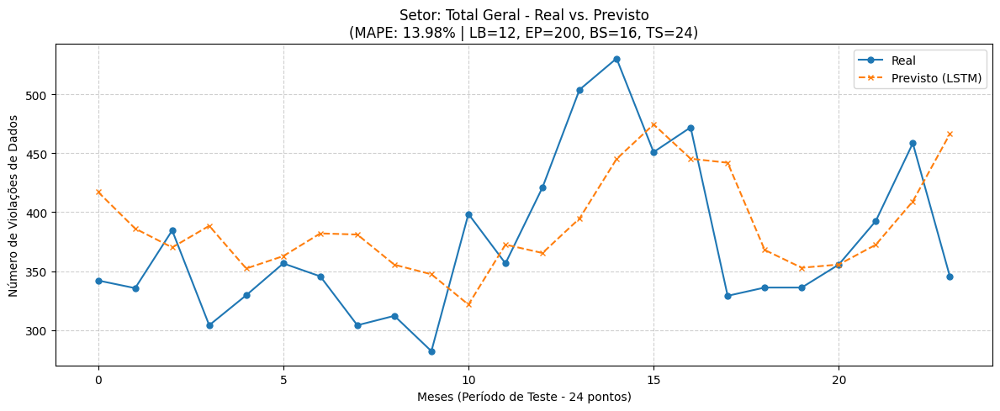

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=200, BS=16, TS=24]:
   MAE : 50.88
   RMSE: 61.51
   MAPE: 13.98%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


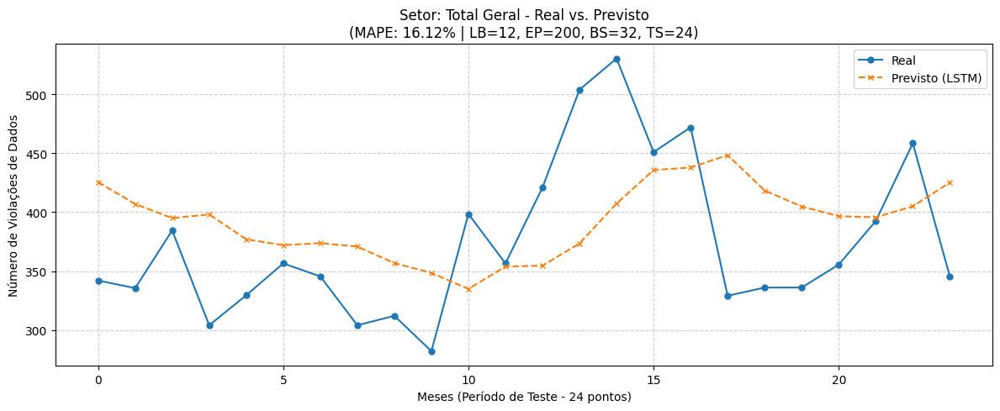

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=200, BS=32, TS=24]:
   MAE : 58.86
   RMSE: 68.91
   MAPE: 16.12%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


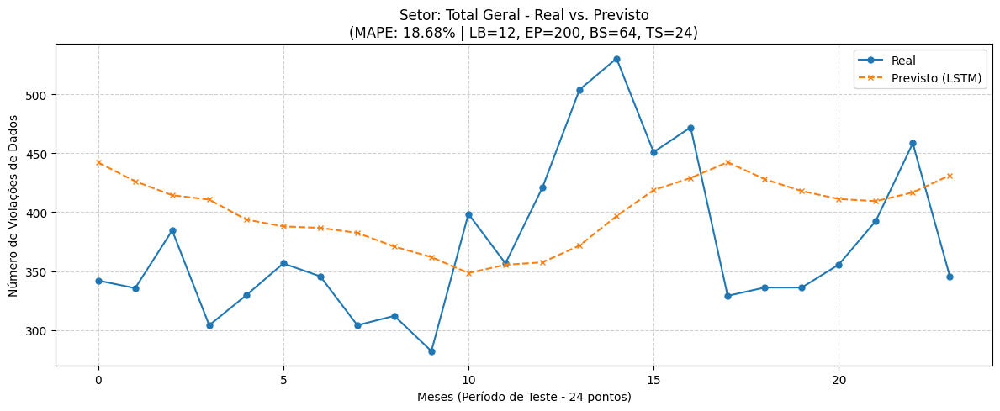

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=200, BS=64, TS=24]:
   MAE : 67.72
   RMSE: 76.04
   MAPE: 18.68%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


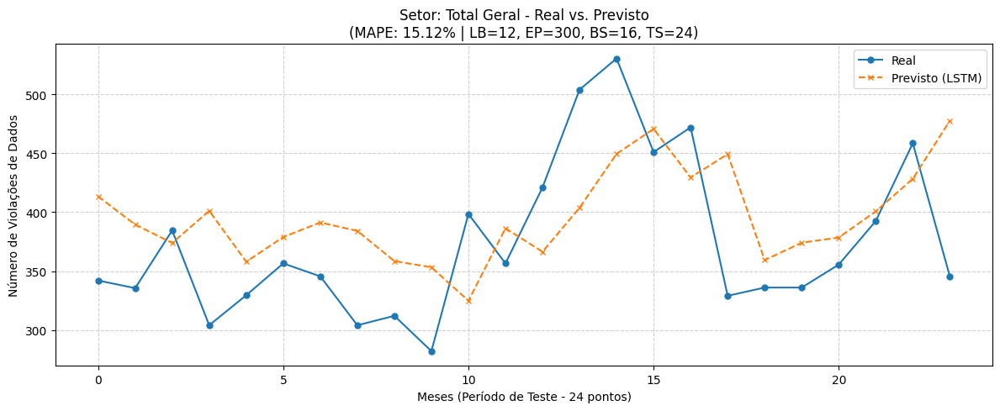

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=300, BS=16, TS=24]:
   MAE : 54.34
   RMSE: 63.95
   MAPE: 15.12%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


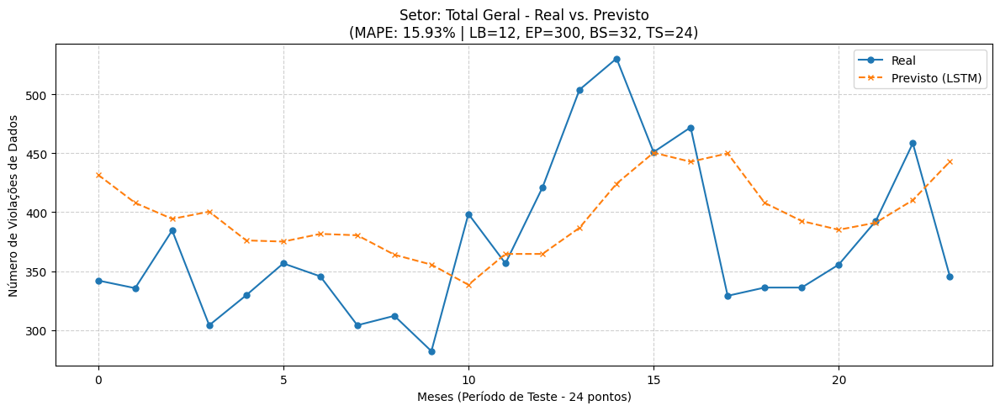

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=300, BS=32, TS=24]:
   MAE : 57.30
   RMSE: 67.35
   MAPE: 15.93%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


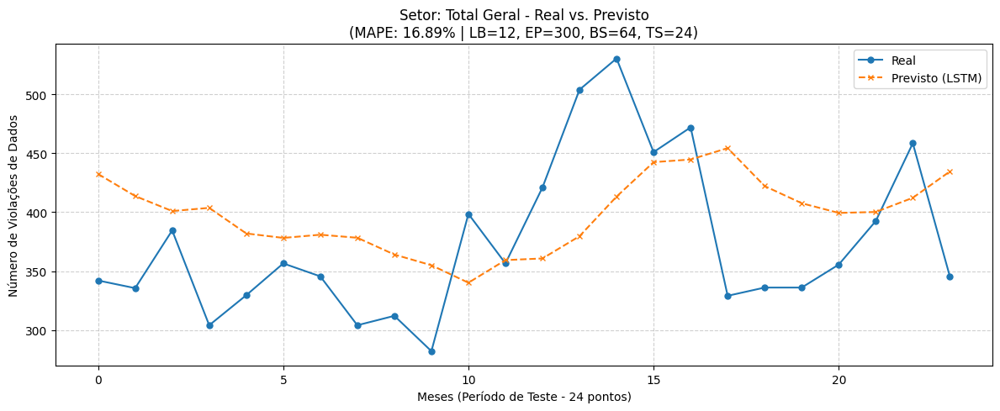

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=300, BS=64, TS=24]:
   MAE : 60.93
   RMSE: 70.69
   MAPE: 16.89%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


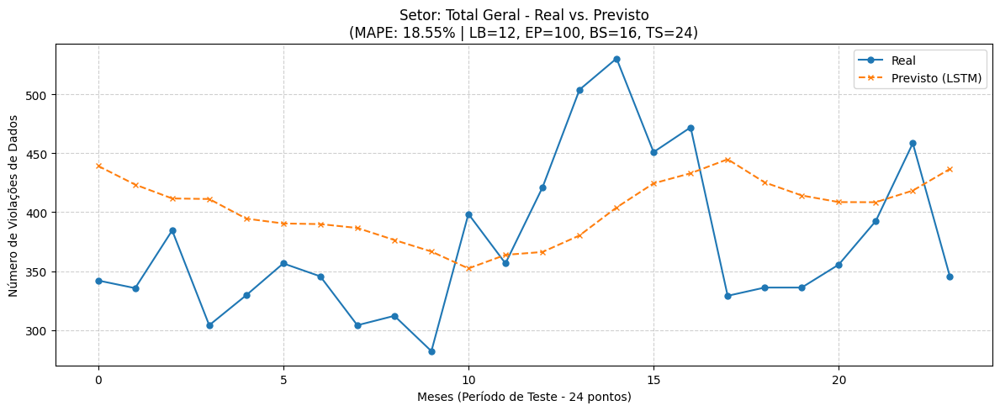

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=100, BS=16, TS=24]:
   MAE : 66.76
   RMSE: 74.76
   MAPE: 18.55%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


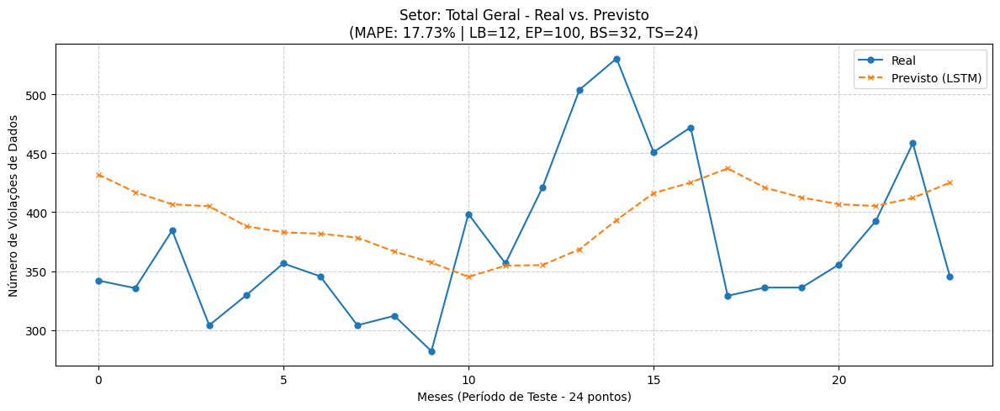

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=100, BS=32, TS=24]:
   MAE : 64.80
   RMSE: 73.28
   MAPE: 17.73%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


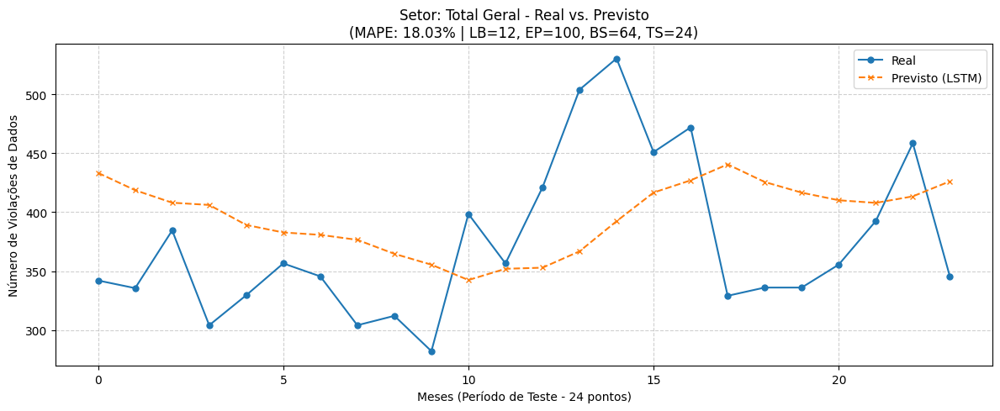

--------------------------------------------------
📊 Resultados para Total Geral [LB=12, EP=100, BS=64, TS=24]:
   MAE : 65.87
   RMSE: 74.39
   MAPE: 18.03%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


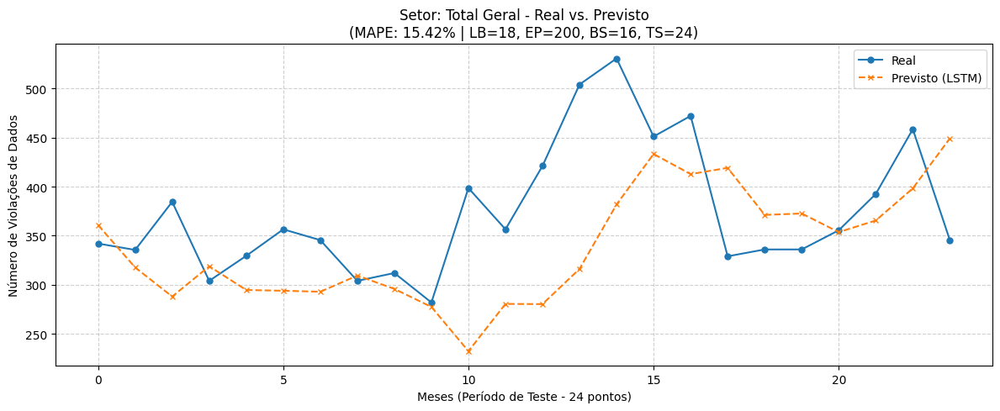

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=200, BS=16, TS=24]:
   MAE : 61.45
   RMSE: 81.28
   MAPE: 15.42%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


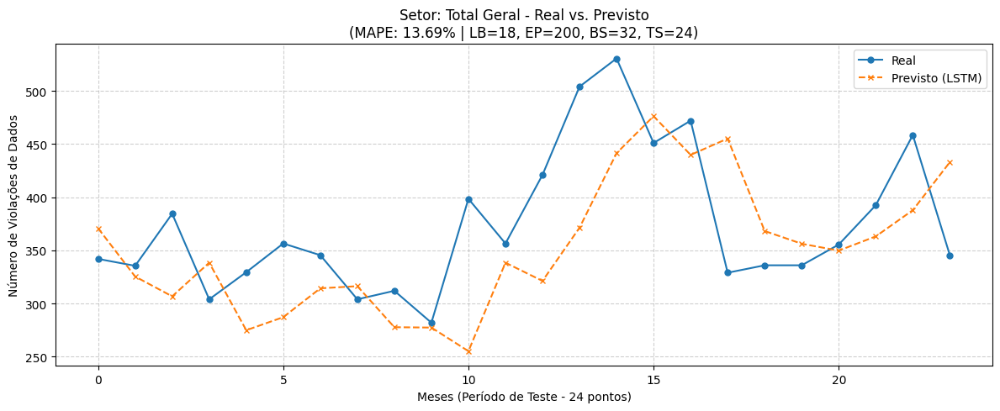

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=200, BS=32, TS=24]:
   MAE : 52.88
   RMSE: 66.82
   MAPE: 13.69%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


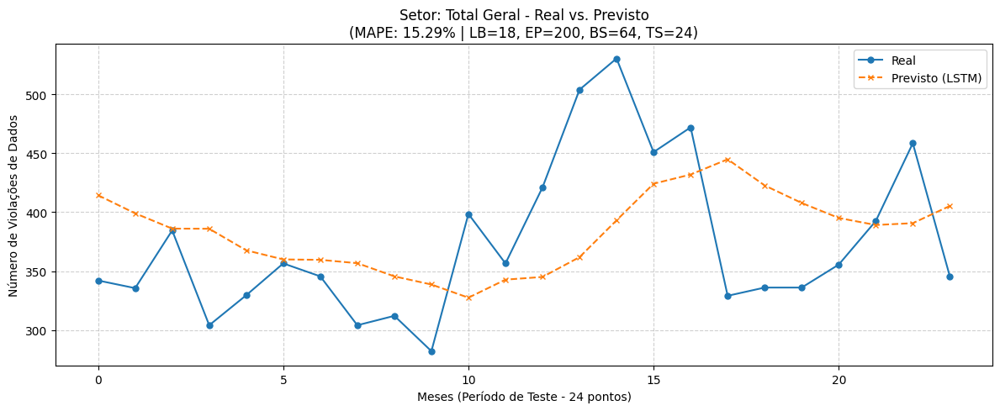

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=200, BS=64, TS=24]:
   MAE : 57.08
   RMSE: 68.63
   MAPE: 15.29%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


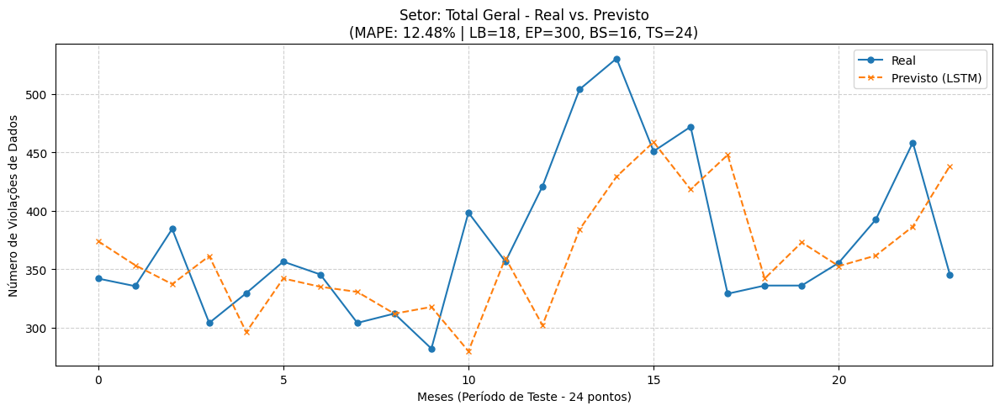

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=300, BS=16, TS=24]:
   MAE : 48.30
   RMSE: 63.38
   MAPE: 12.48%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


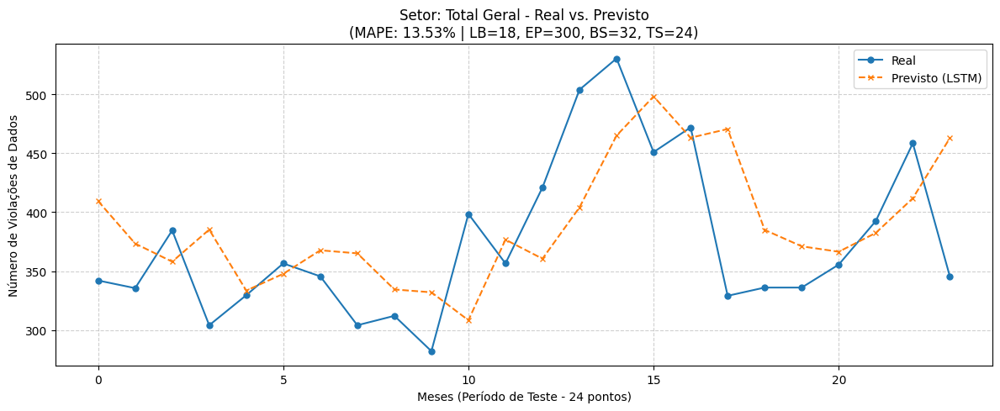

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=300, BS=32, TS=24]:
   MAE : 49.35
   RMSE: 60.97
   MAPE: 13.53%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


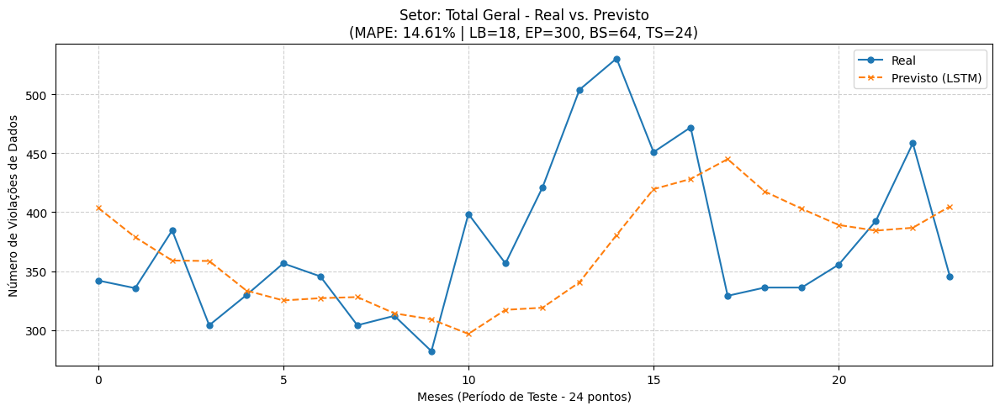

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=300, BS=64, TS=24]:
   MAE : 56.73
   RMSE: 70.96
   MAPE: 14.61%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


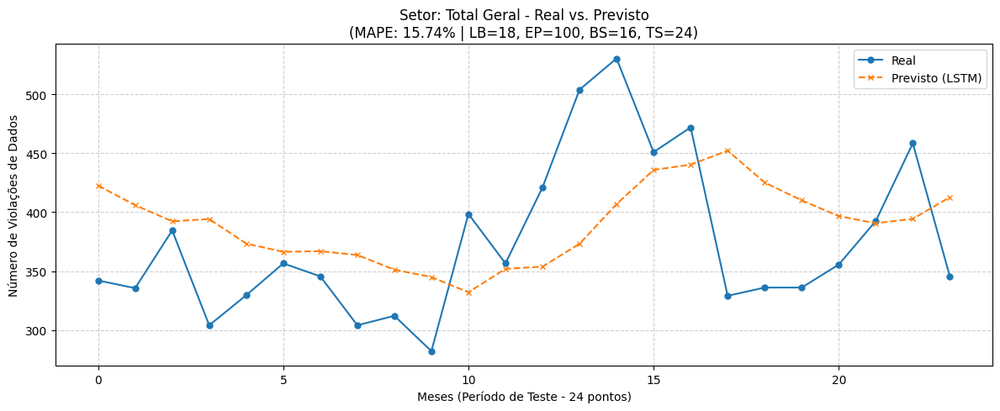

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=100, BS=16, TS=24]:
   MAE : 57.76
   RMSE: 68.53
   MAPE: 15.74%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


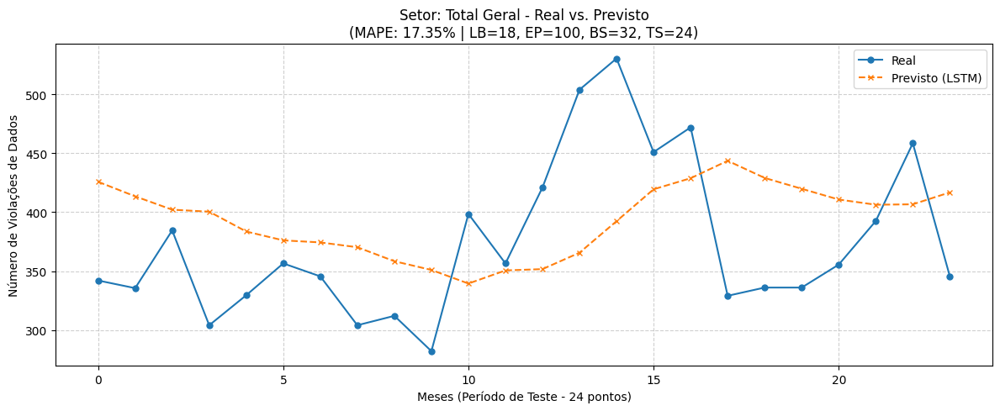

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=100, BS=32, TS=24]:
   MAE : 63.72
   RMSE: 72.86
   MAPE: 17.35%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


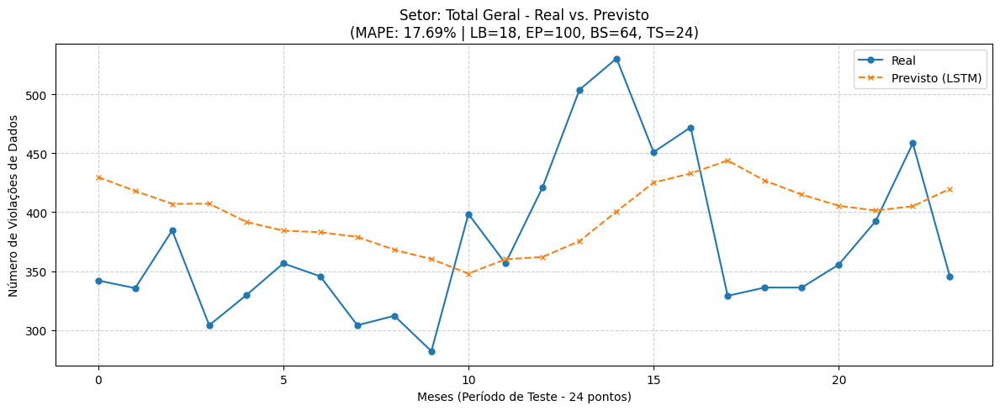

--------------------------------------------------
📊 Resultados para Total Geral [LB=18, EP=100, BS=64, TS=24]:
   MAE : 64.20
   RMSE: 72.71
   MAPE: 17.69%
--------------------------------------------------

==================== INICIANDO TREINAMENTO PARA SETOR: UNKN ====================
Iniciando Grid Search para o setor: UNKN (Total de combinações: 27)

---> Treinando com: LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


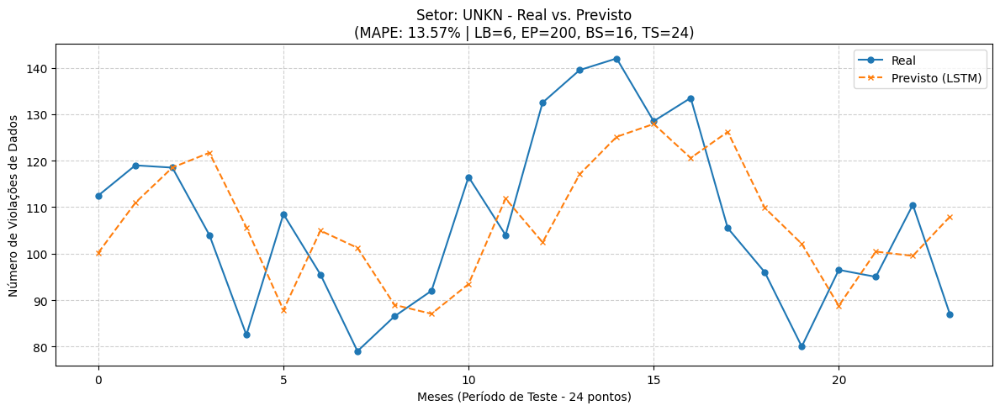

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=200, BS=16, TS=24]:
   MAE : 14.02
   RMSE: 16.22
   MAPE: 13.57%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


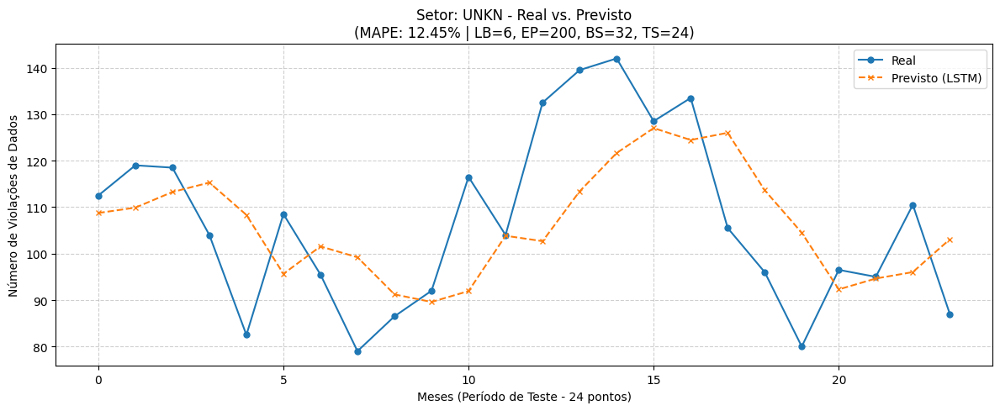

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=200, BS=32, TS=24]:
   MAE : 12.95
   RMSE: 15.87
   MAPE: 12.45%
--------------------------------------------------

---> Treinando com: LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 87ms/step


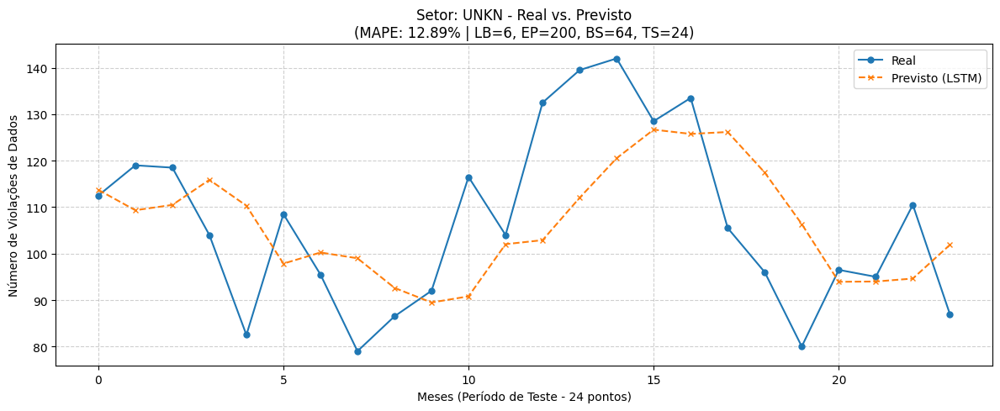

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=200, BS=64, TS=24]:
   MAE : 13.38
   RMSE: 16.50
   MAPE: 12.89%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


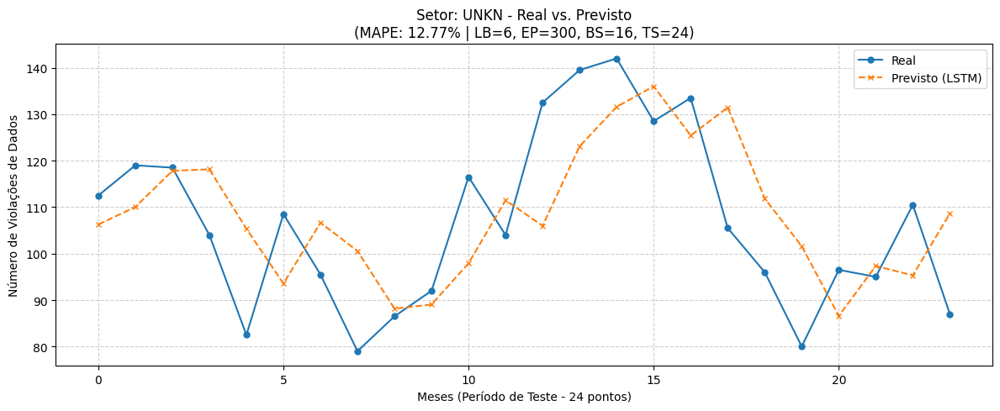

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=300, BS=16, TS=24]:
   MAE : 13.02
   RMSE: 15.08
   MAPE: 12.77%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


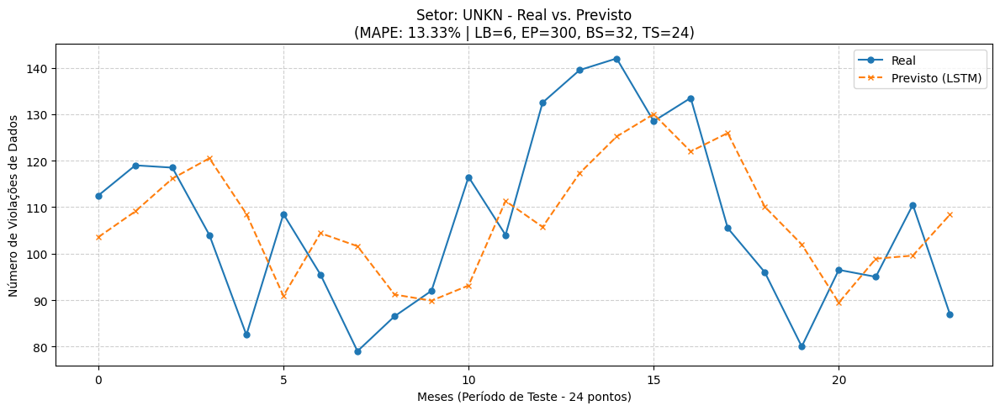

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=300, BS=32, TS=24]:
   MAE : 13.71
   RMSE: 15.85
   MAPE: 13.33%
--------------------------------------------------

---> Treinando com: LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


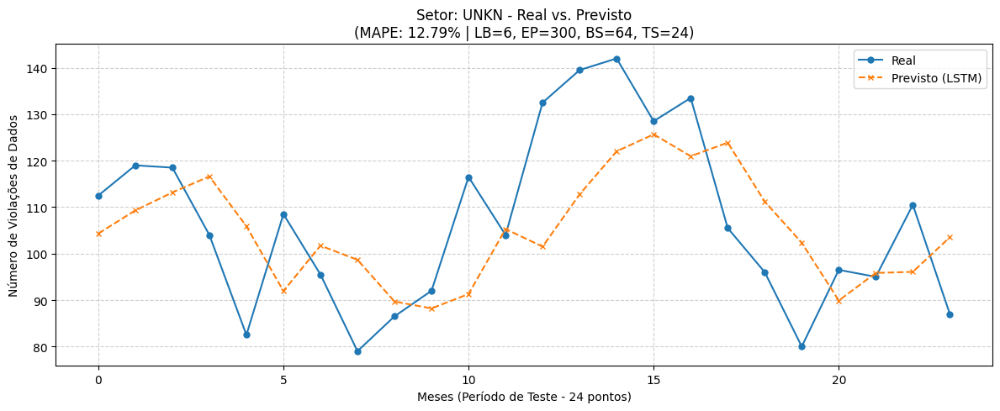

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=300, BS=64, TS=24]:
   MAE : 13.44
   RMSE: 15.93
   MAPE: 12.79%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


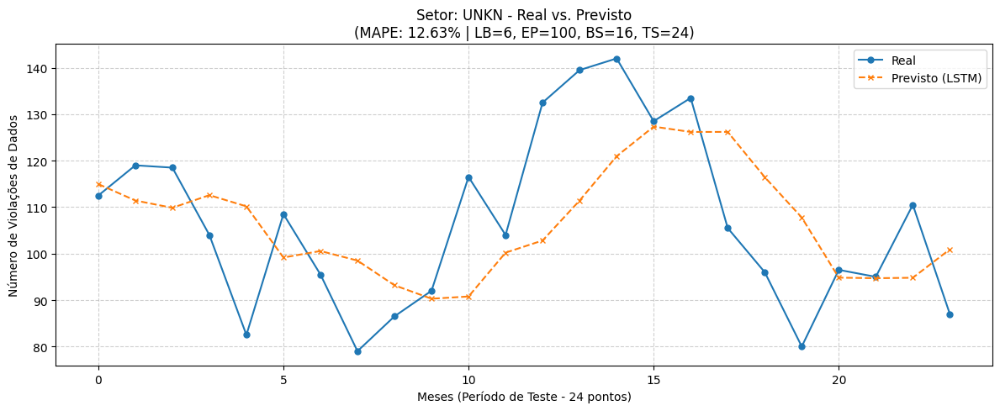

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=100, BS=16, TS=24]:
   MAE : 13.11
   RMSE: 16.36
   MAPE: 12.63%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


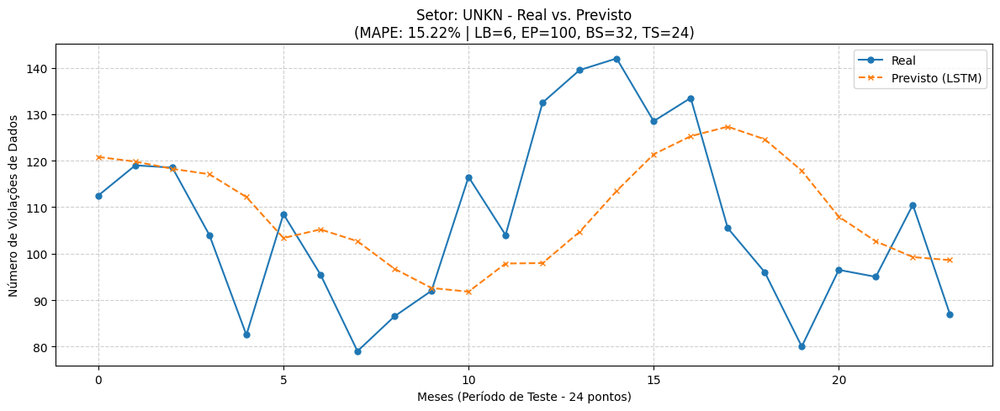

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=100, BS=32, TS=24]:
   MAE : 15.65
   RMSE: 19.44
   MAPE: 15.22%
--------------------------------------------------

---> Treinando com: LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


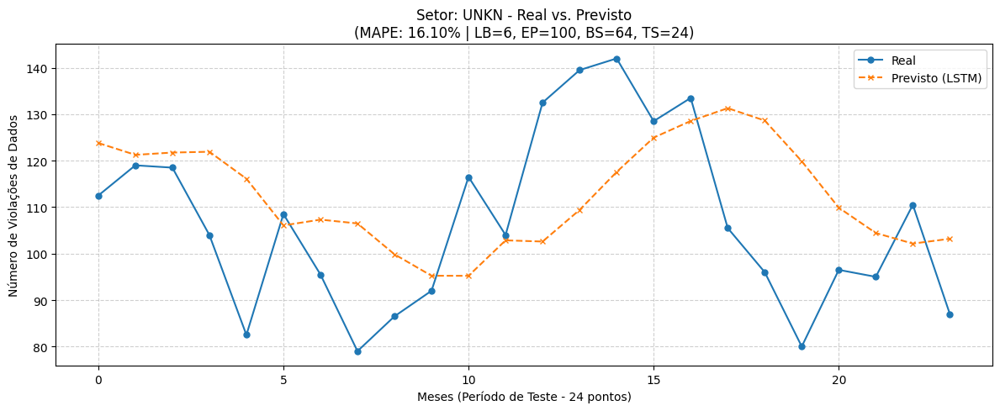

--------------------------------------------------
📊 Resultados para UNKN [LB=6, EP=100, BS=64, TS=24]:
   MAE : 16.15
   RMSE: 19.89
   MAPE: 16.10%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step


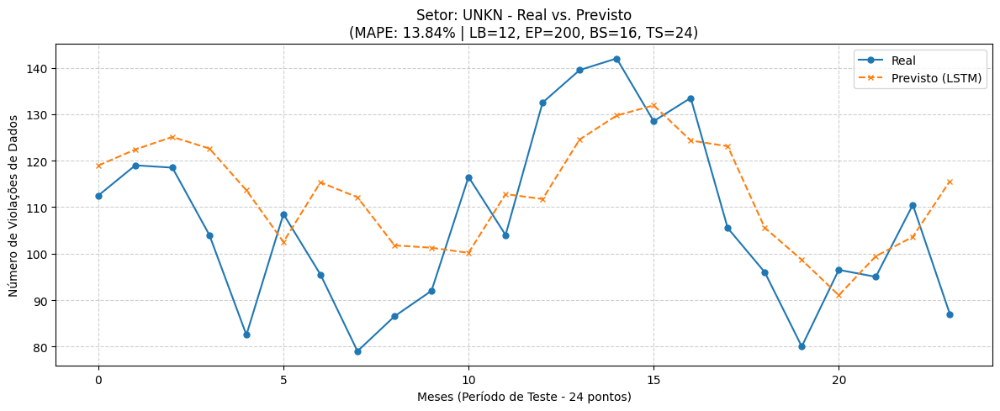

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=200, BS=16, TS=24]:
   MAE : 13.61
   RMSE: 16.03
   MAPE: 13.84%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


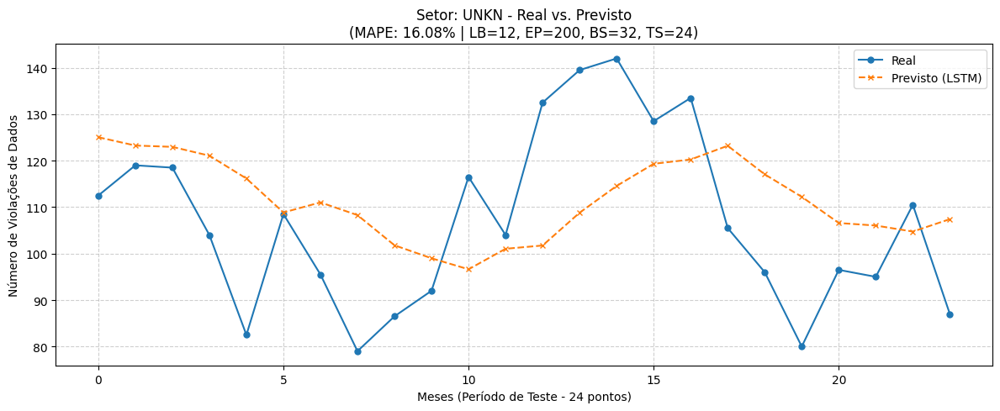

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=200, BS=32, TS=24]:
   MAE : 16.33
   RMSE: 19.12
   MAPE: 16.08%
--------------------------------------------------

---> Treinando com: LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


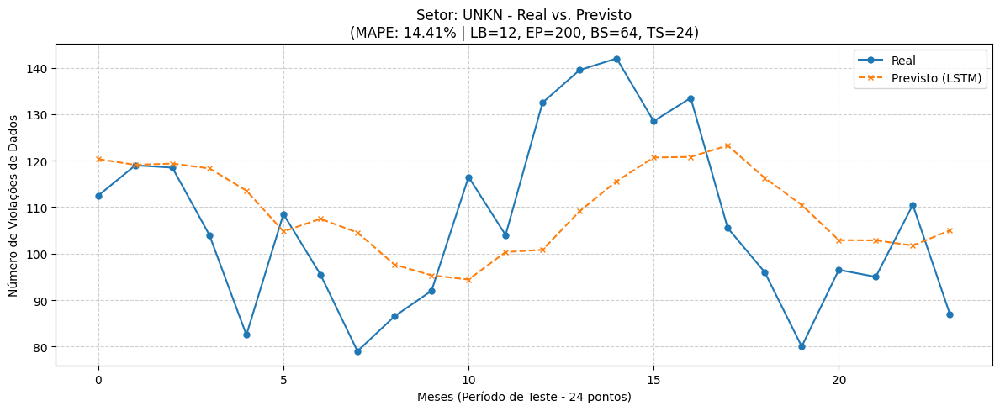

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=200, BS=64, TS=24]:
   MAE : 14.76
   RMSE: 17.89
   MAPE: 14.41%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 101ms/step


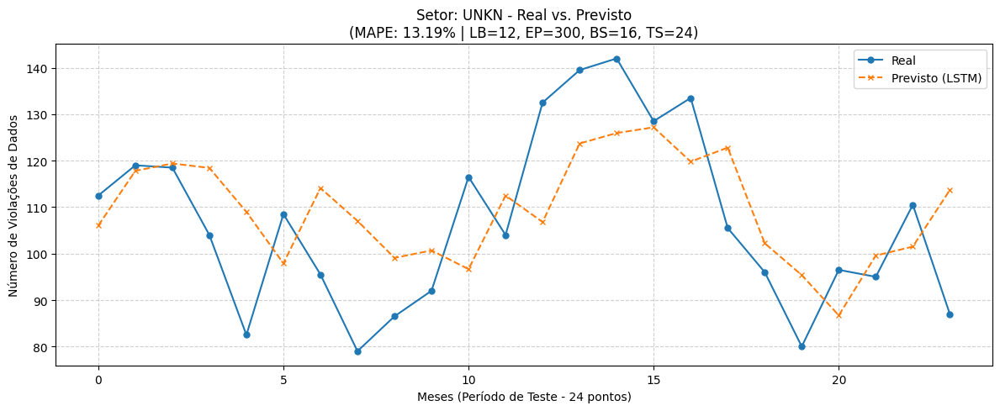

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=300, BS=16, TS=24]:
   MAE : 13.24
   RMSE: 15.46
   MAPE: 13.19%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 92ms/step


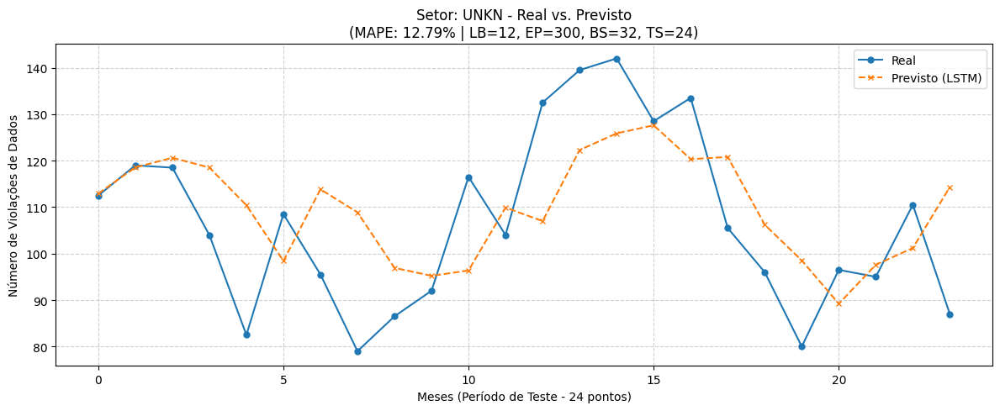

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=300, BS=32, TS=24]:
   MAE : 12.79
   RMSE: 15.60
   MAPE: 12.79%
--------------------------------------------------

---> Treinando com: LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 91ms/step


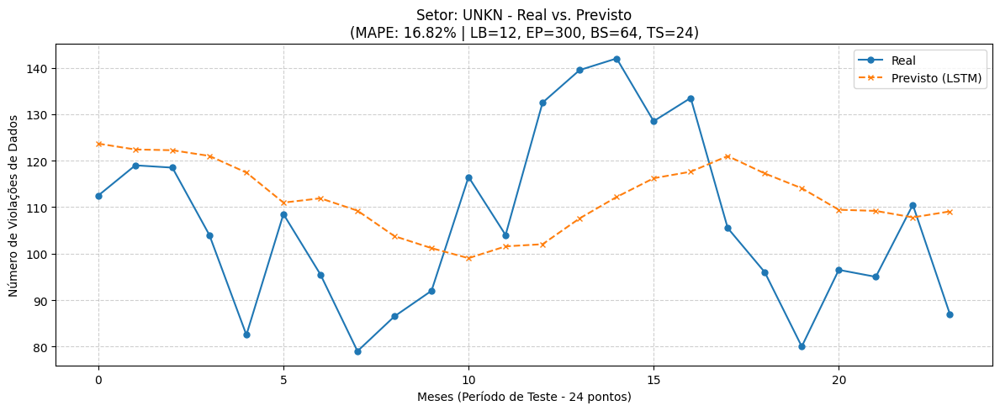

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=300, BS=64, TS=24]:
   MAE : 17.03
   RMSE: 19.89
   MAPE: 16.82%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 99ms/step


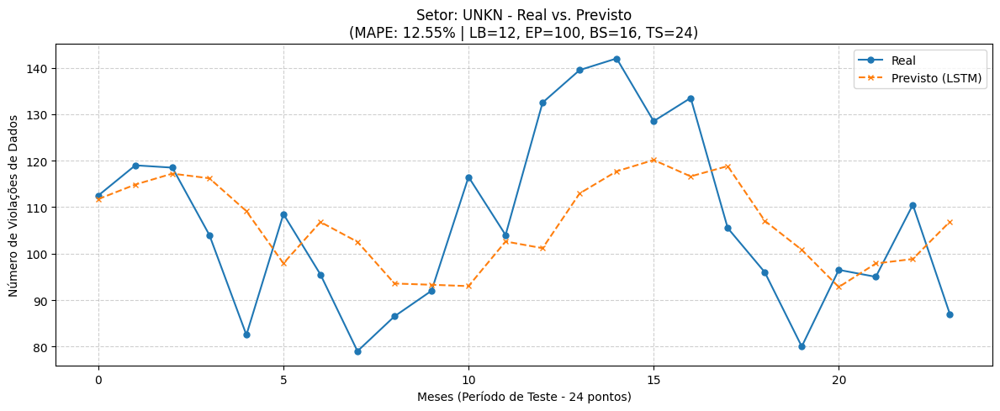

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=100, BS=16, TS=24]:
   MAE : 13.10
   RMSE: 16.07
   MAPE: 12.55%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


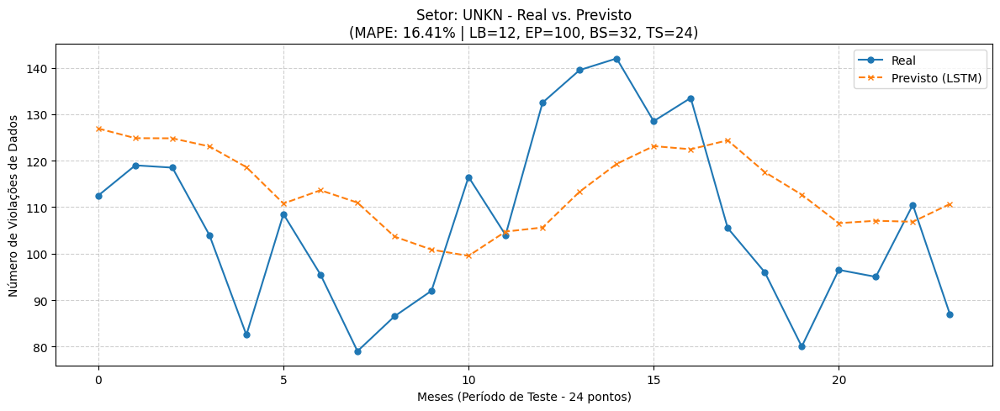

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=100, BS=32, TS=24]:
   MAE : 16.36
   RMSE: 19.09
   MAPE: 16.41%
--------------------------------------------------

---> Treinando com: LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


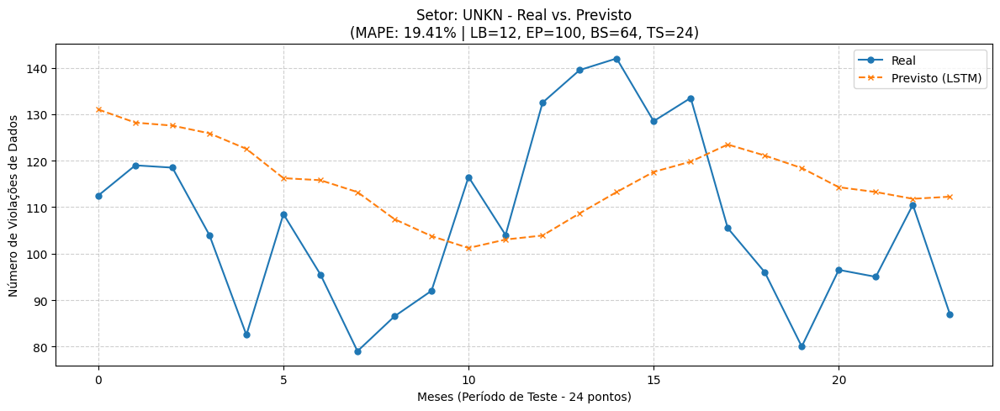

--------------------------------------------------
📊 Resultados para UNKN [LB=12, EP=100, BS=64, TS=24]:
   MAE : 19.45
   RMSE: 22.05
   MAPE: 19.41%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


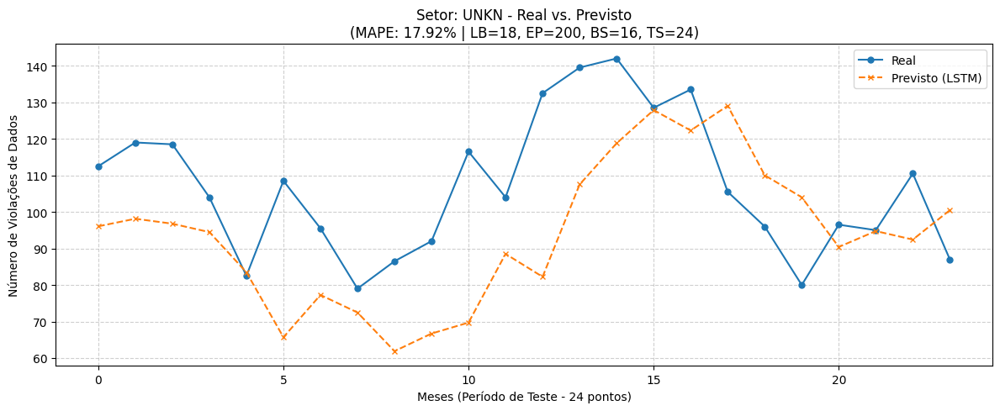

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=200, BS=16, TS=24]:
   MAE : 19.42
   RMSE: 23.49
   MAPE: 17.92%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


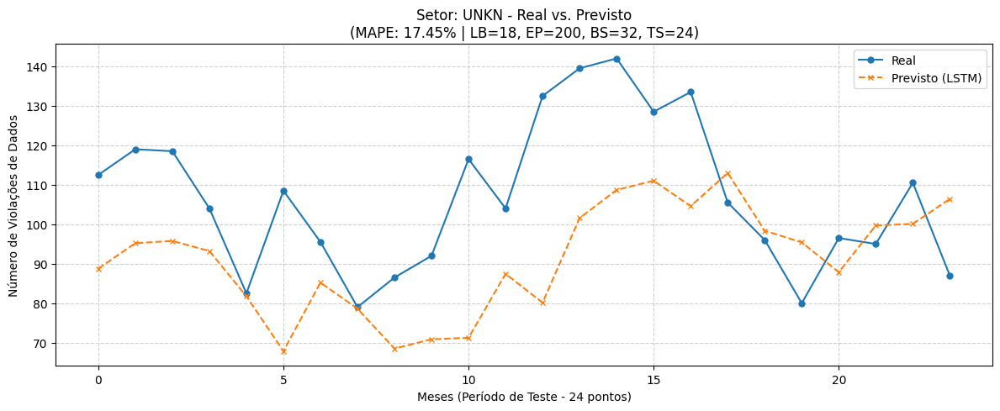

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=200, BS=32, TS=24]:
   MAE : 19.69
   RMSE: 24.09
   MAPE: 17.45%
--------------------------------------------------

---> Treinando com: LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


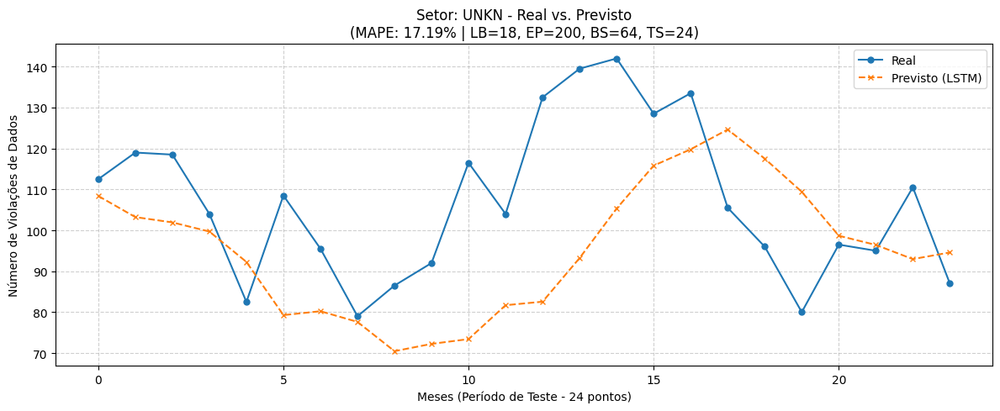

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=200, BS=64, TS=24]:
   MAE : 18.99
   RMSE: 23.40
   MAPE: 17.19%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


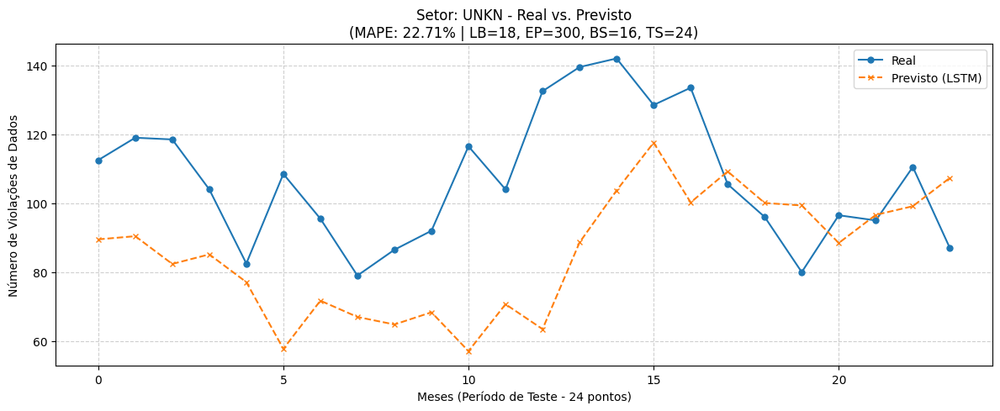

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=300, BS=16, TS=24]:
   MAE : 25.31
   RMSE: 31.00
   MAPE: 22.71%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step


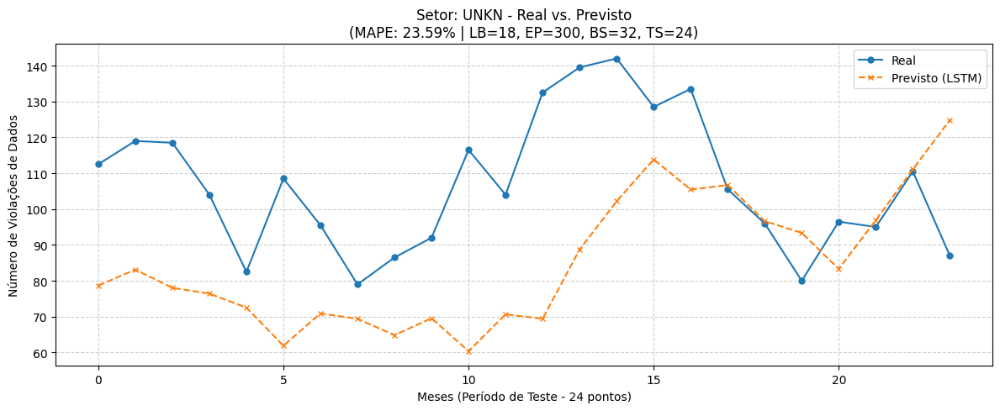

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=300, BS=32, TS=24]:
   MAE : 26.13
   RMSE: 31.60
   MAPE: 23.59%
--------------------------------------------------

---> Treinando com: LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


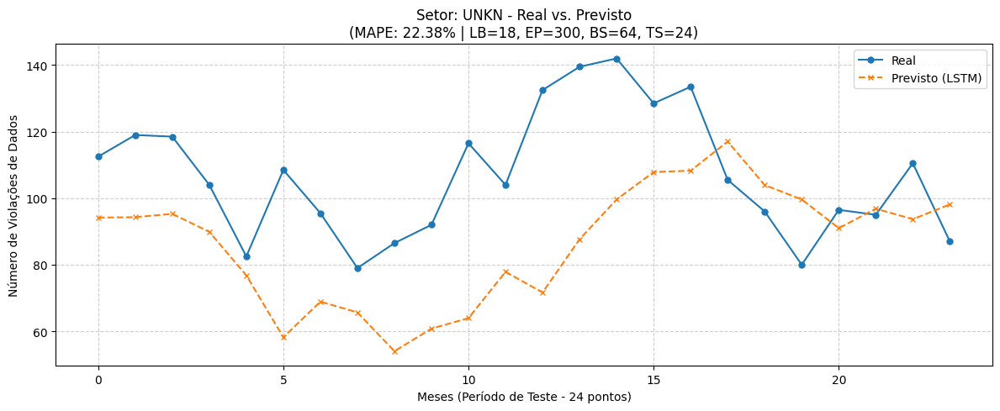

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=300, BS=64, TS=24]:
   MAE : 24.75
   RMSE: 29.49
   MAPE: 22.38%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step


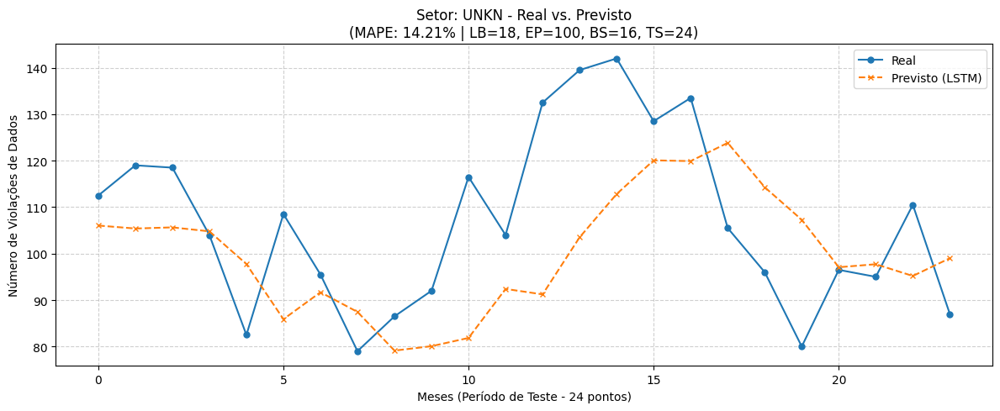

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=100, BS=16, TS=24]:
   MAE : 15.52
   RMSE: 19.00
   MAPE: 14.21%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 88ms/step


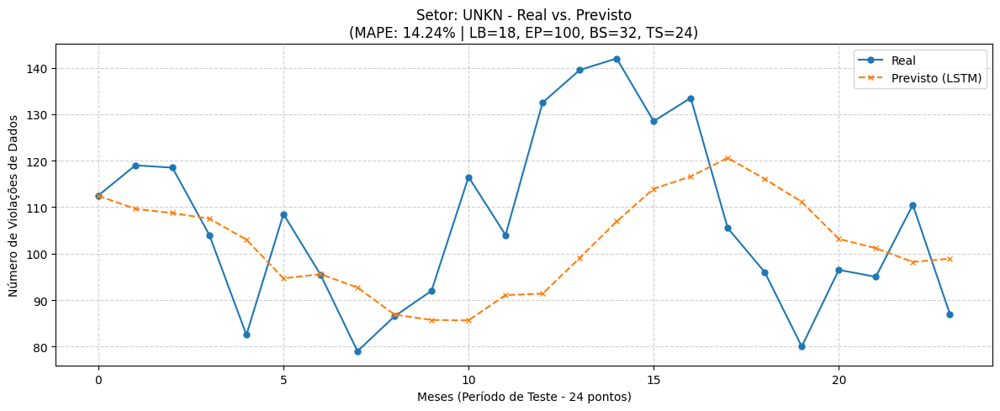

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=100, BS=32, TS=24]:
   MAE : 15.53
   RMSE: 19.56
   MAPE: 14.24%
--------------------------------------------------

---> Treinando com: LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/keras/src/layers/rnn/rnn.py:199: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step


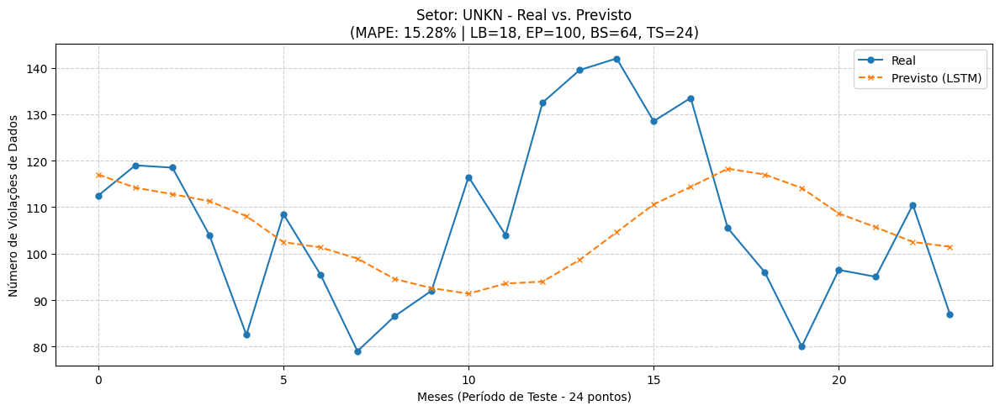

--------------------------------------------------
📊 Resultados para UNKN [LB=18, EP=100, BS=64, TS=24]:
   MAE : 16.29
   RMSE: 20.00
   MAPE: 15.28%
--------------------------------------------------

✅ Loop de treinamento concluído para o setor UNKN.

Criando DataFrame final de resultados...
Exibindo todos os resultados pelo menor MAPE:


,Modelo,Setor,Look_back,Epochs,Batch_size,Test_Size,MAE,RMSE,MAPE (%)
193,LSTM,Total Geral,6,300,32,24,45.69,59.71,11.92
189,LSTM,Total Geral,6,200,16,24,46.47,59.10,12.28
217,LSTM,UNKN,6,200,32,24,12.95,15.87,12.45
210,LSTM,Total Geral,18,300,16,24,48.30,63.38,12.48
192,LSTM,Total Geral,6,300,16,24,47.53,60.73,12.54
...,...,...,...,...,...,...,...,...,...
64,LSTM,BSR,12,200,32,24,7.56,8.93,79.79
72,LSTM,BSR,18,200,16,24,7.87,9.40,82.78
66,LSTM,BSR,12,300,16,24,8.22,9.74,85.54
76,LSTM,BSR,18,300,32,24,7.94,9.58,86.94



Resultados completos salvos em: /content/resultados_lstm.csv


In [ ]:
# ==============================================================================
# LOOP PRINCIPAL E TREINAMENTO (UTILIZANDO DADOS PRÉ-PROCESSADOS) LSTM
# ==============================================================================

# Lista para armazenar os resultados de todas as combinações
resultados = []

# Define o TAMANHO MÁXIMO do conjunto de teste para a verificação inicial de dados
# Isso garante que o setor tenha dados suficientes para o MAIOR teste que faremos
MAX_TEST_SET_SIZE = max(test_size_values) if test_size_values else 24 # Pega o maior da lista, ou 24 como padrão
print(f"Verificação inicial usará MAX_TEST_SET_SIZE = {MAX_TEST_SET_SIZE}")

# --- Certifique-se que df_monthly existe (deve ter sido criado na Célula 3.5) ---
if 'df_monthly' not in locals():
     raise NameError("O DataFrame 'df_monthly' não foi definido. Execute a célula de pré-processamento (Célula 3.5) primeiro.")

# Itera sobre cada setor definido (e possivelmente ajustado)
for setor in setores:
    print(f"\n{'='*20} INICIANDO TREINAMENTO PARA SETOR: {setor} {'='*20}")

    # --- Seleção dos Dados do Setor (Já pré-processados) ---
    # 1. Seleciona a série temporal do setor a partir do DataFrame mensal
    #    Garante que é um DataFrame com uma coluna para compatibilidade com scaler
    serie_df = df_monthly[[setor]]

    # --- Verificação de Dados Mínimos GERAL para o Setor ---
    # Usa o MAIOR look_back e o MAIOR test_size para garantir que o setor é viável
    min_data_needed = max(look_back_values) + MAX_TEST_SET_SIZE + 1
    if len(serie_df) < min_data_needed:
        print(f"⚠️ Aviso GERAL: Dados insuficientes para o setor '{setor}' ({len(serie_df)} meses disponíveis). Mínimo necessário para a maior combinação: {min_data_needed}. Pulando setor.")
        continue # Pula para o próximo setor
    # --- Fim da Verificação ---

       # Normaliza a série temporal do setor (faz isso uma vez por setor)
    scaler = MinMaxScaler(feature_range=(0, 1))
    serie_scaled = scaler.fit_transform(serie_df)

    # Itera sobre todas as combinações de hiperparâmetros (AGORA INCLUI test_size)
    print(f"Iniciando Grid Search para o setor: {setor} (Total de combinações: {len(param_grid)})")
    for look_back, epochs, batch_size, test_size in param_grid: # <<< DESEMPACOTA test_size

        # --- Verificação de Dados Mínimos para ESTA COMBINAÇÃO ---
        # Usa o look_back e test_size específicos desta iteração
        if len(serie_scaled) <= look_back + test_size:
            print(f"⏭️ Pulando combinação (lb={look_back}, ep={epochs}, bs={batch_size}, ts={test_size}): Dados insuficientes ({len(serie_scaled)} <= {look_back + test_size}).")
            continue
        # --- Fim da Verificação Específica ---

        print(f"\n---> Treinando com: LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size}") # <<< Inclui TS

        # Chama a função para treinar, avaliar e obter métricas, passando o test_size atual
        metricas = treinar_e_avaliar_lstm(
            serie_scaled,
            look_back,
            epochs,
            batch_size,
            test_size, # <<< PASSA O test_size
            setor,
            scaler,
            output_dir=OUTPUT_DIR
        )

        # Se a função retornou None, pula para a próxima combinação
        if metricas is None:
            print(f" (!) Treinamento falhou ou foi pulado para a combinação acima.")
            continue

        # --- Exibição dos Resultados em Tempo Real ---
        print("-" * 50) # Linha maior para destacar
        # <<< Inclui TS na impressão
        print(f"📊 Resultados para {setor} [LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size}]:")
        print(f"   MAE : {metricas['MAE']:.2f}")
        print(f"   RMSE: {metricas['RMSE']:.2f}")
        mape_str = f"{metricas['MAPE (%)']:.2f}%" if not np.isnan(metricas['MAPE (%)']) else "N/A"
        print(f"   MAPE: {mape_str}")
        print("-" * 50)
        # --- Fim da Exibição ---

        # Armazena os resultados desta combinação na lista
        resultados.append({
            'Modelo': 'LSTM',
            'Setor': setor,
            'Look_back': look_back,
            'Epochs': epochs,
            'Batch_size': batch_size,
            'Test_Size': test_size, # <<< ADICIONADO: Armazena o test_size usado
            'MAE': metricas['MAE'],
            'RMSE': metricas['RMSE'],
            'MAPE (%)': metricas['MAPE (%)']
        })

print(f"\n✅ Loop de treinamento concluído para o setor {setor}.") # Ajuste se rodar para múltiplos setores

# --- (após o loop): Criação do DataFrame de Resultados ---
# Certifique-se de que esta célula existe e é executada depois

print("\nCriando DataFrame final de resultados...")
df_resultados_lstm = pd.DataFrame(resultados)

if not df_resultados_lstm.empty:
    print("Exibindo todos os resultados pelo menor MAPE:")
    # Ordena por MAPE, mas lida com possíveis NaNs colocando-os no final
    display(df_resultados_lstm.sort_values(by='MAPE (%)', ascending=True, na_position='last').head(243))

    # Salvar o DataFrame em um arquivo CSV
    csv_filename = "/content/resultados_lstm.csv"

    try:
        df_resultados_lstm.to_csv(csv_filename, index=False)
        print(f"\nResultados completos salvos em: {csv_filename}")
    except Exception as e:
        print(f"\nErro ao salvar resultados em CSV: {e}")
else:
    print("\nNenhum resultado foi gerado (verifique as mensagens de aviso/erro acima).")



In [ ]:
# ==========================================
# 📦 Grava Melhores Resultados LSTM
# ==========================================
import pandas as pd

# ==========================================
# 📂 Leitura do arquivo
# ==========================================
caminho_arquivo = "/content/resultados_lstm.csv"
df = pd.read_csv(caminho_arquivo)

print("✅ Arquivo carregado com sucesso!")
print(df.head())

# ==========================================
# 🔍 Verificação e ajuste de colunas
# ==========================================
# Padroniza nomes das colunas para evitar erros
df.columns = df.columns.str.strip()

# Garante que a coluna MAPE exista (aceita variações)
col_mape = [c for c in df.columns if 'MAPE' in c.upper()][0]

# ==========================================
# 🧮 Seleciona o melhor resultado por setor
# ==========================================
melhores_resultados = (
    df.loc[df.groupby("Setor")[col_mape].idxmin()]
    .sort_values(by=col_mape)
    .reset_index(drop=True)
)

# ==========================================
# 📊 Exibe resultados
# ==========================================
print("\n🏆 Melhores resultados por setor (menor MAPE):")
print(melhores_resultados)

# ==========================================
# 💾 Exporta resultado consolidado
# ==========================================
melhores_resultados.to_csv("/content/melhores_resultados_lstm.csv", index=False)
print("\n💾 Arquivo salvo em: /content/melhores_resultados_lstm.csv")


✅ Arquivo carregado com sucesso!
  Modelo Setor  Look_back  Epochs  Batch_size  Test_Size   MAE   RMSE  \
0   LSTM   BSF          6     200          16         24  7.73  11.52   
1   LSTM   BSF          6     200          32         24  7.74  11.25   
2   LSTM   BSF          6     200          64         24  7.93  11.42   
3   LSTM   BSF          6     300          16         24  8.55  12.14   
4   LSTM   BSF          6     300          32         24  7.41  10.54   

   MAPE (%)  
0     22.47  
1     22.38  
2     22.88  
3     25.54  
4     21.34  

🏆 Melhores resultados por setor (menor MAPE):
  Modelo        Setor  Look_back  Epochs  Batch_size  Test_Size    MAE   RMSE  \
0   LSTM  Total Geral          6     300          32         24  45.69  59.71   
1   LSTM         UNKN          6     200          32         24  12.95  15.87   
2   LSTM          BSO          6     300          64         24  14.55  19.77   
3   LSTM          BSF         12     300          64         24   7.60  1

In [ ]:
!pip install keras-tcn --quiet

In [ ]:
# ======================================================================
# TCN NOVO - Definições Iniciais e Funções
# ======================================================================

import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from itertools import product
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tcn import TCN

# --- Diretório de saída ---
OUTPUT_DIR = "resultados_tcn"
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

# ======================================================================
# Funções Auxiliares
# ======================================================================

def create_dataset(dataset, look_back=6):
    """
    Converte uma série temporal em formato adequado para redes recorrentes.
    """
    X, y = [], []
    if len(dataset) <= look_back:
        return np.array(X), np.array(y)
    for i in range(len(dataset) - look_back):
        X.append(dataset[i:(i + look_back), 0])
        y.append(dataset[i + look_back, 0])
    return np.array(X), np.array(y)

def treinar_e_avaliar_tcn(serie_scaled, look_back, epochs, batch_size, test_size, setor, scaler, output_dir=OUTPUT_DIR):
    """
    Treina e avalia o modelo TCN, salvando gráfico e retornando métricas.
    """
    X, y = create_dataset(serie_scaled, look_back)
    if len(X) < test_size + 1:
        print(f"⚠️ Dados insuficientes para {setor} (LB={look_back}, TS={test_size}).")
        return None

    X_train, X_test = X[:-test_size], X[-test_size:]
    y_train, y_test = y[:-test_size], y[-test_size:]

    if X_train.shape[0] == 0:
        print(f"⚠️ Conjunto de treino vazio ({setor}).")
        return None

    X_train = X_train.reshape(X_train.shape[0], look_back, 1)
    X_test = X_test.reshape(X_test.shape[0], look_back, 1)

    # --- Modelo TCN ---
    model = Sequential()
    model.add(TCN(input_shape=(look_back, 1)))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mse')

    model.fit(X_train, y_train, epochs=epochs, batch_size=batch_size, verbose=0)

    y_pred_scaled = model.predict(X_test, verbose=0)
    y_pred = scaler.inverse_transform(y_pred_scaled)
    y_real = scaler.inverse_transform(y_test.reshape(-1, 1))

    # --- Métricas ---
    mae = mean_absolute_error(y_real, y_pred)
    rmse = np.sqrt(mean_squared_error(y_real, y_pred))
    mask = y_real != 0
    y_real_filt, y_pred_filt = y_real[mask], y_pred[mask]
    mape = np.mean(np.abs((y_real_filt - y_pred_filt) / y_real_filt)) * 100 if len(y_real_filt) > 0 else np.nan

    # --- Gráfico ---
    plt.figure(figsize=(12, 5))
    plt.plot(y_real, label='Real', marker='o', linestyle='-', markersize=5)
    plt.plot(y_pred, label='Previsto (TCN)', marker='x', linestyle='--', markersize=5)
    plt.title(f'Setor: {setor} - Real vs Previsto\n(MAPE: {mape:.2f}% | LB={look_back} | EP={epochs} | BS={batch_size} | TS={test_size})')
    plt.xlabel('Período de Teste')
    plt.ylabel('Número de Violações')
    plt.legend()
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.tight_layout()

    # Salvar o gráfico
    filepath = os.path.join(output_dir, f"{setor}_lb{look_back}_ep{epochs}_bs{batch_size}_ts{test_size}.png")
    plt.savefig(filepath)
    plt.close()

    return {'MAE': round(mae, 2), 'RMSE': round(rmse, 2), 'MAPE (%)': round(mape, 2) if not np.isnan(mape) else np.nan}

# ======================================================================
# ⚙️ Definição dos Parâmetros e Setores
# ======================================================================
setores = ['BSF', 'BSO', 'BSR', 'EDU', 'GOV', 'MED', 'NGO', 'Total Geral', 'UNKN']

# --- Definição dos Hiperparâmetros para Grid Search ---
look_back_values = [6, 12, 18]
epochs_values = [200, 300, 100]
batch_sizes = [16, 32, 64]
test_size_values = [24]#, 18, 30] # <<< NOVO: Adicionando os tamanhos de teste desejados

param_grid = list(product(look_back_values, epochs_values, batch_sizes, test_size_values))
print(f"🔧 Total de combinações para cada Setor de hiperparâmetros: {len(param_grid)}")

🔧 Total de combinações de hiperparâmetros: 27


In [ ]:
# ======================================================================
# Loop Principal de Treinamento e Exportação
# ======================================================================

from sklearn.preprocessing import MinMaxScaler
import pandas as pd
import numpy as np

# Lista de resultados
resultados_tcn = []
MAX_TEST_SET_SIZE = max(test_size_values) if test_size_values else 24
print(f"🧩 Verificação inicial usará MAX_TEST_SET_SIZE = {MAX_TEST_SET_SIZE}")

# --- Verifica se o DataFrame de dados existe ---
if 'df_monthly' not in locals():
    raise NameError("O DataFrame 'df_monthly' não foi definido. Execute a célula de pré-processamento (Célula 3.5).")

# Loop de setores
for setor in setores:
    print(f"\n{'='*20} INICIANDO TREINAMENTO PARA SETOR: {setor} {'='*20}")
    serie_df = df_monthly[[setor]]

    # Verificação geral de dados mínimos
    min_data_needed = max(look_back_values) + MAX_TEST_SET_SIZE + 1
    if len(serie_df) < min_data_needed:
        print(f"⚠️ Setor '{setor}' com dados insuficientes ({len(serie_df)} < {min_data_needed}). Pulando...")
        continue

    # Normaliza série
    scaler = MinMaxScaler(feature_range=(0, 1))
    serie_scaled = scaler.fit_transform(serie_df)

    print(f"Iniciando Grid Search para {setor} ({len(param_grid)} combinações)")
    for look_back, epochs, batch_size, test_size in param_grid:
        if len(serie_scaled) <= look_back + test_size:
            print(f"⏭️ Pulando combinação (LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size}) — dados insuficientes.")
            continue

        print(f"---> Treinando com LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size}")
        metricas = treinar_e_avaliar_tcn(serie_scaled, look_back, epochs, batch_size, test_size, setor, scaler, output_dir=OUTPUT_DIR)

        if metricas is None:
            print("⚠️ Treinamento falhou nesta combinação.")
            continue

        print(f"📊 {setor} [LB={look_back}, EP={epochs}, BS={batch_size}, TS={test_size}] | MAPE={metricas['MAPE (%)']:.2f}%")

        resultados_tcn.append({
            'Modelo': 'TCN',
            'Setor': setor,
            'Look_back': look_back,
            'Epochs': epochs,
            'Batch_size': batch_size,
            'Test_Size': test_size,
            'MAE': metricas['MAE'],
            'RMSE': metricas['RMSE'],
            'MAPE (%)': metricas['MAPE (%)']
        })

# ======================================================================
# 💾 Consolidação e Exportação dos Resultados
# ======================================================================

print("\nCriando DataFrame final de resultados...")
df_resultados_tcn = pd.DataFrame(resultados_tcn)

if not df_resultados_tcn.empty:
    print("Exibindo resultados ordenados pelo menor MAPE:")
    display(df_resultados_tcn.sort_values(by='MAPE (%)', ascending=True, na_position='last').head(243))

    csv_filename = "/content/resultados_tcn.csv"
    try:
        df_resultados_tcn.to_csv(csv_filename, index=False)
        print(f"\n💾 Resultados salvos em: {csv_filename}")
    except Exception as e:
        print(f"Erro ao salvar CSV: {e}")
else:
    print("Nenhum resultado foi gerado. Verifique as mensagens de aviso.")


🧩 Verificação inicial usará MAX_TEST_SET_SIZE = 24

==================== INICIANDO TREINAMENTO PARA SETOR: BSF ====================
Iniciando Grid Search para BSF (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=200, BS=16, TS=24] | MAPE=39.00%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=200, BS=32, TS=24] | MAPE=40.28%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=200, BS=64, TS=24] | MAPE=42.22%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=300, BS=16, TS=24] | MAPE=40.27%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=300, BS=32, TS=24] | MAPE=46.69%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=300, BS=64, TS=24] | MAPE=38.05%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=100, BS=16, TS=24] | MAPE=44.70%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=100, BS=32, TS=24] | MAPE=40.41%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=6, EP=100, BS=64, TS=24] | MAPE=31.14%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=200, BS=16, TS=24] | MAPE=37.40%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=200, BS=32, TS=24] | MAPE=40.03%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=200, BS=64, TS=24] | MAPE=30.30%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=300, BS=16, TS=24] | MAPE=36.61%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=300, BS=32, TS=24] | MAPE=40.85%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=300, BS=64, TS=24] | MAPE=42.77%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=100, BS=16, TS=24] | MAPE=41.87%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=100, BS=32, TS=24] | MAPE=38.25%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=12, EP=100, BS=64, TS=24] | MAPE=32.78%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=200, BS=16, TS=24] | MAPE=31.72%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=200, BS=32, TS=24] | MAPE=44.48%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=200, BS=64, TS=24] | MAPE=41.97%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=300, BS=16, TS=24] | MAPE=59.67%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=300, BS=32, TS=24] | MAPE=40.65%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=300, BS=64, TS=24] | MAPE=38.19%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=100, BS=16, TS=24] | MAPE=42.90%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=100, BS=32, TS=24] | MAPE=43.83%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSF [LB=18, EP=100, BS=64, TS=24] | MAPE=39.76%

==================== INICIANDO TREINAMENTO PARA SETOR: BSO ====================
Iniciando Grid Search para BSO (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=200, BS=16, TS=24] | MAPE=25.29%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=200, BS=32, TS=24] | MAPE=26.41%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=200, BS=64, TS=24] | MAPE=23.23%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=300, BS=16, TS=24] | MAPE=22.30%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=300, BS=32, TS=24] | MAPE=26.13%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=300, BS=64, TS=24] | MAPE=22.64%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=100, BS=16, TS=24] | MAPE=21.48%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=100, BS=32, TS=24] | MAPE=22.52%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=6, EP=100, BS=64, TS=24] | MAPE=21.61%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=200, BS=16, TS=24] | MAPE=25.50%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=200, BS=32, TS=24] | MAPE=32.34%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=200, BS=64, TS=24] | MAPE=26.26%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=300, BS=16, TS=24] | MAPE=30.99%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=300, BS=32, TS=24] | MAPE=25.00%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=300, BS=64, TS=24] | MAPE=26.48%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=100, BS=16, TS=24] | MAPE=29.58%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=100, BS=32, TS=24] | MAPE=23.61%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=12, EP=100, BS=64, TS=24] | MAPE=21.89%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=200, BS=16, TS=24] | MAPE=25.99%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=200, BS=32, TS=24] | MAPE=25.61%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=200, BS=64, TS=24] | MAPE=20.42%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=300, BS=16, TS=24] | MAPE=23.13%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=300, BS=32, TS=24] | MAPE=31.22%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=300, BS=64, TS=24] | MAPE=27.31%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=100, BS=16, TS=24] | MAPE=30.04%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=100, BS=32, TS=24] | MAPE=28.20%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSO [LB=18, EP=100, BS=64, TS=24] | MAPE=27.80%

==================== INICIANDO TREINAMENTO PARA SETOR: BSR ====================
Iniciando Grid Search para BSR (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=200, BS=16, TS=24] | MAPE=87.41%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=200, BS=32, TS=24] | MAPE=72.71%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=200, BS=64, TS=24] | MAPE=99.90%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=300, BS=16, TS=24] | MAPE=87.50%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=300, BS=32, TS=24] | MAPE=83.19%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=300, BS=64, TS=24] | MAPE=98.86%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=100, BS=16, TS=24] | MAPE=83.57%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=100, BS=32, TS=24] | MAPE=78.88%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=6, EP=100, BS=64, TS=24] | MAPE=87.33%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=200, BS=16, TS=24] | MAPE=75.36%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=200, BS=32, TS=24] | MAPE=84.21%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=200, BS=64, TS=24] | MAPE=88.73%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=300, BS=16, TS=24] | MAPE=83.37%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=300, BS=32, TS=24] | MAPE=75.65%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=300, BS=64, TS=24] | MAPE=82.86%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=100, BS=16, TS=24] | MAPE=73.13%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=100, BS=32, TS=24] | MAPE=89.90%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=12, EP=100, BS=64, TS=24] | MAPE=75.88%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=200, BS=16, TS=24] | MAPE=83.49%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=200, BS=32, TS=24] | MAPE=68.59%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=200, BS=64, TS=24] | MAPE=87.44%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=300, BS=16, TS=24] | MAPE=66.05%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=300, BS=32, TS=24] | MAPE=84.88%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=300, BS=64, TS=24] | MAPE=68.75%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=100, BS=16, TS=24] | MAPE=88.77%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=100, BS=32, TS=24] | MAPE=86.91%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 BSR [LB=18, EP=100, BS=64, TS=24] | MAPE=95.65%

==================== INICIANDO TREINAMENTO PARA SETOR: EDU ====================
Iniciando Grid Search para EDU (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=200, BS=16, TS=24] | MAPE=49.60%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=200, BS=32, TS=24] | MAPE=51.96%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=200, BS=64, TS=24] | MAPE=45.52%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=300, BS=16, TS=24] | MAPE=57.16%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=300, BS=32, TS=24] | MAPE=47.30%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=300, BS=64, TS=24] | MAPE=58.13%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=100, BS=16, TS=24] | MAPE=53.43%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=100, BS=32, TS=24] | MAPE=53.06%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=6, EP=100, BS=64, TS=24] | MAPE=51.33%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=200, BS=16, TS=24] | MAPE=66.75%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=200, BS=32, TS=24] | MAPE=58.26%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=200, BS=64, TS=24] | MAPE=65.93%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=300, BS=16, TS=24] | MAPE=61.79%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=300, BS=32, TS=24] | MAPE=54.89%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=300, BS=64, TS=24] | MAPE=71.52%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=100, BS=16, TS=24] | MAPE=57.27%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=100, BS=32, TS=24] | MAPE=57.38%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=12, EP=100, BS=64, TS=24] | MAPE=67.46%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=200, BS=16, TS=24] | MAPE=46.33%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=200, BS=32, TS=24] | MAPE=57.45%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=200, BS=64, TS=24] | MAPE=70.29%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=300, BS=16, TS=24] | MAPE=56.94%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=300, BS=32, TS=24] | MAPE=66.74%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=300, BS=64, TS=24] | MAPE=61.30%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=100, BS=16, TS=24] | MAPE=52.69%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=100, BS=32, TS=24] | MAPE=43.05%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 EDU [LB=18, EP=100, BS=64, TS=24] | MAPE=55.82%

==================== INICIANDO TREINAMENTO PARA SETOR: GOV ====================
Iniciando Grid Search para GOV (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=200, BS=16, TS=24] | MAPE=91.77%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=200, BS=32, TS=24] | MAPE=80.59%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=200, BS=64, TS=24] | MAPE=90.95%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=300, BS=16, TS=24] | MAPE=86.56%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=300, BS=32, TS=24] | MAPE=75.91%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=300, BS=64, TS=24] | MAPE=79.09%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=100, BS=16, TS=24] | MAPE=84.40%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=100, BS=32, TS=24] | MAPE=73.69%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=6, EP=100, BS=64, TS=24] | MAPE=77.11%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=200, BS=16, TS=24] | MAPE=81.54%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=200, BS=32, TS=24] | MAPE=97.10%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=200, BS=64, TS=24] | MAPE=68.94%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=300, BS=16, TS=24] | MAPE=106.57%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=300, BS=32, TS=24] | MAPE=73.54%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=300, BS=64, TS=24] | MAPE=76.50%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=100, BS=16, TS=24] | MAPE=74.85%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=100, BS=32, TS=24] | MAPE=80.24%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=12, EP=100, BS=64, TS=24] | MAPE=75.93%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=200, BS=16, TS=24] | MAPE=82.05%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=200, BS=32, TS=24] | MAPE=66.43%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=200, BS=64, TS=24] | MAPE=64.99%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=300, BS=16, TS=24] | MAPE=79.69%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=300, BS=32, TS=24] | MAPE=68.24%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=300, BS=64, TS=24] | MAPE=67.24%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=100, BS=16, TS=24] | MAPE=68.09%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=100, BS=32, TS=24] | MAPE=62.70%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 GOV [LB=18, EP=100, BS=64, TS=24] | MAPE=71.00%

==================== INICIANDO TREINAMENTO PARA SETOR: MED ====================
Iniciando Grid Search para MED (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=200, BS=16, TS=24] | MAPE=25.64%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=200, BS=32, TS=24] | MAPE=30.27%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=200, BS=64, TS=24] | MAPE=23.03%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=300, BS=16, TS=24] | MAPE=28.05%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=300, BS=32, TS=24] | MAPE=23.66%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=300, BS=64, TS=24] | MAPE=26.62%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=100, BS=16, TS=24] | MAPE=27.83%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=100, BS=32, TS=24] | MAPE=25.14%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=6, EP=100, BS=64, TS=24] | MAPE=22.00%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=200, BS=16, TS=24] | MAPE=31.25%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=200, BS=32, TS=24] | MAPE=36.26%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=200, BS=64, TS=24] | MAPE=36.23%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=300, BS=16, TS=24] | MAPE=34.53%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=300, BS=32, TS=24] | MAPE=33.37%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=300, BS=64, TS=24] | MAPE=38.76%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=100, BS=16, TS=24] | MAPE=31.78%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=100, BS=32, TS=24] | MAPE=33.25%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=12, EP=100, BS=64, TS=24] | MAPE=30.03%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=200, BS=16, TS=24] | MAPE=33.88%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=200, BS=32, TS=24] | MAPE=28.01%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=200, BS=64, TS=24] | MAPE=36.58%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=300, BS=16, TS=24] | MAPE=31.51%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=300, BS=32, TS=24] | MAPE=30.26%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=300, BS=64, TS=24] | MAPE=34.14%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=100, BS=16, TS=24] | MAPE=37.49%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=100, BS=32, TS=24] | MAPE=30.00%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 MED [LB=18, EP=100, BS=64, TS=24] | MAPE=34.31%

==================== INICIANDO TREINAMENTO PARA SETOR: NGO ====================
Iniciando Grid Search para NGO (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=200, BS=16, TS=24] | MAPE=52.54%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=200, BS=32, TS=24] | MAPE=53.72%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=200, BS=64, TS=24] | MAPE=48.03%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=300, BS=16, TS=24] | MAPE=46.65%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=300, BS=32, TS=24] | MAPE=46.84%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=300, BS=64, TS=24] | MAPE=61.74%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=100, BS=16, TS=24] | MAPE=52.29%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=100, BS=32, TS=24] | MAPE=49.42%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=6, EP=100, BS=64, TS=24] | MAPE=52.35%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=200, BS=16, TS=24] | MAPE=47.78%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=200, BS=32, TS=24] | MAPE=110.46%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=200, BS=64, TS=24] | MAPE=60.84%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=300, BS=16, TS=24] | MAPE=65.01%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=300, BS=32, TS=24] | MAPE=56.82%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=300, BS=64, TS=24] | MAPE=53.00%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=100, BS=16, TS=24] | MAPE=42.82%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=100, BS=32, TS=24] | MAPE=60.19%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=12, EP=100, BS=64, TS=24] | MAPE=52.42%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=200, BS=16, TS=24] | MAPE=52.35%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=200, BS=32, TS=24] | MAPE=65.22%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=200, BS=64, TS=24] | MAPE=66.74%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=300, BS=16, TS=24] | MAPE=45.08%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=300, BS=32, TS=24] | MAPE=71.06%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=300, BS=64, TS=24] | MAPE=57.86%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=100, BS=16, TS=24] | MAPE=59.13%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=100, BS=32, TS=24] | MAPE=67.16%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 NGO [LB=18, EP=100, BS=64, TS=24] | MAPE=48.31%

==================== INICIANDO TREINAMENTO PARA SETOR: Total Geral ====================
Iniciando Grid Search para Total Geral (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=200, BS=16, TS=24] | MAPE=12.54%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=200, BS=32, TS=24] | MAPE=11.85%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=200, BS=64, TS=24] | MAPE=12.80%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=300, BS=16, TS=24] | MAPE=15.97%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=300, BS=32, TS=24] | MAPE=11.38%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=300, BS=64, TS=24] | MAPE=18.96%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=100, BS=16, TS=24] | MAPE=19.11%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=100, BS=32, TS=24] | MAPE=16.88%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=6, EP=100, BS=64, TS=24] | MAPE=12.81%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=200, BS=16, TS=24] | MAPE=15.26%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=200, BS=32, TS=24] | MAPE=13.88%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=200, BS=64, TS=24] | MAPE=15.58%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=300, BS=16, TS=24] | MAPE=13.19%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=300, BS=32, TS=24] | MAPE=13.31%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=300, BS=64, TS=24] | MAPE=30.80%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=100, BS=16, TS=24] | MAPE=11.01%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=100, BS=32, TS=24] | MAPE=12.84%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=12, EP=100, BS=64, TS=24] | MAPE=14.69%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=200, BS=16, TS=24] | MAPE=15.86%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=200, BS=32, TS=24] | MAPE=13.20%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=200, BS=64, TS=24] | MAPE=17.09%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=300, BS=16, TS=24] | MAPE=14.45%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=300, BS=32, TS=24] | MAPE=17.30%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=300, BS=64, TS=24] | MAPE=16.50%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=100, BS=16, TS=24] | MAPE=15.00%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=100, BS=32, TS=24] | MAPE=13.39%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 Total Geral [LB=18, EP=100, BS=64, TS=24] | MAPE=16.34%

==================== INICIANDO TREINAMENTO PARA SETOR: UNKN ====================
Iniciando Grid Search para UNKN (27 combinações)
---> Treinando com LB=6, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=200, BS=16, TS=24] | MAPE=23.76%
---> Treinando com LB=6, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=200, BS=32, TS=24] | MAPE=20.05%
---> Treinando com LB=6, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=200, BS=64, TS=24] | MAPE=14.87%
---> Treinando com LB=6, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=300, BS=16, TS=24] | MAPE=16.48%
---> Treinando com LB=6, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=300, BS=32, TS=24] | MAPE=18.37%
---> Treinando com LB=6, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=300, BS=64, TS=24] | MAPE=17.59%
---> Treinando com LB=6, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=100, BS=16, TS=24] | MAPE=16.04%
---> Treinando com LB=6, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=100, BS=32, TS=24] | MAPE=16.36%
---> Treinando com LB=6, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=6, EP=100, BS=64, TS=24] | MAPE=14.48%
---> Treinando com LB=12, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=200, BS=16, TS=24] | MAPE=17.53%
---> Treinando com LB=12, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=200, BS=32, TS=24] | MAPE=17.66%
---> Treinando com LB=12, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=200, BS=64, TS=24] | MAPE=13.71%
---> Treinando com LB=12, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=300, BS=16, TS=24] | MAPE=34.38%
---> Treinando com LB=12, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=300, BS=32, TS=24] | MAPE=23.52%
---> Treinando com LB=12, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=300, BS=64, TS=24] | MAPE=15.01%
---> Treinando com LB=12, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=100, BS=16, TS=24] | MAPE=18.04%
---> Treinando com LB=12, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=100, BS=32, TS=24] | MAPE=17.71%
---> Treinando com LB=12, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=12, EP=100, BS=64, TS=24] | MAPE=14.38%
---> Treinando com LB=18, EP=200, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=200, BS=16, TS=24] | MAPE=19.98%
---> Treinando com LB=18, EP=200, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=200, BS=32, TS=24] | MAPE=19.12%
---> Treinando com LB=18, EP=200, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=200, BS=64, TS=24] | MAPE=14.77%
---> Treinando com LB=18, EP=300, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=300, BS=16, TS=24] | MAPE=21.05%
---> Treinando com LB=18, EP=300, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=300, BS=32, TS=24] | MAPE=19.21%
---> Treinando com LB=18, EP=300, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=300, BS=64, TS=24] | MAPE=17.88%
---> Treinando com LB=18, EP=100, BS=16, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=100, BS=16, TS=24] | MAPE=16.68%
---> Treinando com LB=18, EP=100, BS=32, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=100, BS=32, TS=24] | MAPE=17.80%
---> Treinando com LB=18, EP=100, BS=64, TS=24


/usr/local/lib/python3.12/dist-packages/tcn/tcn.py:268: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super(TCN, self).__init__(**kwargs)


📊 UNKN [LB=18, EP=100, BS=64, TS=24] | MAPE=17.90%

Criando DataFrame final de resultados...
Exibindo resultados ordenados pelo menor MAPE:


,Modelo,Setor,Look_back,Epochs,Batch_size,Test_Size,MAE,RMSE,MAPE (%)
204,TCN,Total Geral,12,100,16,24,44.03,58.66,11.01
193,TCN,Total Geral,6,300,32,24,43.42,56.55,11.38
190,TCN,Total Geral,6,200,32,24,46.25,61.63,11.85
189,TCN,Total Geral,6,200,16,24,46.93,59.61,12.54
191,TCN,Total Geral,6,200,64,24,47.66,59.05,12.80
...,...,...,...,...,...,...,...,...,...
118,TCN,GOV,12,200,32,24,7.48,9.03,97.10
59,TCN,BSR,6,300,64,24,10.34,11.72,98.86
56,TCN,BSR,6,200,64,24,10.53,12.53,99.90
120,TCN,GOV,12,300,16,24,8.31,10.73,106.57



💾 Resultados salvos em: /content/resultados_tcn.csv


In [ ]:
# ==========================================
# 📦 Gravar Melhores Resultados TCN
# ==========================================
import pandas as pd

# ==========================================
# 📂 Leitura do arquivo
# ==========================================
caminho_arquivo = "/content/resultados_tcn.csv"
df = pd.read_csv(caminho_arquivo)

print("✅ Arquivo carregado com sucesso!")
print(df.head())

# ==========================================
# 🔍 Verificação e ajuste de colunas
# ==========================================
# Padroniza nomes das colunas para evitar erros
df.columns = df.columns.str.strip()

# Garante que a coluna MAPE exista (aceita variações)
col_mape = [c for c in df.columns if 'MAPE' in c.upper()][0]

# ==========================================
# 🧮 Seleciona o melhor resultado por setor
# ==========================================
melhores_resultados = (
    df.loc[df.groupby("Setor")[col_mape].idxmin()]
    .sort_values(by=col_mape)
    .reset_index(drop=True)
)

# ==========================================
# 📊 Exibe resultados
# ==========================================
print("\n🏆 Melhores resultados por setor (menor MAPE):")
print(melhores_resultados)

# ==========================================
# 💾 Exporta resultado consolidado
# ==========================================
melhores_resultados.to_csv("/content/melhores_resultados_tcn.csv", index=False)
print("\n💾 Arquivo salvo em: /content/melhores_resultados_tcn.csv")


✅ Arquivo carregado com sucesso!
  Modelo Setor  Look_back  Epochs  Batch_size  Test_Size    MAE   RMSE  \
0    TCN   BSF          6     200          16         24  14.83  18.00   
1    TCN   BSF          6     200          32         24  15.15  18.19   
2    TCN   BSF          6     200          64         24  18.71  23.09   
3    TCN   BSF          6     300          16         24  14.93  17.51   
4    TCN   BSF          6     300          32         24  16.88  20.97   

   MAPE (%)  
0     39.00  
1     40.28  
2     42.22  
3     40.27  
4     46.69  

🏆 Melhores resultados por setor (menor MAPE):
  Modelo        Setor  Look_back  Epochs  Batch_size  Test_Size    MAE   RMSE  \
0    TCN  Total Geral         12     100          16         24  44.03  58.66   
1    TCN         UNKN         12     200          64         24  15.17  17.20   
2    TCN          BSO         18     200          64         24  16.24  20.06   
3    TCN          MED          6     100          64         24  13

📄 Carregando ARIMA de: resultados_sarima.csv
📄 Carregando Prophet de: resultados_prophet.csv
📄 Carregando XGBoost de: resultados_xgb.csv
📄 Carregando LSTM de: melhores_resultados_lstm.csv
📄 Carregando TCN de: melhores_resultados_tcn.csv


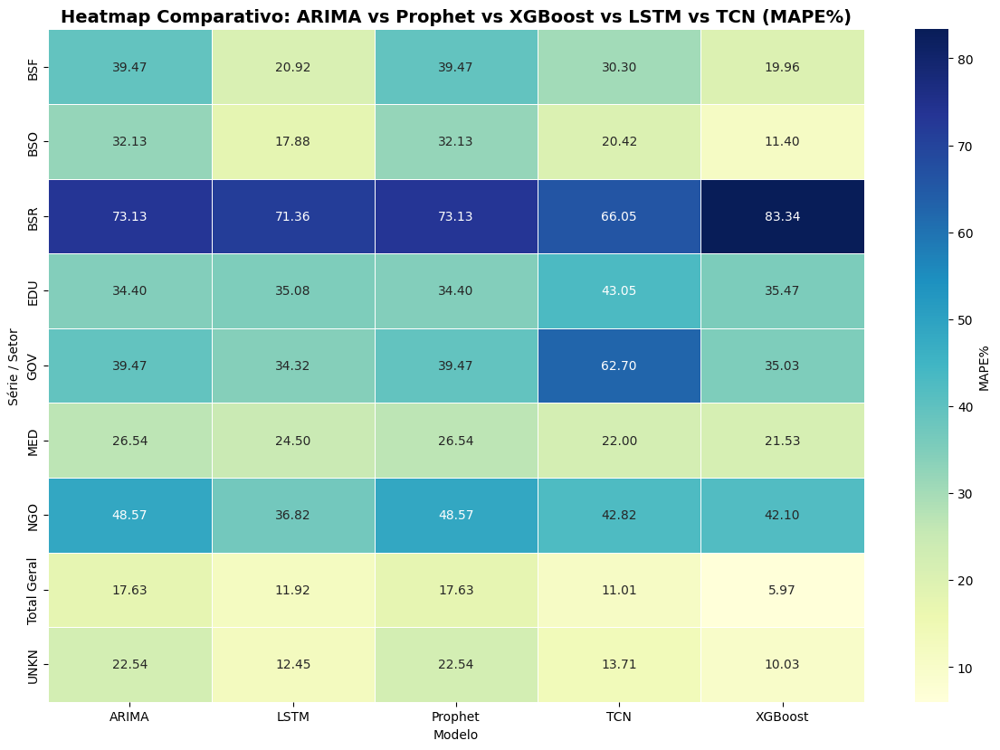

In [ ]:
# ==========================================
# 📦 Importações
# ==========================================
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import glob
import os

# ==========================================
# 📂 Caminho base local
# ==========================================
# Agora os arquivos serão buscados diretamente no diretório /content
caminho_base = '/content'

# ==========================================
# 🔍 Função para encontrar o arquivo mais recente
# ==========================================
def arquivo_recente(padrao):
    arquivos = glob.glob(os.path.join(caminho_base, padrao))
    if arquivos:
        return max(arquivos, key=os.path.getctime)
    else:
        print(f"⚠️ Nenhum arquivo encontrado para padrão: {padrao}")
        return None

# ==========================================
# 📂 Localiza os arquivos salvos em /content
# ==========================================
arquivos = {
    "ARIMA": arquivo_recente("resultados_sarima.csv"),
    "Prophet": arquivo_recente("resultados_prophet.csv"),
    "XGBoost": arquivo_recente("resultados_xgb.csv"),
    "LSTM": arquivo_recente("melhores_resultados_lstm.csv"),
    "TCN": arquivo_recente("melhores_resultados_tcn.csv"),
}

# ==========================================
# 📥 Carrega os DataFrames disponíveis
# ==========================================
def carregar_df(caminho, modelo):
    if caminho and os.path.exists(caminho):
        print(f"📄 Carregando {modelo} de: {os.path.basename(caminho)}")
        return pd.read_csv(caminho)
    else:
        print(f"⚠️ {modelo}: arquivo não encontrado. Criando DataFrame vazio.")
        return pd.DataFrame(columns=['Serie', 'MAPE%', 'Modelo'])

df_arima = carregar_df(arquivos["ARIMA"], "ARIMA")
df_prophet = carregar_df(arquivos["Prophet"], "Prophet")
df_xgb = carregar_df(arquivos["XGBoost"], "XGBoost")
df_lstm = carregar_df(arquivos["LSTM"], "LSTM")
df_tcn = carregar_df(arquivos["TCN"], "TCN")

# ==========================================
# 🧹 Função para padronizar nomes de colunas
# ==========================================
def padronizar_colunas(df, nome_modelo):
    df = df.copy()
    df.columns = df.columns.str.strip()
    colunas_baixas = [c.lower() for c in df.columns]

    # === Identifica coluna de Série / Setor ===
    nome_coluna_serie = None
    for possivel in ['serie', 'setor', 'coluna']:
        if possivel in colunas_baixas:
            nome_coluna_serie = df.columns[colunas_baixas.index(possivel)]
            break
    if nome_coluna_serie:
        df = df.rename(columns={nome_coluna_serie: 'Serie'})
    else:
        df['Serie'] = 'Desconhecido'

    # === Identifica coluna de MAPE ===
    nome_coluna_mape = None
    for c in df.columns:
        if 'mape' in c.lower():
            nome_coluna_mape = c
            break
    if nome_coluna_mape:
        df = df.rename(columns={nome_coluna_mape: 'MAPE%'})
    else:
        df['MAPE%'] = None

    df['Modelo'] = nome_modelo
    return df[['Serie', 'MAPE%', 'Modelo']]

# ==========================================
# 🧭 Padroniza todos os modelos
# ==========================================
df_arima_mape = padronizar_colunas(df_arima, 'ARIMA')
df_prophet_mape = padronizar_colunas(df_prophet, 'Prophet')
df_xgb_mape = padronizar_colunas(df_xgb, 'XGBoost')
df_lstm_mape = padronizar_colunas(df_lstm, 'LSTM')
df_tcn_mape = padronizar_colunas(df_tcn, 'TCN')

# ==========================================
# 🔗 Concatenação geral
# ==========================================
df_comparacao = pd.concat(
    [df_arima_mape, df_prophet_mape, df_xgb_mape, df_lstm_mape, df_tcn_mape],
    ignore_index=True
)

# Converte MAPE% para numérico
df_comparacao['MAPE%'] = pd.to_numeric(df_comparacao['MAPE%'], errors='coerce')

# ==========================================
# 📊 Heatmap Comparativo
# ==========================================
df_heatmap = df_comparacao.pivot_table(
    index='Serie',
    columns='Modelo',
    values='MAPE%'
)

plt.figure(figsize=(12, len(df_heatmap) * 0.6 + 3))
sns.heatmap(
    df_heatmap,
    annot=True,
    fmt=".2f",
    cmap='YlGnBu',
    linewidths=0.5,
    cbar_kws={'label': 'MAPE%'}
)

plt.title('Heatmap Comparativo: ARIMA vs Prophet vs XGBoost vs LSTM vs TCN (MAPE%)',
          fontsize=14, weight='bold')
plt.xlabel('Modelo')
plt.ylabel('Série / Setor')
plt.tight_layout()
plt.show()
